In [1]:
import torch
import math
from SC_IPFP.torch.utils import NN, log_kde_pdf_per_point, silvermans_rule
from SC_IPFP.torch.sde_solvers_time import solve_sde_RK


from tqdm.notebook import tqdm

from torch import nn

import itertools
from functools import partial
# np = jax.numpy
import matplotlib.pyplot as plt

In [2]:
from torch import nn
class NN(nn.Module):

    def __init__(self, input_dim=1,  weight_dim_list=[20,20,20]):
        super(NN, self).__init__()

        self.weight_dim_list = [input_dim] + weight_dim_list
        self.layers = [None for i in weight_dim_list]

        for i in range(len(weight_dim_list)):
            setattr(
                self,
                "f" + str(i),
                nn.Linear(
                    self.weight_dim_list[i], self.weight_dim_list[i + 1],
                    bias=True
                )
            )
            self.layers[i]  = getattr(self, "f" + str(i))

            torch.nn.init.xavier_uniform(self.layers[i].weight)
    
    def get_var(self , other=None):
        return torch.tensor([[0]]).double()

    def forward(self, x, var=None):
        functerino = torch.nn.functional.hardtanh
        x_ = x.clone()
        for i_, layer in enumerate(self.layers[:-1]):
            try:
                x = functerino(layer(x))
            except:
                print(x.shape, i_, x_.shape)
                import pdb; pdb.set_trace()
                raise
        try:
            return (self.layers[-1](x))
        except:
            import pdb; pdb.set_trace()
            raise


In [3]:
def solve_sde_RK(alfa=None, beta=None, X0=None, dt=1.0, N=100, t0=0.0,
                theta=None, noise=False, forwards=True):
    """
            Euler Mayurama method
    Syntax:
    ----------
    solve_sde(alfa=None, beta=None, X0=None, dt=None, N=100, t0=0, DW=None)
    Parameters:
    ----------
        alfa  : a  function with two arguments, the X state and the time
                defines the differential equation.
        beta  : a  function with two arguments, the X state and the time
                defines the stochastic part of the SDE.
        X0    : Initial conditions of the SDE. Mandatory for SDEs
                with variables > 1 (default: gaussian np.random)
        dt    : The timestep of the solution
                (default: 1)
        N     : The number of timesteps (defines the length of the timeseries)
                (default: 100)
        t0    : The initial time of the solution
                (default: 0)
    
    """
    
#     print(X0)
       
    if alfa is None or beta is None:
        raise ValueError("Error: SDE not defined.")

    n, d, *_ = X0.shape
    
    T = torch.tensor(dt * N).cuda()
    
    DWs  = torch.empty((n, N-1, d)).normal_(mean=0, std=1).cuda() * math.sqrt(dt)
    
    
    Y, ti = torch.zeros((n, N, d + 1)).double().cuda(), torch.arange(N).double().cuda()*dt + t0
    t0rep =  (
        t0 * torch.ones((X0.shape[0], 1)).double().cuda() if forwards
        else (T-t0) * torch.ones((X0.shape[0], 1)).double().cuda()
    )
#     Y[:, 0, :] =  torch.cat((X0, t0rep), axis=1 )
    Y = torch.cat((X0, t0rep), axis=1 )[:, None, :]

    N = int(N)
    
    T = dt * N
        
    for n in range(N-1):
        t = ti[n]
        a, DW_n = alfa(Y[:,n, :]),  DWs[:,n,:]
        newY = (  
            Y[:,n, :-1] + a * dt + beta * DW_n
        )
        
        trep = (
            t.repeat(newY.shape[0]).reshape(-1,1) if forwards
            else T - t.repeat(newY.shape[0]).reshape(-1,1)
        )
        
        tocat = torch.cat((newY, trep), dim=1)[:, None, :]
        Y = torch.cat((Y,tocat) , dim=1)
    if torch.isnan(Y).any() or torch.isinf(Y).any(): import pdb; pdb.set_trace()
#     import pdb; pdb.set_trace()
    return ti, Y

In [4]:
def divergence(outputs, inputs):
    grads_ = torch.autograd.grad(
            outputs, inputs, torch.ones_like(outputs),
            retain_graph=True, create_graph=True
     )[0]
    return grads_[:,:,:-1].sum(dim=2)

In [9]:
from copy import deepcopy
class cIPFP(object):
    
    def __init__(self, X_0, X_1, weights=[100], batch_size=None,  rng = None, rng_b = None, 
                nrng = None, number_time_steps=16, sde_solver=solve_sde_RK, sigma_sq=1, 
                step_size = 0.001, num_epochs = 10, weight_decay = 0.9, create_network=None,
                log_prob=log_kde_pdf_per_point, optimizer=torch.optim.SGD, lrs = None):
        
        self.sde_solver = sde_solver
        
        self.number_time_steps = number_time_steps
        self.dt = 1.0 / number_time_steps
        
        
        self.batch_size_f = X_0.shape[0] if batch_size is None else batch_size
        self.batch_size_b = X_1.shape[0] if batch_size is None else batch_size
        with torch.cuda.device(0):
        
            self.X_0 = X_0.requires_grad_()
            self.X_1 = X_1.requires_grad_()

            self.H_0 = silvermans_rule(X_0)
            self.H_1 = silvermans_rule(X_1)

            _, self.dim = self.X_0.shape

            weights = weights + [self.dim]


            self.b_forward = NN(self.dim + 1, weights).double().cuda()
            self.b_backward = NN(self.dim + 1, weights).double().cuda()

            self.theta_f = list(self.b_forward.parameters())
            self.theta_b = list(self.b_backward.parameters())

            self.sigma = sigma_sq

            self.optimizer_f = optimizer(
                self.theta_f, lr=step_size, weight_decay=weight_decay
            )

            self.optimizer_b = optimizer(
                self.theta_b, lr=step_size, weight_decay=weight_decay
            )
            
            m = 0.1
            lr_lambda = lambda epoch : 1.0 / (1.0 + lrs * epoch)


            self.lrs_f  = torch.optim.lr_scheduler.LambdaLR(self.optimizer_f, lr_lambda, last_epoch=-1)
            self.lrs_b  = torch.optim.lr_scheduler.LambdaLR(self.optimizer_b, lr_lambda, last_epoch=-1)

            num_complete_batches_f, leftover_f = divmod(self.X_0.shape[0], self.batch_size_f)
            self.num_batches_f = num_complete_batches_f + bool(leftover_f)

            num_complete_batches_b, leftover_b = divmod(self.X_1.shape[0], self.batch_size_b)
            self.num_batches_b = num_complete_batches_b + bool(leftover_b)

            self.first_iter_fac = 0.0

            self.log_prob = log_prob

            self.burn_in = False
    
    def data_stream(self, forward=True):
        X = self.X_0 if forward else self.X_1
        
        batch_size = self.batch_size_f if forward else self.batch_size_b
        num_batches = self.num_batches_f if forward else self.num_batches_b
        
        num_train = self.X_0.shape[0] if forward else self.X_1.shape[0]
        while True:
            perm = torch.randperm(X.size()[0])
            for i in range(num_batches):
                batch_idx = perm[i * batch_size:(i + 1) * batch_size]
                yield X[batch_idx] 
        
    def loss_for_trajectory(self, Xt, forwards):
        n_, *_ = Xt.shape
        
#         if not forwards :
#             Xt = Xt.flip(1)
        
        if forwards:
            b_minus  = self.b_backward.forward( Xt)
            b_plus = self.b_forward.forward(Xt)
            div = divergence(b_minus, Xt)
        else:
            b_minus  = self.b_backward.forward(Xt)
            b_plus = self.b_forward.forward(Xt) * self.first_iter_fac 
            div = -divergence(b_plus, Xt) * self.first_iter_fac 

            
        sign = 1.0 if forwards else -1.0
        
        time_integral = (sign *  (b_plus - b_minus))**2 * self.dt 
        out =  0.5 * time_integral.sum(dim=(1,2))  - (div.sum(dim=(1)) *  self.dt )
        
        return out


    def inner_loss_jit(self, batch,  
                       batch_terminal_empirical,
                       forwards):
        
        b = (
            self.b_forward.forward
            if forwards else (lambda X: -self.b_backward.forward(X))
        )
        
        t, Xt, *W = self.sde_solver(
            b, self.sigma, batch, self.dt, 
            self.number_time_steps, 0,
            None, False, forwards
        )
        Ht = silvermans_rule(Xt[:,-1,:-1])
        H = silvermans_rule(batch_terminal_empirical)
        
        main_term = self.loss_for_trajectory(Xt, forwards)

        if not self.burn_in:
#             xx = torch.linspace(-30, 30 , 1000).reshape(-1,1).double().cuda()
#             yy = self.log_prob( xx, batch_terminal_empirical, H)  
#             plt.plot(
#                 xx.detach().cpu().numpy(),
#                 np.exp(yy.detach().cpu().numpy())
#             )
#             plt.show()
            cross_entropy = -self.log_prob( Xt[:,-1,:-1], batch_terminal_empirical, H)             
        else:
            cross_entropy = -self.log_prob(batch_terminal_empirical, Xt[:,-1,:-1], Ht)

        J = torch.mean(main_term +  2.0 * cross_entropy )
        J = torch.squeeze(J)
        return J
    
    def inner_loss(self, batch, forwards=True):
        
        if self. burn_in:
            self.batch_terminal_empirical_burn = next(self.data_stream(forward=forwards))
            self.H_burn = self.H_0 if forwards else self.H_1
#         else:
        batch_terminal_empirical = next(self.data_stream(forward=not(forwards)))
        H = self.H_1 if forwards else self.H_0

        return self.inner_loss_jit(
            batch, batch_terminal_empirical,
            forwards
        )

    def closure(self, X, forwards=True):
        """
        Close method required for pytorches CG and LBFGS optimizers
        :params X[torch.tensor]: nxdim  torch tensor representing dataset
        """
        
        opt = self.optimizer_f if forwards else self.optimizer_b
        
        opt.zero_grad()
        loss = self.inner_loss(X, forwards)
        loss.backward()
        return loss
    
    
    def fit(self, IPFP_iterations=10, sub_iterations=10, plot=False, burn_iterations=7):     
        
        name = str(self.optimizer_f).lower()
        bfgs_cg_flag  = "bfgs" in name or "cg" in name
        close_f, close_b =  [], []

        
        
        if plot: self.plot_trajectories()
        
        self.first_iter_fac = 0.0
        if burn_iterations > 0 : self.burn_in = True
            
        self.b_thetas , self.f_thetas = [], []
        
        batches_f = self.data_stream(forward=True)
        batches_b = self.data_stream(forward=False)
        
        loss_b, loss_f = [], []
        for i in tqdm(range(IPFP_iterations + burn_iterations)):
            
            if i == burn_iterations:
                self.burn_in = False
                self.first_iter_fac = 0.0
            
            
            for k in range(sub_iterations):
                for _ in range(self.num_batches_b):
                    batch_b =  next(batches_b)
                    
                    if bfgs_cg_flag:
                        close_b = [lambda : self.closure(batch_b, False)]
                    lossb = self.inner_loss(
                        batch_b, False
                    )
                    lossb.backward()
                    self.optimizer_b.step(*close_b)
                    self.lrs_b.step()
                print(f"loss b {lossb}")
                
            loss_b.append(lossb)
            self.b_thetas.append(deepcopy(self.theta_b))

            self.first_iter_fac = 1.0
       
            for k in range(sub_iterations):
                for _ in range(self.num_batches_f):
                    batch_f =  next(batches_f)
                    if bfgs_cg_flag:
                        close_f = [lambda : self.closure(batch_f, True)]
                    lossf = self.inner_loss(
                        batch_f, True
                    )
                    
                    lossf.backward()
                    self.optimizer_f.step(*close_f)
                    self.lrs_f.step()
  
                print(f"loss f {lossf}")
            
            loss_f.append(lossf)
            self.f_thetas.append(deepcopy(self.theta_f))

            self.loss_f = loss_f
            self.loss_b = loss_b
            if plot: self.plot_trajectories()

        
        plt.plot(range(IPFP_iterations), loss_f, "g")
        plt.show()
        plt.plot(range(IPFP_iterations), loss_b, "b")
        plt.show()
        
    def plot_trajectories(self):
        bb = lambda X: -self.b_backward(X)

        t, Xts = self.sde_solver(
            self.b_forward.forward, self.sigma,
            self.X_0, self.dt,  self.number_time_steps, 0.0,
            self.theta_f, False, True
        )
        t_, Xts_ = self.sde_solver(
            bb, self.sigma, 
            self.X_1, self.dt, self.number_time_steps, 0.0, 
            self.theta_b, False, False
        )
        
        fn = 14
        fig, axs = plt.subplots(2,1,  sharey=False, figsize=(15,10))
        axs[1].set_xlabel("$t$", fontsize=fn)
        axs[1].set_ylabel("$x(t)$", fontsize=fn)
        axs[0].set_ylabel("$x(t)$", fontsize=fn)

        tt = axs[1].get_xticks()
        axs[1].set_xticks(tt.flatten() )
        axs[1].set_xticklabels(list(map (lambda x: '{0:.2f}'.format((x)), tt))[::-1])

        for i in range(n):
            label = "$\mathbb{Q}$: Forward process" if i == 0 else None
            axs[0].plot(t.cpu().flatten(), Xts[i,:,:-1].detach().cpu().numpy().flatten(), 'b', alpha=0.8,  label=label)


        for i in range(n):
            label = "$\mathbb{P}$: Reverse process" if i == 0 else None
            axs[1].plot(t_.cpu().flatten(), Xts_[i,:, :-1].detach().cpu().numpy().flatten(), 'r', alpha=0.8, label=label)

        axs[1].legend(fontsize=fn)
        axs[0].legend(fontsize=fn)

        plt.show()    
    
    #     @partial(jit, static_argnums=(0,2))
    def transport_batch(self, batch_x, forwards):
        theta = self.theta_f if forwards else self.theta_b    
        b = self.b_forward if forwards else  lambda X, theta: -self.b_backward(X, theta)

        t, Xt = self.sde_solver(
            alfa=b, beta=self.sigma, dt=self.dt, 
            X0=batch_x.reshape(-1,self.dim), N=self.number_time_steps, theta=theta
        )

        return Xt[:,-1,:]
            

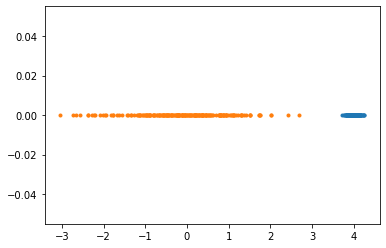

In [27]:
import numpy.random as npr
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

n = 200
n_2 = int(n * 1.0 / 2)
# n_2 = int(n * 1.0 / 2.0)


X1 = npr.randn(n).reshape(-1,1) - 0
X21 = 0.1 * npr.randn(n_2).reshape(-1,1) + 4
X22 =  0.1 * npr.randn(n_2).reshape(-1,1) + 4
X23 =  3 * npr.randn(n_2).reshape(-1,1) + 0

X2 = np.concatenate((X21, X22), axis=0)
# X1, X2 = X2, X1

plt.plot(X2.flatten(), [0] * n, '.')
plt.plot(X1.flatten(), [0] * n, '.')

with torch.cuda.device(0):

    X1 = torch.tensor(X1).cuda()
    X2 = torch.tensor(X2).cuda()

In [28]:


torch.cuda.manual_seed_all(10)
torch.manual_seed(10)

c = cIPFP(
    X1, X2,  number_time_steps=100, batch_size=900 ,
    step_size=1e-3, weights=[500], rng = None,
    optimizer=torch.optim.Adam, lrs = 0.002, weight_decay=0, sigma_sq=1
)

/anaconda/envs/py37_default/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.


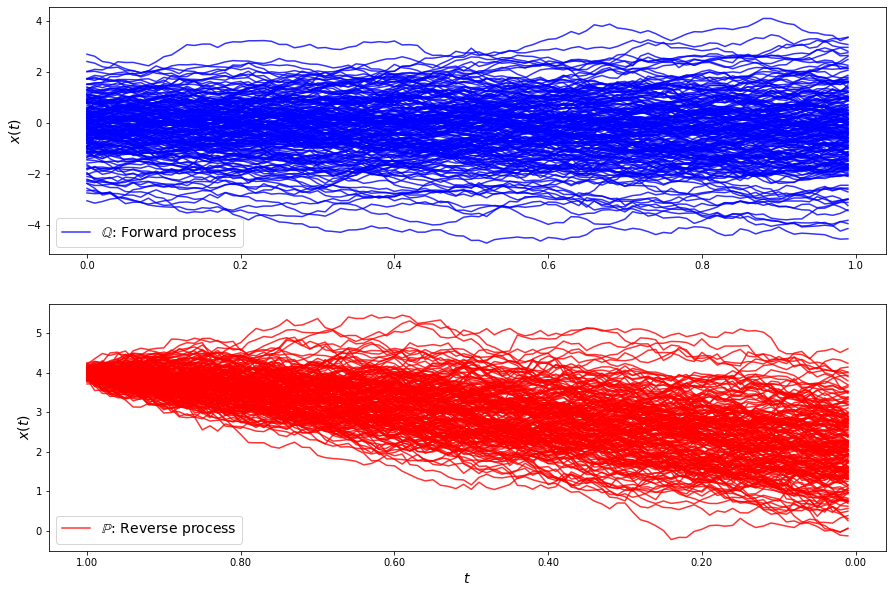

loss b 6.556589961999456
loss b 6.645078384236441
loss b 8.975389262629252
loss b 7.517926804019614
loss b 5.862074727978676
loss b 6.833374275313792
loss b 8.564456319220422
loss b 24.144162062772498
loss b 16.475359623132924
loss b 19.031395570545286
loss b 6.401713542644007
loss b 5.358070513838728
loss b 7.0532469177468835
loss b 12.007519068692874
loss b 19.716214305949602
loss b 29.96154030468815
loss b 44.93708999202629
loss b 57.15460062022988
loss b 81.74646411393842
loss b 81.4089215938943
loss b 81.64219296343504
loss b 59.320474509280636
loss b 51.943987667825326
loss b 49.46725547515374
loss b 33.418834883133
loss b 25.125198381831527
loss b 18.20567526219737
loss b 13.62358151056013
loss b 10.654457014495428
loss b 8.672726239304192
loss f 12.008658404639618
loss f 3.931655983750085
loss f 1.9318211890360955
loss f 1.6084459021881037
loss f 3.6776376593129436
loss f 7.363110188837075
loss f 11.60545798619067
loss f 16.844160639582938
loss f 20.58114637465235
loss f 23.240

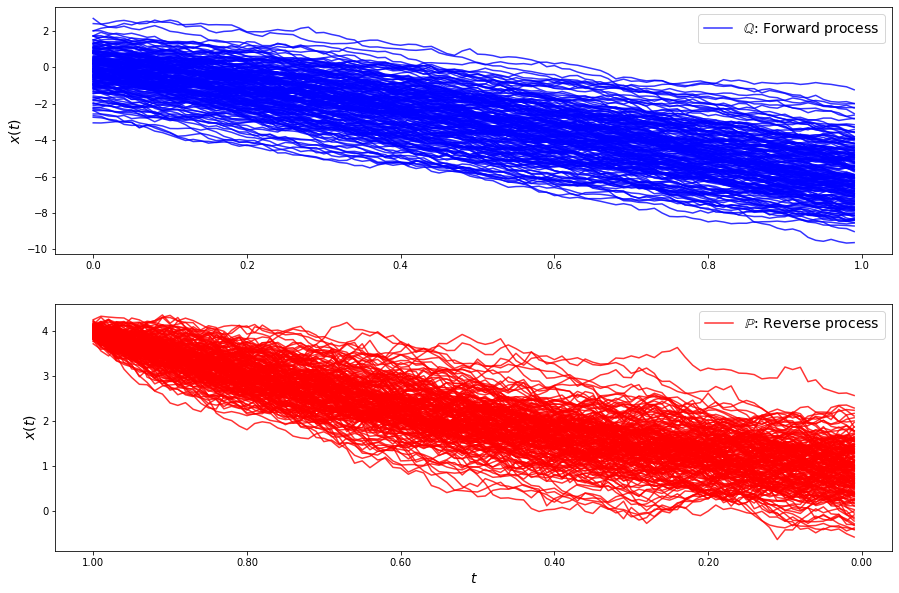

loss b 23.538193386440266
loss b 30.51058312287807
loss b 23.877303323065945
loss b 33.73277938733973
loss b 50.88635418819703
loss b 43.95374640504752
loss b 63.25744986997355
loss b 90.79993470038224
loss b 107.79666707387038
loss b 87.8060200807062
loss b 98.79895329468395
loss b 107.93266880398045
loss b 109.71490163740904
loss b 106.49660285406941
loss b 114.23117096585844
loss b 108.96551411582847
loss b 79.13573200766095
loss b 83.33455001734384
loss b 95.83293095689649
loss b 78.14164465215528
loss b 77.85794642484788
loss b 60.37158978957269
loss b 46.514935757988255
loss b 46.73036154753138
loss b 50.45034712389872
loss b 51.57260767006827
loss b 48.566927223372105
loss b 45.266421990922446
loss b 36.587985774349754
loss b 32.447116251286225
loss f 51.146213913919766
loss f 82.98761481587451
loss f 35.70641123913735
loss f 26.870695427341975
loss f 14.355685112363858
loss f 15.649093212766049
loss f 8.36183135818651
loss f 5.655325837590378
loss f 5.356132264768285
loss f 4.8

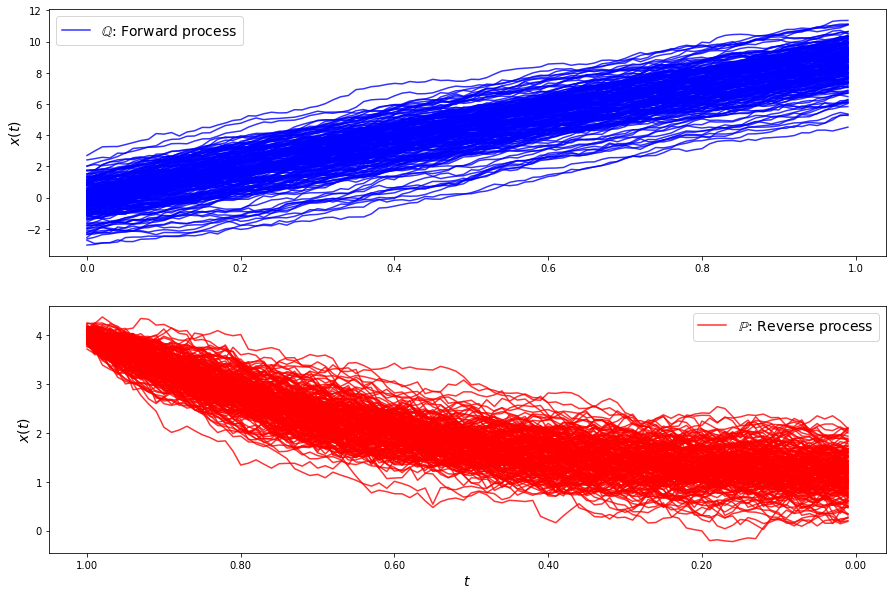

loss b 7.819546648516766
loss b 8.157672397992515
loss b 8.43854756926442
loss b 8.771158848367387
loss b 9.658148641898462
loss b 9.398475731778621
loss b 9.792080857165459
loss b 10.782847152243864
loss b 10.702772071897801
loss b 11.243221506480966
loss b 11.85058103550591
loss b 12.26787313555351
loss b 12.445768514548732
loss b 12.617607977524171
loss b 12.992552536750555
loss b 13.375173371414734
loss b 13.93639671486672
loss b 14.342631433063604
loss b 14.627115968849841
loss b 15.037275154759643
loss b 15.477504194403604
loss b 15.704727436672346
loss b 15.91563797498249
loss b 16.313486645867535
loss b 16.578759422150604
loss b 16.707283686553392
loss b 16.89343683515856
loss b 16.918702387955943
loss b 17.073841003172372
loss b 17.189656669446318
loss f 1228.9802845771471
loss f 1133.8600323431708
loss f 1053.6273326806436
loss f 990.334271053171
loss f 804.832774878199
loss f 702.3849694241676
loss f 590.2030713361755
loss f 466.0233402753811
loss f 386.9725445993232
loss f 

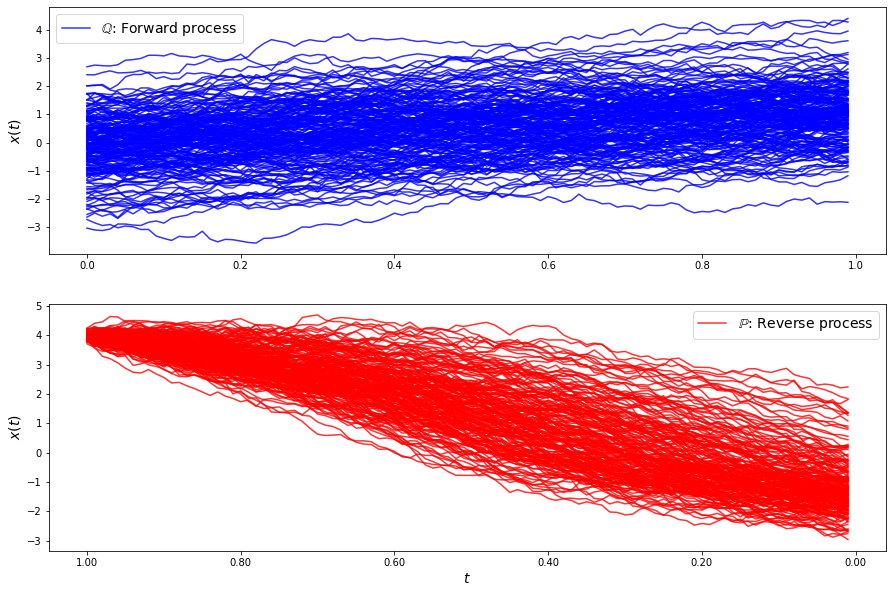

loss b 14.652744952527502
loss b 14.302266144251124
loss b 14.200582279881484
loss b 13.980958344355244
loss b 13.878144207410829
loss b 13.486431621946295
loss b 13.224173095866249
loss b 12.656726745978375
loss b 12.342149849884093
loss b 12.025940354216958
loss b 12.042288957466479
loss b 11.514006906322582
loss b 11.412979224865616
loss b 10.912613321178231
loss b 10.982095786036938
loss b 11.613787123310836
loss b 10.708005572147194
loss b 12.057049862143787
loss b 12.687265525184117
loss b 14.435296769128094
loss b 15.12510498380961
loss b 16.023242576477056
loss b 15.040012742026091
loss b 19.087669583642754
loss b 18.641135836798977
loss b 23.487065194875804
loss b 22.729058093780818
loss b 23.757469321681643
loss b 27.44280662336106
loss b 23.004058405791252
loss f 491.2317557886404
loss f 532.6629916316289
loss f 588.7734181155919
loss f 639.1046556984995
loss f 671.301982392638
loss f 705.6030092692915
loss f 713.8985316519684
loss f 712.5902660658707
loss f 739.469245306140

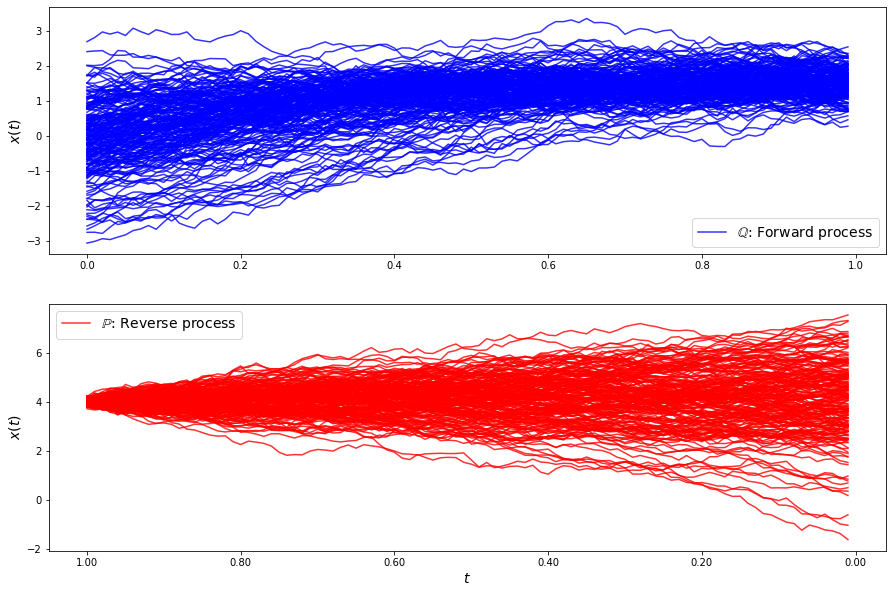

loss b 35.13580193311296
loss b 37.82200307602987
loss b 39.1256064103887
loss b 35.37419028703238
loss b 38.87122634738132
loss b 39.21761492376088
loss b 34.22206902558001
loss b 38.25393741874759
loss b 34.08828022863398
loss b 34.049077298673716
loss b 33.1518817308383
loss b 32.42819880870315
loss b 29.755542915995502
loss b 34.166736733923564
loss b 30.700789167733145
loss b 29.166784510708766
loss b 32.12531445124652
loss b 31.06507586493856
loss b 28.156137290163592
loss b 28.030714980651982
loss b 27.581126107564806
loss b 25.40123783467787
loss b 22.916368461368855
loss b 22.939592270180558
loss b 23.360261469757845
loss b 23.793245073185304
loss b 20.199187636726
loss b 20.086385896298594
loss b 18.920745929568795
loss b 17.50337460510379
loss f 299.33874608806525
loss f 279.19104723604346
loss f 269.2322506771988
loss f 249.83715731554898
loss f 245.63756788656673
loss f 235.8315024490711
loss f 211.76388614723726
loss f 214.53803875755574
loss f 207.83320714390902
loss f 2

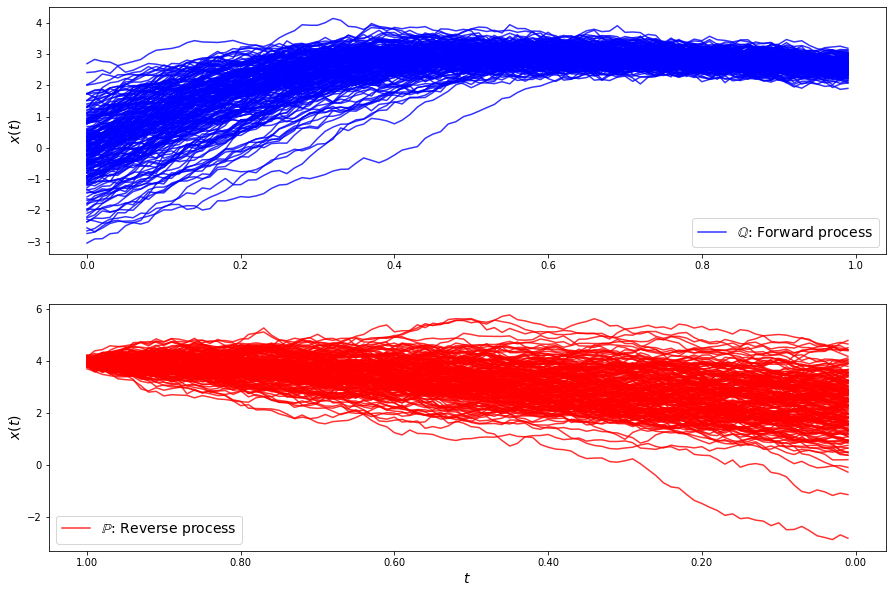

loss b 22.79913605883913
loss b 22.270144840565216
loss b 20.73054046676635
loss b 20.783655294904552
loss b 21.2305726462337
loss b 19.870763551639506
loss b 19.451585330559325
loss b 19.621380929473236
loss b 20.72139297014583
loss b 20.0388233328455
loss b 19.92930082468261
loss b 21.335423785762007
loss b 20.452007785628048
loss b 20.045086986421943
loss b 19.89805117882953
loss b 20.08225722889961
loss b 20.216926443809605
loss b 20.58276795027071
loss b 20.87049897317103
loss b 21.390759294593483
loss b 20.991584928700885
loss b 21.466373526290003
loss b 22.225968914405374
loss b 21.60820065179786
loss b 22.213434110161
loss b 22.66085237131606
loss b 22.99910231306907
loss b 23.44920182259096
loss b 23.68051308222569
loss b 23.797327738828272
loss f 90.62908433994374
loss f 84.45031179437976
loss f 79.15992956643487
loss f 70.21341282437993
loss f 61.196012334737084
loss f 54.615673481244244
loss f 48.10187394696759
loss f 38.919254765856614
loss f 31.329565799066263
loss f 26.8

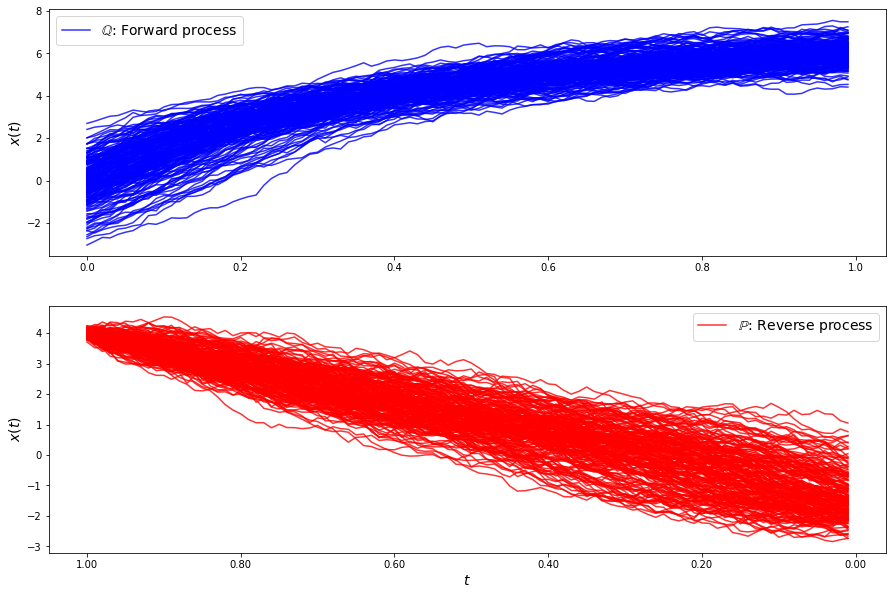

loss b 32.52382378300076
loss b 32.877660389894785
loss b 32.76338485209947
loss b 33.23920340377513
loss b 33.51018980530626
loss b 34.43155373255517
loss b 34.45238986130531
loss b 34.5031503591128
loss b 34.748799668525336
loss b 35.336826239063846
loss b 36.36169689815907
loss b 36.203710291293426
loss b 35.959794593625425
loss b 37.241291968885726
loss b 36.869396581244935
loss b 36.93606990340925
loss b 37.22356851280224
loss b 38.45215841195459
loss b 38.62251351564607
loss b 37.47314033364474
loss b 39.256676559807076
loss b 39.911663333584286
loss b 39.86387692984101
loss b 40.012063801147455
loss b 40.96393604172604
loss b 40.70587297333835
loss b 40.460199102546106
loss b 41.47509235195724
loss b 40.94231272350265
loss b 40.68566088696698
loss f 206.68460162065514
loss f 223.61155765360297
loss f 212.12091293553343
loss f 204.08635080564278
loss f 206.78721702678757
loss f 211.52900669837018
loss f 206.40905294249805
loss f 207.4857182908897
loss f 183.01927312543464
loss f 

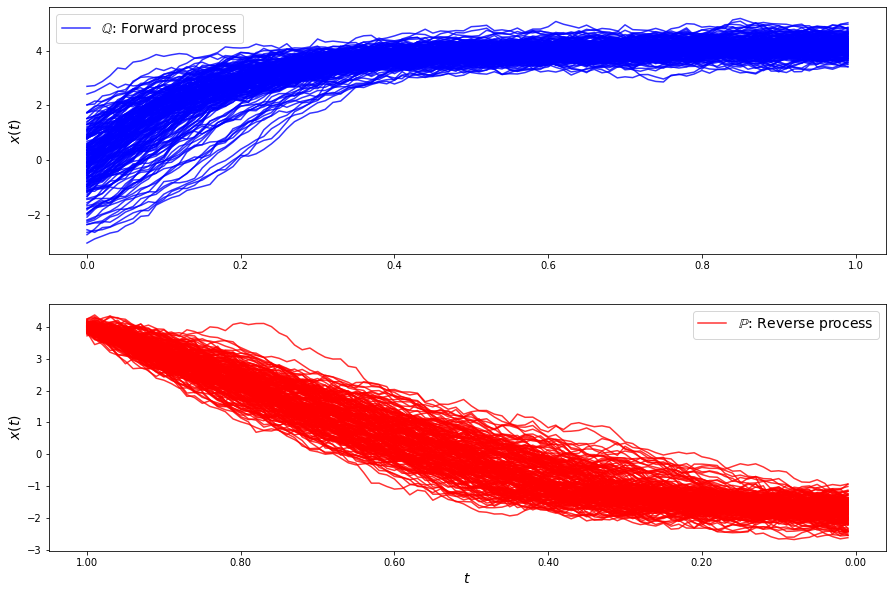

loss b 59.60001926451948
loss b 59.01883580807152
loss b 59.76254791809547
loss b 59.574769953452325
loss b 60.31532930009912
loss b 60.843110639701365
loss b 61.33426607545904
loss b 59.92797438569053
loss b 60.02998001225736
loss b 59.71896715795064
loss b 60.10213021443816
loss b 60.93429980405386
loss b 59.44412833547007
loss b 60.47113251380017
loss b 60.05615841336701
loss b 58.762304366787106
loss b 59.54425949564027
loss b 59.25003845961948
loss b 58.298477155675975
loss b 58.13961915652476
loss b 57.84339713376525
loss b 57.28534069564309
loss b 56.21640618602435
loss b 57.06841251321819
loss b 55.71866669764877
loss b 55.55085958772823
loss b 55.31187695832656
loss b 54.02127026326075
loss b 53.40428976874593
loss b 52.77131939629413
loss f 35.72026288483718
loss f 33.43593694738743
loss f 32.31844660128406
loss f 34.43054149030359
loss f 33.34169035386445
loss f 34.606585850424025
loss f 34.472076299663726
loss f 36.53613630637965
loss f 37.034573901360886
loss f 37.91261256

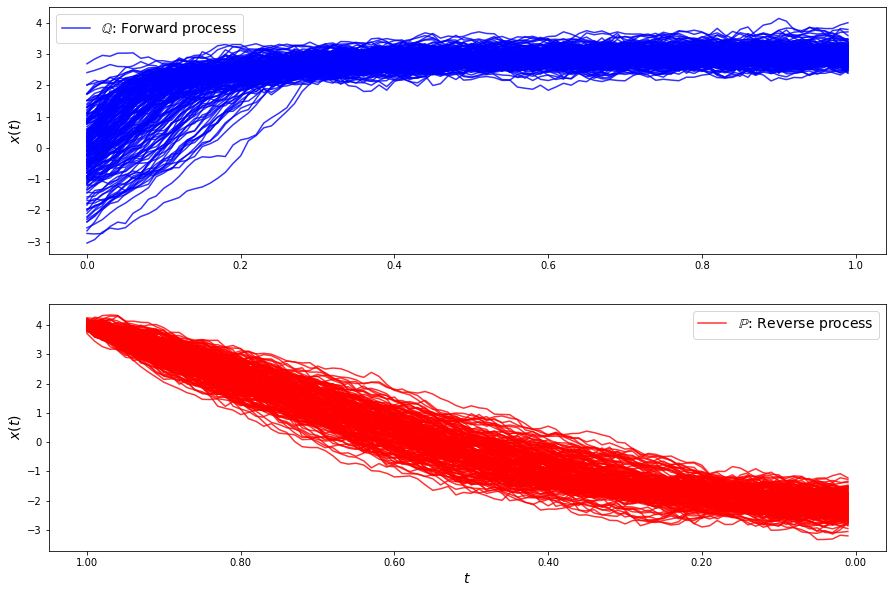

loss b 58.29474514468749
loss b 58.855213159438506
loss b 57.19708257812498
loss b 57.176051506665786
loss b 56.703098940279304
loss b 55.71264010646185
loss b 55.438399211455064
loss b 54.851350735830074
loss b 54.25833333070116
loss b 53.43369941339836
loss b 52.77815064135506
loss b 52.619497075829905
loss b 51.12907627757156
loss b 51.465920197218225
loss b 50.272540849135886
loss b 50.257563014048486
loss b 49.42399034110788
loss b 48.68636517680454
loss b 49.10762744346237
loss b 48.381764794676236
loss b 47.98684625377178
loss b 47.62392187590334
loss b 47.31638440286665
loss b 47.25783405218986
loss b 47.10395211363383
loss b 47.49364294400874
loss b 47.94016180617682
loss b 47.03947725574735
loss b 47.256707861694906
loss b 47.254006557773955
loss f 62.50672574391442
loss f 64.19137610011585
loss f 68.64494045926833
loss f 66.53250576934835
loss f 68.54312862808519
loss f 67.58687623324285
loss f 70.16875031802148
loss f 70.1353107899815
loss f 73.28366163197047
loss f 72.6549

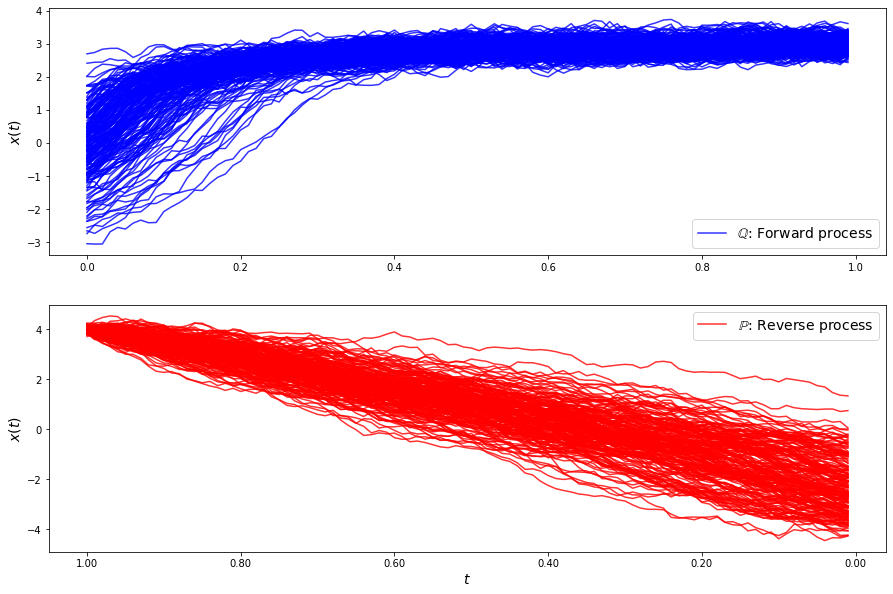

loss b 43.36935411906169
loss b 43.86077348179571
loss b 42.62548127566483
loss b 43.536977842871245
loss b 43.095349232977966
loss b 42.4551320493566
loss b 41.92087165818792
loss b 42.26512251890414
loss b 41.93032288520353
loss b 40.355019539947875
loss b 40.28563291438159
loss b 39.44162629234101
loss b 37.694707503988134
loss b 36.96184901566673
loss b 33.99286838078486
loss b 33.92299984573223
loss b 31.49896205770869
loss b 31.814221175659643
loss b 30.819349700062308
loss b 30.705331753533574
loss b 32.50728729248228
loss b 30.56366293666696
loss b 31.46897981068995
loss b 32.98550418544416
loss b 33.030640137060786
loss b 35.280970600761144
loss b 39.13331063225307
loss b 41.55180213460105
loss b 41.87489302906483
loss b 46.36353323907006
loss f 51.364100614798865
loss f 53.34302246518773
loss f 50.62528358497845
loss f 46.631681678266055
loss f 48.48098297818709
loss f 43.8188954844165
loss f 42.88251512351872
loss f 43.69262469117269
loss f 42.34083766696941
loss f 39.504338

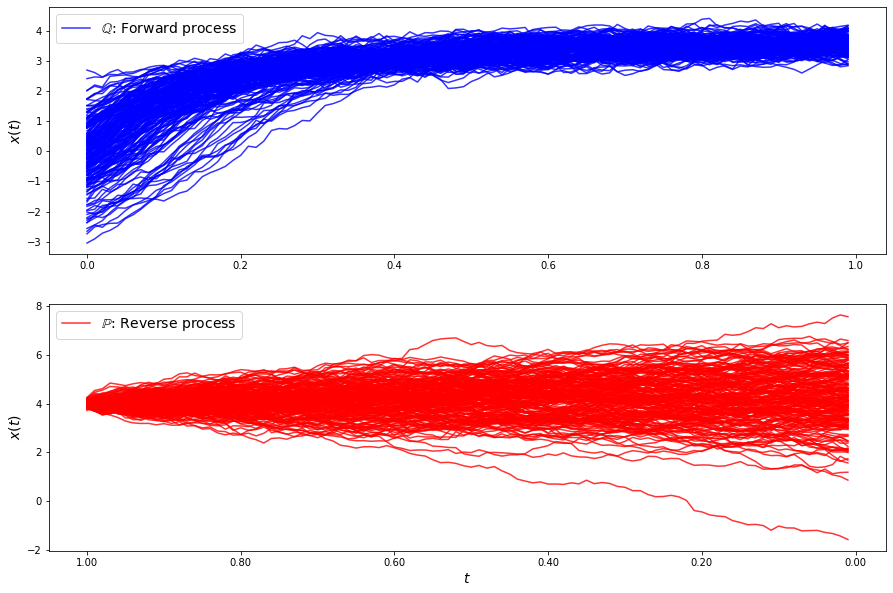

loss b 36.12892443231823
loss b 39.685760433551174
loss b 41.804100689282265
loss b 50.155556657936025
loss b 47.96430358969837
loss b 55.21209537367706
loss b 54.613659977474676
loss b 58.506303921474476
loss b 53.70734955951116
loss b 50.79196022115712
loss b 47.533592522007005
loss b 43.99122489827679
loss b 48.09784595971733
loss b 44.628734326834284
loss b 45.33305221275377
loss b 48.04526585896603
loss b 46.58965619341778
loss b 42.29280900585057
loss b 41.73373549683307
loss b 43.120878137830225
loss b 41.40673387299367
loss b 38.95307912122633
loss b 38.063489522700365
loss b 34.94982118480893
loss b 36.08847707592026
loss b 36.44038091822825
loss b 28.427195878172522
loss b 26.68080571997886
loss b 26.516779884203245
loss b 23.406383638876836
loss f 17.96713289977298
loss f 16.377828573349454
loss f 14.793267647449735
loss f 16.229801572279317
loss f 15.501013413690767
loss f 14.32687394879678
loss f 13.570702054164089
loss f 13.938756502884825
loss f 13.045960276426616
loss f

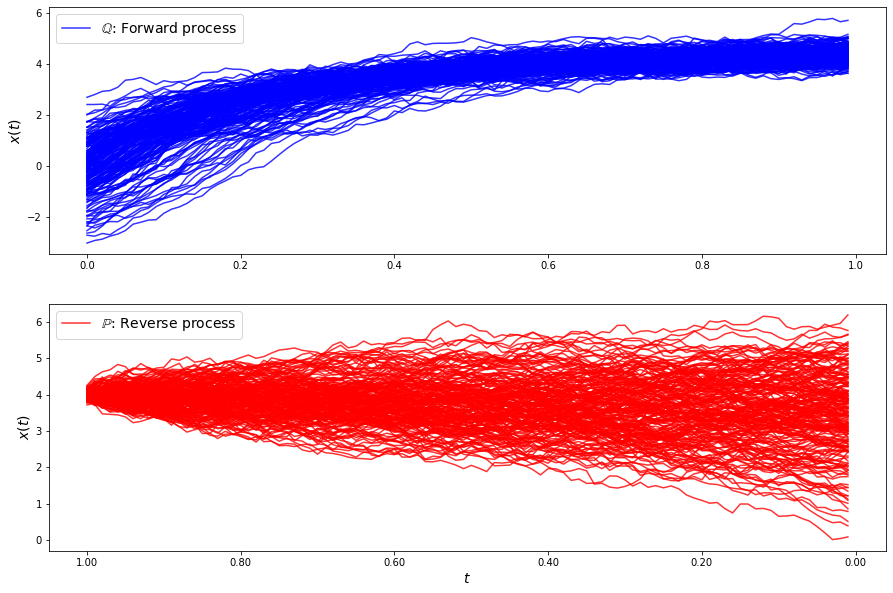

loss b 19.859628507434405
loss b 17.02571382165213
loss b 16.47680929767173
loss b 16.29152787616662
loss b 14.612482200660283
loss b 12.811292876456788
loss b 14.386373753656386
loss b 12.066104500754328
loss b 12.937879239085271
loss b 13.028146862297659
loss b 12.129540662416742
loss b 11.689739110852768
loss b 12.476974245881781
loss b 12.978692116878738
loss b 13.30350023662425
loss b 11.986518609640616
loss b 13.15964427354561
loss b 13.65098493113278
loss b 14.446736134917499
loss b 15.534875963367831
loss b 14.915532020345552
loss b 15.445964056264899
loss b 16.643995344602573
loss b 16.923571246498057
loss b 17.301921422936708
loss b 19.138625709260907
loss b 19.673549530621255
loss b 19.134323231773923
loss b 20.30253091948977
loss b 21.017787748165286
loss f 16.88325453984414
loss f 19.38237206775375
loss f 18.3471797951231
loss f 19.562818944389072
loss f 16.154406038902152
loss f 20.547867284192847
loss f 20.0198793908352
loss f 22.365171175752373
loss f 22.319868518384446

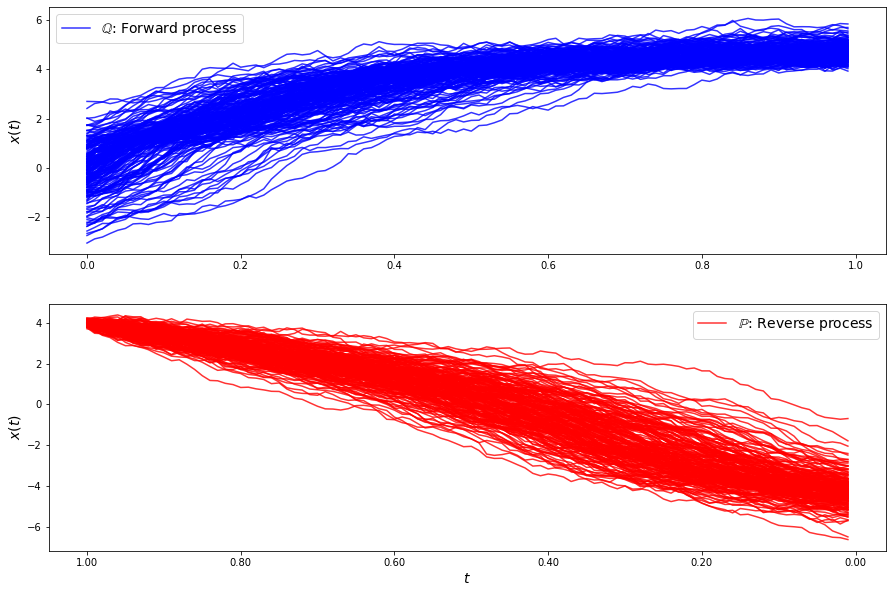

loss b 19.934431972315288
loss b 19.876823053243076
loss b 20.013350943299265
loss b 20.14194289221391
loss b 20.982295129946063
loss b 21.781286368014936
loss b 21.252724280881722
loss b 20.735566962865146
loss b 21.1770390543802
loss b 20.873537008735124
loss b 20.31925639789859
loss b 19.86260128107382
loss b 19.761432721424725
loss b 20.57731447805026
loss b 20.372639665775484
loss b 20.34431610879738
loss b 21.462768971150197
loss b 21.36990069634517
loss b 21.67239301575638
loss b 21.36961501721993
loss b 21.822024764382192
loss b 22.399714941443037
loss b 21.907736993746067
loss b 23.470945843555242
loss b 22.890149689766183
loss b 23.544283622754772
loss b 24.79224120164401
loss b 25.087857838696184
loss b 25.056215442918024
loss b 25.53984523473348
loss f 51.80875082154427
loss f 53.726194135545214
loss f 51.145117508216515
loss f 52.65275443890362
loss f 52.31097793686091
loss f 54.54061838954366
loss f 50.142468911961764
loss f 48.43632631385973
loss f 50.59282750127348
loss

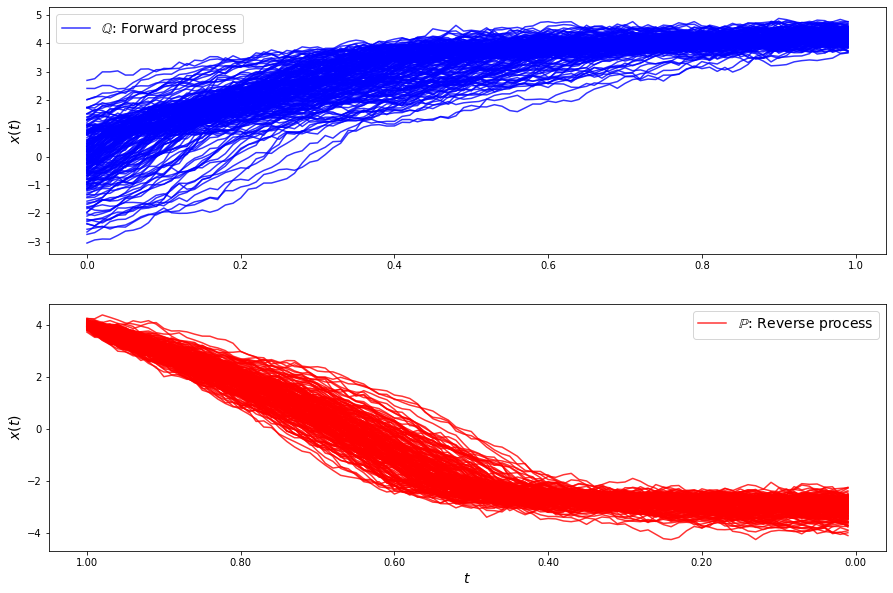

loss b 26.044707207126077
loss b 26.808880973122037
loss b 26.78440962665319
loss b 28.197067310354996
loss b 28.44338413909753
loss b 29.121987202394926
loss b 29.018505968329112
loss b 29.284440764270265
loss b 30.090968343636096
loss b 28.883431044484894
loss b 30.24117968853111
loss b 30.47747576376955
loss b 31.22437275062414
loss b 31.06198189527595
loss b 30.988401428345913
loss b 32.082553318183095
loss b 32.585623393579915
loss b 31.80559454472912
loss b 32.99409605407381
loss b 33.63791273623886
loss b 33.63385644967488
loss b 34.19486856532275
loss b 33.91917076239109
loss b 34.8405741213155
loss b 34.61086846708777
loss b 34.74679206238536
loss b 34.700359933846244
loss b 34.799683498923706
loss b 35.3228670545835
loss b 35.75579834335202
loss f 53.75158092007096
loss f 54.25940265368808
loss f 53.84535419291112
loss f 52.425615476884076
loss f 55.09015265919588
loss f 54.06363221286807
loss f 53.95122954782998
loss f 53.454291522336625
loss f 53.05257012115721
loss f 53.49

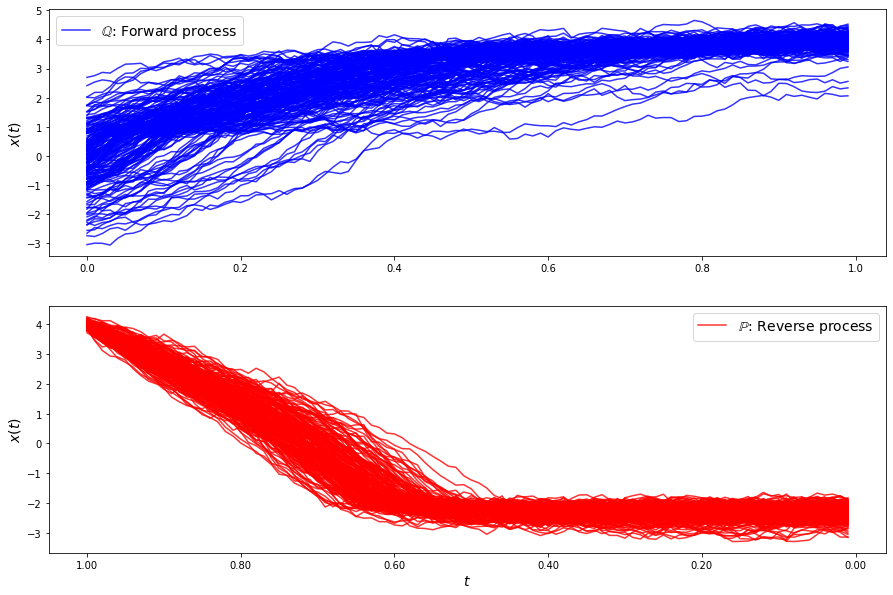

loss b 40.6691817910185
loss b 40.27385347405297
loss b 40.76140452268243
loss b 41.078450100989905
loss b 40.51939925915553
loss b 41.39964495520906
loss b 40.95682140943287
loss b 40.886611654859635
loss b 41.348318231149044
loss b 40.842598878997606
loss b 40.87679360890398
loss b 40.15365685012115
loss b 40.034433136711634
loss b 40.79277083957193
loss b 40.65071560595004
loss b 39.04333575749262
loss b 40.48369497666613
loss b 39.56831216385946
loss b 39.38727843483254
loss b 38.79657307211682
loss b 39.31852775853995
loss b 38.42646209981192
loss b 38.064420350726685
loss b 37.82400077473681
loss b 38.069404419165885
loss b 38.002497898927196
loss b 37.68749877366412
loss b 37.73029883001579
loss b 36.331830642673424
loss b 36.64048127847558
loss f 46.81126929439045
loss f 47.42705668799569
loss f 46.85002110963983
loss f 49.56146504943767
loss f 48.92761097461593
loss f 49.51857217652196
loss f 48.73119351017007
loss f 48.535570997536546
loss f 48.42694578635071
loss f 49.178491

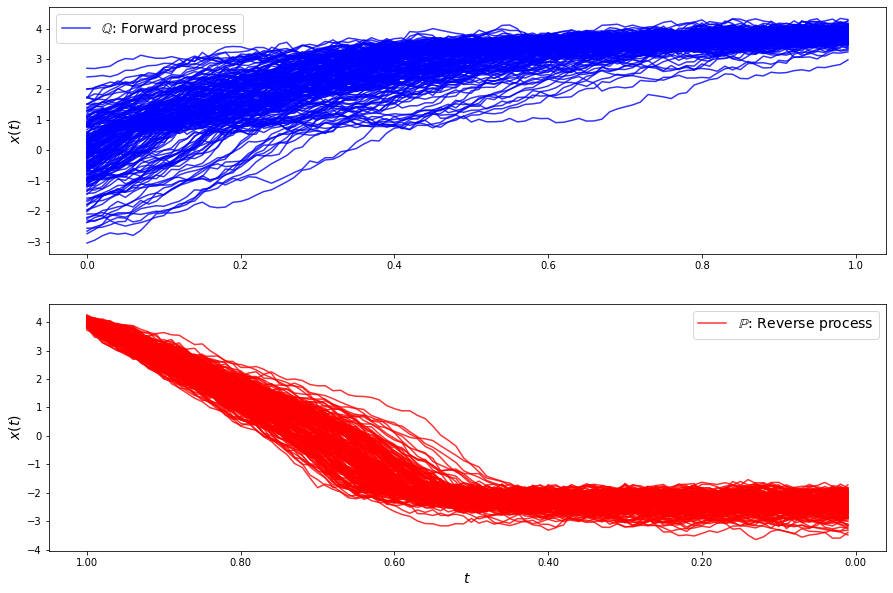

loss b 37.947787334355944
loss b 37.36522559731899
loss b 36.9643978675922
loss b 36.6123639385341
loss b 35.932475085646246
loss b 35.36174575038867
loss b 35.08324360366026
loss b 34.88010424963597
loss b 33.74394520565569
loss b 33.45261957616042
loss b 32.82351540213449
loss b 31.609985737280752
loss b 31.701042606963572
loss b 30.589578305387572
loss b 30.078193103563184
loss b 29.747794952623213
loss b 29.21065686018144
loss b 27.957397477437055
loss b 27.46502487941942
loss b 27.346647186160126
loss b 26.416252916470196
loss b 25.796374814000647
loss b 25.648458092671863
loss b 24.193366658962383
loss b 23.4163537644236
loss b 23.647487049398332
loss b 23.040833973675447
loss b 22.586925435686755
loss b 21.677811181443555
loss b 21.61493352007663
loss f 24.582388679424085
loss f 21.42574195445801
loss f 22.515074476564152
loss f 22.098226311566627
loss f 21.903780733276342
loss f 21.134747933667906
loss f 21.69050324247918
loss f 22.44382858319297
loss f 21.214979537853534
loss 

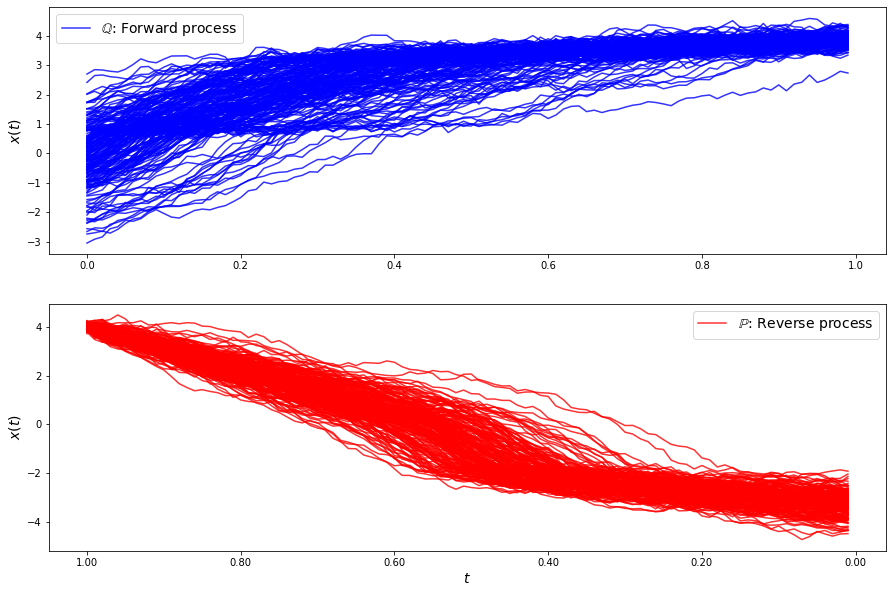

loss b 19.492762342162138
loss b 19.53946157066294
loss b 17.88950426116936
loss b 18.642162384242468
loss b 16.78150535360424
loss b 17.16082721098562
loss b 16.41581107083147
loss b 15.4969677344962
loss b 15.850588851819827
loss b 15.248770782730826
loss b 14.78322410685708
loss b 14.160860765138803
loss b 13.670908968760136
loss b 14.045074076821644
loss b 12.628572079574747
loss b 11.701452680949133
loss b 11.784844550876949
loss b 11.028016006247556
loss b 10.50072827244957
loss b 9.006988840521679
loss b 9.639822297575677
loss b 8.283785734185864
loss b 7.807649849484225
loss b 7.302867258272388
loss b 7.194233930087137
loss b 6.531827995824439
loss b 6.102443210430859
loss b 5.50081401150182
loss b 5.593236075677678
loss b 4.836089486926607
loss f 5.263940295696257
loss f 5.316028912060219
loss f 5.1642648495932875
loss f 6.041260861995149
loss f 5.763537336755381
loss f 5.482433482830777
loss f 7.770667033387956
loss f 5.843392424127376
loss f 5.888871909421869
loss f 4.932555

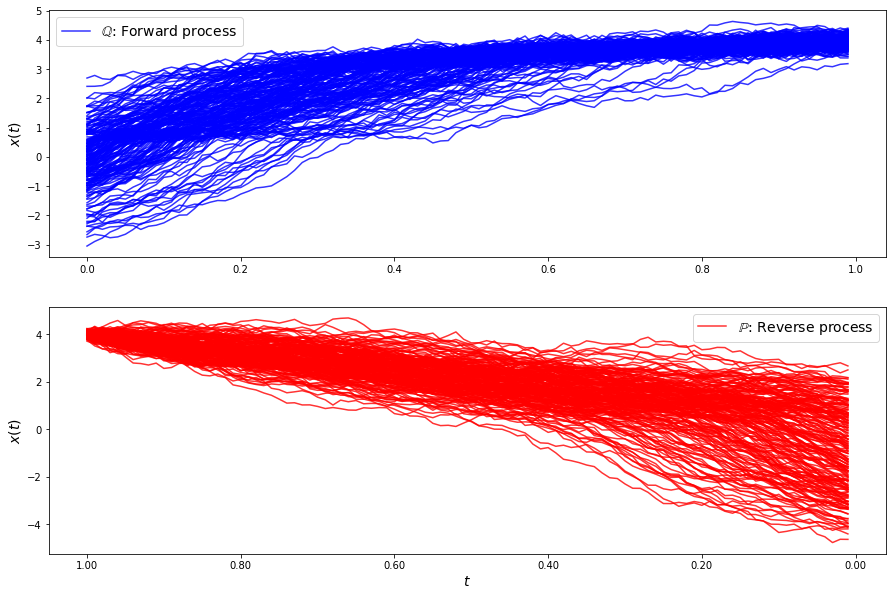

loss b 5.926049705543596
loss b 5.952405991864682
loss b 6.296962079828764
loss b 6.321293259553782
loss b 7.002804880951484
loss b 7.084378719413318
loss b 8.394249338656188
loss b 9.172931028136434
loss b 9.464440651361508
loss b 10.889730509624204
loss b 10.047127680544657
loss b 10.886888903221491
loss b 12.625981170831665
loss b 13.885724781965497
loss b 14.720778093622789
loss b 15.877359007346396
loss b 15.551987824882257
loss b 16.431591927397573
loss b 19.707074042612994
loss b 21.53393172630796
loss b 22.991290672069596
loss b 25.483363880623102
loss b 27.216651017128108
loss b 28.31725714707178
loss b 31.838779021374794
loss b 30.765131723571127
loss b 35.60971788652888
loss b 37.94042015073573
loss b 42.27562755795187
loss b 44.01057803945215
loss f 17.535839753612194
loss f 15.819941110244988
loss f 15.112518193634191
loss f 14.961584548756273
loss f 15.094545737645308
loss f 15.388887937091106
loss f 15.042198486861745
loss f 14.824658761250273
loss f 15.123352737067549
l

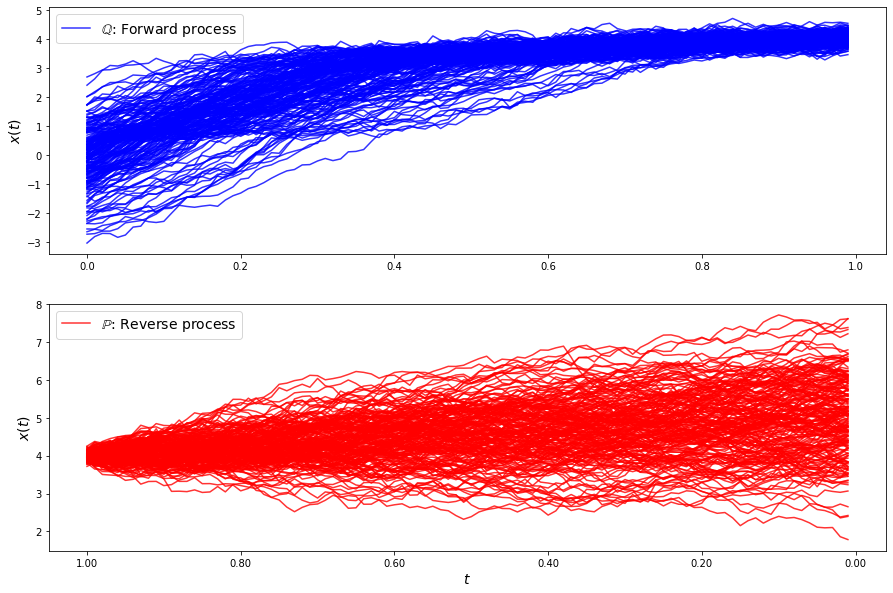

loss b 51.015321380351054
loss b 50.79338810876908
loss b 53.20124804887117
loss b 58.54679173891466
loss b 58.149845876306486
loss b 61.68109065236792
loss b 68.6252178038964
loss b 67.03639997814903
loss b 73.19481169070822
loss b 73.07857034389265
loss b 78.55985525498856
loss b 79.12515644366488
loss b 80.99123282570997
loss b 86.54230599734332
loss b 90.11221113841243
loss b 91.06984287342439
loss b 93.65860219699745
loss b 98.93287440030535
loss b 100.04201322225573
loss b 97.58310364099164
loss b 100.75232254825691
loss b 97.34623594973117
loss b 98.6023674294913
loss b 96.90266804306718
loss b 99.09255975429693
loss b 100.7144321874682
loss b 100.5155877458336
loss b 99.68154627312353
loss b 96.71767118852905
loss b 94.89716235249695
loss f 24.777065089797766
loss f 24.36509718429057
loss f 24.28537163305299
loss f 24.651910314884198
loss f 24.22255336705622
loss f 24.011463755056546
loss f 25.12145186335007
loss f 24.48336169603127
loss f 24.648654804558124
loss f 24.366419468

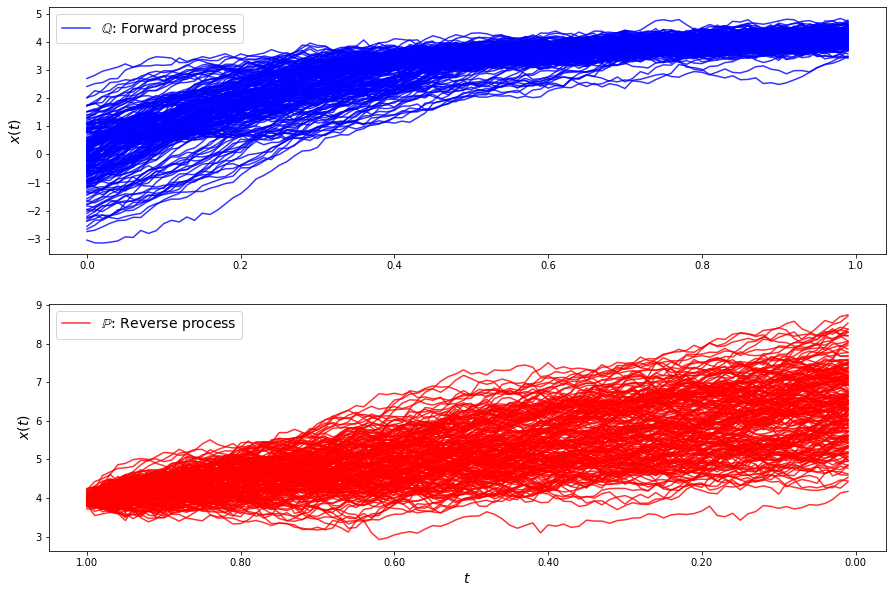

loss b 93.1013491526036
loss b 89.52438492700938
loss b 91.7323262027415
loss b 94.79635885952182
loss b 85.90244536085838
loss b 86.55410113204518
loss b 81.77524868666625
loss b 77.51610919020449
loss b 67.33780177889221
loss b 65.65840144538114
loss b 62.391492959527454
loss b 59.68331893661912
loss b 55.982846855236446
loss b 49.15403980964934
loss b 49.17581956483182
loss b 41.04070897418597
loss b 40.251251731746
loss b 36.873024932672884
loss b 33.83111607860196
loss b 31.125826435366474
loss b 28.44514706457041
loss b 25.24832764516182
loss b 23.70414161726659
loss b 19.398880026536624
loss b 17.39945165787794
loss b 19.450969768495057
loss b 16.155104149243826
loss b 15.043483254743903
loss b 12.851628529441532
loss b 13.335933130388609
loss f 8.592572290685144
loss f 8.01048722383933
loss f 8.347330349274666
loss f 7.103914778283541
loss f 7.248689023710481
loss f 7.319329460495994
loss f 7.639333181020786
loss f 7.598412472913795
loss f 7.379243825785621
loss f 7.15612636808

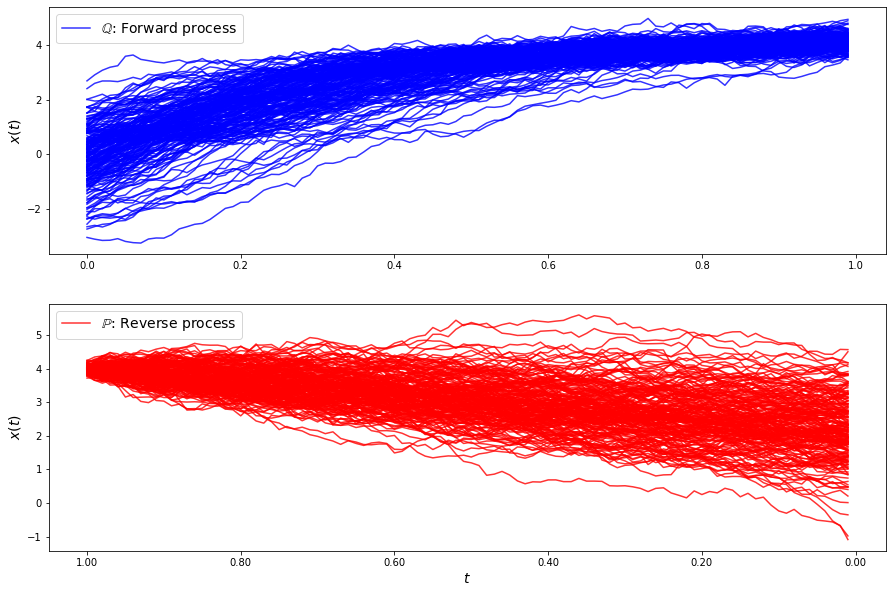

loss b 8.68402906392769
loss b 8.518311947867149
loss b 8.010696705072569
loss b 8.343885675972587
loss b 6.780644771865054
loss b 6.907821959428617
loss b 6.293125087521502
loss b 6.377224847617272
loss b 5.6119954562100185
loss b 6.184734547933763
loss b 5.833277381017462
loss b 6.4071149152192834
loss b 6.128279343370984
loss b 6.3227039472857784
loss b 6.419470487842035
loss b 7.032534721248524
loss b 7.766821759551189
loss b 8.720276294062222
loss b 9.543370824764535
loss b 9.258288122528311
loss b 10.211292267050373
loss b 10.901928816688029
loss b 12.055571929283479
loss b 12.66641876979067
loss b 14.197739740385131
loss b 13.991322326643454
loss b 14.677468594946298
loss b 14.506364978571202
loss b 15.300211056339954
loss b 15.452527272856956
loss f 13.313623099216715
loss f 12.646621845492033
loss f 15.069917841270604
loss f 12.674899852424087
loss f 13.128589754897432
loss f 15.384910711601774
loss f 13.183089777084154
loss f 13.622085500224342
loss f 13.239217034303593
loss 

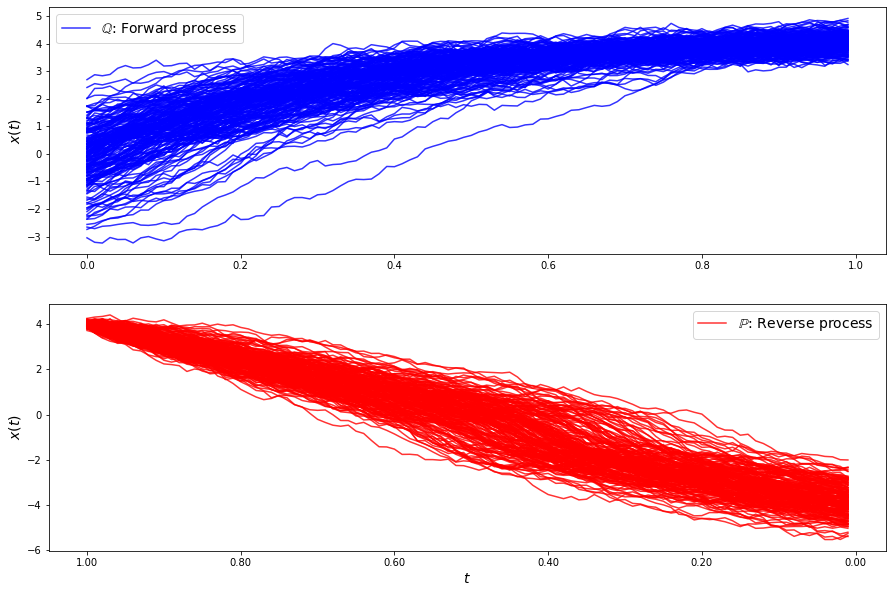

loss b 16.65142639864905
loss b 15.69235276249228
loss b 16.616911650998343
loss b 17.150208418581656
loss b 18.041513072096883
loss b 17.324654269490907
loss b 17.862923465250805
loss b 18.466395808089924
loss b 18.211421719789303
loss b 18.750123959557737
loss b 19.09203410838607
loss b 18.695744542704347
loss b 19.31692872414711
loss b 20.049793167046786
loss b 20.156375274100597
loss b 20.670721058114697
loss b 21.072915801843948
loss b 21.163311992187275
loss b 21.66214417623198
loss b 21.92541414779937
loss b 22.889369171396595
loss b 22.515963875212954
loss b 23.44839226405228
loss b 24.124284375100164
loss b 24.407506726922712
loss b 24.782765710276035
loss b 25.24636158945581
loss b 26.183086514474528
loss b 26.634843125264737
loss b 27.13617841067723
loss f 44.70864159244411
loss f 43.682780959145575
loss f 44.96931246586286
loss f 46.022783393785765
loss f 45.270783675383285
loss f 45.672161498091164
loss f 45.40072515337468
loss f 45.234372194477615
loss f 44.73412121373891

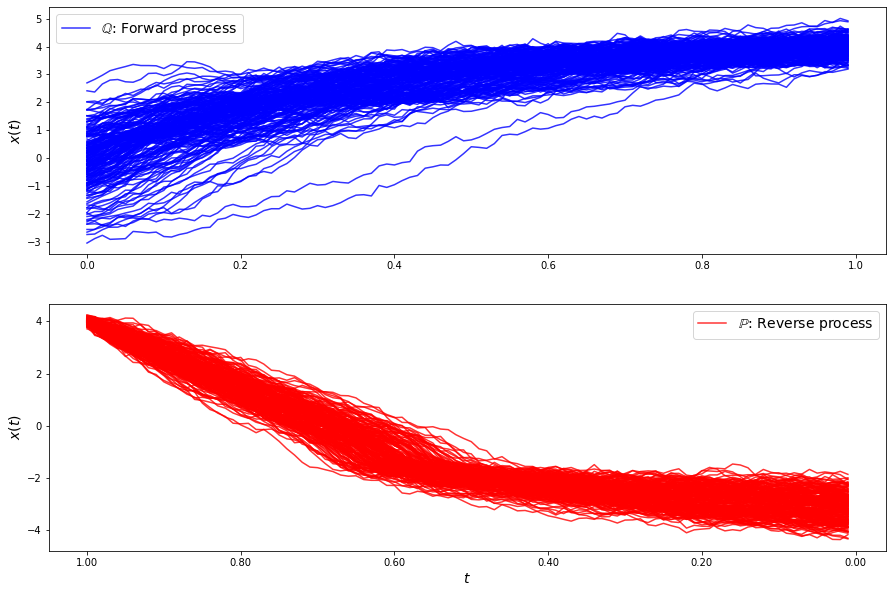

loss b 26.26398997772757
loss b 27.024486852215503
loss b 27.350063342546946
loss b 28.279578072001925
loss b 28.645959825680606
loss b 29.386364865096077
loss b 30.067610748930907
loss b 30.65899805598601
loss b 31.224830370721794
loss b 31.980946242507834
loss b 32.556469057547716
loss b 33.57424942951262
loss b 34.47938124809443
loss b 34.73906556291609
loss b 35.58680289929226
loss b 36.504820620363084
loss b 36.77827172036289
loss b 37.379811932856
loss b 38.1405695460815
loss b 38.91312244324227
loss b 39.1285602584196
loss b 40.06543419974615
loss b 40.361532567200975
loss b 41.09587363081561
loss b 41.582207046070124
loss b 42.428776464047004
loss b 42.88924336993439
loss b 43.04661380824865
loss b 43.582966209134845
loss b 44.022290636021125
loss f 83.50317478212187
loss f 83.24709760359765
loss f 81.59788743502013
loss f 84.27262913522016
loss f 83.02082578062027
loss f 84.12467426365355
loss f 82.27466017107749
loss f 82.46730836514506
loss f 84.02012341103148
loss f 82.3429

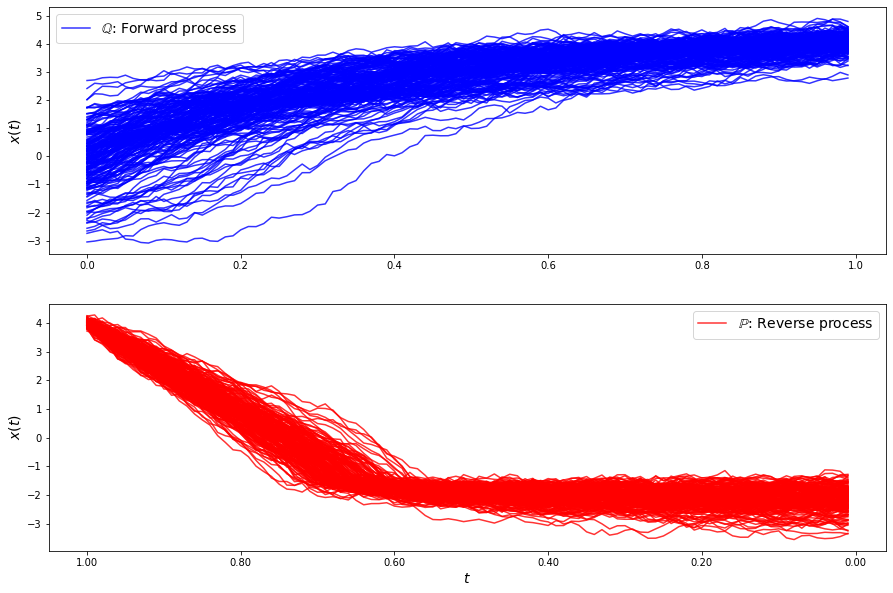

loss b 38.69613615363465
loss b 39.005237297279926
loss b 39.52116027334206
loss b 40.069672276982104
loss b 39.58320307245651
loss b 40.591272611387915
loss b 40.477389658313804
loss b 40.819941492024256
loss b 40.79565143047037
loss b 41.59225453970596
loss b 41.84890444679334
loss b 41.97777579148121
loss b 42.08465524128197
loss b 42.38368052548066
loss b 42.91766882174102
loss b 42.998025031155954
loss b 43.28756085307005
loss b 43.60903911037865
loss b 43.767228731272276
loss b 43.66382698592175
loss b 44.1026451716504
loss b 44.3480210279515
loss b 44.01425307749091
loss b 44.76158036052766
loss b 44.84437026858764
loss b 44.84428359599076
loss b 45.00413686325403
loss b 45.12289144037684
loss b 45.14867622480488
loss b 44.81440232729923
loss f 89.9928797993187
loss f 89.36528213610187
loss f 87.8925495274387
loss f 90.36785715437453
loss f 88.04118068626688
loss f 89.13966021466975
loss f 88.37577395449462
loss f 89.33915581149658
loss f 88.89052340829505
loss f 87.258234209143

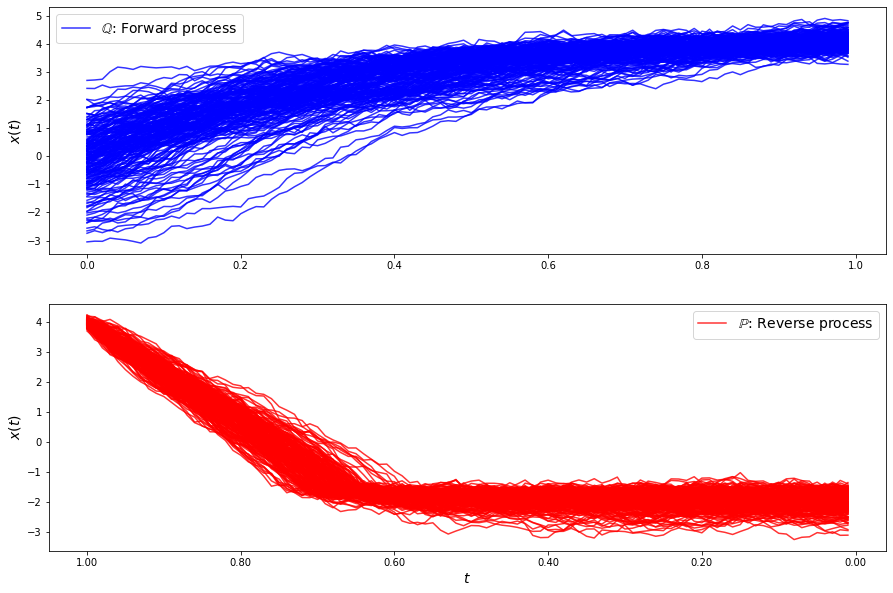

loss b 38.55220286467505
loss b 38.46537354060532
loss b 38.930319736745226
loss b 38.669974263926235
loss b 38.804638714529375
loss b 38.560985601077796
loss b 38.461317092453186
loss b 38.16822346210837
loss b 38.45660530896755
loss b 38.039118361892406
loss b 38.03801339557311
loss b 37.60145303080725
loss b 37.506213756215345
loss b 37.60222284548717
loss b 36.83076955039347
loss b 37.13057096886072
loss b 36.92436854109439
loss b 36.5390041100913
loss b 36.412008166031065
loss b 36.10638626365026
loss b 36.01430721101452
loss b 36.11514828083017
loss b 36.14762143153132
loss b 35.36120122886821
loss b 35.609125188738865
loss b 35.101019400801256
loss b 34.737505194164285
loss b 34.51916923676192
loss b 34.220080435280266
loss b 34.131166003716714
loss f 77.98804498459825
loss f 79.03045521380788
loss f 77.89182742974312
loss f 78.40000935856577
loss f 76.62625005039098
loss f 79.14033958467598
loss f 79.75781962895266
loss f 80.52915545622457
loss f 78.27194678704457
loss f 77.308

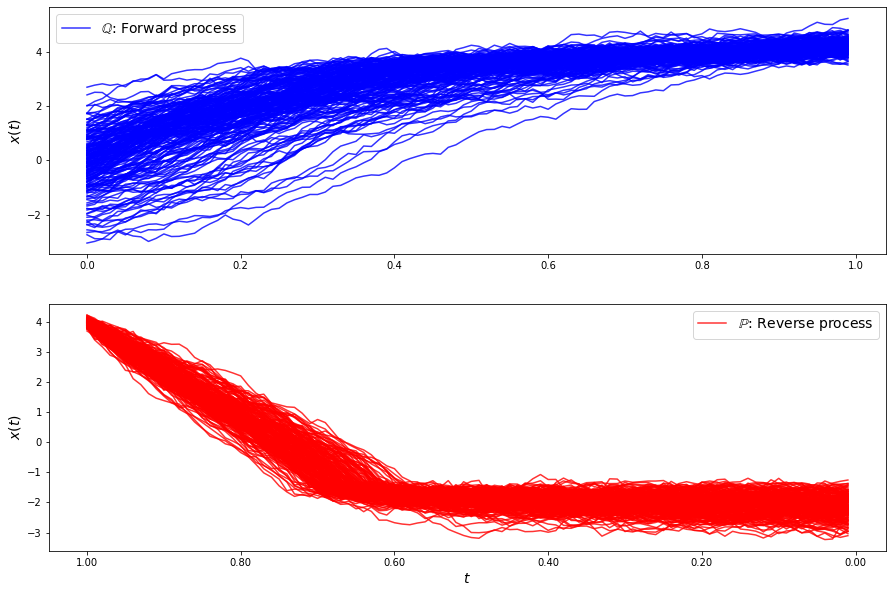

loss b 26.77201449831157
loss b 26.641839895282644
loss b 26.11990321653728
loss b 25.90374637065464
loss b 25.4660390277715
loss b 25.188982240787247
loss b 24.581365560826857
loss b 24.080238650486184
loss b 24.01107252378257
loss b 23.365989138641122
loss b 22.74141259063672
loss b 22.35341140598584
loss b 21.880007915078043
loss b 21.396729520583353
loss b 20.889710975438394
loss b 20.40082321822113
loss b 19.89405060123971
loss b 19.50397817271891
loss b 19.192437007988644
loss b 18.835503110970123
loss b 18.49523199270869
loss b 17.841967890759896
loss b 17.609215291503503
loss b 17.377269276481748
loss b 17.13914960230051
loss b 16.625638777740217
loss b 16.469789211176643
loss b 16.34522533495751
loss b 15.890787521962295
loss b 15.591205306677802
loss f 49.53305901119028
loss f 48.04589074880922
loss f 44.861325252703885
loss f 46.95851503196835
loss f 47.07611227280319
loss f 46.33098329296504
loss f 46.0459761151041
loss f 46.11484312517934
loss f 46.49379697267752
loss f 45

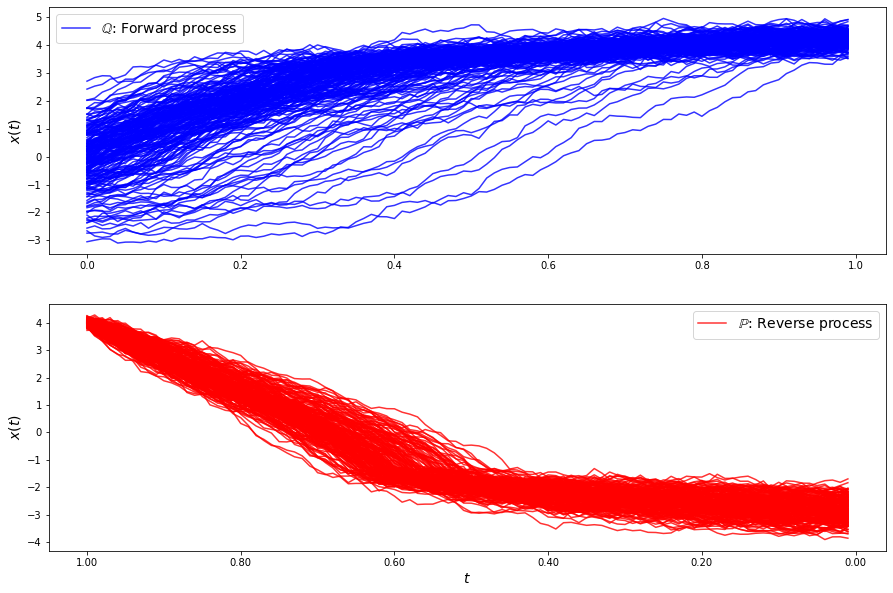

loss b 11.915945017971174
loss b 11.858072859278854
loss b 12.075664069926427
loss b 11.586163234747264
loss b 11.757570044836267
loss b 11.44395261139832
loss b 11.15509815674959
loss b 11.03788401414001
loss b 11.097300753628545
loss b 10.860423222048903
loss b 10.494156170619858
loss b 10.72951754591545
loss b 10.466142091171431
loss b 10.5534311432234
loss b 10.188598803530592
loss b 10.208605607601335
loss b 10.076274517439032
loss b 10.16995377675441
loss b 10.068859734708035
loss b 10.125951802164122
loss b 9.683540053882913
loss b 10.285673380841908
loss b 10.014638155314659
loss b 10.16145119478851
loss b 10.387304331474692
loss b 9.915434856126186
loss b 10.013239610756047
loss b 10.22470129956052
loss b 9.94649890695293
loss b 10.320900177964162
loss f 21.338099827274306
loss f 22.496412466648774
loss f 22.655734627777974
loss f 24.908267837900734
loss f 23.59139686523824
loss f 22.124696802697507
loss f 28.311842452052332
loss f 24.272379435073045
loss f 22.597677221991656


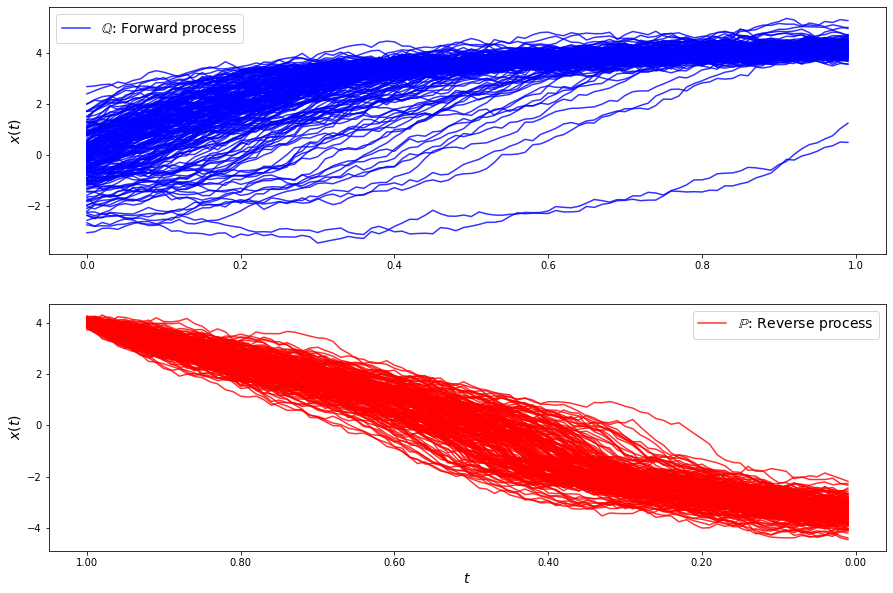

loss b 11.69429015768178
loss b 11.91443759812386
loss b 11.72186052870967
loss b 11.69758048905937
loss b 12.323408347840711
loss b 11.86212666215797
loss b 12.682351526148649
loss b 12.707985454986732
loss b 12.47361604440226
loss b 12.522956115545
loss b 12.693098132435287
loss b 12.195626076551918
loss b 12.562405143814432
loss b 12.309510275852967
loss b 12.390475272414195
loss b 13.209587009522386
loss b 12.733540741842395
loss b 12.673824096601463
loss b 11.908682866399657
loss b 12.498611349390847
loss b 12.871011188028652
loss b 12.143883153139045
loss b 12.47087427934952
loss b 12.230457724880063
loss b 11.186707135305385
loss b 10.902704533928604
loss b 10.959931827188502
loss b 10.636646482204524
loss b 9.891909745604364
loss b 10.851351792758122
loss f 8.362449117853256
loss f 9.841924986713694
loss f 19.169098740505465
loss f 9.070025151592803
loss f 8.78220688483189
loss f 8.389869212968378
loss f 8.188980435448684
loss f 11.724201628552718
loss f 17.377597977849224
loss

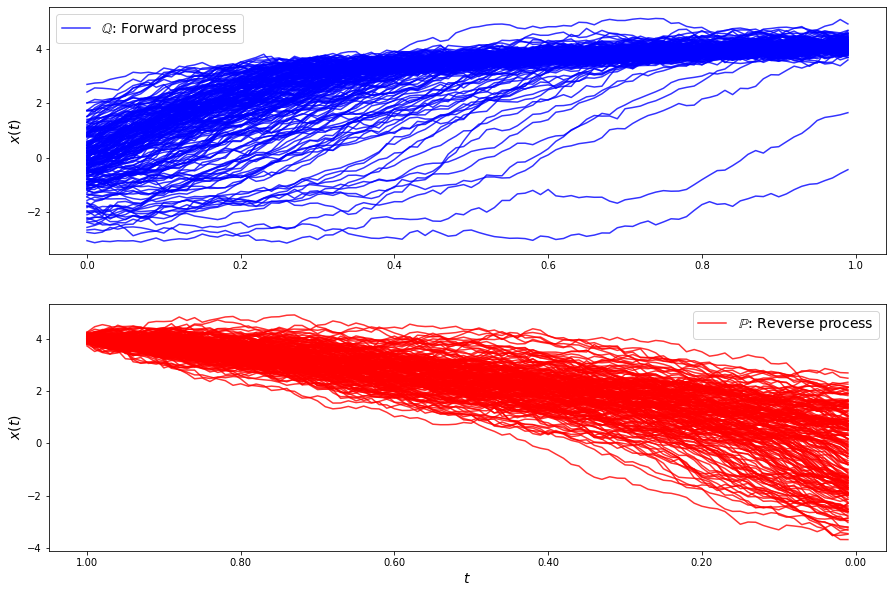

loss b 11.717359007277159
loss b 11.402990310306762
loss b 10.991324001789092
loss b 10.876951083812832
loss b 10.583802425619009
loss b 10.199371185004546
loss b 10.401641777338547
loss b 10.518906478825997
loss b 10.612200755373683
loss b 10.849986347876897
loss b 9.953681472380406
loss b 10.904149185433674
loss b 10.995482938704978
loss b 11.654125475382232
loss b 11.573708174157433
loss b 12.83968637417607
loss b 13.236081127093241
loss b 13.441889282286835
loss b 15.584472287994855
loss b 15.538869053052341
loss b 17.579185692540747
loss b 19.124562217295356
loss b 22.387617476619912
loss b 21.47038028642524
loss b 22.540530155832048
loss b 26.536625425371202
loss b 26.932995379088112
loss b 30.15498203989596
loss b 32.79867320403084
loss b 34.43163716358848
loss f 21.20808329798531
loss f 29.903784620592248
loss f 24.642195784945745
loss f 18.46579113628717
loss f 20.006151310817355
loss f 26.29001745749201
loss f 20.269511509231947
loss f 18.76156515833998
loss f 20.738093428980

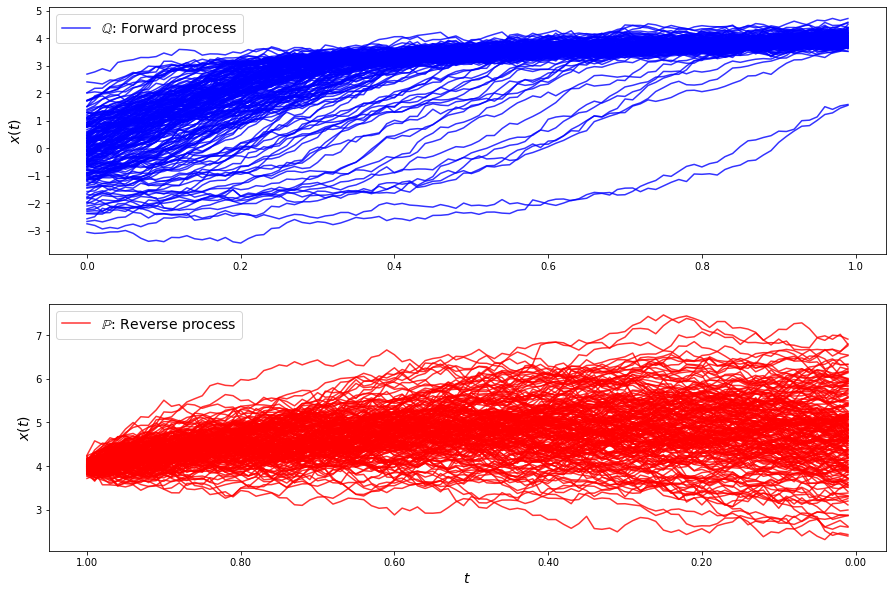

loss b 35.54167700243582
loss b 38.880983716540186
loss b 37.31916455789741
loss b 40.46943540952299
loss b 39.84246073180283
loss b 43.18356569723347
loss b 40.57993429691901
loss b 42.157539940917175
loss b 40.57897799542281
loss b 40.1197531267987
loss b 41.52383652626335
loss b 36.86462861599414
loss b 39.6482413673727
loss b 36.54545517653723
loss b 40.46823318258433
loss b 40.39914781149198
loss b 39.06898921767791
loss b 35.2800739783804
loss b 35.021292167261045
loss b 38.40311235589248
loss b 36.16292673806589
loss b 32.40234480786105
loss b 33.81052149309756
loss b 33.85107896614436
loss b 33.268629558301775
loss b 32.66359640251446
loss b 32.33840243004139
loss b 31.714429601600223
loss b 32.983112974111705
loss b 30.6853411651851
loss f 20.045206776612268
loss f 19.7343320836351
loss f 23.552160962408966
loss f 28.51560759466151
loss f 29.31239796268669
loss f 20.56108228942878
loss f 19.189211456460573
loss f 19.816969456533595
loss f 22.47865480406348
loss f 21.1742203010

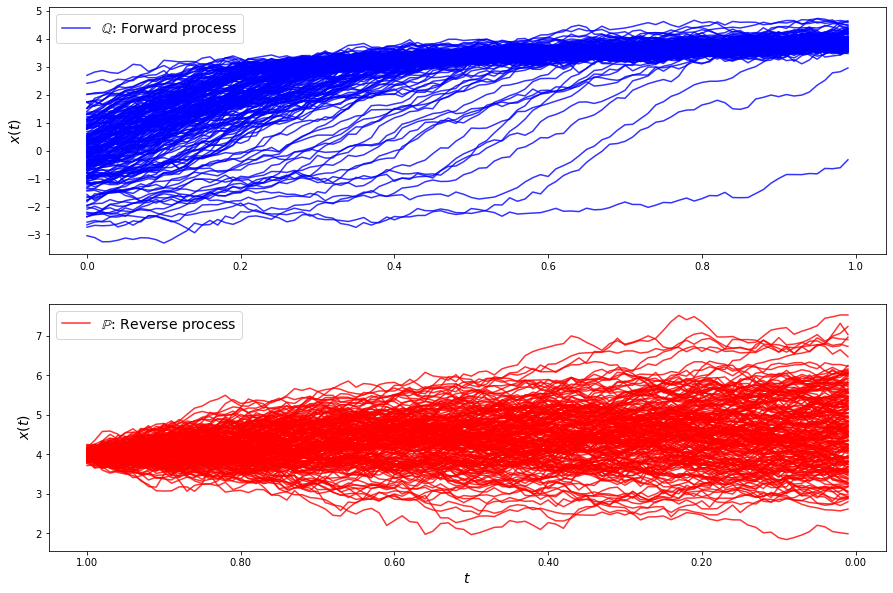

loss b 32.49576985339466
loss b 34.047555395800856
loss b 33.23232875734093
loss b 33.74159521086578
loss b 34.439545445048154
loss b 34.7556798191718
loss b 37.80896970789424
loss b 35.289155337501626
loss b 34.12506125399726
loss b 33.29164551354286
loss b 38.69738136678891
loss b 34.92836507065658
loss b 33.77797154352917
loss b 35.173933132915344
loss b 35.54231828375908
loss b 35.26023098471637
loss b 35.37210854241502
loss b 33.29547434376816
loss b 36.819960456186536
loss b 36.32796153267753
loss b 33.09707706661539
loss b 38.584070558013394
loss b 37.49800595557355
loss b 36.498309487990525
loss b 33.82681914410113
loss b 35.854520980783
loss b 35.362633827225494
loss b 35.272764952738335
loss b 33.32987024734668
loss b 34.5323600649733
loss f 21.327354594599672
loss f 21.4504619231009
loss f 22.056504141048894
loss f 20.704561762311148
loss f 29.633518583112902
loss f 21.97371265587332
loss f 20.70484247277086
loss f 21.652266115712305
loss f 21.053421901126523
loss f 21.70944

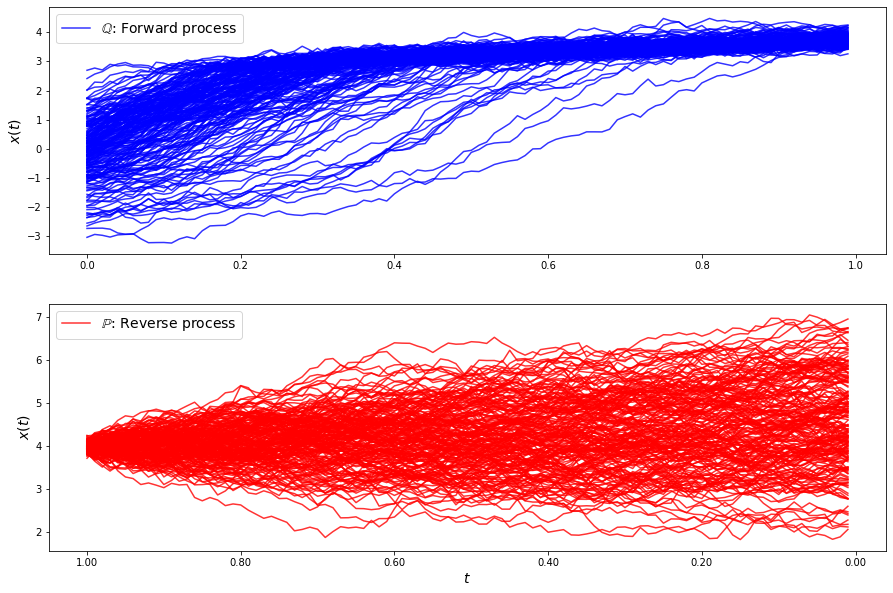

loss b 33.01259435818045
loss b 33.08004405887496
loss b 34.268370509459096
loss b 31.725470323913427
loss b 33.555315027923285
loss b 31.875764092149176
loss b 31.201610340516797
loss b 30.512623619172906
loss b 31.710020032505835
loss b 29.19329800017503
loss b 29.453889311213228
loss b 29.884813369574676
loss b 26.651379367727017
loss b 25.695401040843944
loss b 27.168003209866683
loss b 26.514914398882233
loss b 25.629221495687595
loss b 24.410916690405056
loss b 26.186762521470893
loss b 25.162705720067507
loss b 21.832973765685242
loss b 19.702826734999583
loss b 20.635242279955133
loss b 19.13839540622379
loss b 19.99020035754528
loss b 18.16447896263337
loss b 20.15435760367835
loss b 17.583527258488978
loss b 18.162955918805935
loss b 17.36989690697934
loss f 17.61627349022491
loss f 16.61282131948828
loss f 16.410847613749137
loss f 16.738706266260092
loss f 17.587560488345517
loss f 16.98763883698077
loss f 18.088672370896848
loss f 16.47249359313466
loss f 17.31481015584838

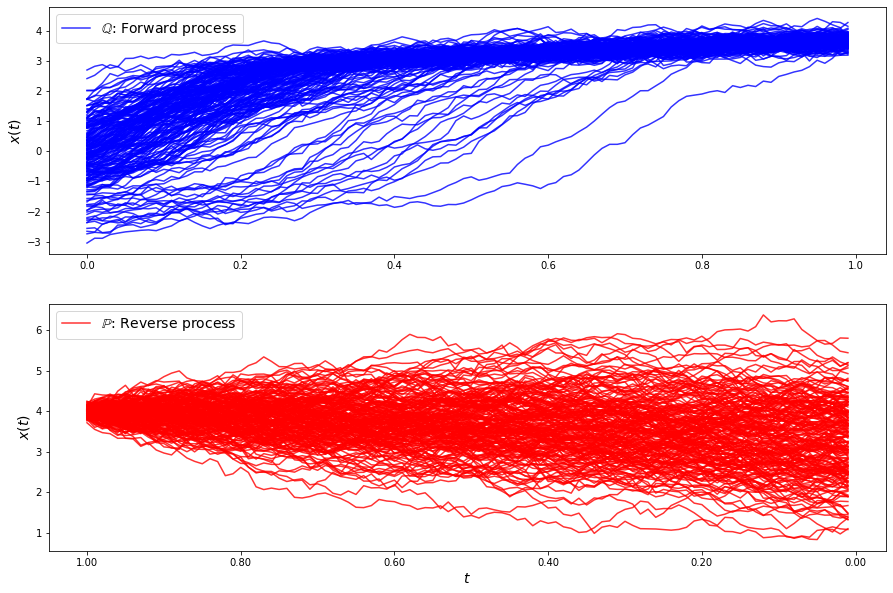

loss b 16.048727571289636
loss b 16.39677760227895
loss b 16.47110174565987
loss b 16.461060003070244
loss b 17.009573369517742
loss b 16.447315250335794
loss b 16.168060175020514
loss b 15.66657644709552
loss b 15.498503708097818
loss b 14.581407928071577
loss b 15.407788001278613
loss b 15.148336533798595
loss b 14.478508392917055
loss b 14.260190687908015
loss b 15.4020705941864
loss b 14.868167699428462
loss b 15.029684515211429
loss b 13.527926638743136
loss b 14.921480503848413
loss b 14.168455625249093
loss b 14.297330384814627
loss b 14.763397422631874
loss b 14.364995612738626
loss b 14.701739071057279
loss b 13.043198609924179
loss b 14.976966763099632
loss b 15.617159415076419
loss b 15.911976092270942
loss b 15.861567520378442
loss b 16.139054909819798
loss f 13.772661585778689
loss f 13.787587561771682
loss f 14.486060413549403
loss f 14.249858030651227
loss f 13.944837210965614
loss f 14.470693773830597
loss f 13.369242616553116
loss f 14.212087985205265
loss f 14.3992091

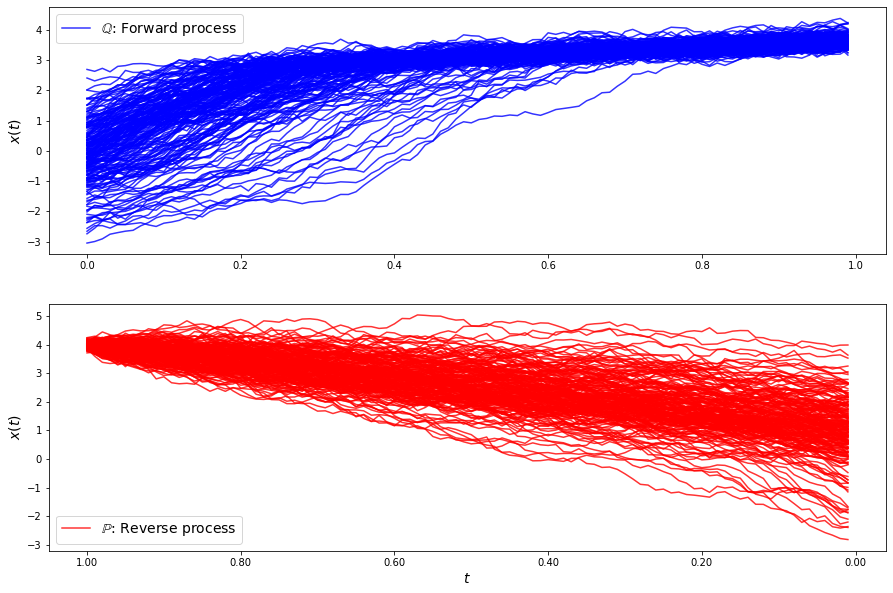

loss b 12.843530808336581
loss b 14.69387831047042
loss b 14.535122867265994
loss b 14.397248876977946
loss b 14.543685918935829
loss b 14.993097470404008
loss b 14.506937090365172
loss b 15.024029586965968
loss b 14.982365985884263
loss b 15.041744940214407
loss b 15.966798985280668
loss b 16.55545253948638
loss b 15.385013039067747
loss b 15.840318676833757
loss b 16.27809807666031
loss b 15.819558762305963
loss b 16.80919934875478
loss b 16.71905588140681
loss b 16.61040522494997
loss b 16.325985593731087
loss b 17.819636837486122
loss b 17.052122174736102
loss b 16.851308030021762
loss b 16.82418626450316
loss b 17.46852493256701
loss b 17.2226444638316
loss b 17.38328042139047
loss b 17.58877438421698
loss b 16.667325923158955
loss b 17.306649994512824
loss f 16.14284366288016
loss f 14.955177287049823
loss f 15.05759775732132
loss f 15.14452024326325
loss f 15.93342761392613
loss f 15.135776894019683
loss f 15.860720599672133
loss f 15.043324724010068
loss f 15.068334932903884
lo

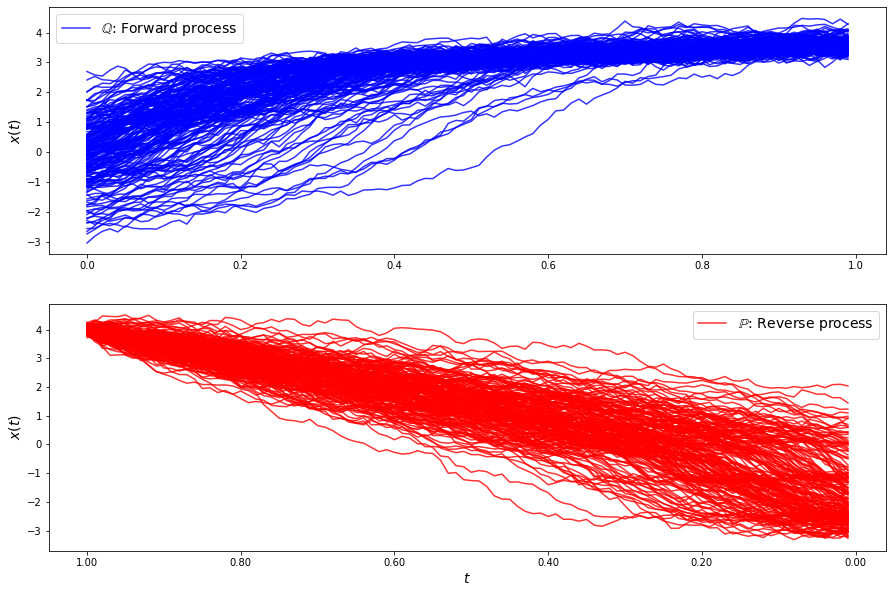

loss b 15.650900627951184
loss b 15.656119373642602
loss b 15.910800510018547
loss b 16.242168826653423
loss b 15.332347466984086
loss b 15.533931990829297
loss b 15.949575050152173
loss b 16.181199205981606
loss b 16.216757560826288
loss b 16.456240944205447
loss b 15.92470425668348
loss b 15.917222288437717
loss b 15.650520852648985
loss b 15.93223713923325
loss b 15.893080185216002
loss b 16.128938700176718
loss b 16.09932709279837
loss b 15.878664114317543
loss b 15.882715788741976
loss b 15.890530756777096
loss b 16.237740449794806
loss b 15.868407222594024
loss b 16.4265025536659
loss b 16.269899950670254
loss b 15.660630693673248
loss b 15.617539225613752
loss b 15.924187320557158
loss b 15.817090236795059
loss b 16.32684234533375
loss b 15.632432217105622
loss f 19.879022405224863
loss f 19.92396439069406
loss f 21.205361251021014
loss f 20.154418462950545
loss f 19.630883110596553
loss f 19.65815746078063
loss f 19.785839463979187
loss f 19.767478687755204
loss f 20.6540972521

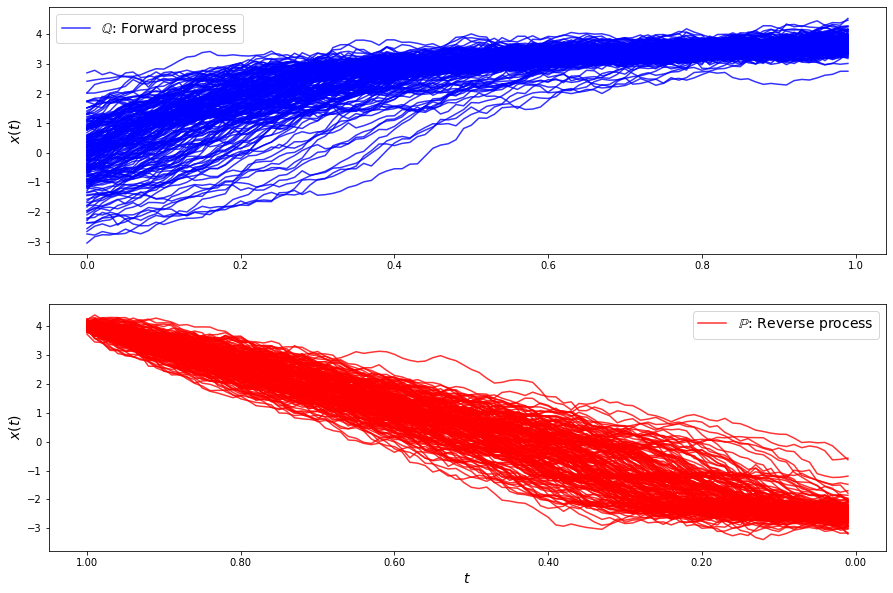

loss b 14.03947542005134
loss b 14.682510465870324
loss b 14.566536821458765
loss b 14.7968778855657
loss b 14.637348693793001
loss b 14.86009056008818
loss b 14.523692632651366
loss b 14.956926864001035
loss b 14.433603950760293
loss b 15.01014787711441
loss b 14.863989218536265
loss b 15.473640360871306
loss b 14.855599126543227
loss b 15.638620034573094
loss b 15.10086301097471
loss b 14.96109882187812
loss b 15.263714004624504
loss b 15.342446941013058
loss b 15.659142855950005
loss b 15.361978286951992
loss b 15.523299924606281
loss b 15.19093634595624
loss b 15.160606597633993
loss b 15.376014884973465
loss b 15.437181390175212
loss b 15.91516598036412
loss b 15.206602022427855
loss b 15.062247979050726
loss b 15.90228475404899
loss b 15.419717095869359
loss f 26.11900936891092
loss f 25.615002874536323
loss f 25.89363668713984
loss f 25.906566902069898
loss f 25.121133832424427
loss f 25.631974743719866
loss f 25.98583270815041
loss f 25.018453495019852
loss f 25.48681767181886


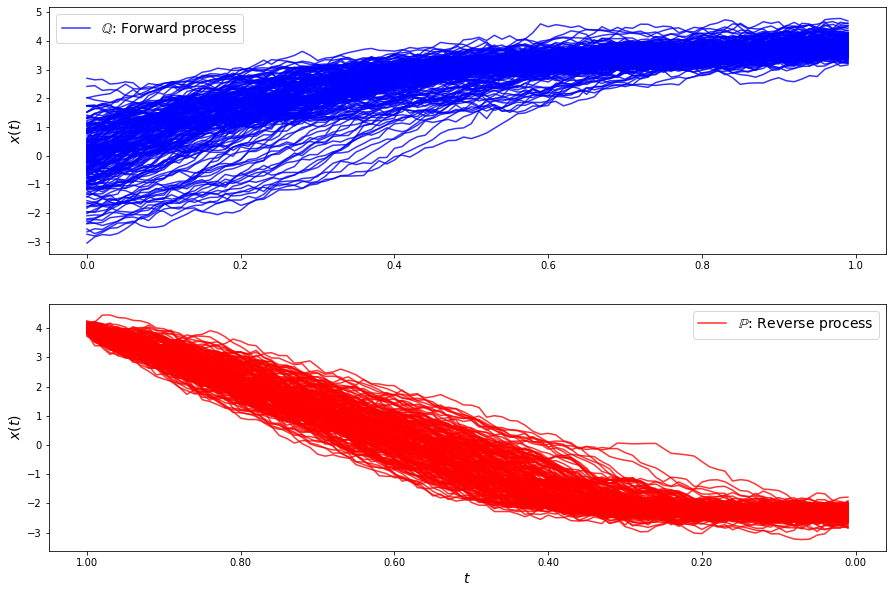

loss b 15.538547351181487
loss b 16.338089334889823
loss b 15.6203301392078
loss b 15.830832122259537
loss b 16.271534229329056
loss b 16.086538214265538
loss b 15.969012513748154
loss b 16.451257770951262
loss b 16.621276171759675
loss b 16.65117321643368
loss b 16.71125302140188
loss b 16.22624444148774
loss b 16.90341981748135
loss b 16.560126772702407
loss b 16.13365169122354
loss b 17.086595726336512
loss b 16.555023437809428
loss b 17.2047129059525
loss b 17.175725407555564
loss b 16.808001921403363
loss b 17.035888893203452
loss b 17.22570236970035
loss b 16.636567459280773
loss b 17.41999068029949
loss b 17.835070935762666
loss b 17.618573716686587
loss b 17.523921494797143
loss b 17.711179719908767
loss b 17.361951579917495
loss b 16.982379579353687
loss f 31.17824532633002
loss f 29.936657450814028
loss f 31.155857764922324
loss f 30.927265332439937
loss f 29.60826195598931
loss f 29.35394651202835
loss f 29.51809788562629
loss f 29.865971294748764
loss f 30.015812644283095
l

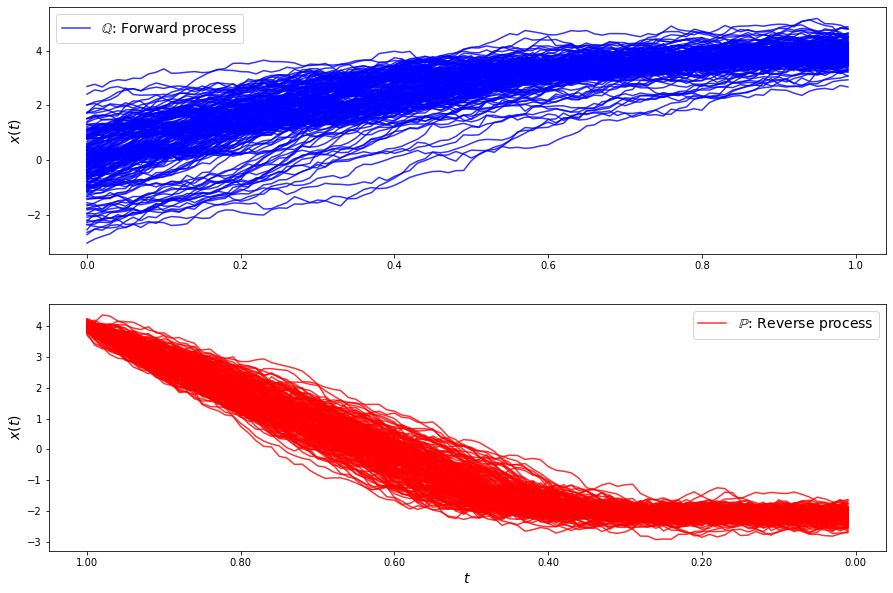

loss b 17.9588690806402
loss b 17.87114871290922
loss b 18.02528709707856
loss b 17.554188659003557
loss b 17.96975767378998
loss b 18.019521386056386
loss b 17.710248911721695
loss b 18.325861571342738
loss b 17.782640593046967
loss b 18.02699638090144
loss b 18.984807126141412
loss b 18.360807480347127
loss b 18.196155504380688
loss b 18.613198533550843
loss b 18.111672750664543
loss b 18.055525212106442
loss b 18.467913251049936
loss b 18.019932542901678
loss b 18.09878269174653
loss b 19.08243877768339
loss b 17.764531914290973
loss b 18.835014484741293
loss b 18.03701615684412
loss b 18.384015804312615
loss b 18.497794479398642
loss b 18.57485902613527
loss b 18.252204156080545
loss b 19.000051416453072
loss b 18.95320203279339
loss b 18.807048818794726
loss f 34.22746089899706
loss f 34.12155850792459
loss f 33.79608006539479
loss f 32.94456389074571
loss f 33.64206666873502
loss f 34.55370520510139
loss f 32.888502304898786
loss f 33.95987855578374
loss f 33.95325028963763
loss 

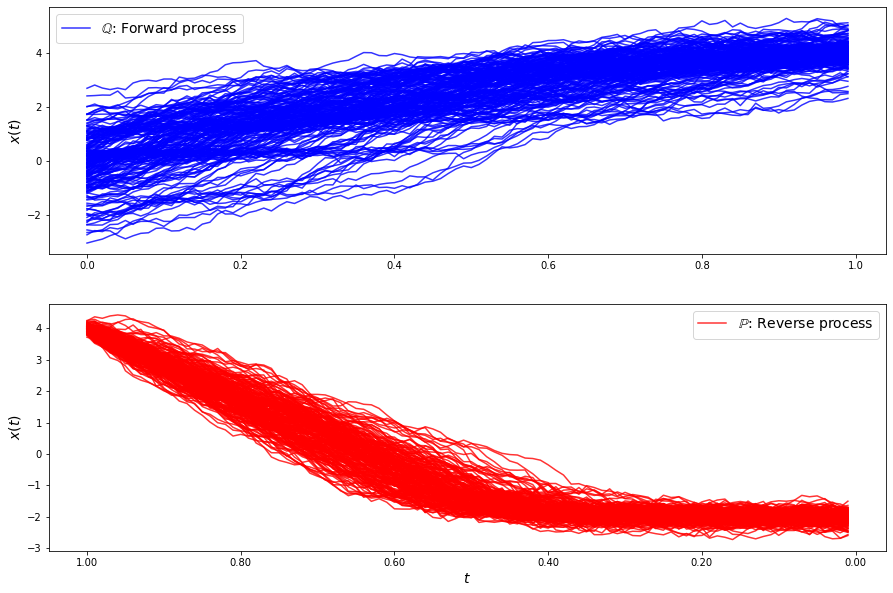

loss b 18.871843650910282
loss b 18.547014071600703
loss b 18.593615791601167
loss b 18.66997281815446
loss b 18.110963835367976
loss b 18.731745549738882
loss b 18.35070205560045
loss b 18.48324826622563
loss b 18.454514105212418
loss b 18.8632066708809
loss b 18.569798960241652
loss b 18.310267875165827
loss b 18.94550016977949
loss b 18.522589140004666
loss b 18.096020852395114
loss b 18.707280935637204
loss b 18.467242345527307
loss b 18.44641011979156
loss b 17.753097872720968
loss b 18.61287875154052
loss b 18.515510559474777
loss b 18.517650934623212
loss b 18.451384945559507
loss b 18.830352947080407
loss b 18.360951901708695
loss b 19.10200169799762
loss b 19.097381664019956
loss b 18.044070255010315
loss b 18.30792865408162
loss b 17.76820852211795
loss f 37.19308101404687
loss f 35.965885637764764
loss f 39.77624389074124
loss f 36.848528156136474
loss f 36.874029948075396
loss f 36.05195969851102
loss f 39.07883963370285
loss f 37.85409120631624
loss f 37.8999997805491
loss

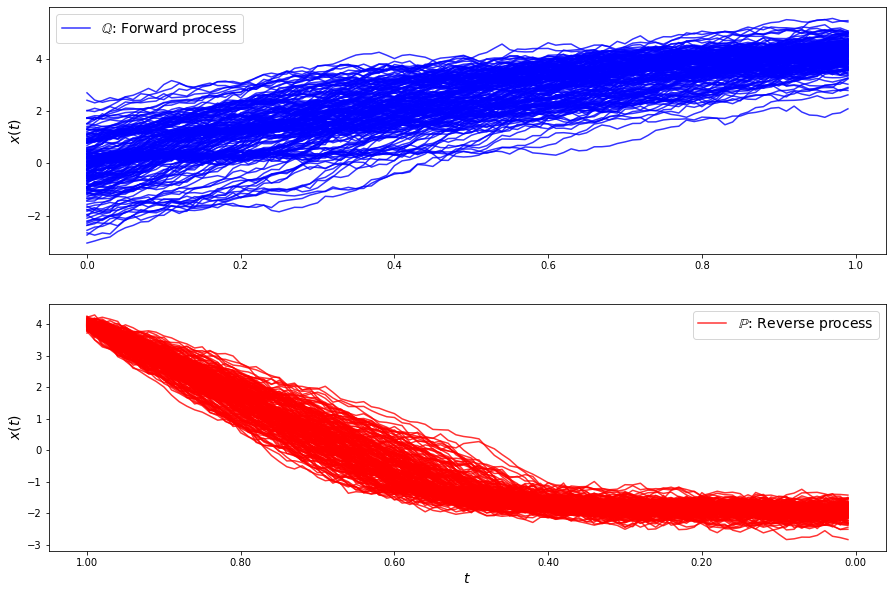

loss b 17.08422645964669
loss b 17.878624987128482
loss b 17.224583995457085
loss b 17.25605872865415
loss b 16.938849110529112
loss b 17.11499367201227
loss b 17.129850219111027
loss b 17.128948499532058
loss b 17.1251895255395
loss b 17.019314362413283
loss b 16.841810071359095
loss b 16.96047978985511
loss b 17.02263064077404
loss b 16.62848013348433
loss b 17.124016027533674
loss b 17.31942737364909
loss b 16.55969576295826
loss b 16.943469026279672
loss b 16.89090419134859
loss b 16.773129015101052
loss b 16.42799918592988
loss b 16.352451260022914
loss b 16.955614218850616
loss b 16.354953336718516
loss b 16.257650097859216
loss b 16.662417945503822
loss b 16.156386594535004
loss b 16.368104329882783
loss b 16.405808051689135
loss b 15.893033491703681
loss f 35.94285338728098
loss f 41.73300810076841
loss f 36.83228803318867
loss f 36.56768021870256
loss f 39.67622948641398
loss f 42.252431789194034
loss f 38.71448194443961
loss f 39.14751501822582
loss f 36.0848770624129
loss f 

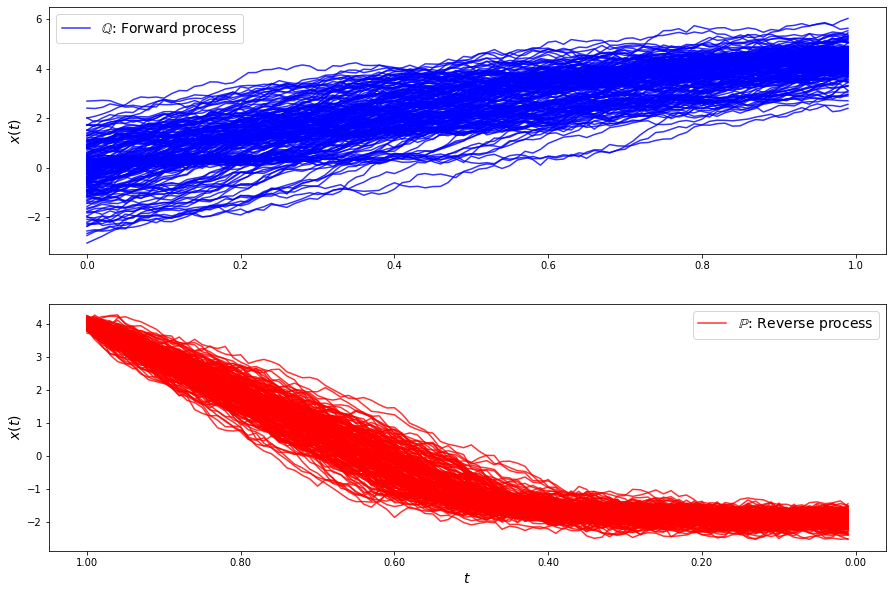

loss b 14.647328262220572
loss b 14.668192162779452
loss b 14.698006460714856
loss b 14.429076862841917
loss b 14.750789004169038
loss b 14.308446578059094
loss b 14.37232111855909
loss b 14.109195470886442
loss b 14.358376938111483
loss b 13.791102621531165
loss b 13.303761895478496
loss b 13.709222664452307
loss b 13.624857331663206
loss b 13.207835387101586
loss b 13.335929086661602
loss b 13.239274618114248
loss b 12.9101755883105
loss b 13.276975671978144
loss b 12.941207276409376
loss b 12.64672352013233
loss b 12.938774111848675
loss b 12.326970306761508
loss b 12.440232915973517
loss b 12.807492585791415
loss b 12.590427172566153
loss b 12.467123752296668
loss b 12.224403990328417
loss b 12.290612737327521
loss b 12.114517529771591
loss b 12.327432969742826
loss f 32.34730162720684
loss f 36.910106073570105
loss f 35.7043551923755
loss f 32.80813356539799
loss f 34.20831560000639
loss f 37.15918723520559
loss f 35.467332307859394
loss f 32.57527531272766
loss f 36.9825893208542

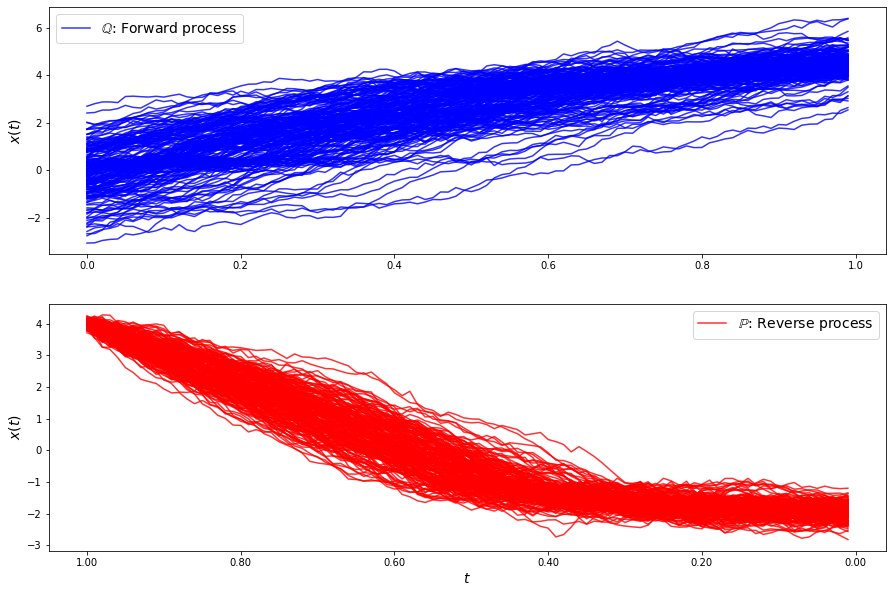

loss b 10.580170783421083
loss b 10.763409461947859
loss b 10.591805024633008
loss b 10.387851777815936
loss b 10.361932304165872
loss b 9.918357927486298
loss b 10.27454276542439
loss b 10.028758378442744
loss b 9.691209201215699
loss b 9.911414854796032
loss b 9.346685855133428
loss b 9.314201569794715
loss b 9.57567486847989
loss b 9.051586861110813
loss b 9.62240294963947
loss b 9.152338342742034
loss b 8.857588306256321
loss b 8.95175807308345
loss b 8.889890649202336
loss b 8.804942260552814
loss b 8.58446084708104
loss b 8.736275266542929
loss b 8.36465964531976
loss b 8.157631876223085
loss b 8.625091195392356
loss b 8.349245420226197
loss b 8.255453174558053
loss b 8.136575258944644
loss b 7.999333015900907
loss b 7.914229194865692
loss f 23.85397703778442
loss f 25.129608570671273
loss f 24.967183799843184
loss f 24.91324342423042
loss f 27.39415928787468
loss f 26.716112357331347
loss f 21.37179608824619
loss f 30.463181080961043
loss f 26.365916145101057
loss f 25.331458455

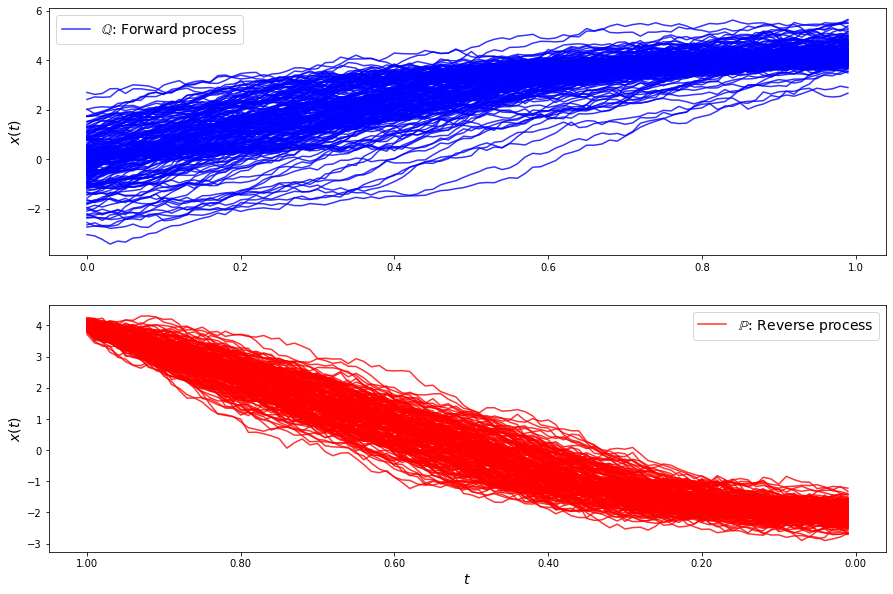

loss b 7.7905918344411225
loss b 7.4333762506320875
loss b 7.617196917060842
loss b 7.50904207319646
loss b 7.381507024466898
loss b 7.799733758374424
loss b 7.349858947571449
loss b 7.141550249245165
loss b 6.812005135720797
loss b 6.9503363825418285
loss b 6.526831129711957
loss b 6.78613776333336
loss b 6.665210037688148
loss b 7.088067296474923
loss b 6.489664302968316
loss b 6.805015645103909
loss b 6.493719727929048
loss b 6.668680006879448
loss b 6.211159156040389
loss b 5.921820337519921
loss b 6.27641765393447
loss b 6.1022634816710175
loss b 6.322543937948441
loss b 6.0761793762275245
loss b 6.046402523756275
loss b 5.909955674368077
loss b 5.6107122803643135
loss b 6.1078368170952
loss b 6.037893629181463
loss b 5.428593165045196
loss f 15.713056573314654
loss f 15.69468121917961
loss f 14.751208725114642
loss f 14.497172181706478
loss f 14.003883179305124
loss f 11.747085357561248
loss f 14.215357091561987
loss f 13.201831341025304
loss f 13.308004431523978
loss f 10.824082

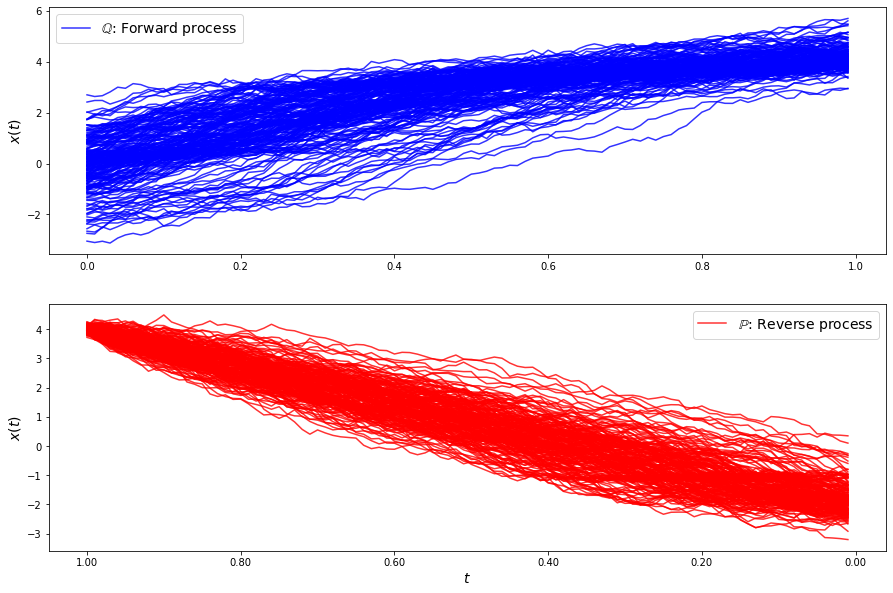

loss b 6.160054824432622
loss b 6.221142787829128
loss b 5.843956102486394
loss b 5.61075178000967
loss b 5.956567958509843
loss b 5.866558006034945
loss b 5.156570638294825
loss b 5.032128415626834
loss b 5.43224526599133
loss b 5.941298085974683
loss b 5.253173028038485
loss b 4.67273913510536
loss b 4.495380646938923
loss b 5.1751551766580945
loss b 5.296280698695794
loss b 4.857543493339458
loss b 4.6104709515789
loss b 4.434375912784893
loss b 4.168981575027958
loss b 4.665606768682183
loss b 4.133816760235327
loss b 3.560147557900219
loss b 4.265389453519473
loss b 4.034880020644339
loss b 3.7058142487474766
loss b 3.874875723595146
loss b 3.2395936813939934
loss b 3.565632723052177
loss b 3.4071340608710674
loss b 3.2268021881190174
loss f 7.824062005792943
loss f 6.804873211883055
loss f 5.9937374287233505
loss f 6.721811582044887
loss f 5.0864324985851175
loss f 6.924056969026519
loss f 5.547559082352868
loss f 6.632251710147785
loss f 7.31110740976639
loss f 6.025014125682405

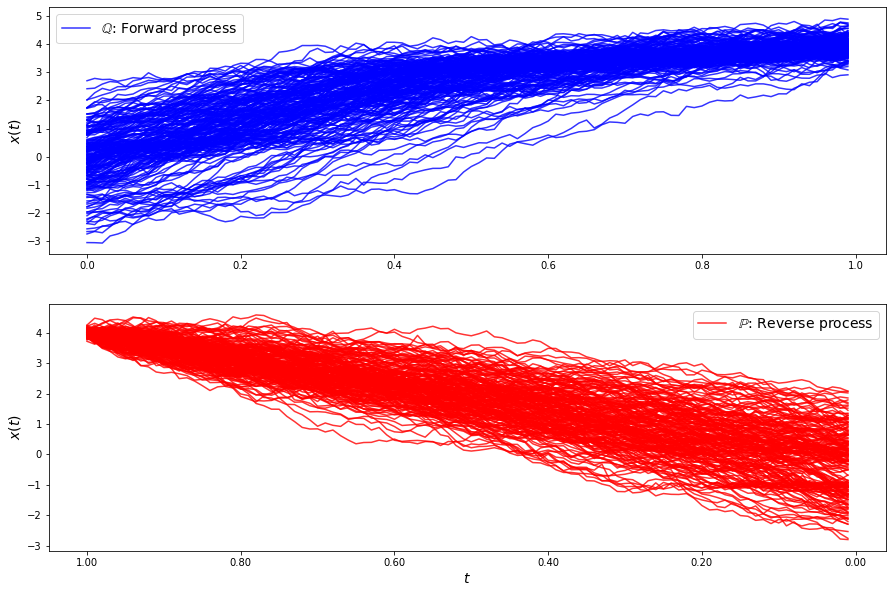

loss b 3.6666364634960993
loss b 3.7779143095338044
loss b 3.7240627949350324
loss b 3.4312972748339816
loss b 4.207795956048279
loss b 4.284034750139607
loss b 3.9906223649098034
loss b 4.018448320335994
loss b 3.324155959909155
loss b 3.510094779728494
loss b 3.836045179717301
loss b 3.210153047541052
loss b 3.766156108471449
loss b 3.739284137934529
loss b 4.279358556742078
loss b 3.5677401456625826
loss b 4.611237232221271
loss b 4.0082357026584345
loss b 3.9786911559594773
loss b 3.773959761426128
loss b 4.2516165490894915
loss b 4.7802900039135885
loss b 4.592189655894767
loss b 4.530197785071091
loss b 4.843968244768689
loss b 4.928768315299621
loss b 5.147364823033973
loss b 5.822174303406224
loss b 5.676162714595676
loss b 6.027680100795293
loss f 7.141025426983186
loss f 6.8861658719915395
loss f 7.1192393689140925
loss f 7.299815939123998
loss f 7.3797196915265975
loss f 6.595939767258924
loss f 6.054342443180475
loss f 6.855395311426207
loss f 7.429238411163764
loss f 6.703

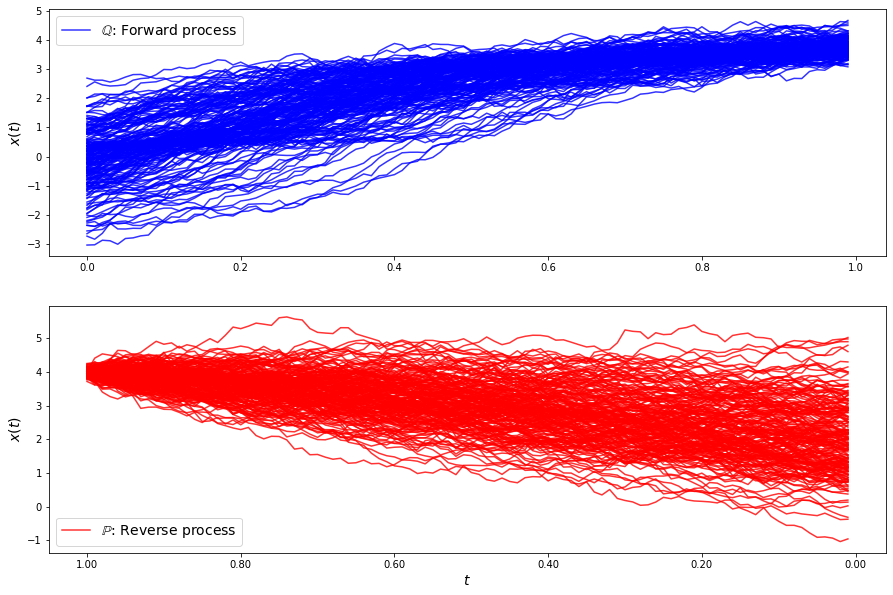

loss b 6.473148684131528
loss b 7.1231171144994985
loss b 6.469369020739715
loss b 6.17229808917509
loss b 6.437770663554104
loss b 7.592043814726728
loss b 6.739844275072049
loss b 8.014647205440715
loss b 6.949882607181998
loss b 7.902136554423964
loss b 7.969051712662586
loss b 8.338290267656985
loss b 8.609140037824439
loss b 9.126360715767333
loss b 10.015631965682317
loss b 9.53196317095479
loss b 10.95988018205513
loss b 11.20222460749037
loss b 12.280927223251606
loss b 11.488919958487951
loss b 11.77407051161652
loss b 12.523252554464715
loss b 13.209367062847788
loss b 13.65271115173374
loss b 15.252495475398707
loss b 15.686136630878702
loss b 16.166509939897175
loss b 14.65906960679399
loss b 17.738407126591735
loss b 17.92742001522635
loss f 12.137247686041414
loss f 12.836483388873674
loss f 13.26532176736192
loss f 11.944536591691783
loss f 11.872667856038984
loss f 12.27741834224445
loss f 12.93216108087669
loss f 14.45871533174627
loss f 13.330457830841294
loss f 14.03

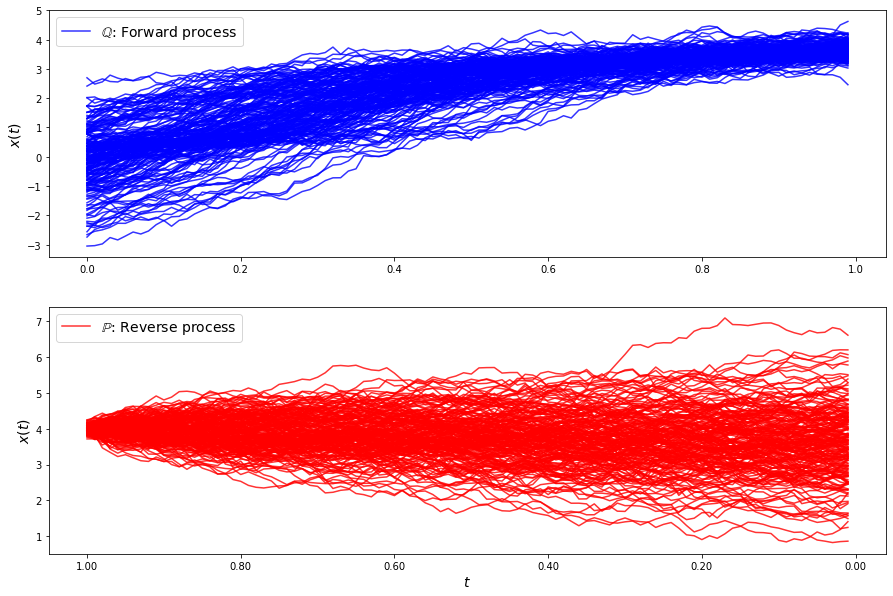

loss b 17.401394666923935
loss b 17.52133617758475
loss b 19.614516609526593
loss b 22.792743358361502
loss b 20.899011536347935
loss b 24.06213372895325
loss b 25.620474460689397
loss b 22.830393426281283
loss b 24.925185998706244
loss b 25.743422102668287
loss b 25.783272341324786
loss b 29.05045627253402
loss b 28.396892782497268
loss b 29.59258285226176
loss b 29.910102900296163
loss b 29.05845601945951
loss b 30.292038253754146
loss b 30.96249143805245
loss b 33.46271028274372
loss b 33.469094290498184
loss b 31.39503612539482
loss b 33.12940136625892
loss b 34.28949499868712
loss b 34.21442353128827
loss b 35.1765990347648
loss b 35.8848656916165
loss b 34.74264457856546
loss b 33.643713165574034
loss b 36.455949004161894
loss b 40.79771780666503
loss f 19.943542157232987
loss f 19.090924239068013
loss f 19.787245378876833
loss f 19.80596549172994
loss f 21.064560104789408
loss f 20.44876604770782
loss f 19.224215301535523
loss f 19.85237523099324
loss f 18.77563020617536
loss f 

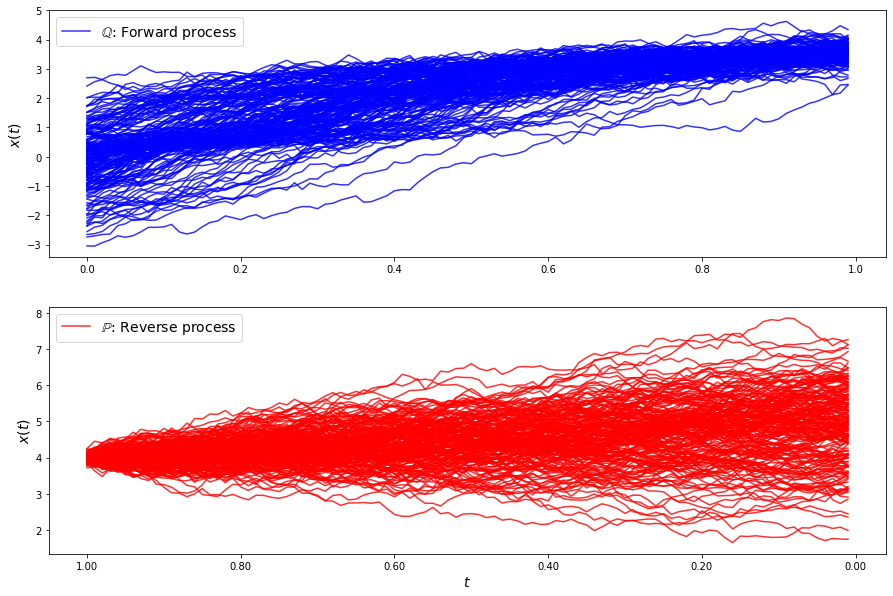

loss b 36.247802660253605
loss b 37.30369368228134
loss b 41.12341582974229
loss b 39.88943784934711
loss b 38.58240991266178
loss b 42.115102976732054
loss b 39.175720226029334
loss b 39.621858015444836
loss b 40.96239326320743
loss b 40.94272134132708
loss b 40.15332314275352
loss b 38.81410503782824
loss b 39.51821484630796
loss b 40.74107851400183
loss b 41.65380373464384
loss b 40.85367115440888
loss b 39.659273548428764
loss b 41.2233673051159
loss b 39.99521131863011
loss b 40.51686581534795
loss b 41.44031065093556
loss b 38.630536637537006
loss b 35.0762223173133
loss b 36.2083721199035
loss b 38.8436795199842
loss b 38.563694777235334
loss b 34.513239330598466
loss b 38.129165455444245
loss b 35.117710272432184
loss b 32.728535111443335
loss f 21.580727388372658
loss f 19.070596917042003
loss f 20.398759955066623
loss f 21.09507225457259
loss f 20.664993267018975
loss f 21.608814054965
loss f 20.851903888146214
loss f 19.47234399925898
loss f 22.328130075558473
loss f 20.2790

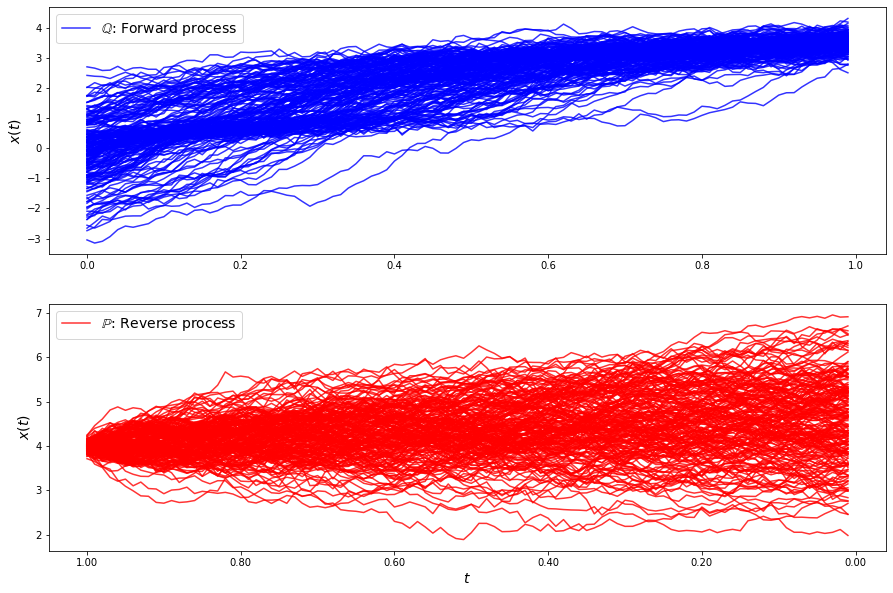

loss b 33.5048408655044
loss b 32.34090910544518
loss b 33.316801404232535
loss b 31.1641373271881
loss b 32.13028918782786
loss b 28.541816045506852
loss b 30.2255294213423
loss b 28.188051135662953
loss b 28.623204367312187
loss b 29.448113529116597
loss b 26.366293908979547
loss b 26.05371827063721
loss b 25.83063091703302
loss b 23.25009532154731
loss b 24.322691509663613
loss b 19.8560094141028
loss b 20.056236167397522
loss b 20.232619322127565
loss b 20.379191138503984
loss b 19.573543783668125
loss b 16.958285466887684
loss b 19.75194765664676
loss b 16.56021115996977
loss b 16.39525995627857
loss b 15.763547489579947
loss b 14.429242756265104
loss b 13.85279160220258
loss b 14.780431257966898
loss b 13.046342892994737
loss b 12.81815806244894
loss f 19.346546205887616
loss f 16.96894297006867
loss f 15.778807579814304
loss f 17.54297701667696
loss f 16.37279798401394
loss f 16.311629849866424
loss f 16.885379644635368
loss f 16.918816075676638
loss f 17.66573623277663
loss f 1

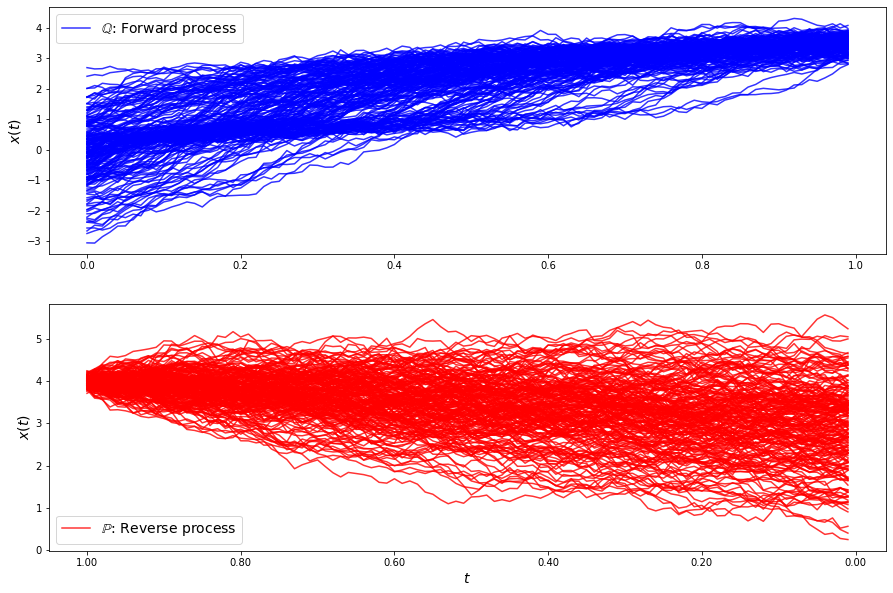

loss b 11.991057194757065
loss b 11.176734270397114
loss b 11.268087011457869
loss b 10.759225652943877
loss b 11.129666454019421
loss b 10.436312710156313
loss b 10.125792259632318
loss b 9.360512187271407
loss b 9.229766634831664
loss b 9.529171625966926
loss b 8.476847924929677
loss b 8.87885226818719
loss b 7.844448978097524
loss b 7.9415119561726835
loss b 7.727224908873589
loss b 6.5420274560945355
loss b 6.8525765148863
loss b 6.136272849402956
loss b 6.276425068731557
loss b 6.057089355017286
loss b 5.777301743199688
loss b 5.437899039343072
loss b 5.861309872122297
loss b 5.997015127860421
loss b 5.9467023723213845
loss b 5.805352860392609
loss b 5.673548304713381
loss b 5.375862488186701
loss b 5.565972064255659
loss b 5.571124909567301
loss f 13.468879074736448
loss f 14.121211333830608
loss f 13.888118515038125
loss f 12.089203794215095
loss f 15.756639983952013
loss f 13.711917487901625
loss f 16.026540533554236
loss f 13.12610767322173
loss f 13.434707552810137
loss f 12.

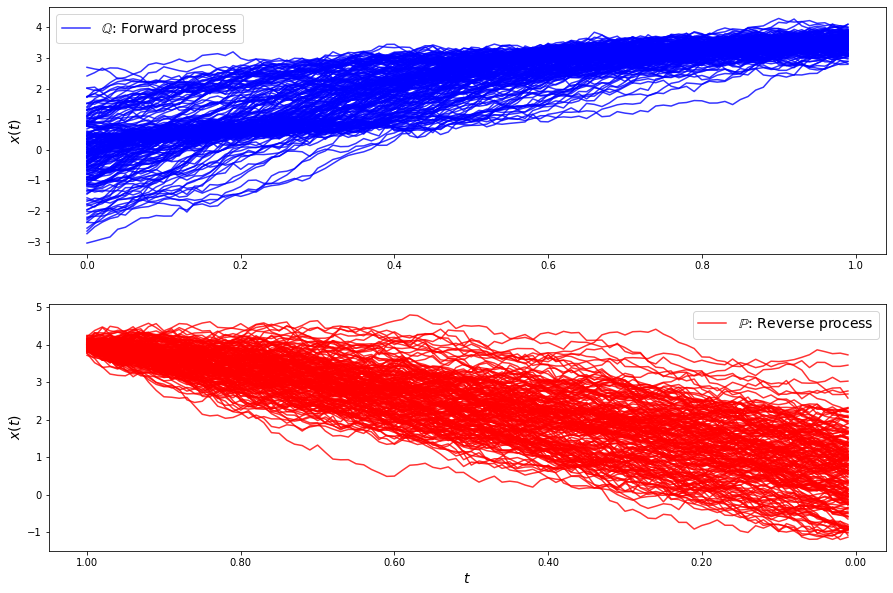

loss b 5.630584769330984
loss b 5.103735215044939
loss b 5.10196152954388
loss b 5.578391581663616
loss b 5.574579252533393
loss b 6.032159625483134
loss b 5.789257198317562
loss b 6.208565274654053
loss b 6.226671624057921
loss b 6.220948250340952
loss b 5.833079002557038
loss b 6.250174190446733
loss b 6.684718440877886
loss b 6.523760802290515
loss b 6.690397697694326
loss b 8.015531640441353
loss b 7.474028154054092
loss b 7.929908855798274
loss b 7.7459795742510495
loss b 8.131565167867612
loss b 9.040717427425601
loss b 8.392869133855639
loss b 8.04523647819361
loss b 9.415469213292834
loss b 9.911417265127742
loss b 10.209847823791723
loss b 9.87987800565083
loss b 10.813106179082267
loss b 11.360214991258106
loss b 11.498873454655966
loss f 14.17473422360698
loss f 14.319752938578652
loss f 16.48361994790386
loss f 14.817002777281402
loss f 14.534829783946803
loss f 14.900438579953507
loss f 15.666925179751104
loss f 12.72122720419824
loss f 13.39636284835845
loss f 14.65845576

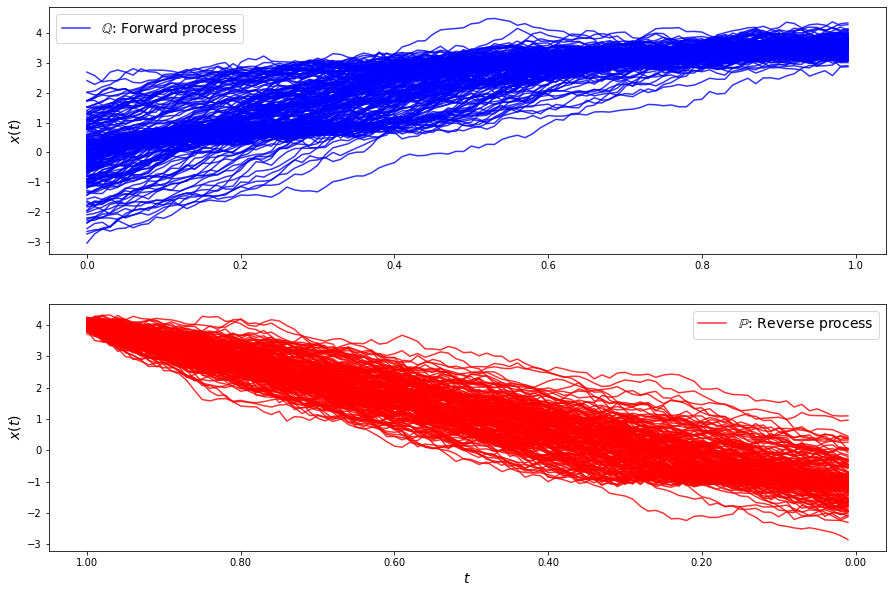

loss b 11.35356629307734
loss b 11.027869987408245
loss b 10.700130188995754
loss b 12.038399834582233
loss b 12.196781075539203
loss b 12.55098875632102
loss b 12.89635828024144
loss b 13.331297300918946
loss b 12.357346219827697
loss b 13.969828426554127
loss b 14.55632960736902
loss b 14.742766265943926
loss b 14.829879066489433
loss b 15.43351218295217
loss b 15.040639593819717
loss b 16.063208942845282
loss b 15.473265773707455
loss b 16.08278699410255
loss b 17.64765503530269
loss b 16.845755948816844
loss b 17.580993227426806
loss b 17.783121688163234
loss b 18.049899492781982
loss b 19.537548870898846
loss b 18.92539736448898
loss b 17.973068017513818
loss b 19.86032888500316
loss b 18.82040128830546
loss b 19.699516457475788
loss b 21.014777480495074
loss f 19.282292240335888
loss f 17.78785848407142
loss f 19.564777434526142
loss f 19.07442864282719
loss f 18.607874767389475
loss f 18.30423544816875
loss f 17.644414919494537
loss f 17.233872857956662
loss f 18.47442160479521


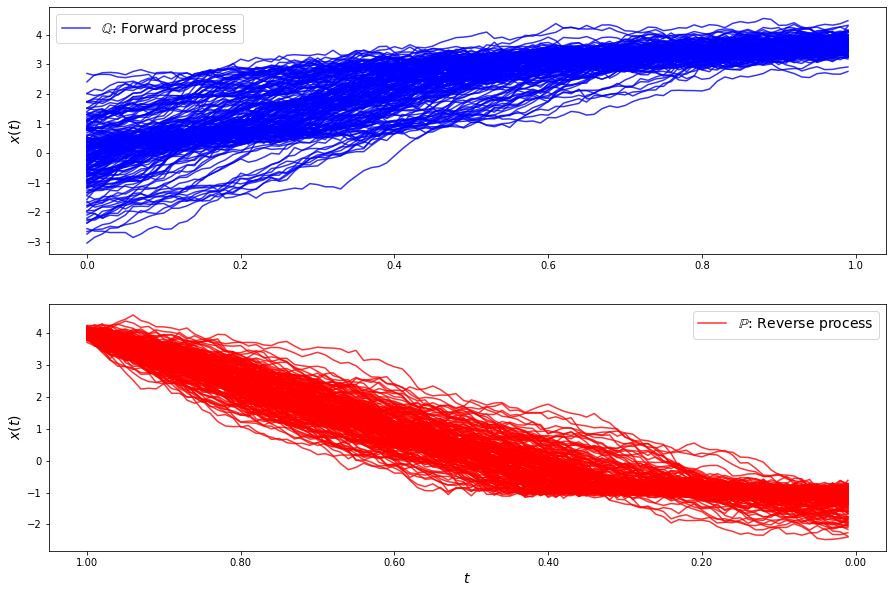

loss b 18.767359157721614
loss b 19.23702140331982
loss b 19.292873646440988
loss b 20.50903809892329
loss b 19.712205401280944
loss b 20.24324444912107
loss b 20.125070144512005
loss b 21.031823544254397
loss b 21.143674299539487
loss b 21.77912360560466
loss b 22.46609378566453
loss b 22.134267442606408
loss b 21.801186008829127
loss b 21.60076721982293
loss b 22.569259513591774
loss b 23.141284934194996
loss b 23.522427374107558
loss b 23.866432624684965
loss b 23.02544465220094
loss b 23.396359213509033
loss b 24.646648444598327
loss b 24.485990605308427
loss b 24.42953382403726
loss b 24.868504095320002
loss b 25.378439853487198
loss b 25.745299605869544
loss b 26.12668828989952
loss b 26.915028252798695
loss b 26.564270323849186
loss b 26.118420245350222
loss f 23.456756638051157
loss f 23.0723244957513
loss f 22.596403703831783
loss f 23.320312126136734
loss f 22.25115734101108
loss f 22.683266035316155
loss f 22.849948967077168
loss f 22.690652178685784
loss f 23.56369884867965

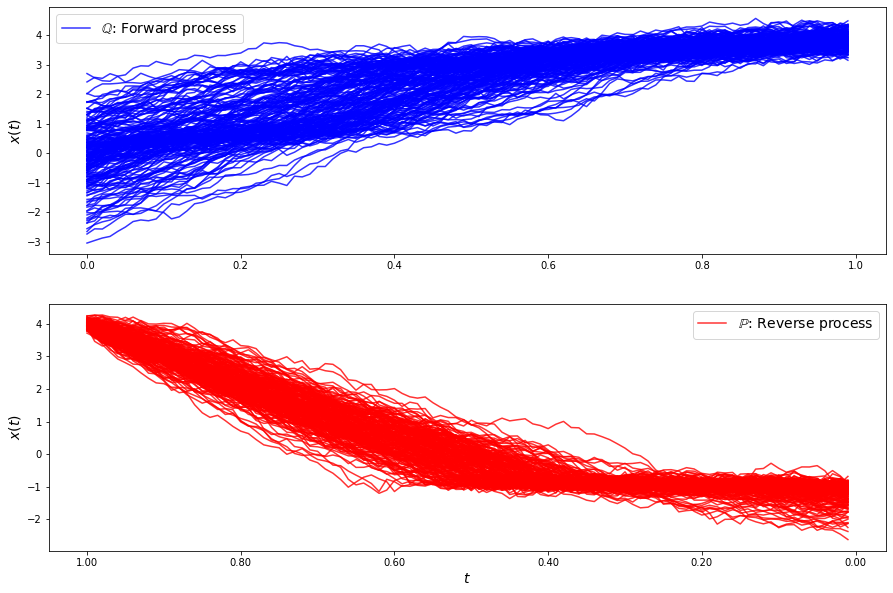

loss b 24.295322717821378
loss b 24.22412000082377
loss b 23.339129335572448
loss b 24.06187806834607
loss b 23.680778111764447
loss b 24.82001292931237
loss b 23.82144258729841
loss b 24.83979281467721
loss b 25.216540948402432
loss b 25.58923715388553
loss b 25.346474508923055
loss b 24.881460920535922
loss b 26.08002928767081
loss b 26.25644751761654
loss b 26.01975147864796
loss b 26.74141267516278
loss b 27.038118513159965
loss b 26.17638810931828
loss b 26.20485855594102
loss b 27.50812321307454
loss b 26.588536643674775
loss b 26.66483433950059
loss b 25.865937786499362
loss b 26.552843391522067
loss b 26.475397846835136
loss b 27.29513227817152
loss b 26.315972757587716
loss b 27.517770564692114
loss b 26.921918709066706
loss b 26.653094707067165
loss f 25.226972014974873
loss f 25.474396156921262
loss f 25.431376331934434
loss f 25.42757710835812
loss f 25.493344569972958
loss f 25.120502031998928
loss f 23.56005452309135
loss f 24.573735481185704
loss f 24.553992341046115
los

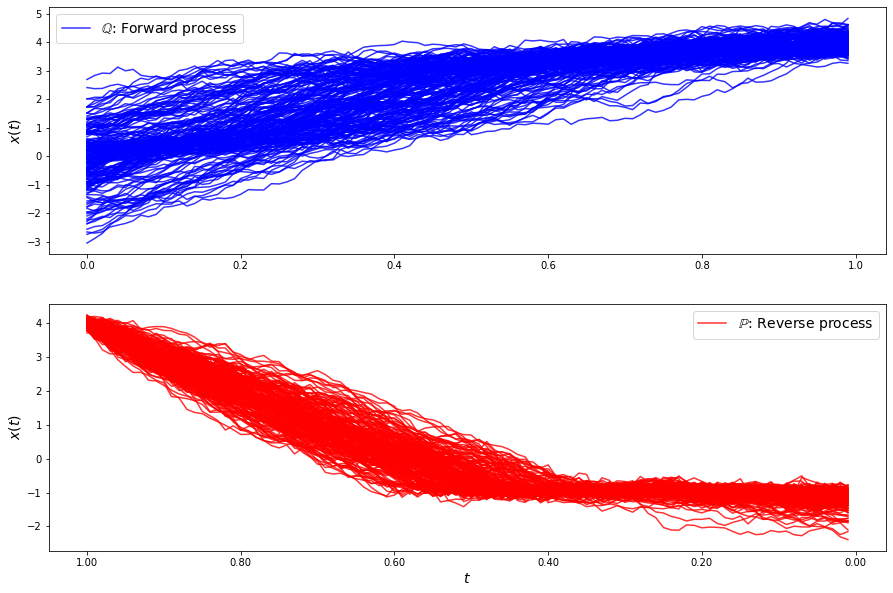

loss b 24.081922694767258
loss b 23.347405122133605
loss b 23.30457391674359
loss b 23.656716738693447
loss b 22.88651443318792
loss b 23.97906718513612
loss b 23.70786539442246
loss b 24.338518606721376
loss b 24.45647740847461
loss b 24.273466667936262
loss b 23.63207026442645
loss b 24.251624932265305
loss b 25.209206730629976
loss b 24.789944685359465
loss b 25.24524644631842
loss b 25.233380307662358
loss b 25.048013298713595
loss b 24.61226156096816
loss b 24.77817421620855
loss b 25.44997364679077
loss b 24.87993165669185
loss b 24.583560391673707
loss b 26.415802491573384
loss b 25.88786823961092
loss b 25.50515285980032
loss b 25.43586937960103
loss b 25.178021151890643
loss b 25.505754503226793
loss b 25.373149172798996
loss b 24.944834213729777
loss f 24.209341334944764
loss f 24.700251295164314
loss f 25.612665045961094
loss f 24.083116167446782
loss f 24.822965676432347
loss f 24.308809577760133
loss f 24.602934522504963
loss f 22.854618465192974
loss f 25.05543699586553
l

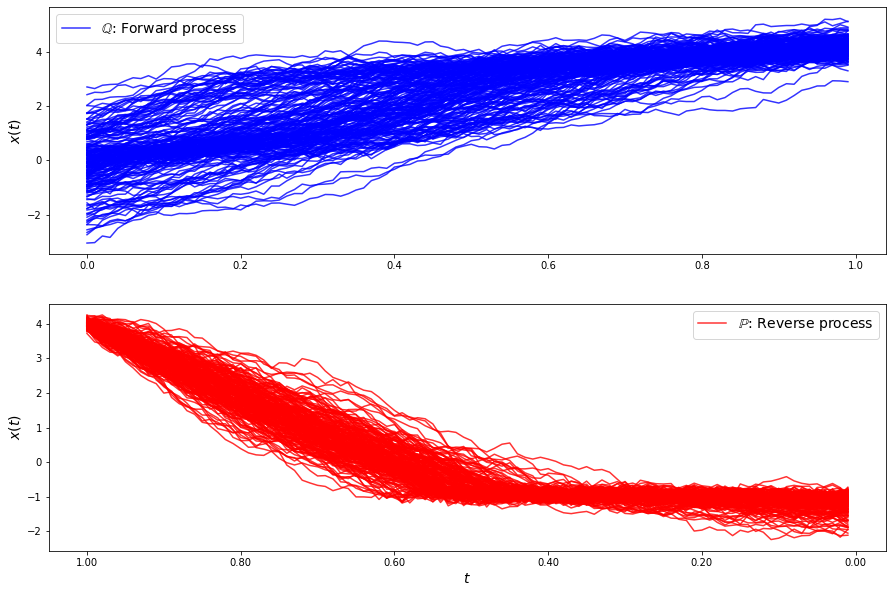

loss b 21.545898215984185
loss b 21.424379367053934
loss b 21.632404637316302
loss b 21.781388468293148
loss b 21.53565448342368
loss b 21.57682879381792
loss b 21.863772430297363
loss b 21.505823540254067
loss b 21.753546736540223
loss b 21.83413158180066
loss b 21.368131385061062
loss b 21.494949124001398
loss b 21.892603353678236
loss b 22.009578392290067
loss b 21.588715170318785
loss b 22.090880663992824
loss b 21.94592214369795
loss b 21.335683690479424
loss b 21.45800059738079
loss b 21.12323717584908
loss b 20.791684012099633
loss b 21.295930747041197
loss b 21.05192044846156
loss b 21.19498241264847
loss b 20.818302212125747
loss b 20.68633232885463
loss b 20.231381064863047
loss b 20.963279891508385
loss b 20.489360565038382
loss b 20.936057455460787
loss f 24.887266733952615
loss f 25.422538037532515
loss f 25.01242452224865
loss f 25.75831200124575
loss f 25.87788300520618
loss f 26.107903629357825
loss f 25.845933132037782
loss f 26.13783043499861
loss f 25.40617095159483


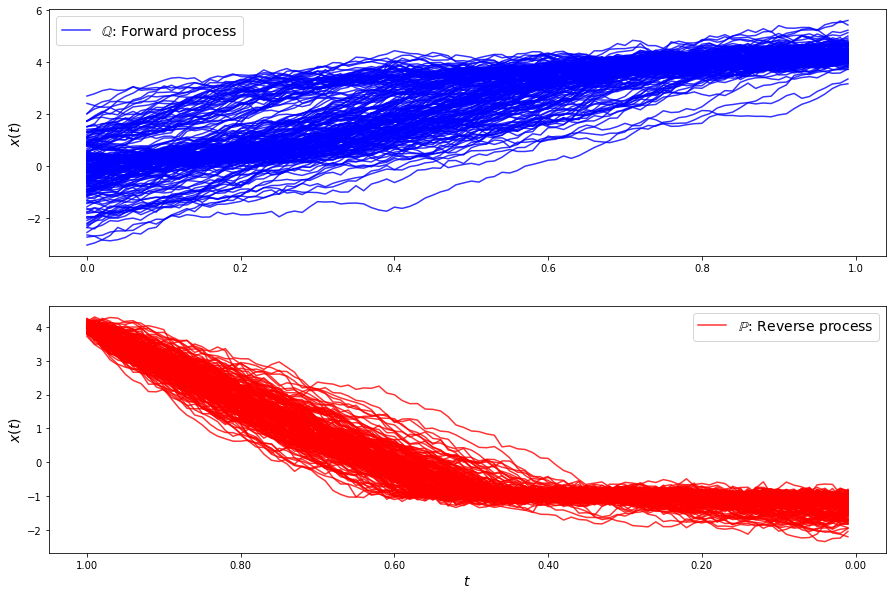

loss b 18.345779873419186
loss b 18.072944000333067
loss b 18.25609000603432
loss b 17.546577853543766
loss b 17.712799795971183
loss b 17.804767717338322
loss b 18.06656113663951
loss b 16.89092897591216
loss b 17.095120878578395
loss b 16.99334010782705
loss b 17.93179181306728
loss b 17.387759489947317
loss b 17.452048406775628
loss b 17.01190413267583
loss b 16.647773161152084
loss b 16.442750220357453
loss b 16.70676109168802
loss b 16.760807288923562
loss b 16.377965953641183
loss b 15.805280118715174
loss b 16.184196342581743
loss b 16.294773003729905
loss b 16.101175103964692
loss b 16.081819534637614
loss b 15.636948445599055
loss b 15.077066730473806
loss b 15.319548209733552
loss b 16.088300640376957
loss b 14.945607697663023
loss b 15.510693772786878
loss f 26.452662354062028
loss f 24.84754121361099
loss f 27.005814740260096
loss f 27.199270506027226
loss f 25.788949222731716
loss f 26.884244838229918
loss f 30.594122471708797
loss f 27.81003654605823
loss f 27.09863637076

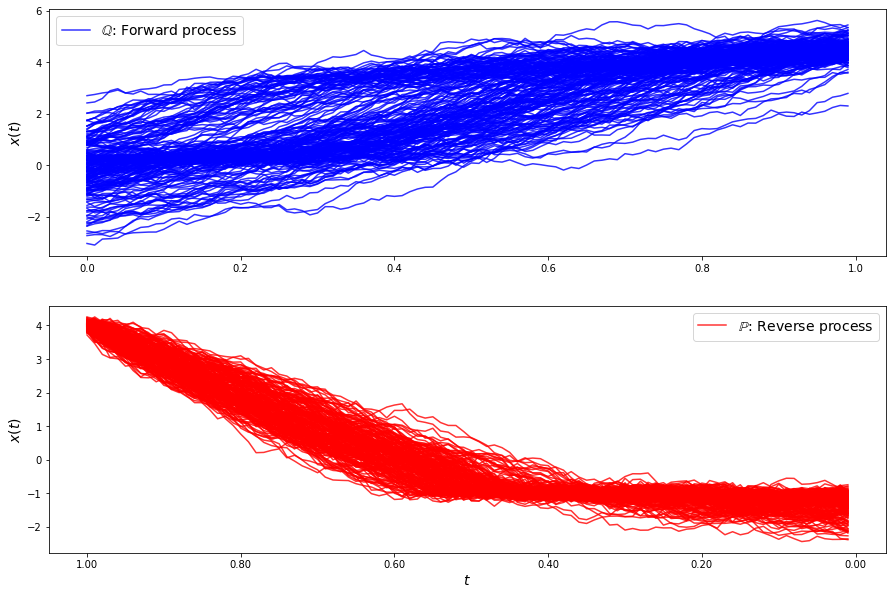

loss b 13.187630321181796
loss b 13.145597072289641
loss b 12.624360385262873
loss b 12.610007190527364
loss b 12.88413179025731
loss b 12.50634439852161
loss b 12.48896270323297
loss b 12.269156160689677
loss b 12.231157288612009
loss b 12.060946355715316
loss b 12.437318613558242
loss b 12.154547666006238
loss b 12.25664089562182
loss b 11.98732462342958
loss b 11.31100450875297
loss b 11.697929431788422
loss b 11.554233768333427
loss b 11.245259604551338
loss b 11.023594274864037
loss b 10.730955788969712
loss b 10.912591631874763
loss b 10.626710520705261
loss b 10.465807816302503
loss b 10.837272586848364
loss b 10.485756212543903
loss b 10.898263556531319
loss b 10.203350937623965
loss b 9.988765220786918
loss b 9.98300276840496
loss b 9.685904053005734
loss f 27.138432894110895
loss f 26.73418050448931
loss f 25.499647109593724
loss f 27.911073955204476
loss f 28.051762497185674
loss f 29.727188215498416
loss f 31.51756170345998
loss f 28.187903749335668
loss f 25.38184810140658

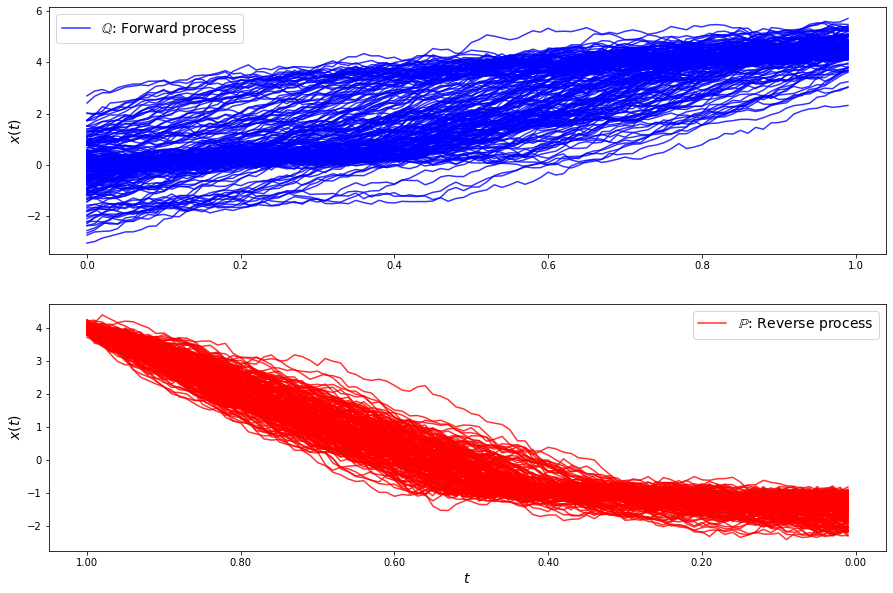

loss b 8.828363891210415
loss b 9.110872750812744
loss b 8.462116317238603
loss b 8.231576868918111
loss b 8.74279587753252
loss b 8.509978388200382
loss b 8.292016471145926
loss b 8.146073305819723
loss b 8.044119309423001
loss b 7.827975666871954
loss b 7.898939370550176
loss b 7.60730196596466
loss b 7.746660809128274
loss b 7.60750025083274
loss b 7.293780868018134
loss b 7.453930314403867
loss b 7.344508758708543
loss b 7.198238737422255
loss b 7.007387901107921
loss b 6.666733067672085
loss b 7.0405833364455495
loss b 6.775545347485625
loss b 6.909234859467484
loss b 6.77051081773149
loss b 6.892343343371814
loss b 6.909238371409211
loss b 6.761158422226995
loss b 6.594304861342068
loss b 6.737281062905831
loss b 6.230960296588177
loss f 31.143346133469297
loss f 32.042008015483006
loss f 26.087063434755443
loss f 27.350485570178364
loss f 26.611139021848352
loss f 28.154235864960878
loss f 33.96642859769664
loss f 31.670920725961526
loss f 32.166209133838805
loss f 30.8398703132

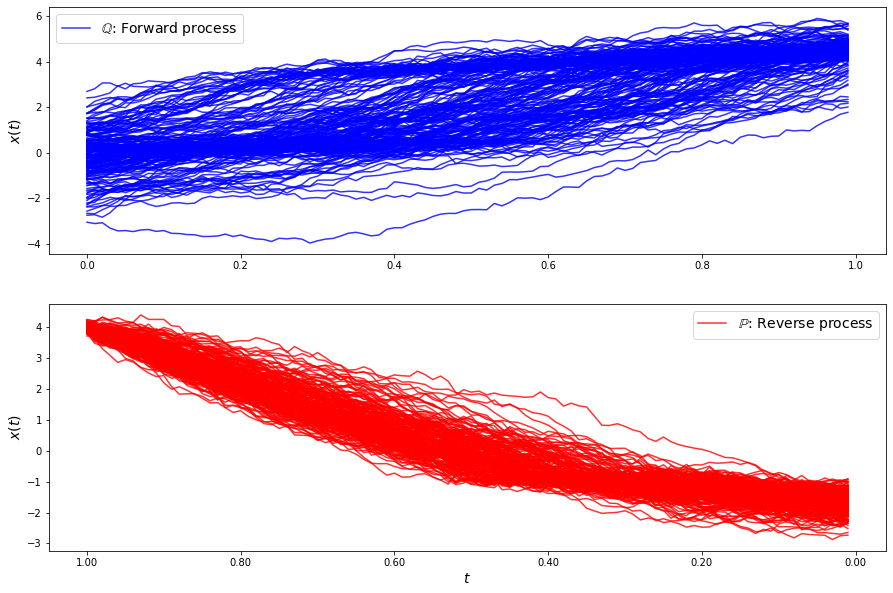

loss b 6.074533093303898
loss b 5.841985512221048
loss b 6.0362099896517485
loss b 5.749813716598454
loss b 5.713130628412297
loss b 6.256868481666977
loss b 5.59201087375376
loss b 6.177548004422967
loss b 5.853415162081226
loss b 5.844228492749
loss b 5.499147762467385
loss b 5.201694984721334
loss b 5.696677101751535
loss b 5.382301458651492
loss b 5.391855378860432
loss b 5.730773299440059
loss b 5.405341648540979
loss b 5.602461546313172
loss b 5.470228175265612
loss b 5.108757390659686
loss b 5.265773583809583
loss b 4.971354861446781
loss b 5.115162645106841
loss b 5.317713079710519
loss b 5.354043692281074
loss b 5.4183967253761
loss b 4.7103585645328705
loss b 5.181353055508214
loss b 5.090983664481225
loss b 4.943251756296152
loss f 23.932187466413186
loss f 25.851652942846208
loss f 21.82300401082655
loss f 25.11682030812061
loss f 22.398494772340115
loss f 31.985470774060456
loss f 25.56940192720102
loss f 26.927277815021412
loss f 24.348922163931856
loss f 29.1363695906365

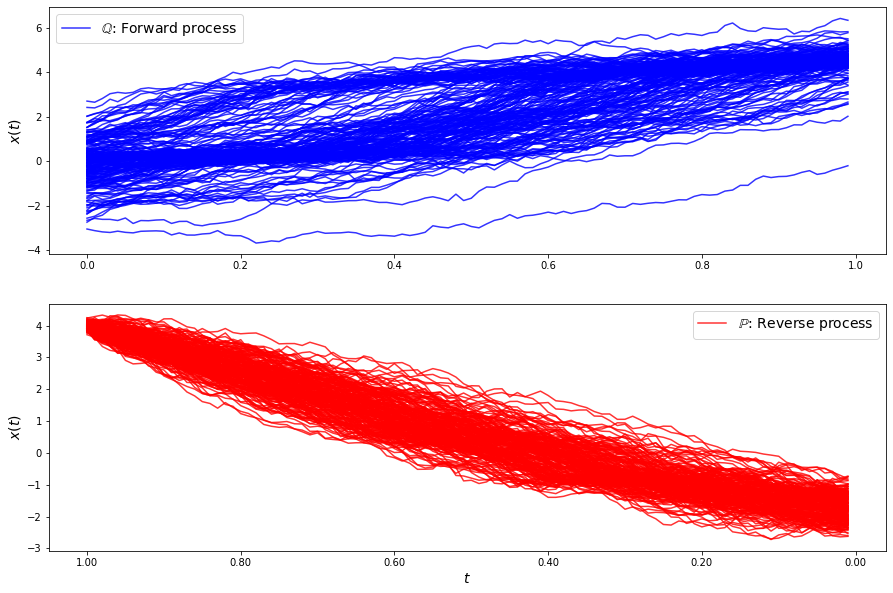

loss b 5.058857847372486
loss b 5.332101656715083
loss b 5.466352267526553
loss b 5.175888804836322
loss b 4.907058392822349
loss b 5.638929518144103
loss b 5.326255060208889
loss b 5.394116292331709
loss b 5.3339705028548545
loss b 5.398165309508182
loss b 5.681253161933429
loss b 5.173125866523636
loss b 5.191288181525989
loss b 5.3772696598091745
loss b 5.439626215859542
loss b 5.458095957648566
loss b 5.640518035742329
loss b 5.213968837443096
loss b 5.041783622341169
loss b 5.677580835074017
loss b 5.698838447170856
loss b 5.205813827256402
loss b 5.430518878585534
loss b 5.556179251768947
loss b 5.795368585979785
loss b 5.99812368401626
loss b 5.813784100572449
loss b 5.927796512582369
loss b 5.990558435251049
loss b 5.919501175633275
loss f 21.928446055463663
loss f 19.06410950104593
loss f 20.38600060734992
loss f 21.76851255955972
loss f 20.421190537088346
loss f 19.97098165728504
loss f 19.779251166841767
loss f 16.297632687841446
loss f 24.753186684918365
loss f 23.023512554

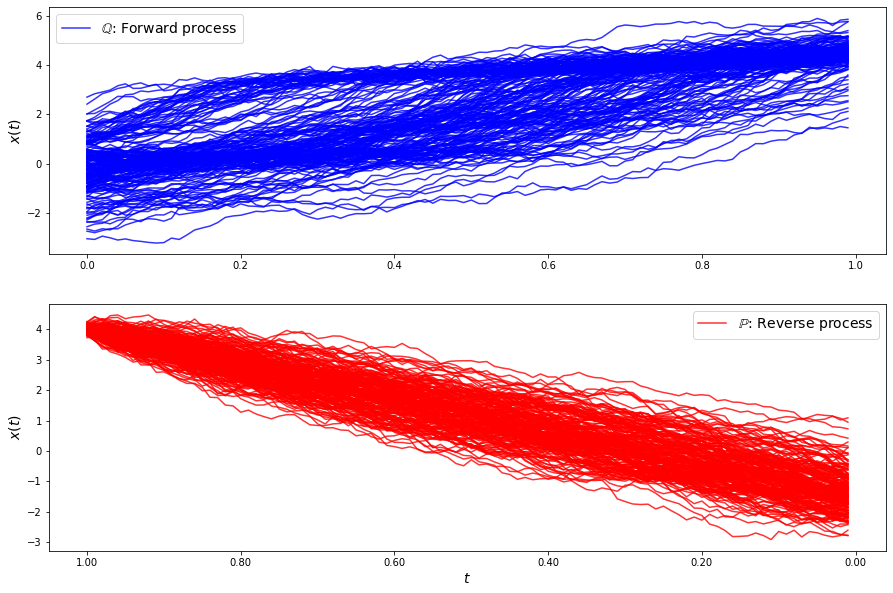

loss b 5.630825996716832
loss b 5.734439867568293
loss b 6.252713909139367
loss b 5.490375629510016
loss b 5.529867716253568
loss b 5.750848352630255
loss b 6.563408259232358
loss b 6.203991397835781
loss b 6.143933190205344
loss b 7.028983187274978
loss b 6.640999362556423
loss b 6.597118871766966
loss b 6.74396829042072
loss b 6.502258362746806
loss b 7.271052290512115
loss b 7.092271786722181
loss b 6.645642605518056
loss b 6.913955938064435
loss b 7.254763453300215
loss b 7.412734418528287
loss b 7.684054111166525
loss b 7.045212063031725
loss b 7.97572995521298
loss b 7.809544089542103
loss b 7.8399489924494645
loss b 8.063796196766777
loss b 8.478117044571428
loss b 8.407076926919702
loss b 8.765300749748825
loss b 9.06570116577836
loss f 17.124337191864676
loss f 13.565949552026789
loss f 16.8512496528213
loss f 12.871047193346582
loss f 14.231196473294784
loss f 14.270552931419651
loss f 19.4971330887166
loss f 13.394929755225334
loss f 15.659519440202132
loss f 14.925598124867

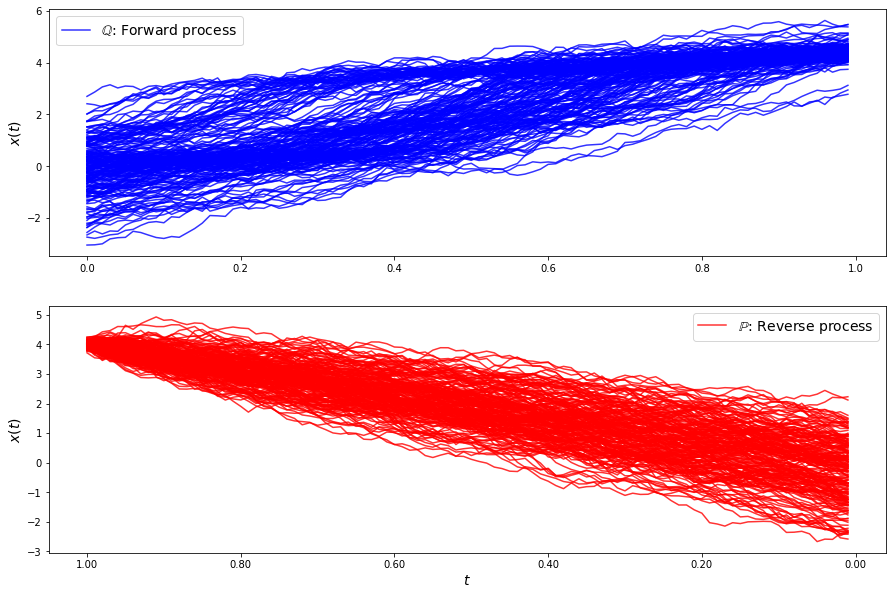

loss b 7.813398970212884
loss b 8.380025175138005
loss b 8.048893065725519
loss b 8.783617913975252
loss b 8.522071106323333
loss b 8.89172200436035
loss b 9.398114418863585
loss b 9.40564340515184
loss b 10.114750750831762
loss b 9.64770449601686
loss b 10.354941255984684
loss b 10.376760845410226
loss b 10.286019589122812
loss b 10.468660534952472
loss b 11.769660126137877
loss b 10.207912947085953
loss b 11.628601399324792
loss b 11.70303440316338
loss b 11.964426784105186
loss b 11.671354710595834
loss b 12.083255628833857
loss b 12.316525051151737
loss b 13.272410704202228
loss b 13.139673550891084
loss b 13.060900616534497
loss b 13.176858662134222
loss b 13.124719109509723
loss b 13.484822547453367
loss b 14.647328964435502
loss b 12.731017881251795
loss f 12.233350373941294
loss f 12.732268287327363
loss f 12.929483601627734
loss f 12.988040183895352
loss f 10.955530188565007
loss f 12.80291047541275
loss f 11.165797899504623
loss f 11.875529385076783
loss f 11.335089153350111


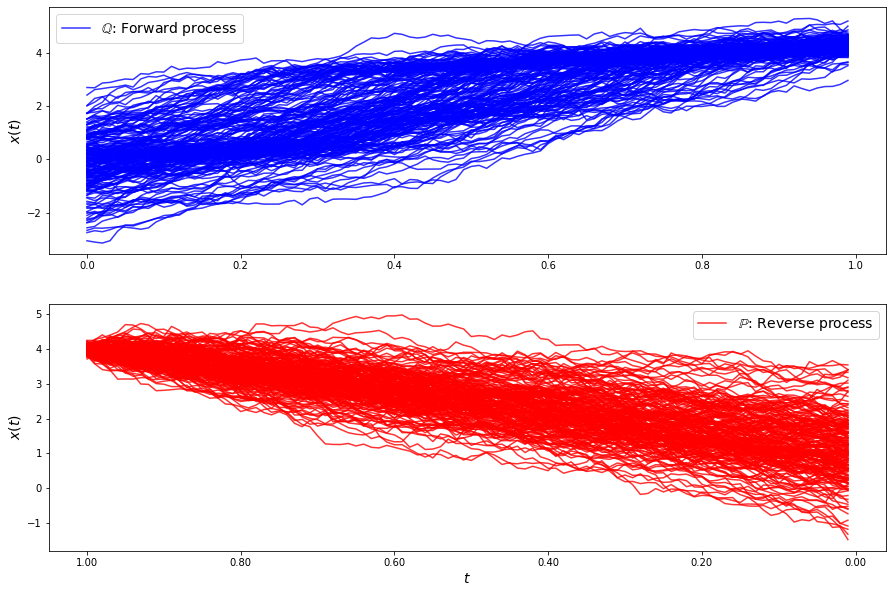

loss b 12.421866888099885
loss b 12.18647057586342
loss b 13.088808308775754
loss b 12.091028263734632
loss b 12.55912914450113
loss b 12.284580091121727
loss b 12.444718224819715
loss b 13.365045949311451
loss b 12.438567755083861
loss b 12.662466375176672
loss b 13.110884938477328
loss b 12.581584356584218
loss b 12.68376848259415
loss b 13.883310544485006
loss b 13.540097713708962
loss b 13.584992687116134
loss b 14.393685545152122
loss b 13.259218048320323
loss b 13.849909366572776
loss b 14.678811548075705
loss b 14.672083824118795
loss b 14.170925617816795
loss b 14.45947733324893
loss b 14.67659334407342
loss b 14.578340454796646
loss b 15.12760010484979
loss b 15.43240680790131
loss b 15.33056283151765
loss b 14.665208085557952
loss b 15.776773894741343
loss f 11.23077759204706
loss f 9.936631002339363
loss f 11.1826228644494
loss f 10.176380871375024
loss f 9.32283755383331
loss f 10.527412469883844
loss f 9.93870007133571
loss f 10.204552290584136
loss f 9.727515253558268
los

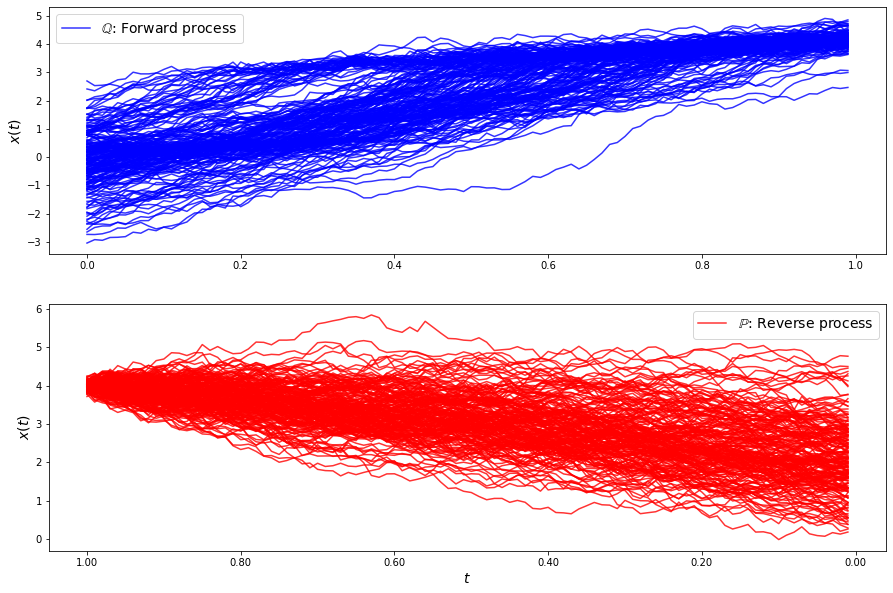

loss b 12.262312135668155
loss b 13.29290726802225
loss b 11.602090501562493
loss b 10.929442845651215
loss b 12.72077065605865
loss b 12.442897781296761
loss b 11.98677472107096
loss b 12.79014024494959
loss b 11.37518513648727
loss b 12.553155430127045
loss b 12.41135127162326
loss b 13.495822569550004
loss b 12.921634216200587
loss b 12.806124299002434
loss b 13.646147372109544
loss b 12.63209797659844
loss b 13.338398048324436
loss b 13.465545310335129
loss b 12.906094887732174
loss b 13.256401302075123
loss b 12.664767567993648
loss b 14.194767816516832
loss b 14.073380322291534
loss b 13.868003589791975
loss b 13.330971261156009
loss b 13.580978757065692
loss b 14.24180502968265
loss b 14.685125491324811
loss b 13.574018667438613
loss b 13.929519543050963
loss f 9.20457462865416
loss f 8.916225638143647
loss f 8.953960115611682
loss f 9.795269572098505
loss f 7.928173853922196
loss f 8.684467954060002
loss f 8.553253529992004
loss f 8.946134835755338
loss f 8.484956159582925
loss

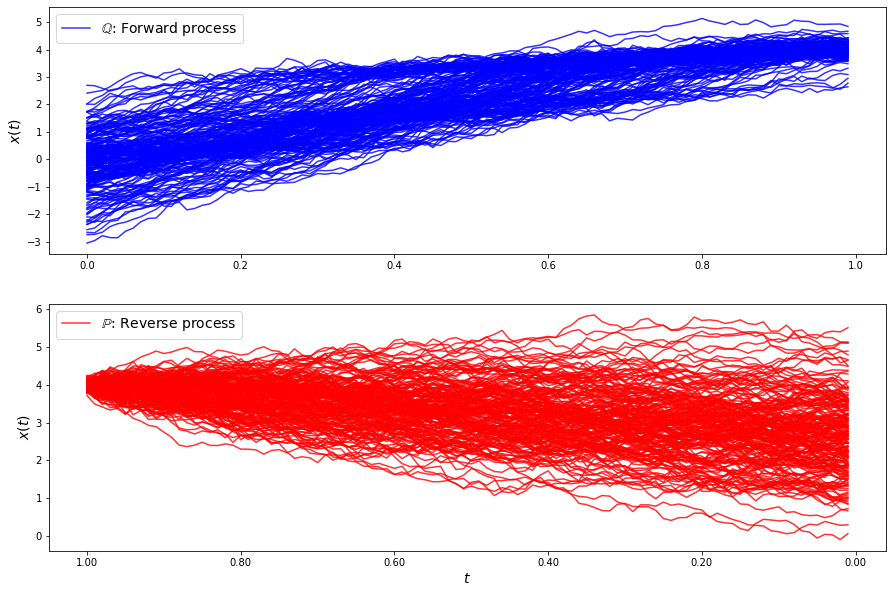

loss b 11.374970287779592
loss b 11.444040582350171
loss b 12.833239643265506
loss b 10.196219736952978
loss b 13.309324161437537
loss b 11.770070619450541
loss b 11.939167247750806
loss b 13.484375367996334
loss b 12.064232690192403
loss b 12.26896642373642
loss b 12.143350419046635
loss b 12.833997980909997
loss b 14.118700754235869
loss b 11.949930911232444
loss b 12.228253759262792
loss b 12.142154165254242
loss b 14.180919471550437
loss b 11.944889644790106
loss b 12.828984678798621
loss b 12.800997386998814
loss b 12.7828501921574
loss b 12.58149423458778
loss b 13.684301012094766
loss b 12.022928254656115
loss b 11.753662318827711
loss b 13.17308203237614
loss b 13.039226647339168
loss b 13.192379363892071
loss b 13.456757356299253
loss b 12.67234848317364
loss f 8.548194546474658
loss f 7.177194421275749
loss f 8.472374183642613
loss f 9.049141155830398
loss f 8.418752567002057
loss f 7.168393882777782
loss f 7.259263129814252
loss f 8.17663792861477
loss f 8.552934494035348
lo

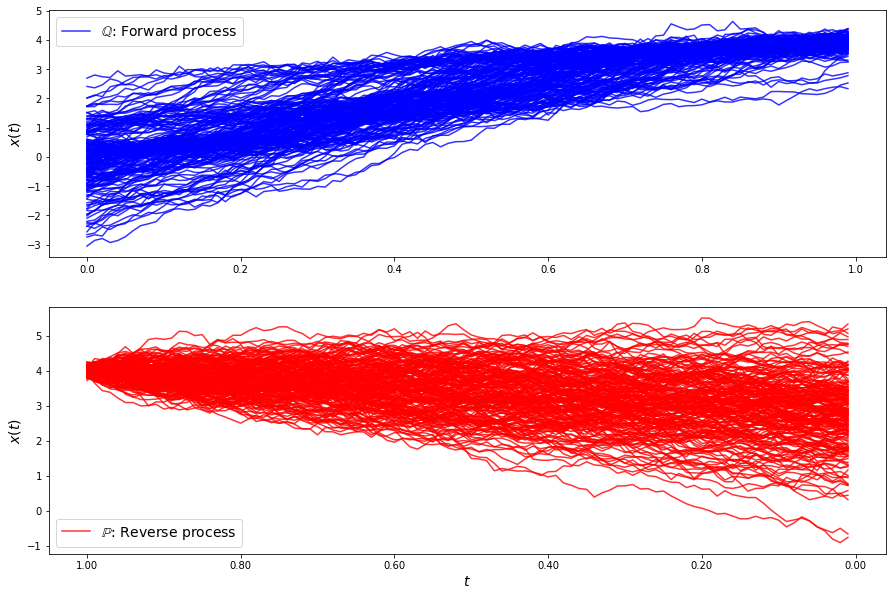

loss b 11.061967689045046
loss b 12.488882274654916
loss b 13.912009657156933
loss b 11.342078745297714
loss b 10.922116312721592
loss b 12.455037455824911
loss b 12.11648540455574
loss b 13.139795271718171
loss b 11.939704725465033
loss b 11.086222390911555
loss b 12.008273268624034
loss b 11.531214943147802
loss b 12.781324976342518
loss b 11.370157342884106
loss b 11.79659319745105
loss b 11.726690809416853
loss b 12.061108424416341
loss b 11.064263941558346
loss b 11.704410450786089
loss b 12.12476537077543
loss b 11.356861224467696
loss b 10.917258719946034
loss b 10.85421357258442
loss b 11.525193032310655
loss b 12.082823492408513
loss b 11.636853830178696
loss b 10.905810535386449
loss b 11.614942539697704
loss b 12.096444039293017
loss b 11.108941658057049
loss f 8.350450540139963
loss f 7.471949079030174
loss f 8.028029310572649
loss f 7.240734064293306
loss f 9.237791323428768
loss f 10.415503409244263
loss f 8.311243960570113
loss f 9.629211249410622
loss f 9.43850733609244

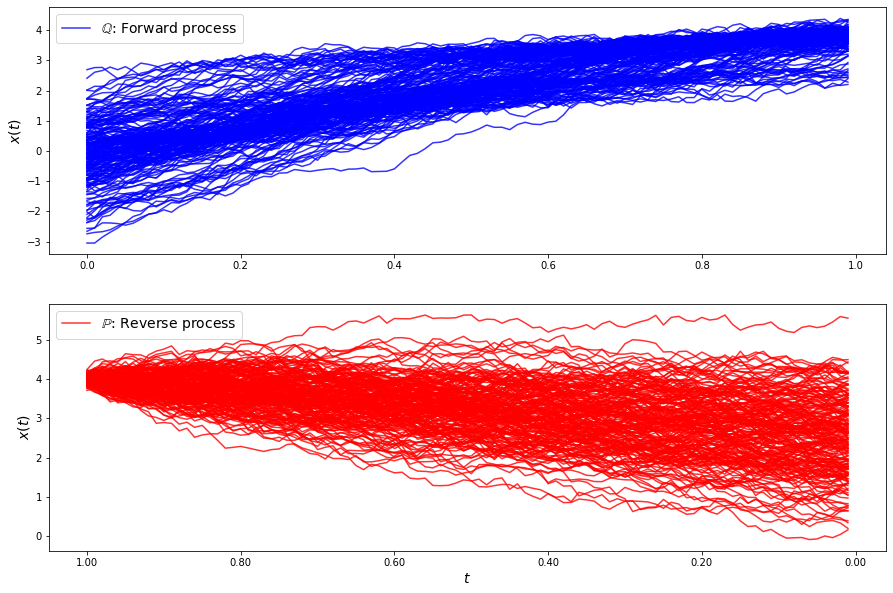

loss b 11.406088823344621
loss b 10.616482055260805
loss b 10.899342816659946
loss b 10.657746413557293
loss b 11.813176867789217
loss b 10.343453849638205
loss b 11.05805859472102
loss b 8.646591515828467
loss b 10.80380300330634
loss b 11.107893308227728
loss b 10.075008601534833
loss b 9.874645401067799
loss b 9.550870439987037
loss b 9.332912748722428
loss b 9.531331517822284
loss b 10.730169516765768
loss b 9.07355023011122
loss b 9.514325300706437
loss b 9.966324279090378
loss b 9.314048753214012
loss b 9.80179202598093
loss b 9.102031854795463
loss b 7.691603435494028
loss b 9.38263274527432
loss b 8.913218654657076
loss b 7.823982162686946
loss b 8.25798740221732
loss b 7.983781019114306
loss b 7.160340076808853
loss b 6.803573379613499
loss f 8.24207488730406
loss f 7.270430666537547
loss f 8.471440429173994
loss f 9.555006581426582
loss f 8.574240035295166
loss f 8.309267154133787
loss f 7.893423652710254
loss f 8.014894270752292
loss f 8.806505271168955
loss f 7.656126114996

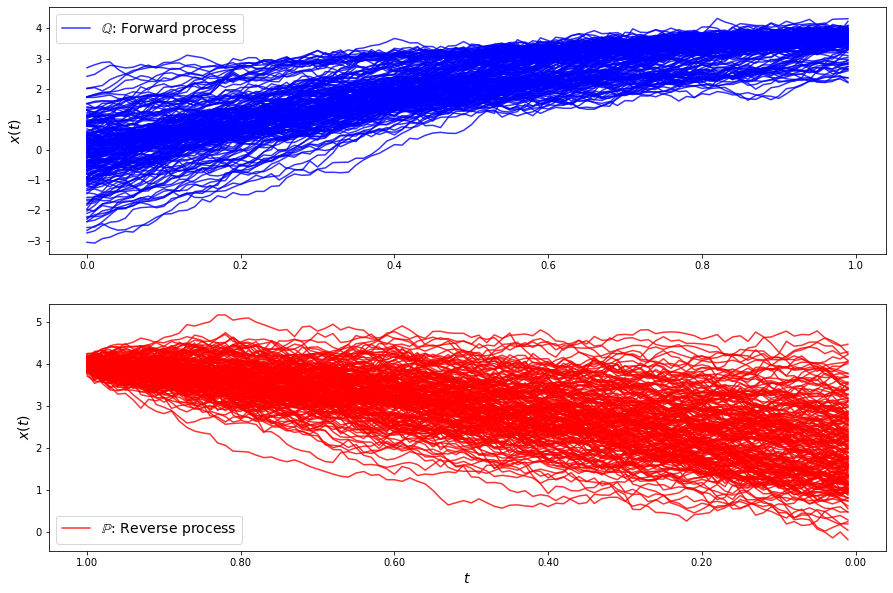

loss b 8.21368811640393
loss b 8.230189865640073
loss b 7.872504267158407
loss b 6.977980864455747
loss b 6.036187502340361
loss b 6.2410786733717405
loss b 5.696035641618437
loss b 7.854336130473067
loss b 5.7359466820808604
loss b 5.550230845277205
loss b 6.883087061728178
loss b 5.731834839189347
loss b 6.6337328775344435
loss b 6.339348798421343
loss b 6.143179267692225
loss b 5.562091516082082
loss b 4.596807946468518
loss b 4.877123757205088
loss b 3.8194422304283178
loss b 5.921995869531966
loss b 4.615583245960445
loss b 4.94218826768811
loss b 4.330888972580297
loss b 4.5313206473028425
loss b 3.685034373823049
loss b 4.720170218419574
loss b 3.941060404585607
loss b 2.9565044322572236
loss b 2.420662956017302
loss b 3.9938827107498187
loss f 6.747673497070509
loss f 10.011346664123035
loss f 9.06194506159969
loss f 9.41635736524383
loss f 7.744450930408554
loss f 9.454266066574117
loss f 9.40994469312363
loss f 9.014490746589164
loss f 6.242311640214078
loss f 8.3447149770281

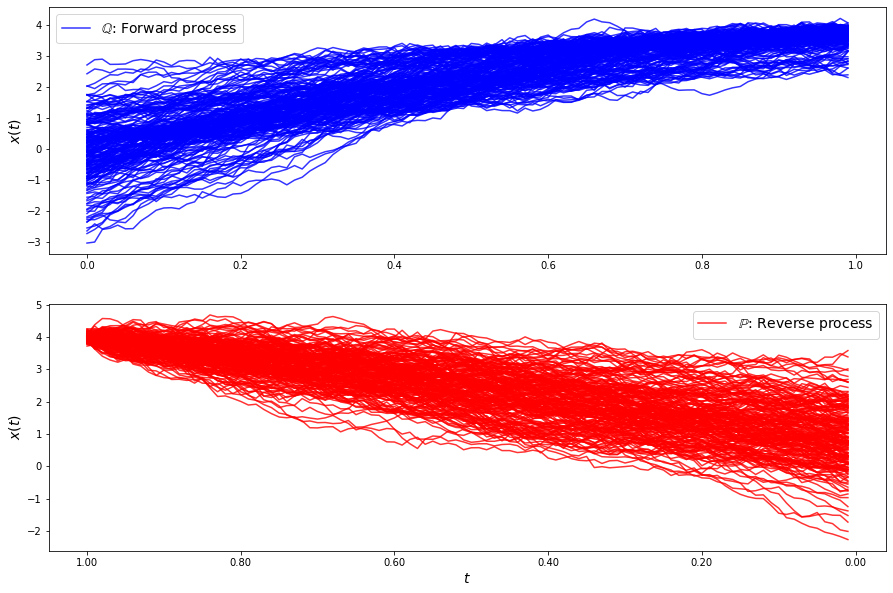

loss b 5.286672771829917
loss b 3.891877639030524
loss b 3.6372439021115643
loss b 5.282501614509235
loss b 4.234288518376122
loss b 4.730147394248466
loss b 3.683472312526367
loss b 3.0334476754403767
loss b 3.0318407675181227
loss b 3.1922840525600638
loss b 3.6129025604668756
loss b 2.7881757970818466
loss b 2.3855125613234494
loss b 2.9942615001668584
loss b 3.809461314568987
loss b 2.8869898460320216
loss b 2.9564904350015038
loss b 3.082361345167612
loss b 4.18550446624503
loss b 3.50786739728744
loss b 3.6617480890281406
loss b 3.398754205360916
loss b 3.3590444868613605
loss b 4.4876414330602605
loss b 3.7487794845475078
loss b 3.670703719137476
loss b 3.679662716867539
loss b 3.0564746801161293
loss b 3.581071757843003
loss b 3.97535688881402
loss f 7.432259642996219
loss f 7.962344194568361
loss f 8.308322241078473
loss f 7.718672291831458
loss f 9.167077702940782
loss f 7.697528806664652
loss f 6.708255227852992
loss f 7.866378985385485
loss f 7.579153881968548
loss f 6.1290

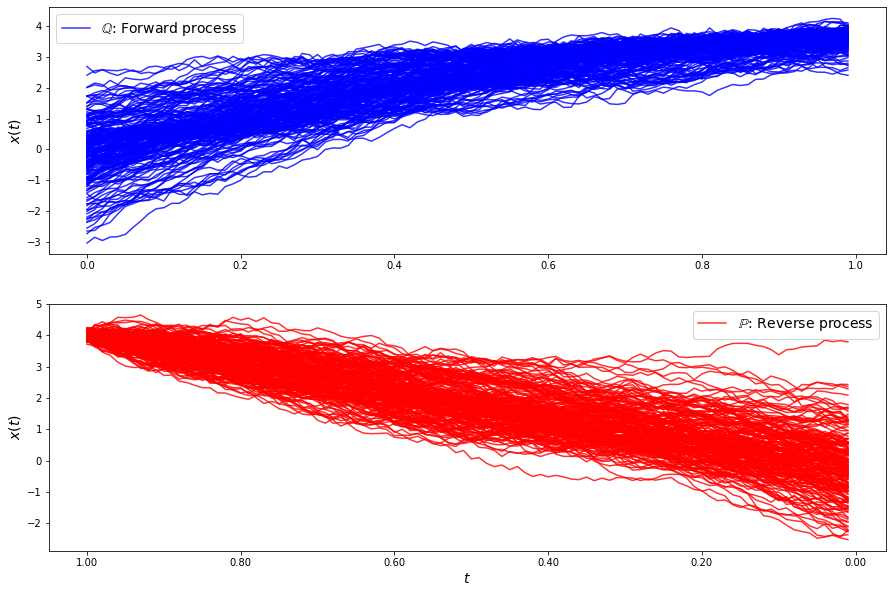

loss b 5.001529257194973
loss b 4.528686927042875
loss b 5.367707509863087
loss b 5.927468186047083
loss b 4.796408993230908
loss b 5.03815205933281
loss b 5.956671122888856
loss b 4.921803930549155
loss b 6.973296723682561
loss b 6.037044390439654
loss b 6.591528835377391
loss b 6.627692933113558
loss b 7.20558850963364
loss b 6.86198698482226
loss b 6.224039492305064
loss b 7.628472206238091
loss b 7.70683700918239
loss b 6.906758022444125
loss b 8.22765256947159
loss b 7.230490747576627
loss b 8.200660504841789
loss b 7.350129373456708
loss b 8.884905241483269
loss b 7.143302776700451
loss b 7.691162478933019
loss b 8.861126528876241
loss b 9.041335588233775
loss b 10.312414792352032
loss b 9.687875337713775
loss b 8.597427560136145
loss f 9.657930529760778
loss f 12.24529997947193
loss f 9.59106249090106
loss f 10.976338975384408
loss f 10.93847619355064
loss f 11.058671621819146
loss f 11.463451602820657
loss f 11.262290016781753
loss f 12.453219544229617
loss f 10.219457969740803

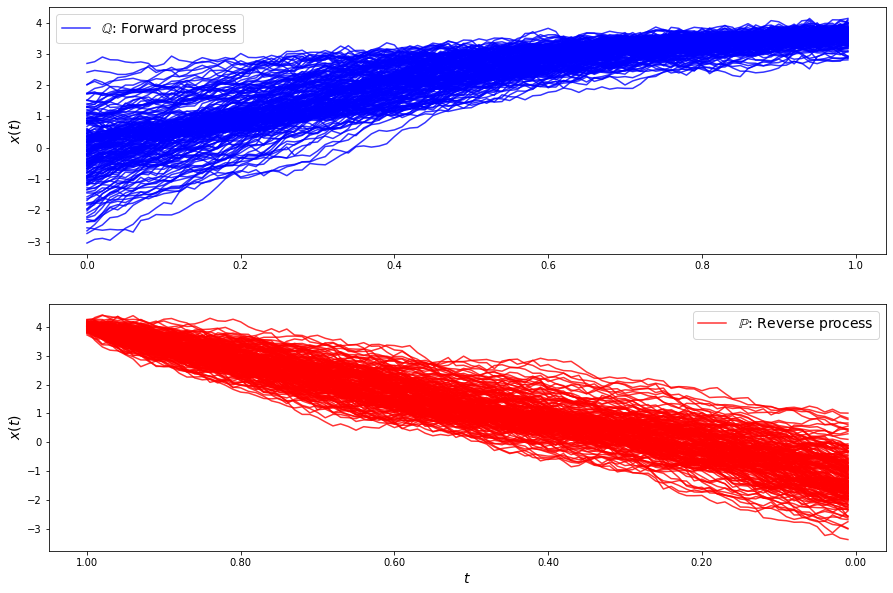

loss b 10.355459822575797
loss b 10.473701756438754
loss b 10.02174092449498
loss b 10.946590523575694
loss b 11.736967254526268
loss b 11.153021366572954
loss b 10.048543823035219
loss b 12.278684353792611
loss b 11.657905449731423
loss b 12.257234630764628
loss b 12.653477252163666
loss b 12.028604478124555
loss b 11.988942010703276
loss b 12.148125420354663
loss b 13.739438632192376
loss b 13.885679468050903
loss b 12.571657630014295
loss b 13.566819138723554
loss b 13.889577044324566
loss b 14.009749345465204
loss b 13.719027197236032
loss b 14.568637122499027
loss b 13.686694183785491
loss b 14.708298680826672
loss b 15.789822850827099
loss b 14.549130600756138
loss b 14.953325611766003
loss b 15.248508890778202
loss b 14.88557042932459
loss b 15.418625058194914
loss f 13.881722150667068
loss f 14.759163310169125
loss f 13.92687652522995
loss f 13.014050049138522
loss f 15.888849324021722
loss f 13.323744790184529
loss f 15.478916410643142
loss f 14.112875798336896
loss f 13.96011

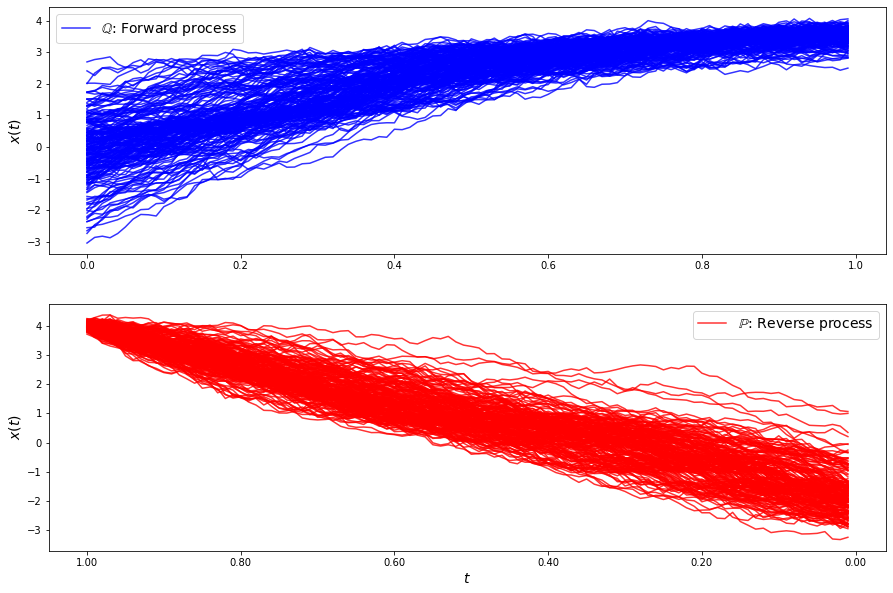

loss b 15.549626260120728
loss b 14.67538905018113
loss b 16.40486178263188
loss b 16.815780395471815
loss b 16.23486406099209
loss b 16.642545217189028
loss b 17.39183361579916
loss b 17.453777718355173
loss b 16.52816225213528
loss b 16.536625227529903
loss b 16.54502271623171
loss b 17.436490577804275
loss b 17.384993596117987
loss b 17.501927397644646
loss b 17.84167958963495
loss b 17.399921490182322
loss b 18.122215394165536
loss b 18.066396265544366
loss b 17.44703917697857
loss b 19.045450055853046
loss b 17.676624907342795
loss b 18.222662057813608
loss b 18.593673878053018
loss b 18.348881211176842
loss b 18.112607789652323
loss b 19.032121765934086
loss b 19.449183437845203
loss b 17.06483262514707
loss b 18.20025247888119
loss b 18.298716030799316
loss f 16.72121822426427
loss f 16.858678083151005
loss f 16.207582520308712
loss f 18.133689610197933
loss f 17.532968915015758
loss f 17.904162978082883
loss f 17.006127531074096
loss f 17.92499662457197
loss f 16.57814036080049

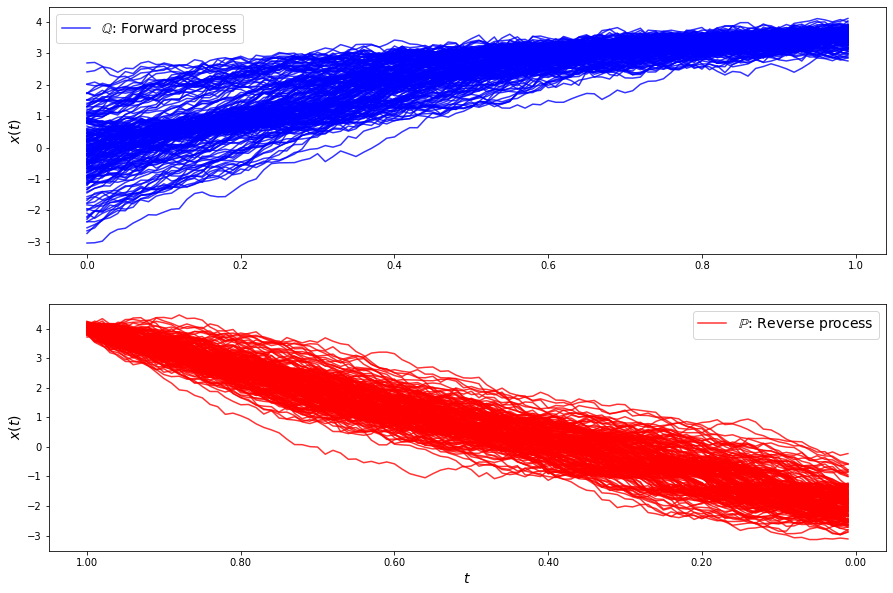

loss b 18.209350337559613
loss b 18.202117066763932
loss b 19.60622721800954
loss b 19.009248410284627
loss b 20.158312432430566
loss b 18.676105412471777
loss b 18.45599333537276
loss b 19.129113429567813
loss b 18.21397642989225
loss b 19.302064574971592
loss b 18.26126904467286
loss b 19.254373796517942
loss b 18.988954719681754
loss b 20.579872141438535
loss b 19.587334439313516
loss b 19.61697342507607
loss b 19.406121653395427
loss b 19.60627519932913
loss b 19.50566979197908
loss b 18.96522467558474
loss b 19.86707316952829
loss b 19.371912116963543
loss b 19.622658503913897
loss b 20.406913501360233
loss b 19.155879884362204
loss b 20.460620140207922
loss b 19.903632012694523
loss b 19.69516504929693
loss b 19.74143581218534
loss b 20.377942165924527
loss f 18.51997832481228
loss f 18.77834032631636
loss f 17.446687239731613
loss f 17.724670991164864
loss f 17.56053542265521
loss f 17.442807757821065
loss f 17.80018653908967
loss f 19.096279227464724
loss f 17.143652281840946
l

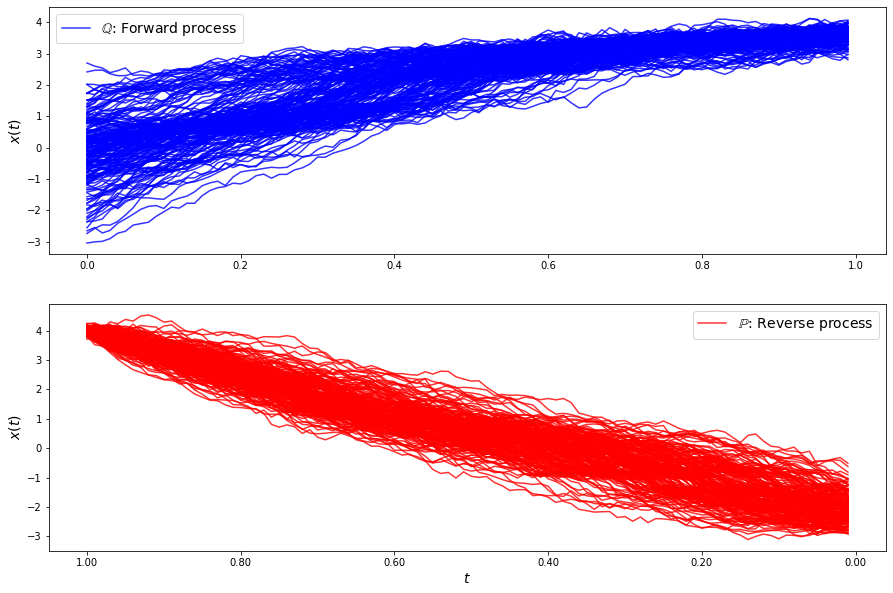

loss b 17.812766990804676
loss b 17.419486430521534
loss b 17.983298899662277
loss b 17.556227414744438
loss b 18.57704236138838
loss b 16.760158241853663
loss b 18.679315898886102
loss b 17.582231211782027
loss b 16.326990686634556
loss b 18.38253942786818
loss b 16.767803512289625
loss b 16.943485632638218
loss b 17.53441021662695
loss b 17.269739402140132
loss b 18.63907462127827
loss b 18.279327129415666
loss b 18.114131141516577
loss b 17.478630553909262
loss b 16.823467952134674
loss b 18.142422743399507
loss b 17.988049814869708
loss b 17.63664173955077
loss b 17.288318239582825
loss b 16.777006012772464
loss b 17.702918081928782
loss b 16.00418261901593
loss b 18.48900684685308
loss b 18.00047294359817
loss b 16.21101298421678
loss b 15.98672909916908
loss f 17.18091298621794
loss f 17.224521789917798
loss f 15.529698270601827
loss f 17.0058641014868
loss f 16.59909546159124
loss f 16.62793750334069
loss f 15.51459728416991
loss f 15.144229811297814
loss f 15.8250474660831
loss

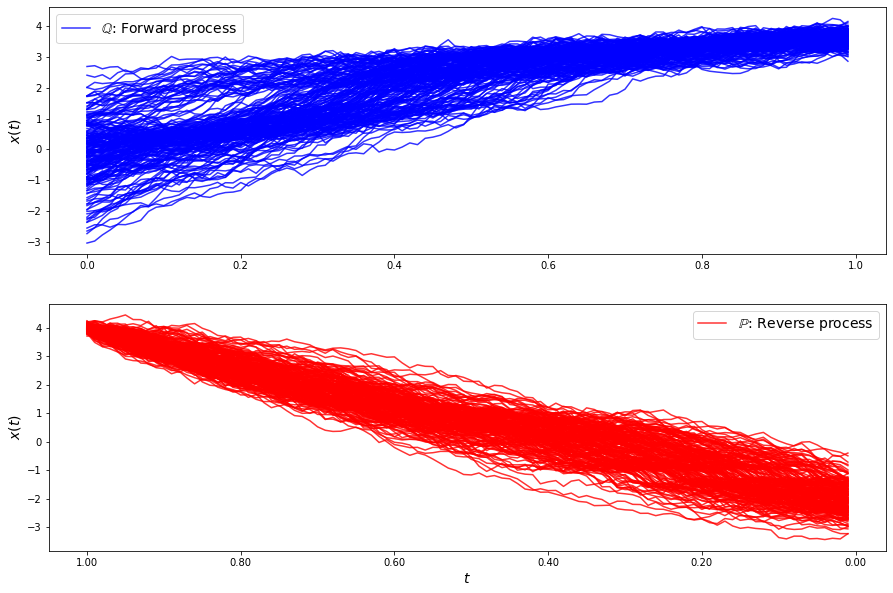

loss b 14.8307657222758
loss b 14.121300463970737
loss b 14.887896896569394
loss b 13.818478837334782
loss b 13.756121294904453
loss b 13.728709572844398
loss b 13.229841291512194
loss b 14.759605608998577
loss b 13.128505884040907
loss b 13.573910946328862
loss b 12.612433734230873
loss b 13.6483143652355
loss b 14.144646365798438
loss b 13.995398221796577
loss b 13.113995677670427
loss b 13.316985202525164
loss b 12.741331937892422
loss b 12.429792638456028
loss b 12.88065925066084
loss b 13.09365126162626
loss b 13.152382794422879
loss b 12.608426058076331
loss b 11.512921919677401
loss b 11.573623323727888
loss b 11.566100650584858
loss b 11.508811257699552
loss b 12.30640229644837
loss b 12.152508879372013
loss b 10.478214162934481
loss b 12.28317076102792
loss f 13.443910105668522
loss f 12.320173899533383
loss f 12.857432820599783
loss f 11.942954194087884
loss f 12.650940428113687
loss f 12.49976582776076
loss f 13.107622502424485
loss f 13.329423770028527
loss f 12.53395479511

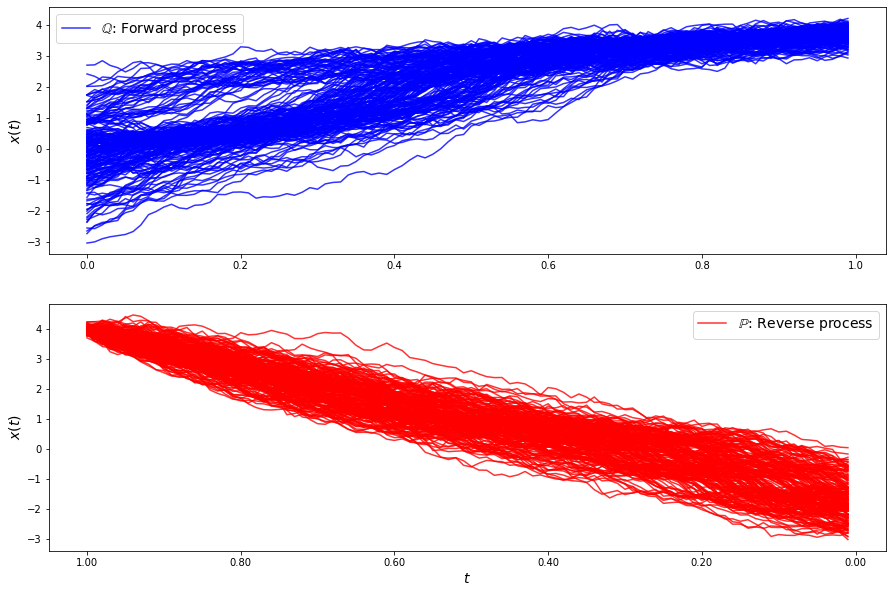

loss b 9.248790054611916
loss b 10.013510700983604
loss b 8.484435689055834
loss b 9.009638872775668
loss b 8.549225770229128
loss b 8.982430116306507
loss b 7.702454451841772
loss b 8.506147221961015
loss b 7.823495357302059
loss b 8.134410612992477
loss b 7.388101579543741
loss b 7.635469390496787
loss b 8.878905414485454
loss b 6.841343063227386
loss b 7.736564237404956
loss b 7.427111058574096
loss b 6.194644377974694
loss b 8.026817797374058
loss b 7.320771665584117
loss b 7.350664986276259
loss b 7.347370295739687
loss b 7.028980739923471
loss b 6.2667926859709215
loss b 6.361280816321928
loss b 7.067629166862727
loss b 6.500713068145978
loss b 6.221901614280797
loss b 6.312485060780915
loss b 6.53346237657623
loss b 6.193009208589506
loss f 9.863306826747644
loss f 8.978348884650446
loss f 8.720852365183703
loss f 8.942296994456354
loss f 9.269568867588726
loss f 9.25549805742894
loss f 9.766775231189737
loss f 8.029075277562066
loss f 8.60854832695273
loss f 8.843228996770971
l

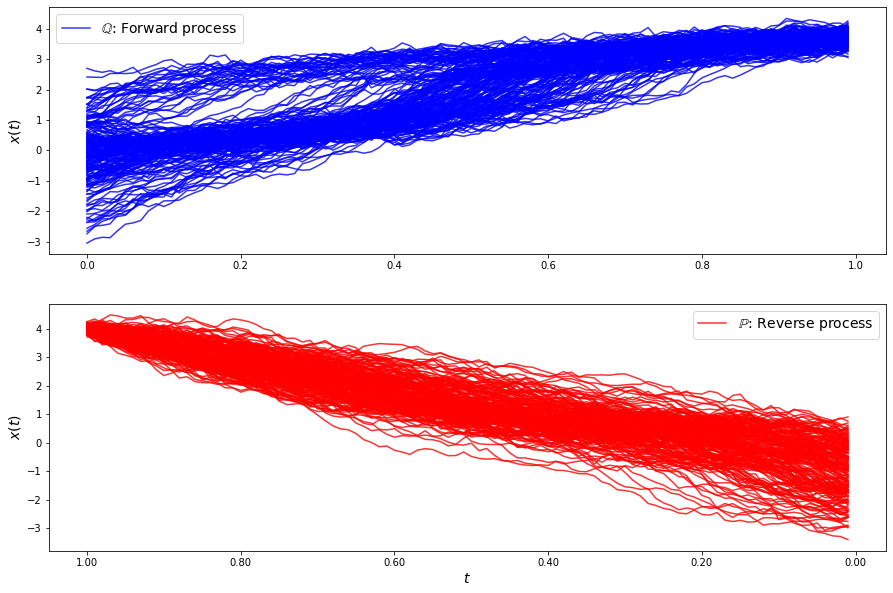

loss b 5.118456438492369
loss b 5.161652847426867
loss b 5.712408223781656
loss b 5.6567676112232546
loss b 5.218853628037082
loss b 5.944769469814118
loss b 4.9501808660639535
loss b 5.483672450794529
loss b 5.620670787201628
loss b 4.776269644467769
loss b 5.1371367811582385
loss b 5.2681441603240025
loss b 5.235718142832473
loss b 5.009536999692187
loss b 5.331730469812007
loss b 5.19535819855454
loss b 5.325100139670902
loss b 5.806485901314506
loss b 5.433094953828699
loss b 5.140733659222737
loss b 5.995863063295404
loss b 5.878024610187471
loss b 5.365983996685097
loss b 5.777803231093934
loss b 5.191597053195004
loss b 5.655672754287813
loss b 6.24119010301917
loss b 6.536713365738875
loss b 6.924969042553391
loss b 6.247472857075821
loss f 7.536372885716371
loss f 7.588850455645347
loss f 6.998625786492799
loss f 8.231560284564285
loss f 7.006622978844962
loss f 8.382230092643715
loss f 9.094748807955597
loss f 7.265031833897036
loss f 6.736824648295566
loss f 8.24985419998654

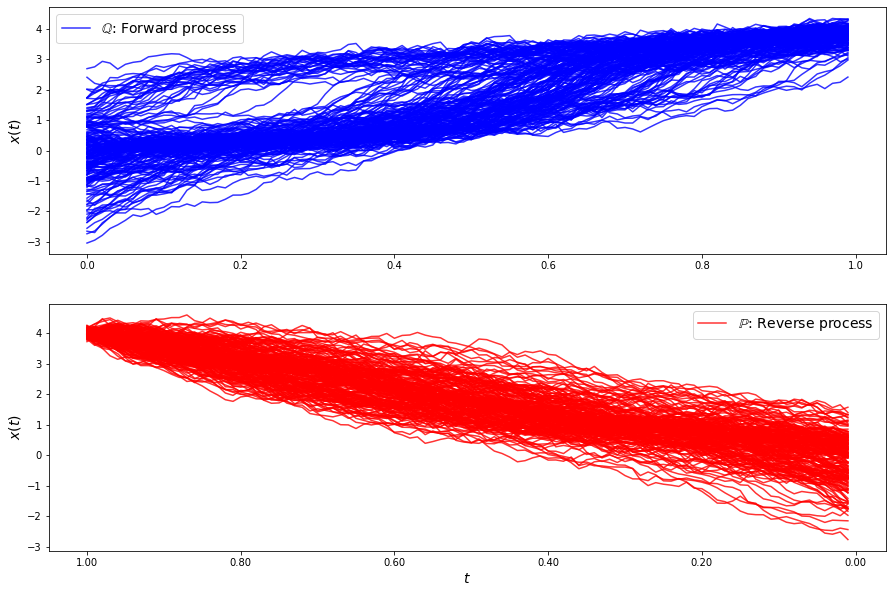

loss b 6.4812158709885725
loss b 6.464262083814791
loss b 6.902682086135098
loss b 6.668026517107388
loss b 8.318397071602048
loss b 8.053022778971732
loss b 7.988066412509744
loss b 8.575840919283841
loss b 8.111650107704765
loss b 8.108632481077812
loss b 8.088040851302715
loss b 8.095464675375764
loss b 8.816209026093137
loss b 9.126169232793037
loss b 8.875671774498876
loss b 9.506999426773197
loss b 9.249486838589824
loss b 8.985366028105057
loss b 8.596847618160679
loss b 9.41429220238814
loss b 9.271895954035571
loss b 10.419104714679682
loss b 9.361998947164288
loss b 9.84445027812897
loss b 9.191668118945286
loss b 9.850721906532405
loss b 9.552953679524139
loss b 8.62033197259422
loss b 10.194330369259454
loss b 11.174117401610514
loss f 8.54426048500148
loss f 7.913730742280949
loss f 8.656014787433001
loss f 6.72038423641315
loss f 6.209438964430796
loss f 7.185385063262153
loss f 7.342972624474212
loss f 8.496157767591553
loss f 6.535275610556379
loss f 9.4969987235354
los

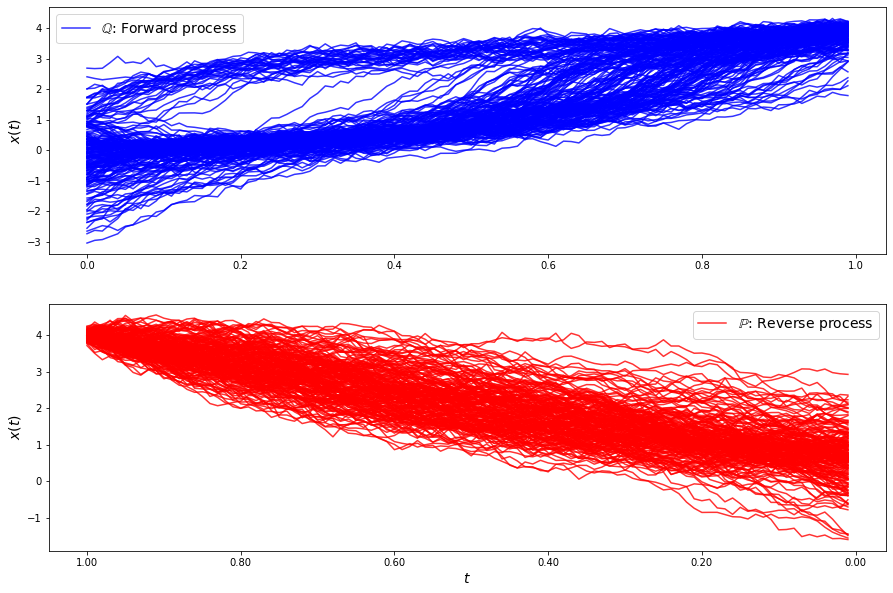

loss b 13.075948326905747
loss b 10.30443182402652
loss b 11.440626518827171
loss b 11.739171321604761
loss b 12.336428427142367
loss b 12.38297476900019
loss b 12.208756874338148
loss b 11.860489597863108
loss b 11.858812118782835
loss b 12.854888798392691
loss b 12.234386275220592
loss b 12.782516719995666
loss b 12.863384551425183
loss b 13.336545743303336
loss b 13.773318713550644
loss b 13.032892558883931
loss b 12.890945838195737
loss b 13.700194525009513
loss b 13.182429778289404
loss b 14.20584988505855
loss b 12.124484343705014
loss b 14.224492639732272
loss b 12.382229012816282
loss b 13.19765938987112
loss b 13.690189069582807
loss b 13.7243871272023
loss b 13.838900399288262
loss b 13.156961127681434
loss b 12.468179632262514
loss b 13.89441003043754
loss f 15.826390863502475
loss f 12.313018328186212
loss f 12.089766467028051
loss f 13.701635974863745
loss f 14.143822935128732
loss f 10.62942410122583
loss f 14.40829209367415
loss f 13.558460624343798
loss f 12.37659146294

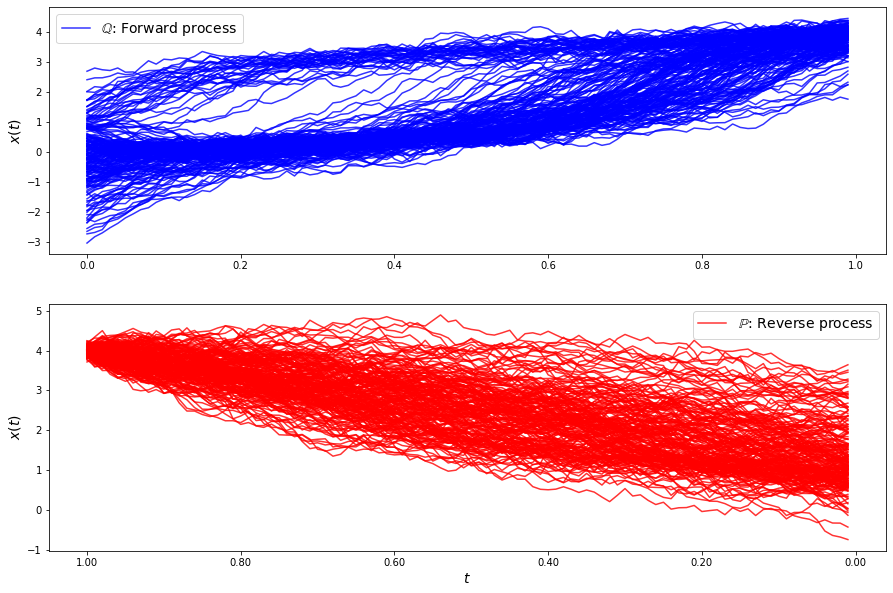

loss b 13.798528052736557
loss b 14.900076524823657
loss b 15.128351893892834
loss b 14.714260432244583
loss b 15.28556911311868
loss b 13.996331527755716
loss b 12.859057296562911
loss b 13.860239818079334
loss b 14.4436936034294
loss b 12.694510862773033
loss b 16.095495833143673
loss b 14.518271134934235
loss b 13.524616171422682
loss b 14.423540056067456
loss b 14.675861976505432
loss b 15.159980461438503
loss b 15.690395913051535
loss b 14.404172997199385
loss b 14.273056731167644
loss b 13.052282604999185
loss b 13.620184179700228
loss b 15.270535238369769
loss b 15.259736684649463
loss b 13.809313615662118
loss b 14.383592267091874
loss b 14.248447258873894
loss b 14.41135000207134
loss b 13.972538336743288
loss b 14.911591545335753
loss b 14.431959982670985
loss f 17.906879926938846
loss f 17.252475191663926
loss f 18.47755810512143
loss f 20.03282162588212
loss f 20.010020104792552
loss f 16.93352642848005
loss f 18.792679042526853
loss f 17.737939273280762
loss f 16.793721074

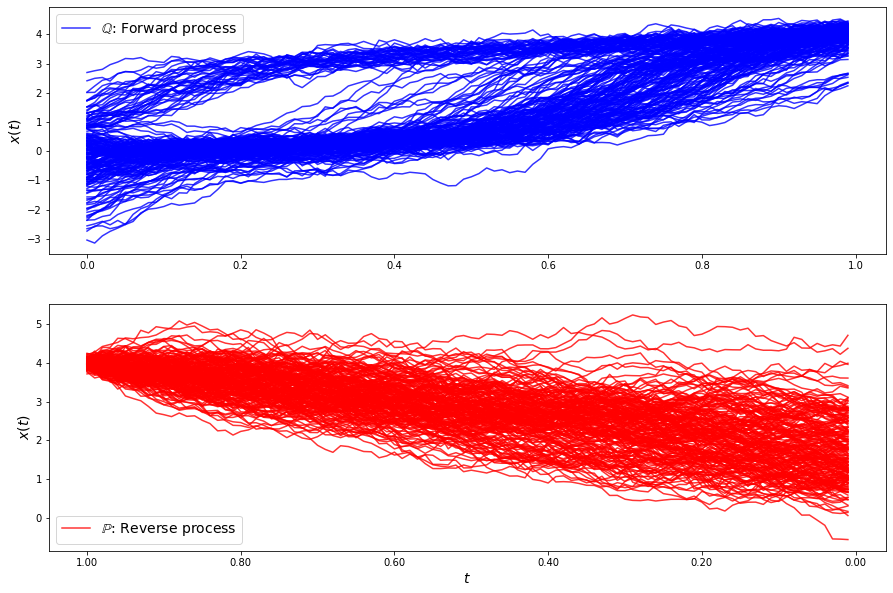

loss b 15.66116056049182
loss b 15.522657146894748
loss b 15.524440274628612
loss b 14.561810949723723
loss b 15.55981398016747
loss b 15.378538606960976
loss b 14.122530275983298
loss b 15.429144432711785
loss b 14.035005348897744
loss b 16.334711802222248
loss b 15.216097431270283
loss b 15.261204985566058
loss b 13.982281900636883
loss b 15.50060920345887
loss b 14.978876470390572
loss b 17.06385802880688
loss b 16.252235983624818
loss b 15.75445767074837
loss b 15.69631202820902
loss b 14.866588587510213
loss b 13.539732578738203
loss b 15.795424242884529
loss b 14.846118278872344
loss b 14.208469807608386
loss b 14.763147201931375
loss b 15.538948170980659
loss b 15.39264714251498
loss b 13.737153638891591
loss b 16.046863240348546
loss b 16.622490240328524
loss f 13.87789545002343
loss f 12.611969280369383
loss f 14.306425958124821
loss f 13.040388084716351
loss f 14.997067977648523
loss f 12.683972295023667
loss f 13.694018438495583
loss f 14.397912828366094
loss f 13.3229601324

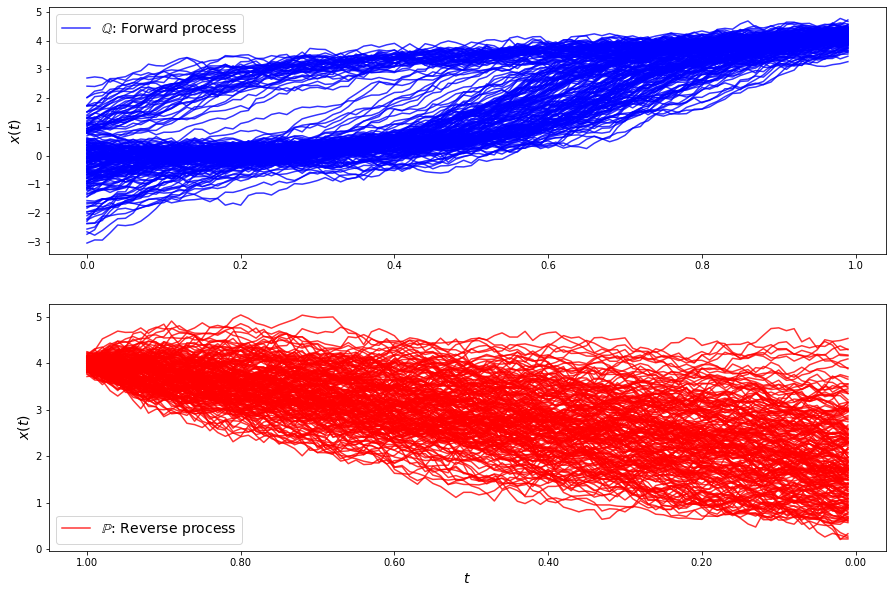

loss b 15.594611831356259
loss b 17.724015708875076
loss b 15.122233776868692
loss b 15.768817720985057
loss b 16.222332834633203
loss b 17.43930967735546
loss b 15.235002606174369
loss b 14.272533941036645
loss b 15.213521117992746
loss b 17.576855854819634
loss b 16.40683833713125
loss b 15.205788491929965
loss b 15.611196499625395
loss b 15.02038624645776
loss b 16.372855028386
loss b 16.647128213705443
loss b 16.641705635388643
loss b 15.292360535517934
loss b 15.494093247915696
loss b 15.726794501331588
loss b 16.96978118496895
loss b 15.737746753428194
loss b 17.901575245731472
loss b 17.029761651746274
loss b 15.503963589346533
loss b 15.449330576647991
loss b 15.384147924706937
loss b 16.691366354775816
loss b 16.590686173884436
loss b 15.624254186873152
loss f 11.803620521722685
loss f 14.600756130852833
loss f 12.557897830606544
loss f 11.802801722845782
loss f 11.88966447275767
loss f 12.129034547187024
loss f 12.34936521599387
loss f 12.60436577266987
loss f 12.942830795282

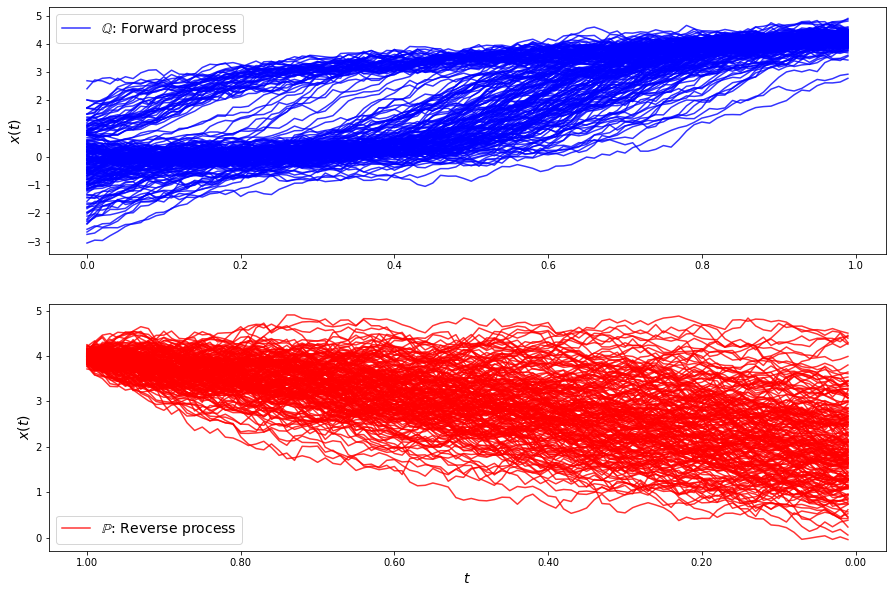

loss b 17.05661088320462
loss b 16.25088016291959
loss b 16.15757476938236
loss b 16.675950662310974
loss b 17.026875995809878
loss b 16.170404776617804
loss b 15.973590673119695
loss b 16.398517093697837
loss b 16.3441388419101
loss b 16.476704398349227
loss b 16.553630770421346
loss b 15.394989671563645
loss b 17.15970321053433
loss b 15.91081624817187
loss b 15.988783013123347
loss b 15.578920709442542
loss b 17.018134791204425
loss b 16.53210890498757
loss b 17.461395065154186
loss b 16.952700997772645
loss b 16.210733869369246
loss b 19.671698581947975
loss b 17.287872292568856
loss b 16.859687701497194
loss b 18.465757535647512
loss b 17.731230545327662
loss b 17.171508681225347
loss b 17.037061870592673
loss b 16.5694180373159
loss b 15.971995126042724
loss f 11.727444502812281
loss f 12.123363795283076
loss f 12.072371716943998
loss f 12.590485143602452
loss f 13.718367355638899
loss f 13.316311691327625
loss f 13.254689327674539
loss f 12.719362544880527
loss f 12.658180663701

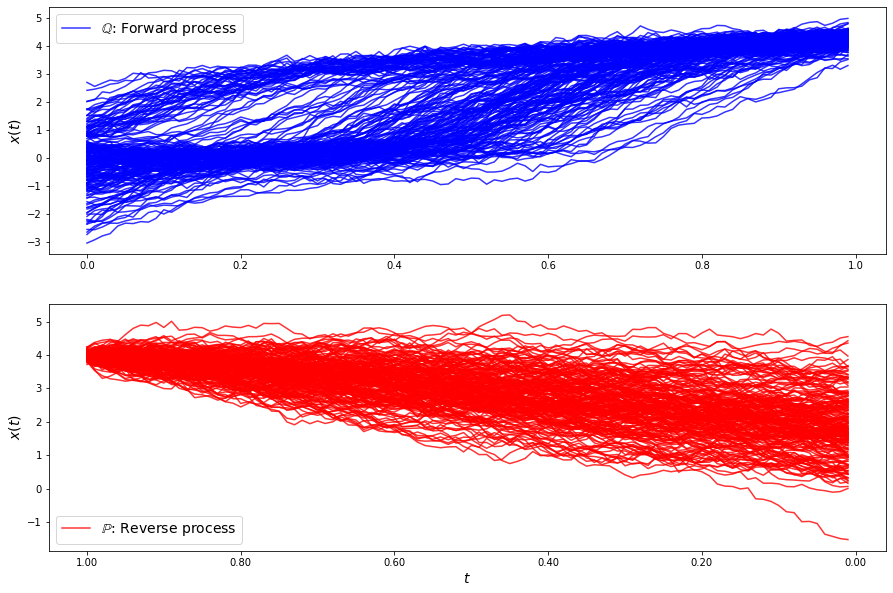

loss b 16.485273761215307
loss b 18.30777781420265
loss b 17.388264894500065
loss b 18.660733342296837
loss b 18.98774253716481
loss b 17.8085264667709
loss b 17.651742705229687
loss b 15.536323832523319
loss b 17.92855098028487
loss b 17.425468658694523
loss b 18.490637488435183
loss b 16.39739293304778
loss b 16.5595355599618
loss b 17.610779074704315
loss b 16.398202266096565
loss b 17.01029445311045
loss b 18.566347465764316
loss b 16.911740267091464
loss b 17.876576310609178
loss b 17.55973383975889
loss b 18.659453576142468
loss b 16.151404985838692
loss b 18.82227936831771
loss b 17.30672094167489
loss b 16.758280409916672
loss b 17.399130537808716
loss b 17.62244588763969
loss b 17.972602589571643
loss b 17.176219820033147
loss b 16.654000999968044
loss f 12.500762273062783
loss f 12.595350396313444
loss f 12.523888386270098
loss f 12.327830539982802
loss f 12.913157745188336
loss f 13.599044137728448
loss f 12.488685046566047
loss f 13.3780436258113
loss f 12.240164541663198
l

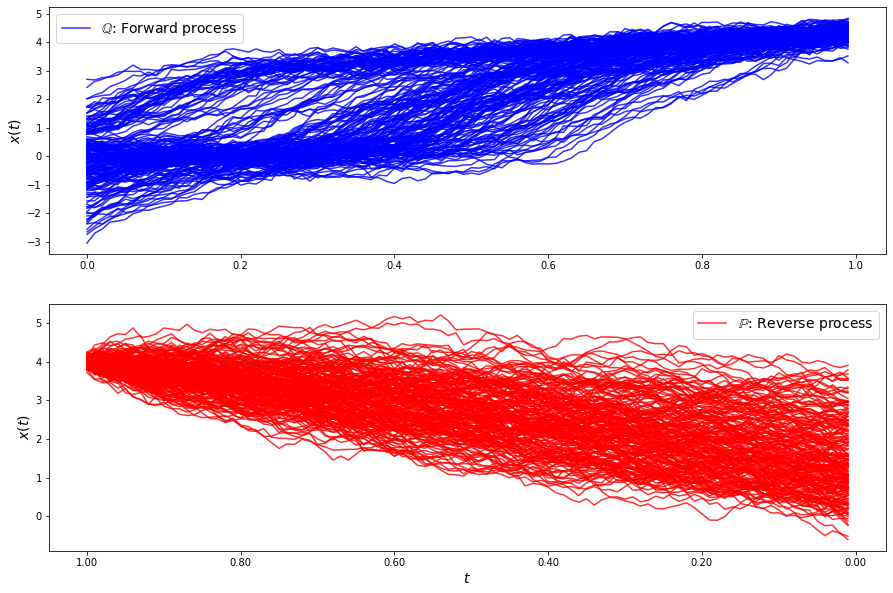

loss b 16.089847982081842
loss b 18.16216142206609
loss b 16.776852927886413
loss b 16.365589686674177
loss b 15.521498332480766
loss b 17.577052851901836
loss b 16.997017059921948
loss b 17.804809777963268
loss b 18.609879397409888
loss b 18.406789494924038
loss b 17.372270519045202
loss b 18.0831055188155
loss b 16.775885525544396
loss b 17.68640285599792
loss b 16.378052904759624
loss b 17.182527495792662
loss b 16.658098177335628
loss b 16.86230850731037
loss b 17.429110326016456
loss b 17.069767292409875
loss b 15.591559199093021
loss b 16.46300694896248
loss b 18.20870552252867
loss b 17.651894013153203
loss b 17.777100117810637
loss b 16.548171741849522
loss b 17.2102563345211
loss b 16.997556636218274
loss b 17.366658357278983
loss b 17.188473930304287
loss f 12.56795424836844
loss f 12.377258814570583
loss f 12.603175894624679
loss f 11.888437185105653
loss f 12.448306606857896
loss f 12.438314346301938
loss f 11.926876082451715
loss f 12.284309933758966
loss f 11.919833488917

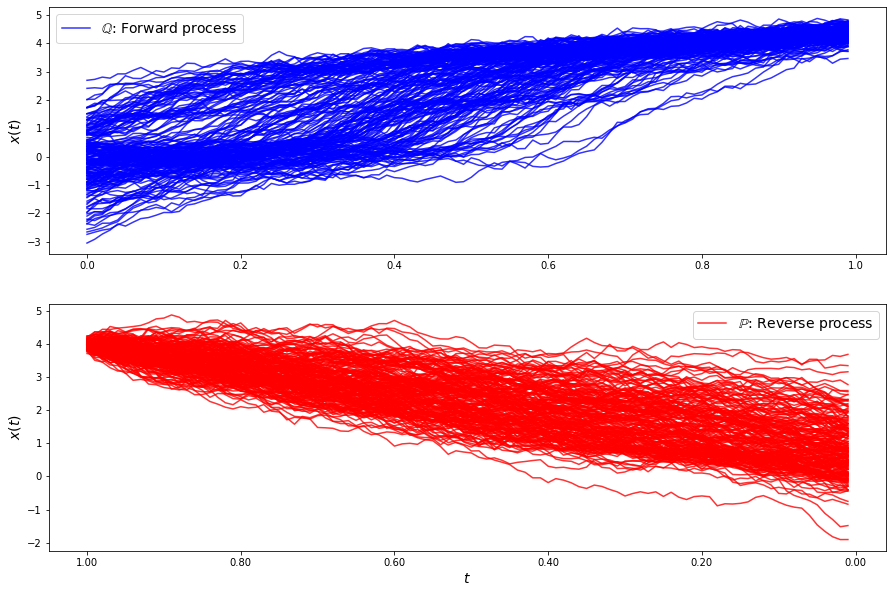

loss b 15.618381448870062
loss b 17.17451002148111
loss b 17.203671280866107
loss b 16.17081882464121
loss b 16.86498118884156
loss b 18.728437557149608
loss b 16.039942690038743
loss b 17.989017921177748
loss b 18.231440174053326
loss b 16.19040025947155
loss b 17.283015238187403
loss b 16.50740883031729
loss b 17.12455798448783
loss b 15.797524176692251
loss b 17.61114276380548
loss b 15.491857285995485
loss b 17.9284974790278
loss b 16.274692179695975
loss b 16.746157278620167
loss b 15.952701563568615
loss b 16.76244174964451
loss b 17.977964195686916
loss b 16.630160642129287
loss b 17.829780449968712
loss b 15.854543471495116
loss b 16.819074136494482
loss b 16.14744653924002
loss b 16.37780413795198
loss b 16.31749230125844
loss b 16.13641236552273
loss f 11.77487026554285
loss f 11.3475753791954
loss f 12.35494119783463
loss f 10.915271169258958
loss f 12.145705836769176
loss f 11.782663527481677
loss f 11.271070031991965
loss f 11.262034547907376
loss f 10.390830509661203
loss

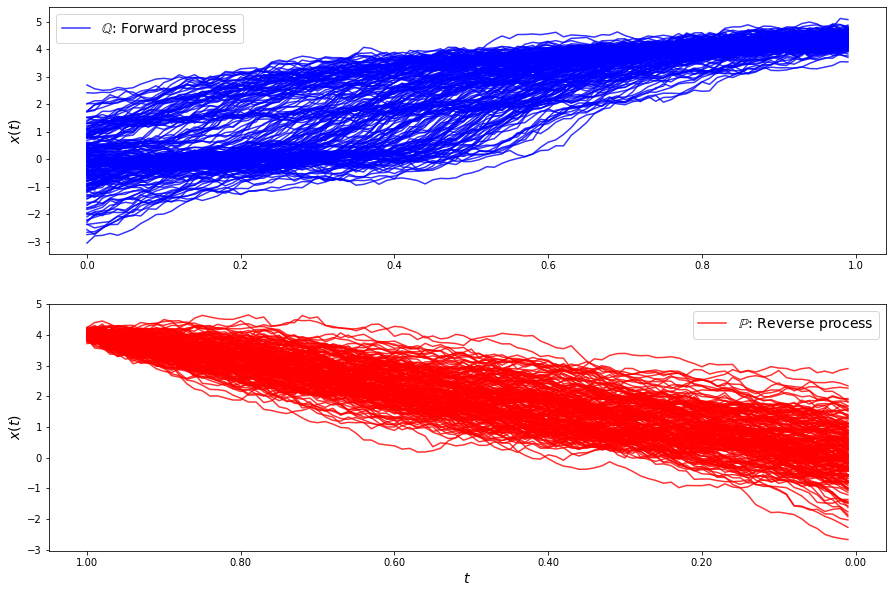

loss b 16.758546421365942
loss b 16.60536180738159
loss b 16.25850364666312
loss b 17.308346252983423
loss b 16.418477553736594
loss b 17.653840463491232
loss b 17.60458088421601
loss b 18.401049328534885
loss b 17.31330721012466
loss b 17.170351028967325
loss b 17.67573437570141
loss b 16.46200669310915
loss b 17.13495688400074
loss b 17.228760090706043
loss b 14.820834689436413
loss b 17.63824772405192
loss b 17.305444789684316
loss b 16.333567334308913
loss b 17.486480422606643
loss b 14.955711799956234
loss b 16.833340171296058
loss b 16.896669792147353
loss b 18.597860180112516
loss b 17.74213588024155
loss b 16.634792421763976
loss b 15.838479999130357
loss b 16.056211488328657
loss b 16.062418546185437
loss b 15.408065531960158
loss b 17.054490141903607
loss f 10.51801439636675
loss f 11.341672038340773
loss f 10.667204422803142
loss f 11.074860894206733
loss f 10.461077041335502
loss f 9.932257043306555
loss f 10.275427207358206
loss f 11.184943918243313
loss f 10.5505369717733

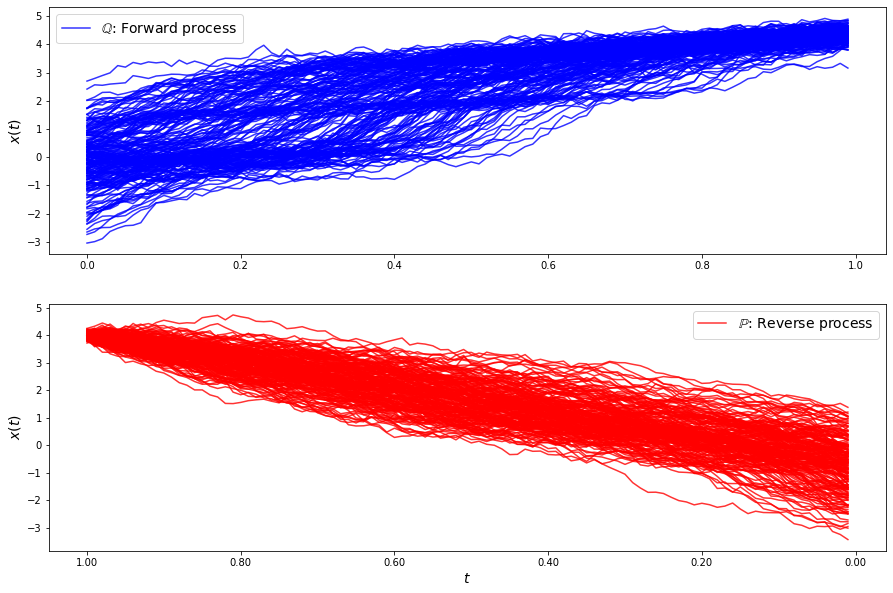

loss b 17.46965711198658
loss b 15.691137739084931
loss b 16.58873469487259
loss b 17.278719284032686
loss b 17.004342971366484
loss b 17.605858673675662
loss b 17.457921320984447
loss b 17.49364132620389
loss b 18.539003425559027
loss b 15.61716753801765
loss b 16.91383507634163
loss b 17.0513729570934
loss b 16.64505779213573
loss b 16.604115416754986
loss b 16.556364596594207
loss b 15.677804484664163
loss b 17.02282211500643
loss b 16.178569294832656
loss b 16.729251331537117
loss b 15.853735562776562
loss b 18.132077070797667
loss b 17.266793866294503
loss b 17.044718874514448
loss b 17.999168828914797
loss b 16.880506528661698
loss b 17.27530237689726
loss b 17.600902982582976
loss b 16.896868571844383
loss b 18.036349736382835
loss b 19.24472660676488
loss f 11.207248113195782
loss f 10.383892277391686
loss f 10.193609709376947
loss f 10.50320609469748
loss f 10.689515833321845
loss f 9.871354562828355
loss f 9.59629931371349
loss f 10.249018457677469
loss f 10.750565821504493
l

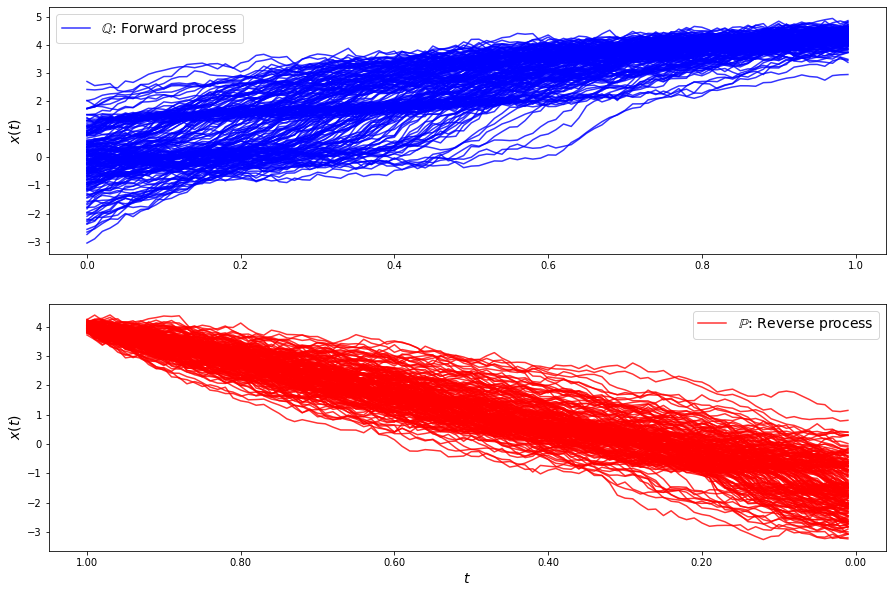

loss b 18.686678456413105
loss b 16.815445590262957
loss b 17.285971796781958
loss b 18.673770831832666
loss b 18.042158899265733
loss b 17.1087975758636
loss b 17.87806871309055
loss b 17.97068977238152
loss b 16.46819169759994
loss b 17.90268600586357
loss b 17.858523017136875
loss b 18.7688447839639
loss b 17.499771398928104
loss b 18.05498427965494
loss b 16.53602946077847
loss b 18.210015162324442
loss b 17.385641747239422
loss b 18.391698240915282
loss b 17.670755533516985
loss b 19.053952961656048
loss b 18.31463623981584
loss b 18.150886790551315
loss b 17.258908332160214
loss b 18.6931590957832
loss b 19.226291616114896
loss b 18.09648035860533
loss b 18.534806929602933
loss b 19.317931269698878
loss b 17.507224274200745
loss b 19.085093950019463
loss f 11.104047779651887
loss f 10.403738779790501
loss f 10.951280075363726
loss f 9.698363433837535
loss f 10.556458390749581
loss f 11.585548051705882
loss f 10.496645377489576
loss f 11.119230362502897
loss f 11.416103587404239
l

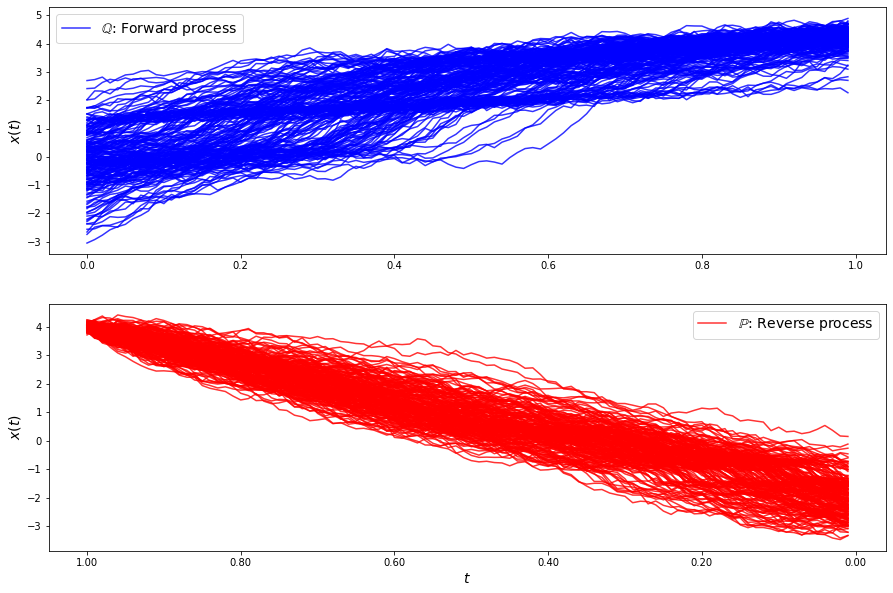

loss b 19.347379605213774
loss b 19.31827992341731
loss b 18.98740826076977
loss b 19.483405707102847
loss b 19.067331336075846
loss b 18.836151577801736
loss b 19.531162760204197
loss b 19.910861234379
loss b 19.131571019291027
loss b 19.648940482267445
loss b 20.249788716247547
loss b 18.98487773034427
loss b 20.10943211845241
loss b 18.814631061174328
loss b 19.769545779885817
loss b 20.99643005499229
loss b 19.676759891730455
loss b 19.88527816921907
loss b 21.18289085320232
loss b 20.488598397181384
loss b 18.88203861749947
loss b 19.542416906103135
loss b 20.609401150927372
loss b 19.42008860965399
loss b 21.836623611796327
loss b 18.938973189102075
loss b 19.69321348344325
loss b 19.884214654667453
loss b 19.66298846473738
loss b 19.814814416556604
loss f 12.4893942070255
loss f 13.290775132949028
loss f 12.093675096074039
loss f 11.987412480571411
loss f 11.801153143657874
loss f 12.642780001141174
loss f 11.468852157868906
loss f 13.15530424769208
loss f 11.790279638255617
los

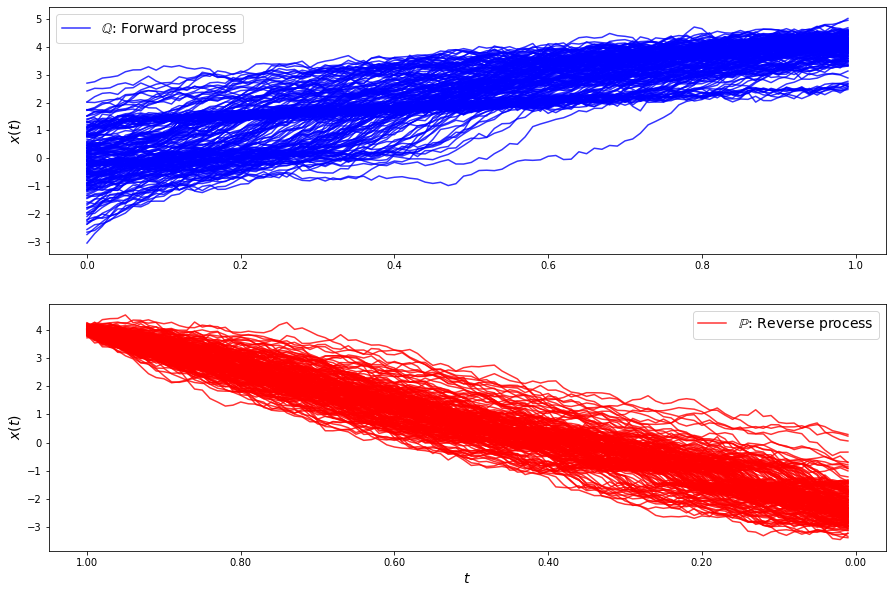

loss b 20.7585947928158
loss b 20.65679254623384
loss b 20.437277783455087
loss b 21.26835119551525
loss b 20.800507134285404
loss b 21.11970230328895
loss b 21.057917699198512
loss b 21.58166189009837
loss b 21.842983964968237
loss b 19.918642087699276
loss b 20.720570341081377
loss b 21.535979648528585
loss b 21.747905229410936
loss b 20.793637366959594
loss b 21.46468832596346
loss b 21.387594436516977
loss b 22.442215730192196
loss b 20.910303588005142
loss b 20.925361984351714
loss b 22.298975090687367
loss b 21.976966288483563
loss b 22.48225632273468
loss b 23.823912418378917
loss b 22.38943082326337
loss b 22.4403669491882
loss b 22.246849894505328
loss b 23.257749068832354
loss b 21.858919575228473
loss b 22.377648143078066
loss b 22.6896441483521
loss f 15.416662873121702
loss f 13.924814977106662
loss f 14.61203685370674
loss f 15.785197909876999
loss f 17.155547312506386
loss f 17.735684985063845
loss f 16.511084668809872
loss f 17.03209347900507
loss f 19.421818777419194
l

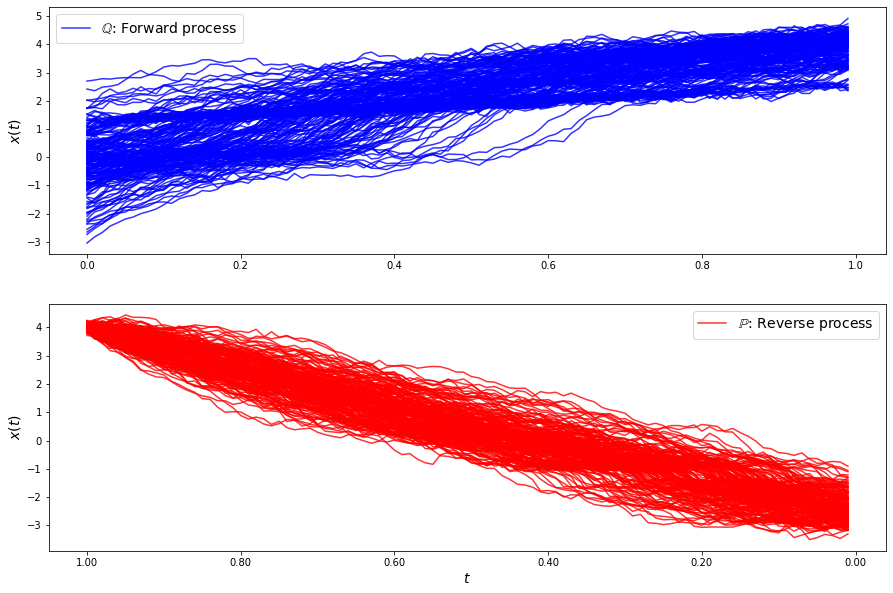

loss b 22.17823698828243
loss b 23.654979713136278
loss b 21.144225675503264
loss b 24.141161874746004
loss b 22.436622931786104
loss b 23.563550612622837
loss b 22.444373609227057
loss b 22.354469006136444
loss b 22.532496140189185
loss b 21.011845094060426
loss b 21.627648415056694
loss b 22.663423535713974
loss b 23.04698139041419
loss b 23.622872904923828
loss b 23.035338006422943
loss b 23.13518060338908
loss b 22.239423063058883
loss b 23.963718712879178
loss b 22.024146017505238
loss b 23.729638430255484
loss b 22.123949795832303
loss b 24.898459294327488
loss b 23.474984073347066
loss b 23.429152463526684
loss b 23.47905703653376
loss b 22.66979590974439
loss b 22.506870125676148
loss b 21.809072991701722
loss b 23.576211106093236
loss b 23.18061884508689
loss f 20.00177499298176
loss f 20.148008310367814
loss f 19.759454184334142
loss f 19.78906385270802
loss f 21.88590821793913
loss f 23.20432532377488
loss f 21.184101720398385
loss f 21.74870497938425
loss f 20.2037729339446

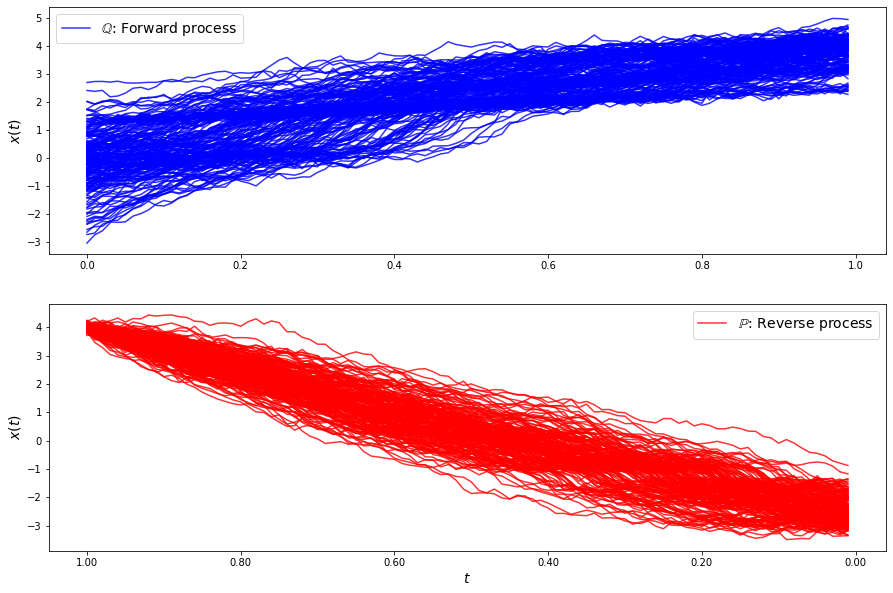

loss b 21.489796692269763
loss b 22.710602422319234
loss b 22.010127347800356
loss b 22.624162805522694
loss b 22.32209215061883
loss b 22.99199394970077
loss b 22.61314913700674
loss b 21.93215254544192
loss b 21.9170381474302
loss b 23.22388864336684
loss b 23.205329998840266
loss b 22.60888768347215
loss b 22.777287474987414
loss b 22.469063148776364
loss b 22.570602316083356
loss b 23.257678547675713
loss b 22.982302798489584
loss b 22.051975075591372
loss b 23.22910144907342
loss b 21.32325162321285
loss b 21.333411318746705
loss b 22.767439029989983
loss b 21.406753151557798
loss b 22.63513444643013
loss b 22.93732459931364
loss b 22.072573826082053
loss b 22.006953106072494
loss b 23.14922607182401
loss b 20.91681619944336
loss b 20.23929319649288
loss f 18.357126770841617
loss f 19.833259738453755
loss f 18.809117539492103
loss f 17.159952963170902
loss f 18.760904104792065
loss f 17.575620018511515
loss f 17.86268834883446
loss f 18.982901552489974
loss f 20.16967223969935
los

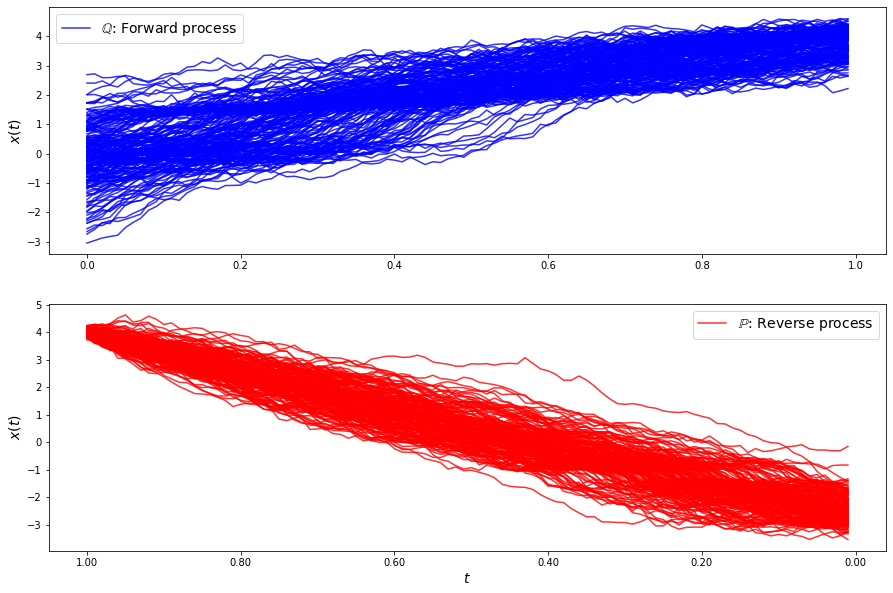

loss b 19.838735363279017
loss b 19.715572515606972
loss b 19.787218022093406
loss b 19.526192911028186
loss b 18.542860244512163
loss b 19.007285620940692
loss b 19.668488427620648
loss b 19.323281121688986
loss b 19.55774792015729
loss b 19.09549931217324
loss b 20.531938041112735
loss b 19.13960461754537
loss b 19.107077022950623
loss b 19.77421321785091
loss b 20.46891035707879
loss b 18.848981408578837
loss b 18.17792858247084
loss b 19.931588894158203
loss b 18.66161596851796
loss b 16.808090233234143
loss b 18.919341370412717
loss b 18.004933149693617
loss b 17.671071679811707
loss b 17.672462535233066
loss b 18.460005599868033
loss b 16.374589681210892
loss b 17.48539766553814
loss b 16.980671193578868
loss b 16.183798053205514
loss b 17.025431791846746
loss f 11.740984917586879
loss f 13.156346830376116
loss f 11.927186551761116
loss f 13.474569184121005
loss f 11.383743316928813
loss f 12.200088164581864
loss f 12.820021301583605
loss f 11.700780215141993
loss f 13.5658142182

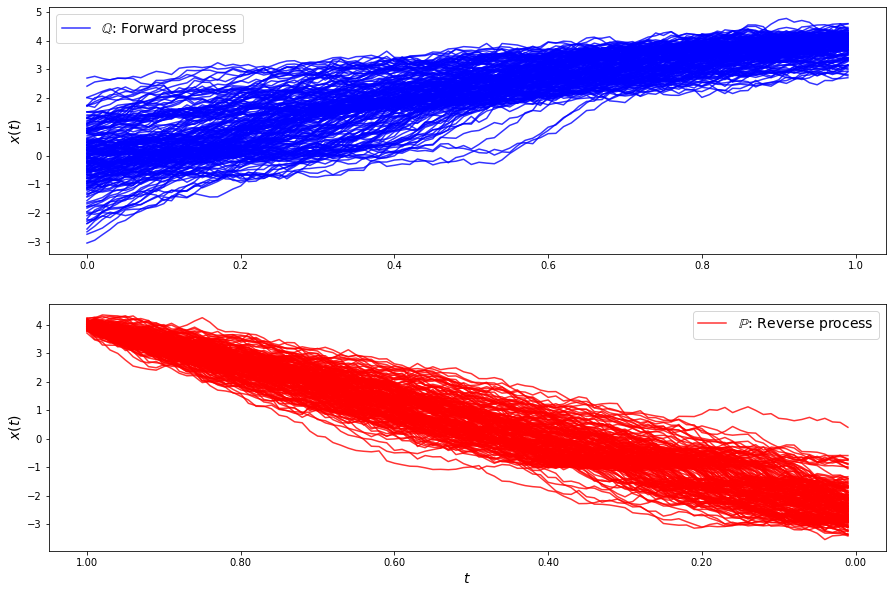

loss b 15.192907441537889
loss b 14.457553669295638
loss b 14.87263005232081
loss b 14.815496635804243
loss b 14.051228039210534
loss b 14.073874622470589
loss b 14.692670484720317
loss b 13.870532540127343
loss b 15.086732158651118
loss b 13.421668355234633
loss b 14.07099242192499
loss b 13.68643646106785
loss b 12.154320454150676
loss b 12.50735425368481
loss b 12.046590082867015
loss b 13.409404835116774
loss b 11.840313993628964
loss b 12.523525938700645
loss b 10.494956649180066
loss b 12.161497203938492
loss b 12.032649530352872
loss b 11.34480288118924
loss b 11.305176799990612
loss b 10.483874660977763
loss b 10.61164400040996
loss b 10.152444973257978
loss b 9.35343547826683
loss b 10.180044926401813
loss b 10.467147687341258
loss b 10.784153670047438
loss f 8.047333372298446
loss f 7.559257763029077
loss f 7.751702208021093
loss f 8.071404429644758
loss f 9.113498020292871
loss f 7.265637862113367
loss f 6.464377240362998
loss f 7.655510806945997
loss f 7.004259079219912
los

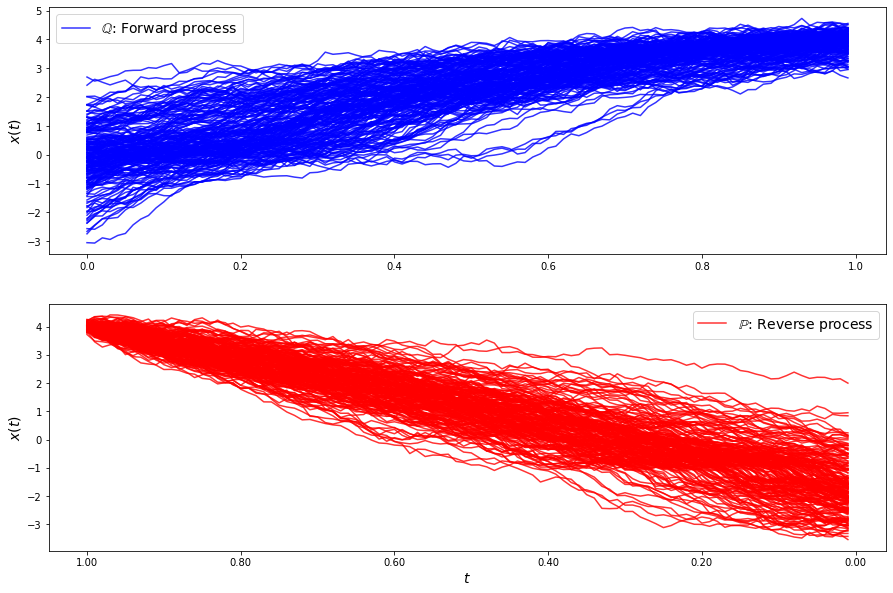

loss b 8.027003014002457
loss b 7.432600222883288
loss b 7.247132292401324
loss b 6.523222457717465
loss b 7.398062872471634
loss b 7.090270022169985
loss b 7.831970339302491
loss b 7.885699839609457
loss b 6.7325322514669494
loss b 6.252891389301076
loss b 5.329381754028584
loss b 6.391474645314225
loss b 5.913331230968668
loss b 6.296861211122084
loss b 5.725454111645655
loss b 5.676817524110249
loss b 4.587820490150541
loss b 5.50424343903668
loss b 4.228774097502877
loss b 5.481675292859556
loss b 5.067670768168365
loss b 4.9544622400995335
loss b 5.360926803843465
loss b 3.9533616530733617
loss b 4.0958178904306495
loss b 3.872114551541542
loss b 3.1797923193585618
loss b 4.149052997083531
loss b 4.078438874696559
loss b 3.7680620621919725
loss f 5.789753314161497
loss f 4.389841655974172
loss f 5.040982935609562
loss f 5.519729988448623
loss f 4.031455454092972
loss f 3.8119723190271766
loss f 4.58364813739394
loss f 6.4108802802734
loss f 4.256726338099724
loss f 4.1485262456861

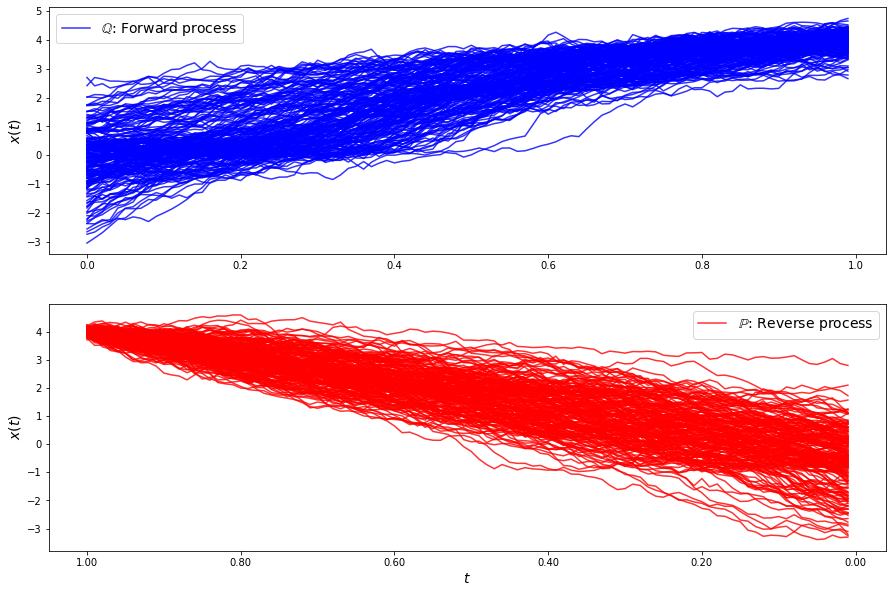

loss b 2.9318512690591096
loss b 3.2865026084770794
loss b 1.53983999839883
loss b 3.4861450906071103
loss b 2.733173952139799
loss b 3.220139963268478
loss b 2.730590274790956
loss b 2.559413561302848
loss b 2.70268345007324
loss b 2.612823174966338
loss b 1.429803137553187
loss b 1.721662215541002
loss b 2.176675587408087
loss b 2.4223846793248303
loss b 2.255397293479579
loss b 2.880005743699912
loss b 1.9225747609708557
loss b 2.017422923192515
loss b 1.3411684899377165
loss b 2.541778884389554
loss b 3.0609776687418604
loss b 2.6741613625419833
loss b 3.3437653792831123
loss b 2.666250249813229
loss b 2.195881765619067
loss b 2.6290665112237788
loss b 2.31742946394816
loss b 2.496306434815663
loss b 3.0414615328638157
loss b 2.4552498701164556
loss f 3.888956518404401
loss f 3.5375888282283734
loss f 3.656021412960243
loss f 4.456953857208195
loss f 4.705213239259163
loss f 4.646236257793942
loss f 4.353983458550799
loss f 4.722864256243701
loss f 4.006221654335048
loss f 3.462102

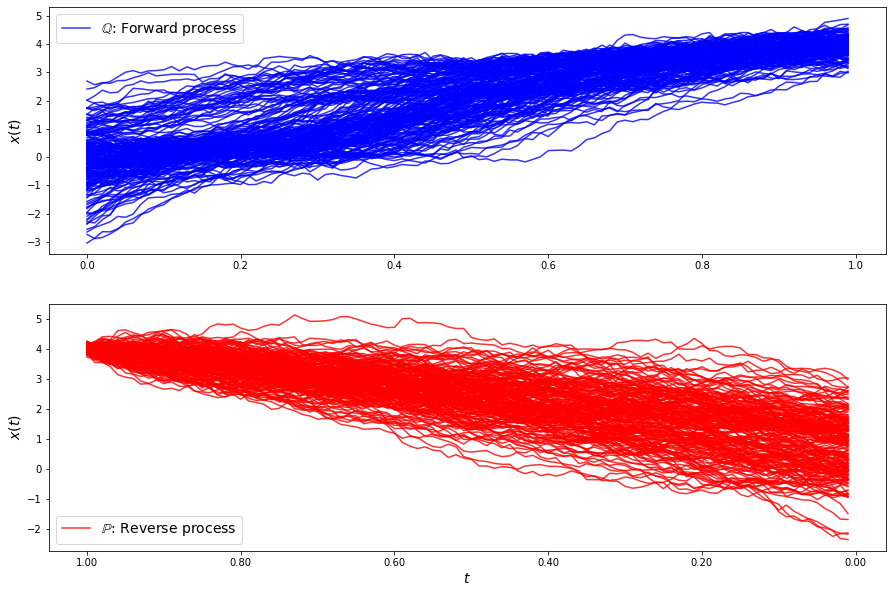

loss b 3.2304214840118703
loss b 3.3548472539613177
loss b 3.381962306992207
loss b 3.3486318277527993
loss b 2.96709862476321
loss b 3.4796135654416807
loss b 3.7336247918631944
loss b 4.359770936327169
loss b 3.6438387909605527
loss b 4.653841759736593
loss b 4.3607529482957945
loss b 4.062376066437037
loss b 4.004932417008552
loss b 4.569764101244097
loss b 4.939756976107456
loss b 4.776887910820793
loss b 5.084994652309037
loss b 5.249412568970779
loss b 4.197546993547495
loss b 5.283346860236924
loss b 4.682205936115392
loss b 6.268091522660596
loss b 5.827187593222894
loss b 5.942828719952959
loss b 6.92471376161444
loss b 6.836387135332598
loss b 6.028914332996572
loss b 6.039726452372038
loss b 8.244521483306691
loss b 7.453113004017253
loss f 5.561395636210338
loss f 5.110882908987382
loss f 5.289055358592937
loss f 6.269555199122152
loss f 5.782854417301323
loss f 5.195955005342109
loss f 5.830047594542825
loss f 6.558198000080154
loss f 5.876004123896289
loss f 6.05255087484

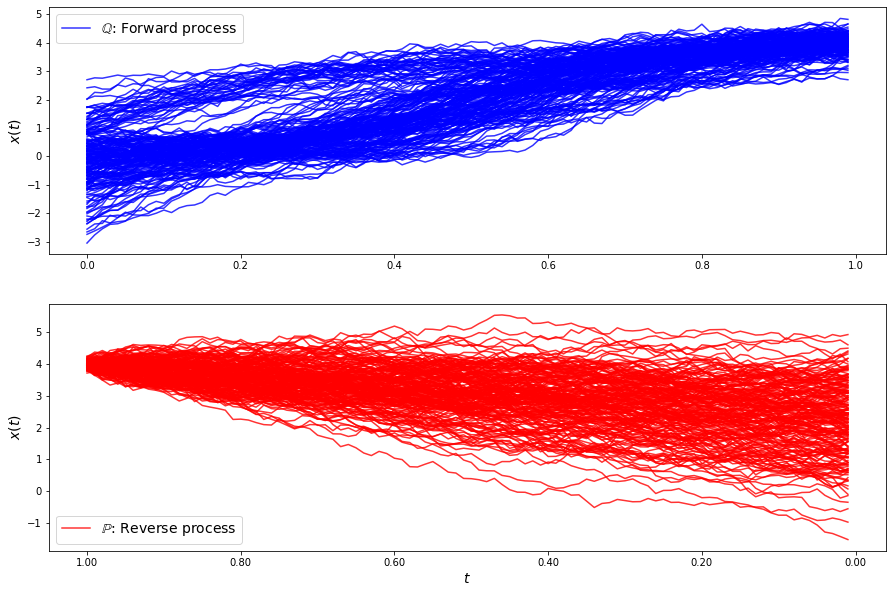

loss b 6.441351792428554
loss b 7.962620740454965
loss b 7.9151956476178835
loss b 7.371507458623911
loss b 8.799173039880586
loss b 8.275032670091052
loss b 8.404517364700895
loss b 8.72082957393944
loss b 9.261536785811012
loss b 10.453126903619228
loss b 10.915745940723971
loss b 10.679003610336977
loss b 9.629303148853676
loss b 10.179912502588957
loss b 12.131647876409295
loss b 11.573803617684245
loss b 12.05290295466243
loss b 11.797510246415603
loss b 11.321374749242256
loss b 11.857401576221267
loss b 14.349389860520729
loss b 13.114303565013596
loss b 14.052774987156734
loss b 15.543209528223883
loss b 13.564804419301476
loss b 14.035656233566371
loss b 14.781506393505722
loss b 14.138132321810822
loss b 16.41355425148147
loss b 14.761953423210116
loss f 8.503101799138411
loss f 9.59324756196854
loss f 8.094788702058565
loss f 8.672474257004671
loss f 8.427936726278276
loss f 9.631448927475297
loss f 8.697198564739766
loss f 8.125807167917875
loss f 9.192187816465404
loss f 1

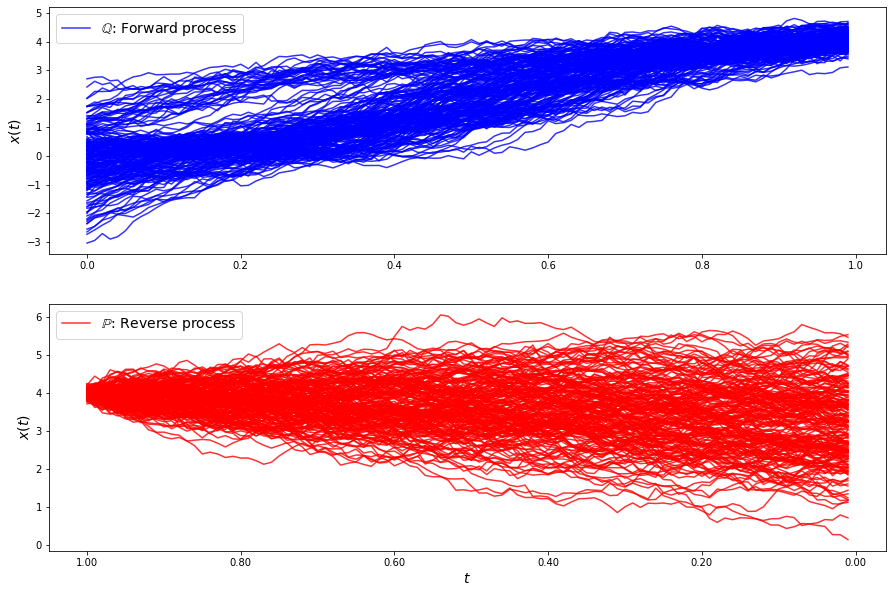

loss b 15.490675465317482
loss b 15.163126155973412
loss b 16.990263575511516
loss b 16.41235213401405
loss b 17.030806443801367
loss b 19.241904924623583
loss b 14.743844398542429
loss b 17.412658853226613
loss b 17.174114824740577
loss b 16.81377573043738
loss b 16.055167663845143
loss b 17.32431089357499
loss b 17.921244823448816
loss b 15.395278666276498
loss b 17.54773510446007
loss b 16.537776491701475
loss b 18.166984512968813
loss b 15.481146756703437
loss b 17.84744838010621
loss b 15.148108173937242
loss b 15.190622940296736
loss b 16.026560632096512
loss b 17.702982819243683
loss b 16.052775218816407
loss b 17.06504207736944
loss b 16.672902017698586
loss b 15.474924260174708
loss b 19.105527973196452
loss b 18.29694443873938
loss b 18.69272391788241
loss f 10.247826424372718
loss f 9.577315177323175
loss f 10.045931171696687
loss f 10.012027793879858
loss f 10.703492605324854
loss f 10.179177646083904
loss f 9.572141297405707
loss f 9.791393467307303
loss f 10.8089704095521

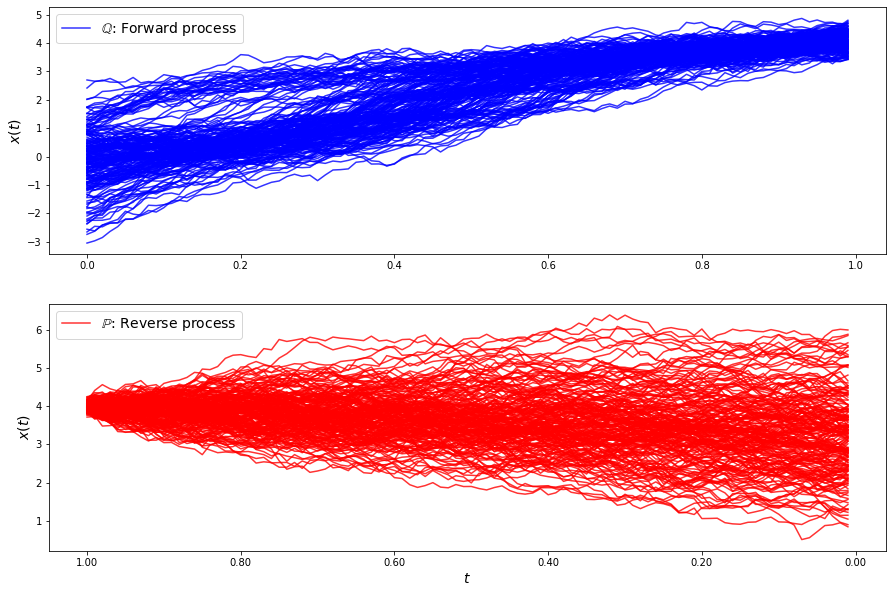

loss b 19.319746584986422
loss b 20.692074723724286
loss b 18.171256081327144
loss b 17.808730744782434
loss b 18.298440206336046
loss b 19.722917687566856
loss b 18.14719083923431
loss b 18.734597982255348
loss b 20.05781449601986
loss b 17.588587454118645
loss b 18.3947962321553
loss b 17.72391363331066
loss b 18.39287143385393
loss b 17.668699279095613
loss b 20.025806954430905
loss b 19.047753561967067
loss b 20.112560522838244
loss b 19.887063476770056
loss b 17.55802685964994
loss b 19.735731508163543
loss b 17.748263703405673
loss b 16.335408522449193
loss b 17.78114994724325
loss b 20.367071755707986
loss b 16.507216292516368
loss b 18.49255937789608
loss b 17.546582394664256
loss b 17.32185007855577
loss b 16.06397016391167
loss b 16.3028962706713
loss f 9.499850248610242
loss f 10.374151442179862
loss f 10.794507513519788
loss f 10.75615795799457
loss f 9.424646043265339
loss f 10.023182912113608
loss f 9.81144515635261
loss f 10.782545166451852
loss f 10.196816076655903
loss

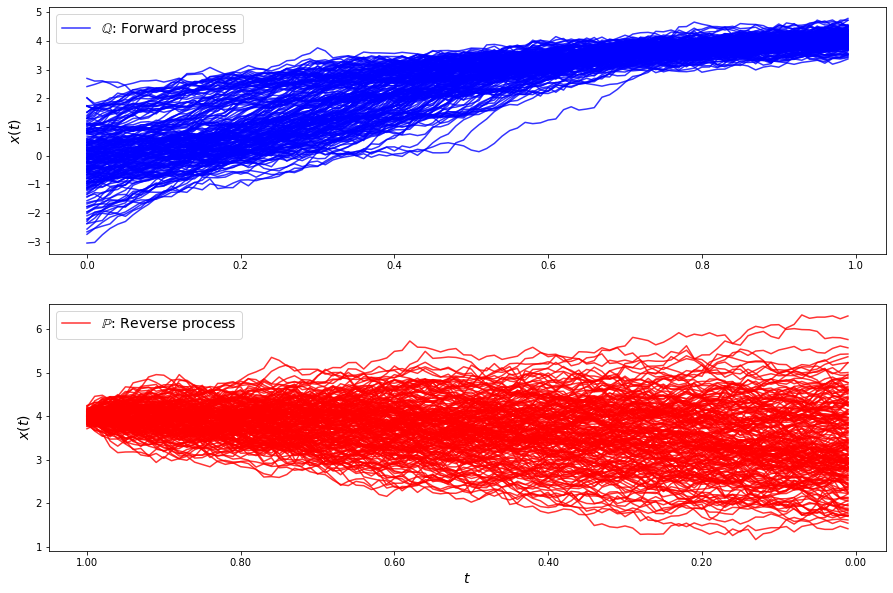

loss b 18.157100911674817
loss b 17.33547041944342
loss b 18.19877593627376
loss b 15.19847294279639
loss b 17.460073850307776
loss b 15.582326061703366
loss b 18.889869696466736
loss b 16.902316333839888
loss b 17.77994429224267
loss b 16.52787008223429
loss b 16.81966874933078
loss b 14.97098203387842
loss b 17.253143388123974
loss b 15.63168845300076
loss b 16.05315790303111
loss b 15.093130613452166
loss b 13.410796522106667
loss b 16.037164197615244
loss b 15.253372088884916
loss b 16.195000812750205
loss b 14.035876025242825
loss b 14.892368816064641
loss b 13.762916416239385
loss b 14.740608151628381
loss b 13.802752309938734
loss b 13.063371632993686
loss b 14.289510778352835
loss b 12.619430921098559
loss b 14.115028149539008
loss b 11.999594231693637
loss f 8.582946316504598
loss f 8.51695741263344
loss f 8.48433191525999
loss f 8.766268543775665
loss f 9.363717781572209
loss f 9.143139017149993
loss f 8.68636984961955
loss f 8.516855497256325
loss f 8.391835707954227
loss f 

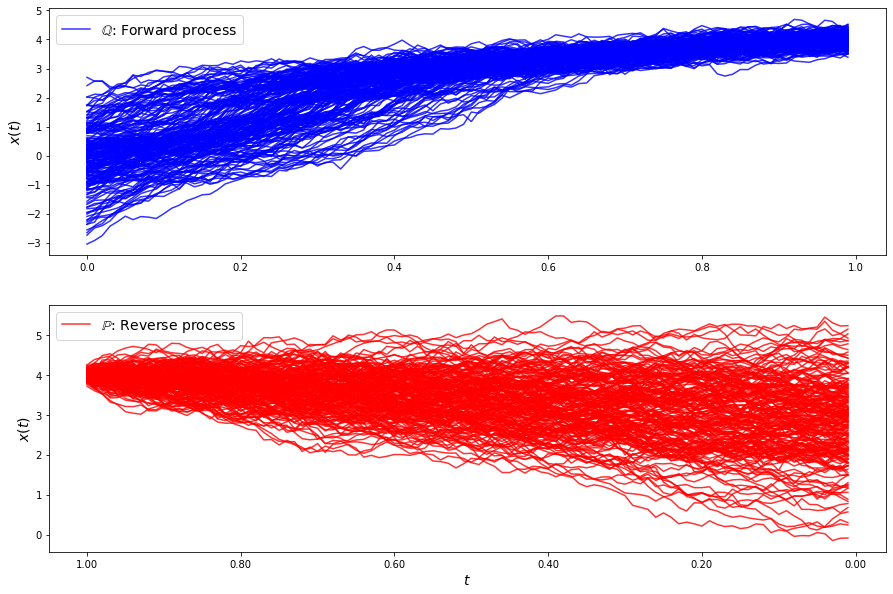

loss b 12.211570176601116
loss b 12.11379437084503
loss b 14.54296920007845
loss b 13.136057114906373
loss b 12.90630406026235
loss b 13.016352188528087
loss b 12.41962037004338
loss b 11.532851028465567
loss b 12.80094654105052
loss b 12.451573302324324
loss b 11.471589281839393
loss b 12.984752616151548
loss b 12.95975663657508
loss b 13.530155555598508
loss b 11.164494738737105
loss b 11.799896529055658
loss b 11.183160005678184
loss b 11.137984860164782
loss b 11.209503166951643
loss b 13.17872427320814
loss b 11.900721790447255
loss b 11.785622744104195
loss b 11.31371943114235
loss b 10.695252912629046
loss b 10.848597006152929
loss b 11.453580232416746
loss b 11.766248229178938
loss b 11.788972693841234
loss b 11.728322858351726
loss b 11.925588566145883
loss f 6.523265605221754
loss f 7.4095058636078415
loss f 7.8732540448454635
loss f 7.347265683143013
loss f 7.142631490354459
loss f 7.139747267149763
loss f 7.624591573430461
loss f 7.732527288589749
loss f 7.632922800365373
l

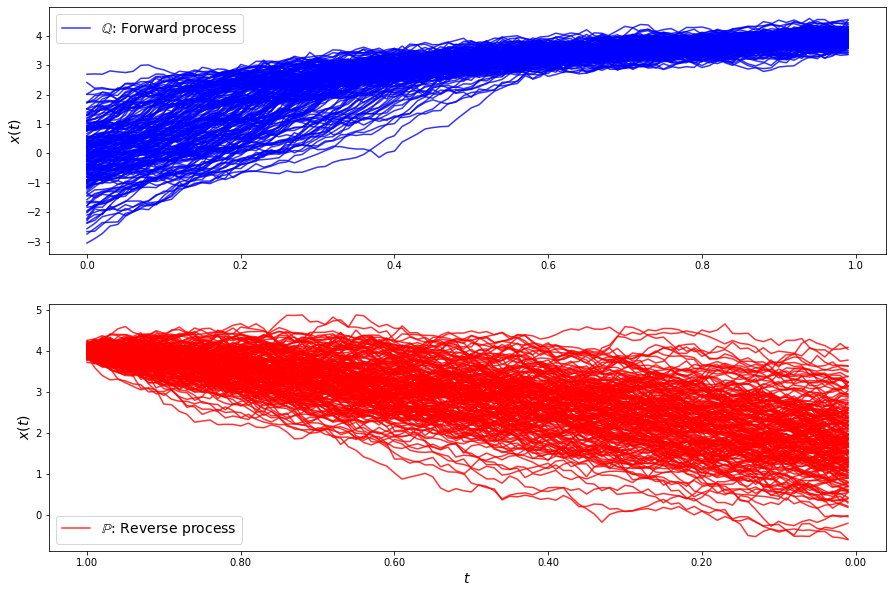

loss b 12.01727558887608
loss b 13.607187889118803
loss b 13.66081928963826
loss b 14.644715423920939
loss b 13.693314174641971
loss b 13.712372555916671
loss b 14.885718616286669
loss b 14.22241101602183
loss b 12.951894212627426
loss b 12.16486543758152
loss b 14.209843414597621
loss b 14.041245826995308
loss b 13.439017868409397
loss b 15.98925555123375
loss b 15.908119289299872
loss b 15.335006310284058
loss b 14.353660979444752
loss b 14.514303790560414
loss b 13.687706377569253
loss b 15.01045417617834
loss b 15.6894523917212
loss b 15.733072751550893
loss b 14.471534067972666
loss b 15.40005273964067
loss b 14.353797688513678
loss b 14.780666500379288
loss b 16.880308324234175
loss b 16.214737035417844
loss b 16.760036951400618
loss b 15.04613199055683
loss f 6.663070353513844
loss f 6.7727132272963955
loss f 7.3261756935247035
loss f 6.558840458529182
loss f 6.438753108003878
loss f 6.967478902978599
loss f 6.805619103984879
loss f 6.825590449312855
loss f 8.018385678841561
los

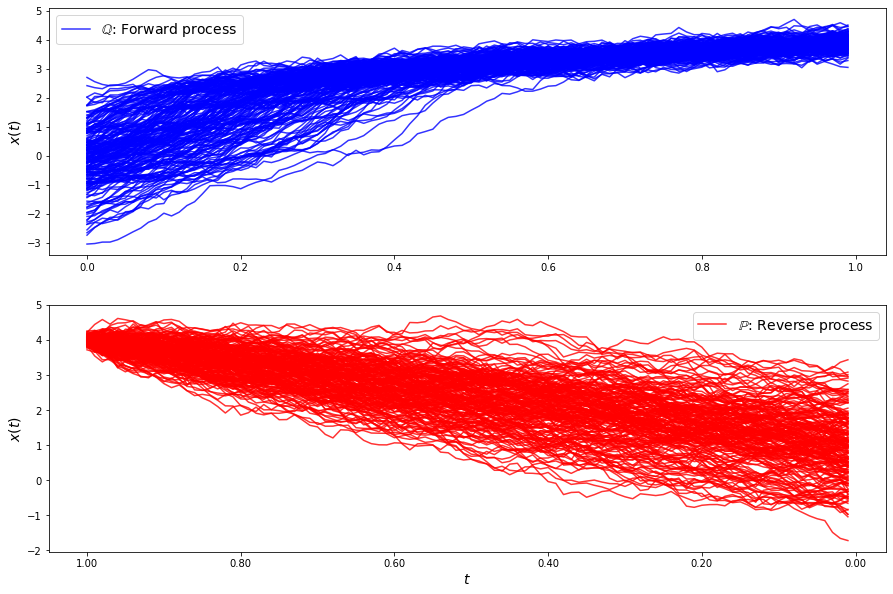

loss b 22.09086144233354
loss b 20.24609474386196
loss b 19.536711718376612
loss b 21.093881206658647
loss b 21.21150607490103
loss b 21.460423152810325
loss b 21.51741179783331
loss b 20.199955507489047
loss b 21.651525723014213
loss b 21.664851537050488
loss b 23.205687870808813
loss b 21.359694859954104
loss b 22.71403276262602
loss b 20.624316495739542
loss b 21.763383123149318
loss b 21.44452348848094
loss b 20.623306350686082
loss b 21.18349794769771
loss b 21.926670679205746
loss b 21.6904130126711
loss b 22.893701200126078
loss b 21.090193468168263
loss b 21.90059032900208
loss b 21.41769161847083
loss b 22.682541963070104
loss b 23.76177463073164
loss b 23.893942842065023
loss b 24.397998782260572
loss b 21.810658031485005
loss b 20.93207472116709
loss f 7.80223290200598
loss f 8.131732731913758
loss f 7.909112906292575
loss f 7.876810356991341
loss f 7.8528499555531734
loss f 7.809569686182625
loss f 8.268284037859713
loss f 8.378604142121514
loss f 8.045612279273152
loss f 8

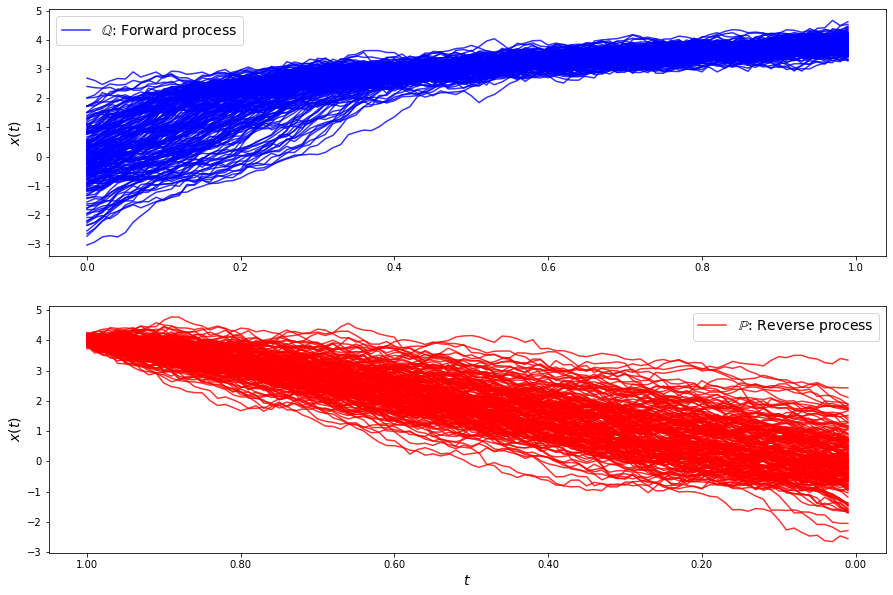

loss b 28.45282388240924
loss b 28.27137829597651
loss b 27.73864934693151
loss b 28.14313545217017
loss b 29.959099397571094
loss b 30.003269563441588
loss b 29.054576578466346
loss b 31.139659525419862
loss b 32.51920719392541
loss b 30.356333770895038
loss b 28.210910207689682
loss b 28.773414213398276
loss b 32.004303421587366
loss b 28.636754055971824
loss b 30.238042838237227
loss b 32.037542939702604
loss b 31.13185527899086
loss b 31.265096735370317
loss b 32.06703807899509
loss b 30.921715919621004
loss b 31.26169756368952
loss b 30.871234275657432
loss b 30.631626171601862
loss b 31.006870526342816
loss b 32.0920032921978
loss b 29.47111875844909
loss b 30.726041560958876
loss b 30.984212509701663
loss b 31.292277011050693
loss b 31.223422032381553
loss f 9.88821925950914
loss f 9.895296534833347
loss f 10.435216427633636
loss f 10.054360289436572
loss f 9.432211921056346
loss f 10.603080519649595
loss f 10.6294510995192
loss f 9.984737751740482
loss f 9.717216785846297
loss 

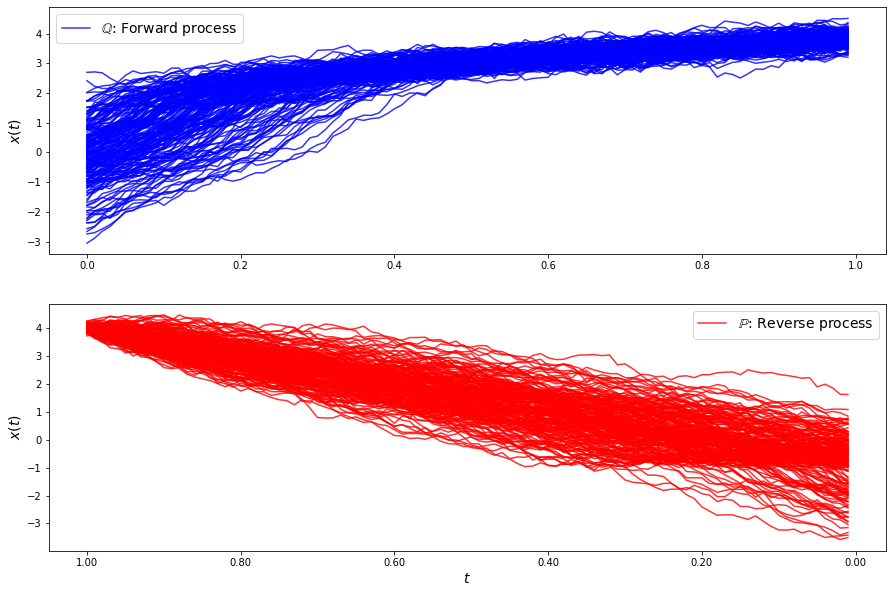

loss b 38.683290572687866
loss b 36.01691653550714
loss b 35.78613944682813
loss b 38.7310562144902
loss b 38.25834173408208
loss b 36.99886639933362
loss b 38.608689595461115
loss b 35.15938854178522
loss b 36.28387781494309
loss b 36.7376860049872
loss b 37.613853296965324
loss b 38.12132704560668
loss b 37.473893793250284
loss b 37.18902055915735
loss b 37.527140733868244
loss b 39.23064302106664
loss b 38.86692461042232
loss b 37.42348561983626
loss b 39.350827087173975
loss b 40.615044983891366
loss b 37.77503978833699
loss b 36.874453119118435
loss b 38.42651905405252
loss b 38.915075286541516
loss b 37.009582443258864
loss b 36.943180348221865
loss b 38.8228820427866
loss b 39.56164953200574
loss b 36.109334077267334
loss b 38.16849377548002
loss f 12.1965099239524
loss f 12.310207524466673
loss f 12.347087560479599
loss f 12.829807751859164
loss f 12.265255198465985
loss f 11.691251642609299
loss f 12.597636824582866
loss f 12.88804352559851
loss f 12.15970709195202
loss f 12.7

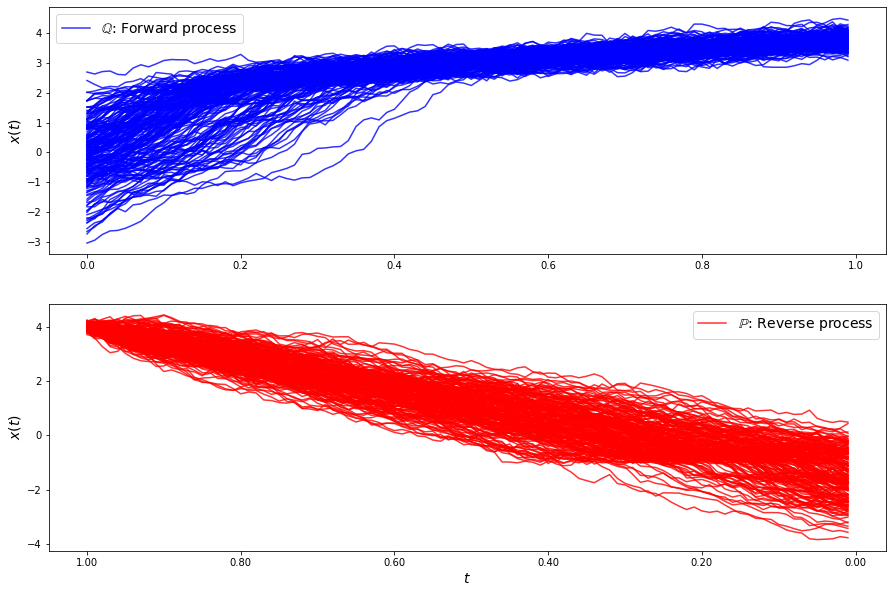

loss b 43.69676474938291
loss b 41.89193149888493
loss b 43.45560529962703
loss b 42.548182444075934
loss b 42.732458143896864
loss b 42.60062005350979
loss b 42.42206883281612
loss b 44.72152095286432
loss b 44.910077980850154
loss b 43.06944425395339
loss b 44.47334869447682
loss b 44.04971326834428
loss b 42.26012144131267
loss b 44.5846222648108
loss b 43.967241998307415
loss b 44.65838566058171
loss b 44.68879089588051
loss b 43.42915152724247
loss b 44.85928105708067
loss b 44.524720783115214
loss b 44.70564050225733
loss b 43.062488994463955
loss b 42.30020248921506
loss b 44.14193035170124
loss b 43.70443464912389
loss b 44.2235381778288
loss b 42.02730843902797
loss b 43.81485051155173
loss b 45.86872376833775
loss b 44.925389171724646
loss f 14.35905343118557
loss f 15.139587473677834
loss f 14.214446862228302
loss f 14.654231720196929
loss f 14.58169527529218
loss f 15.68645883889419
loss f 14.897659987282063
loss f 15.207099601377966
loss f 14.97977337413538
loss f 15.35584

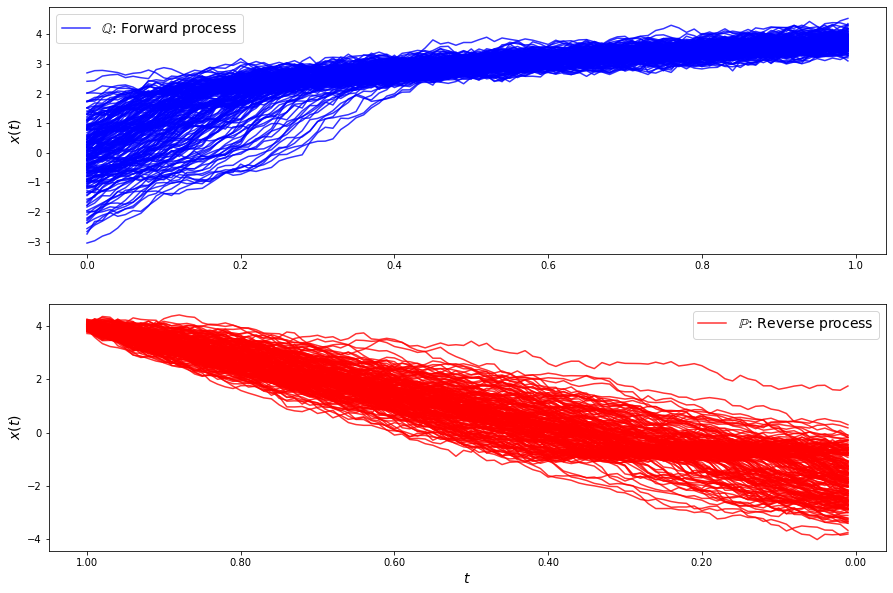

loss b 46.87671054065463
loss b 50.29298361786089
loss b 47.4380204612962
loss b 47.61356310143866
loss b 48.4089154353807
loss b 47.97253359350277
loss b 47.13114738601216
loss b 45.62992074809227
loss b 48.56063779290449
loss b 48.009243965703476
loss b 47.619339341920714
loss b 48.15517682091547
loss b 48.469372620220305
loss b 49.79808589229799
loss b 48.33922949596159
loss b 48.20254520780756
loss b 47.046191830272974
loss b 47.06602998934343
loss b 48.25998119486863
loss b 47.979016735182554
loss b 47.02765929639618
loss b 49.113016159055775
loss b 48.03919032317818
loss b 47.376524043949104
loss b 48.14446214813915
loss b 45.845228827076035
loss b 48.44910047405497
loss b 49.67533428366487
loss b 49.29952685294143
loss b 47.55189713310031
loss f 17.46235950053546
loss f 17.879481172613332
loss f 18.209151543873954
loss f 17.52308479411671
loss f 17.63090601174702
loss f 17.508146693332936
loss f 18.21164608726997
loss f 17.561362722467326
loss f 17.58639118521716
loss f 17.64048

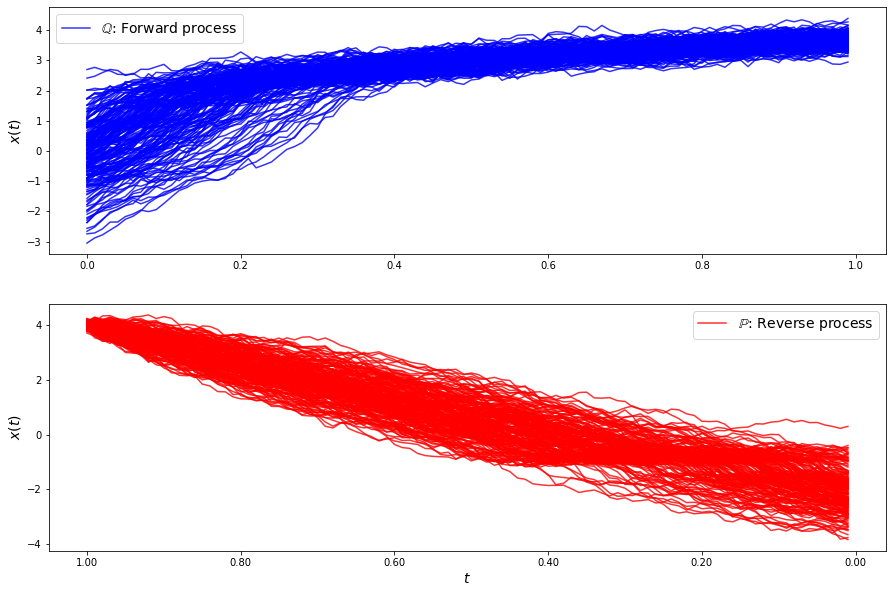

loss b 50.03925771240816
loss b 51.98552711429238
loss b 51.353954307958276
loss b 51.53820973721668
loss b 49.94784804217168
loss b 51.84336910016794
loss b 51.63283877816027
loss b 51.25487556768544
loss b 51.434570326390556
loss b 51.308017630017765
loss b 52.072054881102275
loss b 51.50646674099628
loss b 50.36084171149211
loss b 52.05040647222074
loss b 50.195436859226334
loss b 50.83414674738756
loss b 49.576615722133916
loss b 51.99999041020505
loss b 48.73796832303043
loss b 49.84703769389516
loss b 50.97123619463314
loss b 49.00383221044663
loss b 50.69108789575608
loss b 49.80088995073469
loss b 50.869885501767975
loss b 51.013488741872564
loss b 52.29846669154627
loss b 52.08944499678614
loss b 51.01042479583274
loss b 51.327815108460214
loss f 19.84006367986176
loss f 19.42521591952377
loss f 20.07469176781068
loss f 20.405216496765014
loss f 19.271599594045274
loss f 19.93345398072381
loss f 19.806617702335128
loss f 19.670710408315262
loss f 18.686137560540395
loss f 19.5

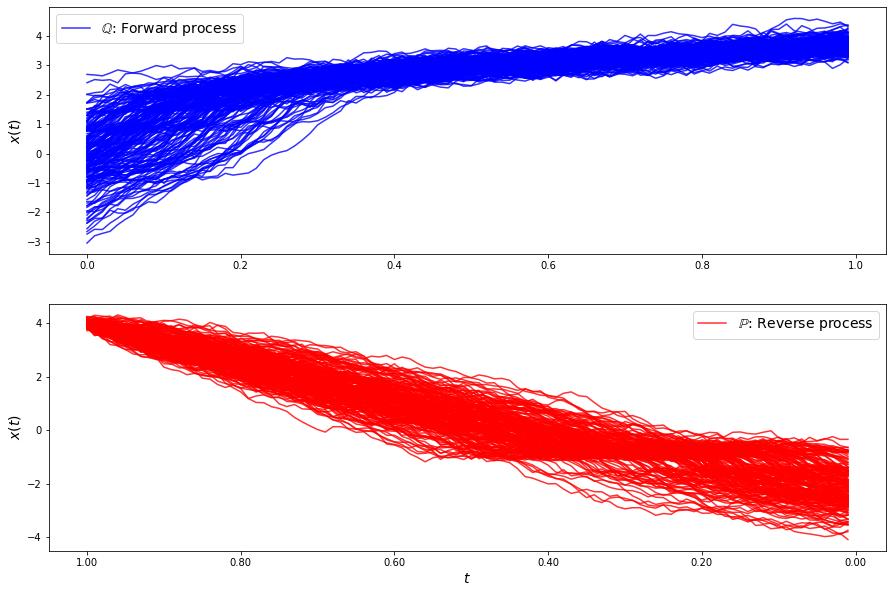

loss b 52.519853905943876
loss b 52.4539240688205
loss b 50.90586526057804
loss b 50.82126405966965
loss b 52.90257049992915
loss b 51.34609591420126
loss b 51.19488922723527
loss b 52.535661679964186
loss b 52.15464839025997
loss b 52.47366105566708
loss b 51.852374143685175
loss b 51.96820626434433
loss b 52.74014003077205
loss b 52.1563289107103
loss b 51.94909686846213
loss b 52.44628496481666
loss b 52.70111620219281
loss b 51.235651890771905
loss b 52.01838691276865
loss b 51.993619035592786
loss b 50.783518422797535
loss b 52.09698573487217
loss b 51.214187563780726
loss b 52.99010507003304
loss b 52.15376469972993
loss b 51.74605754355942
loss b 52.41061199989103
loss b 53.59593304770062
loss b 51.5517038775217
loss b 54.06750572745253
loss f 21.626657266113806
loss f 21.873474481545117
loss f 20.942278762762907
loss f 21.6153260798656
loss f 21.419590146804875
loss f 22.009111648374255
loss f 22.16094265716427
loss f 22.259891197850685
loss f 21.785675513186394
loss f 21.71285

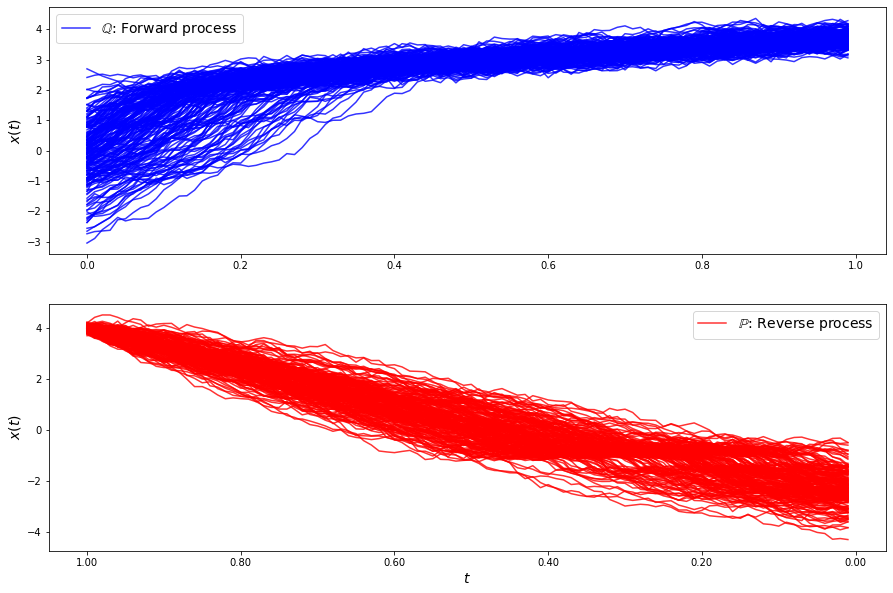

loss b 53.90816882118103
loss b 52.69622657400153
loss b 52.76765195577372
loss b 54.178689783835445
loss b 51.989854900817285
loss b 51.04227968224045
loss b 53.320204816819064
loss b 52.76506772785461
loss b 52.22376907927448
loss b 53.01717709549625
loss b 52.10076432164957
loss b 52.5580578738554
loss b 50.559904947815866
loss b 52.700638416264326
loss b 53.69498621248048
loss b 53.585932617795315
loss b 52.83565857948278
loss b 52.17212681246863
loss b 53.41444734593981
loss b 52.10914846667802
loss b 53.28451515388143
loss b 53.1763962090187
loss b 53.863047493080956
loss b 53.85352049068065
loss b 51.62891659450046
loss b 52.79797761937022
loss b 51.932127273901706
loss b 53.16607885466654
loss b 51.5952039642157
loss b 52.034048168113316
loss f 22.82231250300509
loss f 22.664620099844367
loss f 24.149122810904288
loss f 23.091616622655618
loss f 22.498834069252162
loss f 22.933597265505355
loss f 23.69137323654504
loss f 22.702396939015074
loss f 23.29535963495779
loss f 23.211

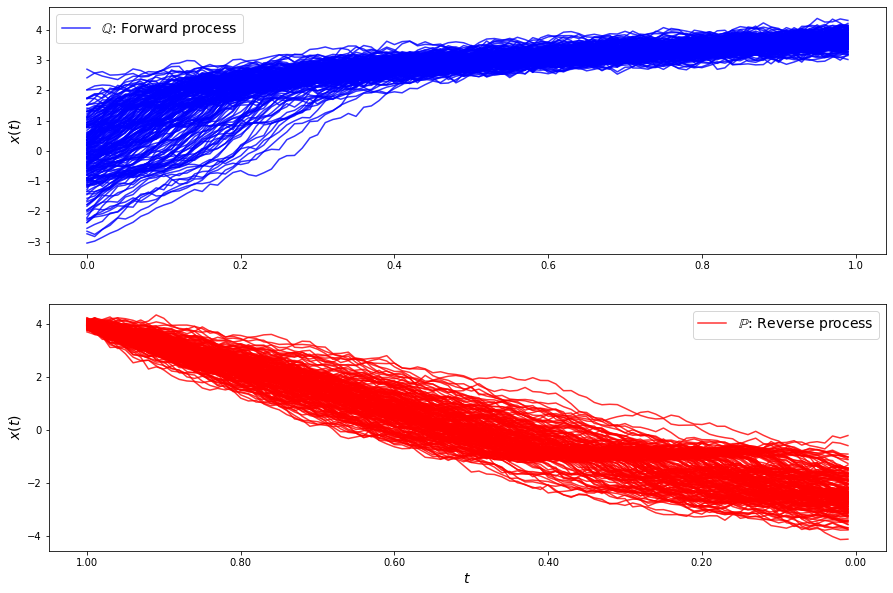

loss b 52.942898445326755
loss b 51.72097953210514
loss b 52.40013436771668
loss b 51.55495359651613
loss b 54.36712197028554
loss b 52.024575218662896
loss b 50.579574461574374
loss b 51.18700620889901
loss b 52.86705971701442
loss b 52.48460516050053
loss b 50.4731567174781
loss b 52.66001839395711
loss b 51.600231431024554
loss b 51.33061598154987
loss b 53.066511583311026
loss b 51.89269312897379
loss b 52.58162467819446
loss b 52.245756838655424
loss b 53.360619509757164
loss b 52.334085335830714
loss b 50.679911045879216
loss b 52.421275355121075
loss b 51.122371762067864
loss b 51.75720694062442
loss b 51.721757627484045
loss b 52.050469929702935
loss b 50.421841588289205
loss b 52.55187093091697
loss b 51.3343445459277
loss b 54.35488250001942
loss f 24.437646132638616
loss f 23.742346624656143
loss f 23.497919189344817
loss f 23.71054694726256
loss f 23.699520318089103
loss f 24.024002986821934
loss f 23.622284795900782
loss f 24.075018901335174
loss f 23.833108782608345
loss 

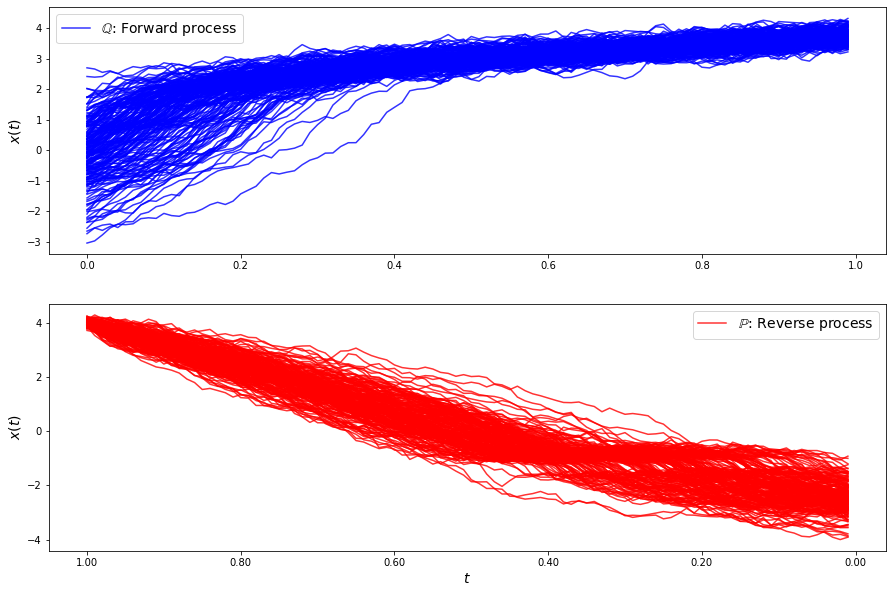

loss b 48.873360119208044
loss b 50.33619001390084
loss b 49.565059389010955
loss b 51.33119601797794
loss b 48.99134002485195
loss b 49.78077821503252
loss b 50.88664319838693
loss b 49.711721635696826
loss b 50.06348760784544
loss b 48.255563724657584
loss b 49.54119833410121
loss b 49.57071075412057
loss b 48.81523979391981
loss b 49.01228393895581
loss b 49.71813178703424
loss b 49.177441862733524
loss b 49.03851145028689
loss b 49.95769274718666
loss b 49.75625755002919
loss b 50.334610535390006
loss b 48.33725888179678
loss b 49.44585025478586
loss b 50.64209100588582
loss b 49.78116073976646
loss b 49.84066053265147
loss b 50.04688953777062
loss b 49.68582749829536
loss b 49.06430899613268
loss b 50.54771520990628
loss b 49.70671441230716
loss f 22.312296083389242
loss f 22.891811204056044
loss f 23.827449572911696
loss f 23.089420744160556
loss f 22.97940551874505
loss f 22.92324972573585
loss f 23.390538606983792
loss f 24.475360718615104
loss f 22.990231896426632
loss f 23.66

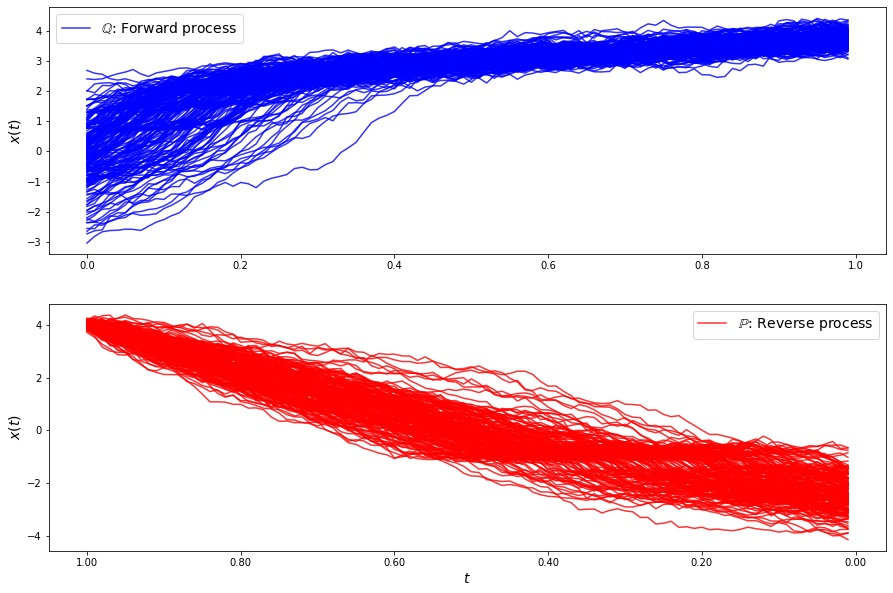

loss b 46.17172628750535
loss b 46.67698375024944
loss b 45.45835766379461
loss b 47.6280499853016
loss b 47.64857439788996
loss b 45.47731924149749
loss b 48.9188601450577
loss b 47.41951018210996
loss b 47.655512755516604
loss b 46.06358208673857
loss b 46.82974278066187
loss b 46.76281114327673
loss b 47.15754683495401
loss b 46.21518210233675
loss b 46.91221838763729
loss b 47.465236890968285
loss b 46.8832816572777
loss b 47.32227358585063
loss b 46.964032224946415
loss b 47.04992825234443
loss b 48.08511801456286
loss b 47.23441518833674
loss b 46.84683508769102
loss b 47.182748044579036
loss b 46.51960519478056
loss b 47.98855148172038
loss b 46.85421064661656
loss b 45.741504474816395
loss b 47.60078576212576
loss b 46.80470287941016
loss f 20.46707172574514
loss f 20.93975632207899
loss f 21.14193886265747
loss f 21.781584511238705
loss f 21.16270679664616
loss f 20.849219067511537
loss f 20.484724357769114
loss f 21.503565594341843
loss f 20.482426044298816
loss f 20.51372925

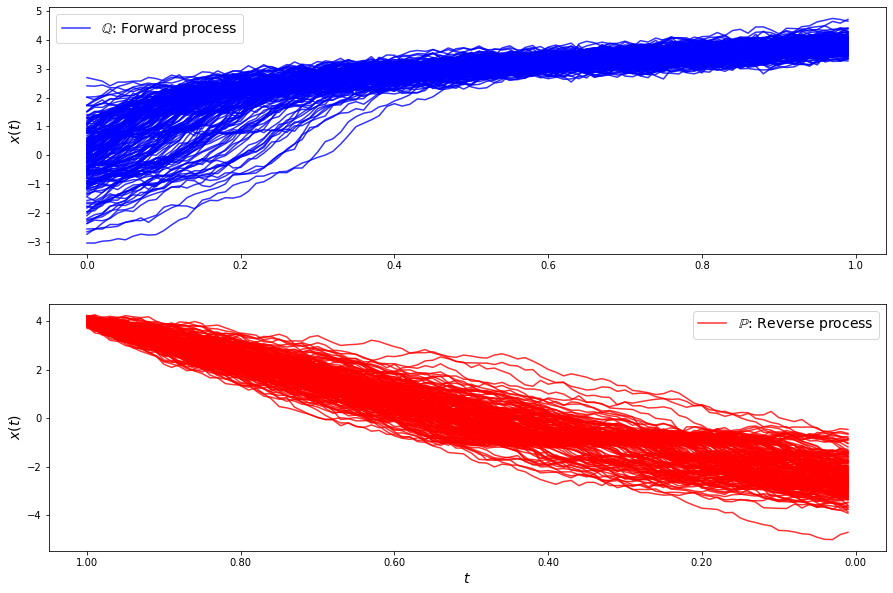

loss b 45.28123769703855
loss b 43.84486928101816
loss b 43.827107631925074
loss b 46.180847025618974
loss b 44.254974770008744
loss b 45.3812236448237
loss b 45.684290095610706
loss b 44.729809181332755
loss b 44.50593751739528
loss b 44.8223001466566
loss b 45.078378762665
loss b 44.21697553727557
loss b 45.95105377773349
loss b 45.34127469268824
loss b 44.79515356732326
loss b 44.45898267898669
loss b 45.600976943781376
loss b 45.262701337012786
loss b 45.87111644423646
loss b 44.78371827639591
loss b 44.39212568688846
loss b 44.68107866968629
loss b 44.629162104998
loss b 46.284046228306174
loss b 45.2216361723524
loss b 45.23313331177112
loss b 45.80234596392866
loss b 44.4214168823506
loss b 45.05515777660597
loss b 44.8546968203354
loss f 18.741567910427932
loss f 18.774220822038792
loss f 18.435363925582234
loss f 18.97427829788363
loss f 18.64760778815063
loss f 18.641446310940115
loss f 18.381135297018343
loss f 18.847578968817956
loss f 17.41471790752531
loss f 17.6453749088

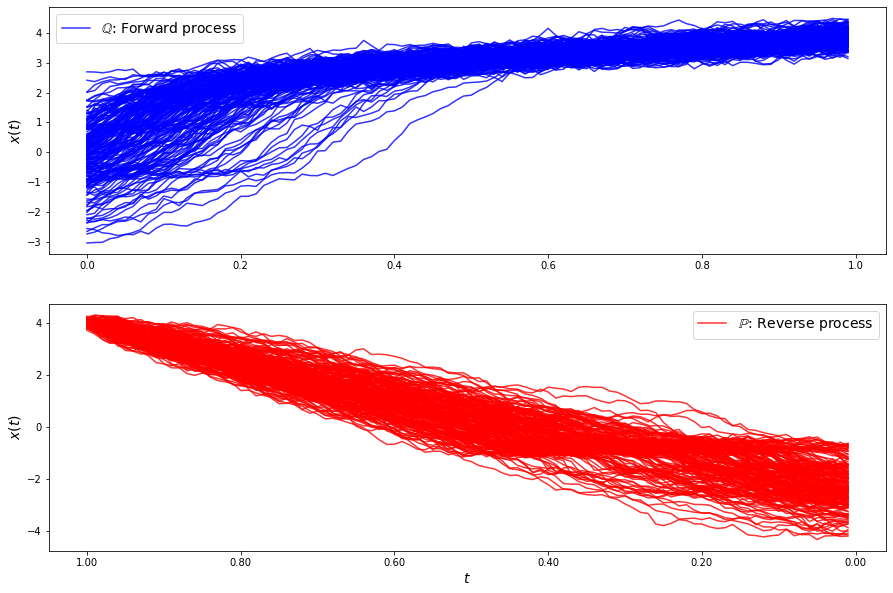

loss b 42.56871926351928
loss b 43.32655513147802
loss b 41.99293132451337
loss b 41.624838609766044
loss b 41.298289002468124
loss b 42.055133658764476
loss b 42.74238808237804
loss b 42.5966969228285
loss b 43.90461896317412
loss b 43.00365953551684
loss b 42.595475401099186
loss b 43.08716319208417
loss b 43.54071416335717
loss b 43.66845788151091
loss b 43.331172549720634
loss b 43.57470853624881
loss b 43.54273648480554
loss b 43.959108849570754
loss b 43.19327730806832
loss b 43.820796750241854
loss b 44.02380852777102
loss b 43.37305816213328
loss b 44.30362224999833
loss b 42.04196350204179
loss b 44.156355378988636
loss b 43.73271211168964
loss b 42.800441040514634
loss b 42.43166502029481
loss b 44.88381694360506
loss b 43.02557333460773
loss f 14.837236110861452
loss f 15.15406908280001
loss f 15.499149505513186
loss f 16.170014779045616
loss f 15.11175740555755
loss f 15.194104639291302
loss f 15.157824427413873
loss f 15.194745365312974
loss f 14.476338601559915
loss f 14.

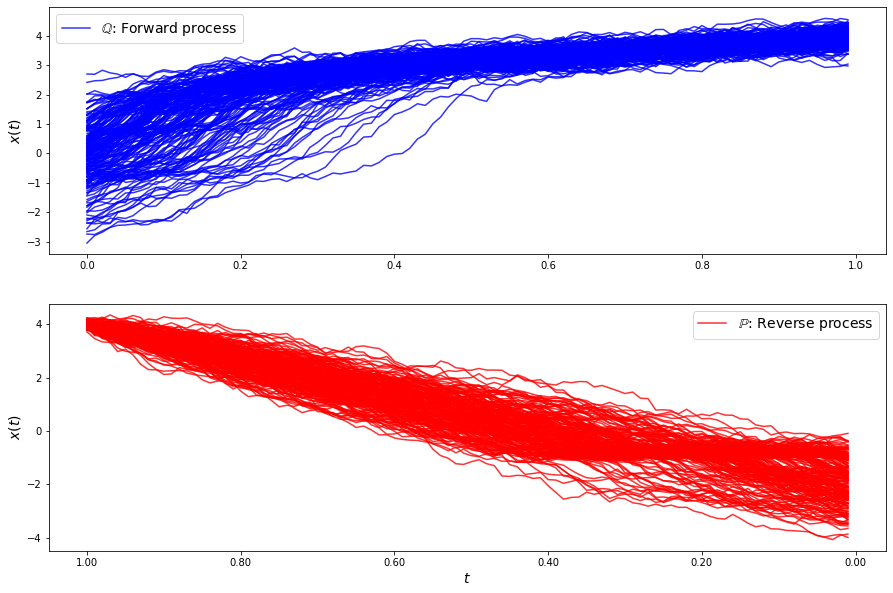

loss b 40.020990641156914
loss b 41.30953003780988
loss b 42.57773322749106
loss b 42.09307720507285
loss b 40.35576177626174
loss b 40.63594935997058
loss b 40.80402604445675
loss b 41.403704215102465
loss b 41.117974432493135
loss b 42.05627635401502
loss b 40.50892717863273
loss b 40.5473602682591
loss b 41.251148743217435
loss b 42.04792040859817
loss b 41.89048714694508
loss b 41.484720931551564
loss b 43.65863792699237
loss b 42.26377654092089
loss b 42.16562495759487
loss b 43.09639000680647
loss b 42.22961979162365
loss b 42.36250004066949
loss b 42.58680928902432
loss b 43.682752308972546
loss b 41.53907303624137
loss b 42.74869061990077
loss b 41.65583204816266
loss b 43.05133945362401
loss b 42.197097575720406
loss b 44.07178623568635
loss f 12.556120341942881
loss f 12.228574637504714
loss f 13.034626136014552
loss f 13.199169524861976
loss f 12.075383985288296
loss f 12.727561807789764
loss f 12.702647648152178
loss f 12.9175461316174
loss f 12.744922640569916
loss f 12.66

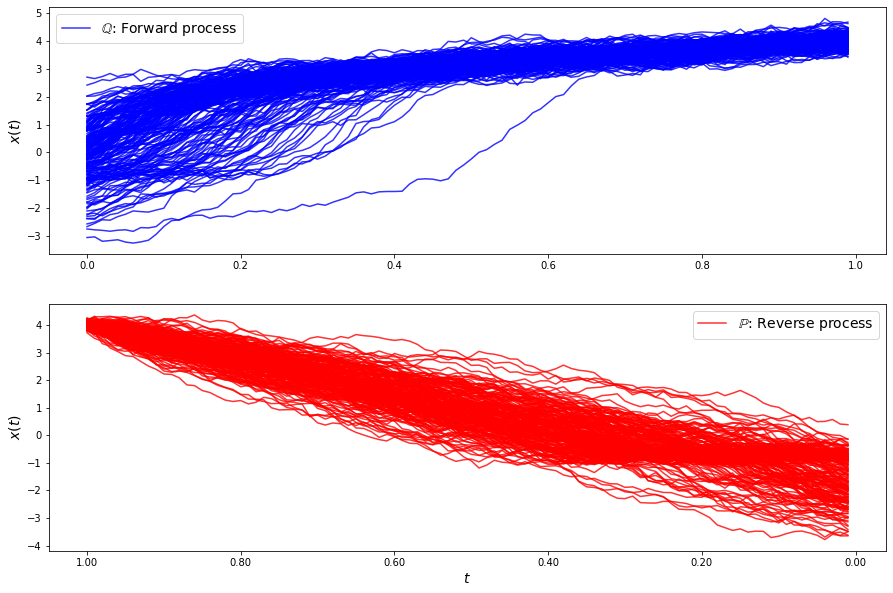

loss b 40.83156351541065
loss b 39.99051686516044
loss b 41.023168444416086
loss b 40.03637474273077
loss b 38.45631668187088
loss b 38.62315111728965
loss b 40.03100121157847
loss b 39.324367576788056
loss b 39.35622465099942
loss b 40.57587974653317
loss b 39.0388590126313
loss b 40.02785194054938
loss b 39.63844285308252
loss b 42.733166152703895
loss b 39.75456663088425
loss b 40.96146535658898
loss b 40.86281040590113
loss b 41.06830581095911
loss b 40.38698338308167
loss b 40.97529620038125
loss b 42.99170616047244
loss b 40.17651500709184
loss b 40.32260240867597
loss b 40.75048129097126
loss b 39.27203792879807
loss b 40.49557818244903
loss b 40.18343254034654
loss b 40.32437468801861
loss b 39.24879428679507
loss b 40.86385920200603
loss f 11.483123294201283
loss f 11.040093176716354
loss f 11.380667423047358
loss f 10.730430995967708
loss f 10.650655375563119
loss f 10.746010977071762
loss f 10.679417889491083
loss f 10.33404347902902
loss f 11.157983164611412
loss f 10.63774

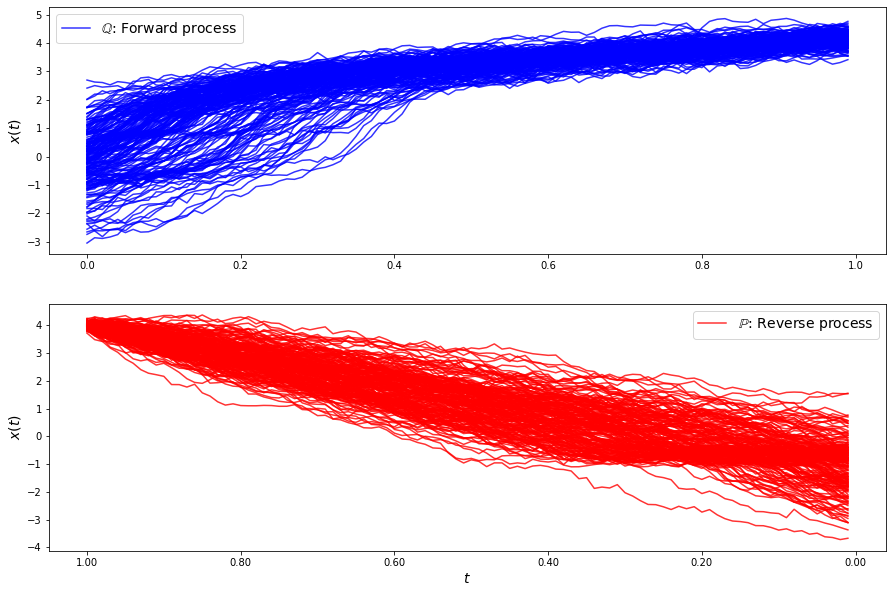

loss b 37.302349395387154
loss b 37.89938809130617
loss b 37.68988099837341
loss b 38.68008332935395
loss b 37.83936780131982
loss b 38.31041221417791
loss b 39.33741969682849
loss b 36.650559029822524
loss b 38.16937678956699
loss b 37.10032686186393
loss b 38.99446408715681
loss b 38.043162155581044
loss b 38.748390299672465
loss b 38.20667926054679
loss b 38.946222155649636
loss b 38.31927133878931
loss b 38.06428101131224
loss b 39.00745982198892
loss b 38.45841053891316
loss b 38.14886070908612
loss b 38.146360686309315
loss b 38.80446872128283
loss b 38.47181851645368
loss b 39.838803276061526
loss b 38.662323231355884
loss b 41.987046134941586
loss b 39.63072536962945
loss b 38.7618996141438
loss b 40.237231666970246
loss b 38.311424658936524
loss f 10.96393384841616
loss f 10.819941161787515
loss f 11.163846531289053
loss f 10.261208418149787
loss f 10.205767933429645
loss f 10.744814920272782
loss f 10.664592768632431
loss f 10.132406148847728
loss f 10.469661676021989
loss f 

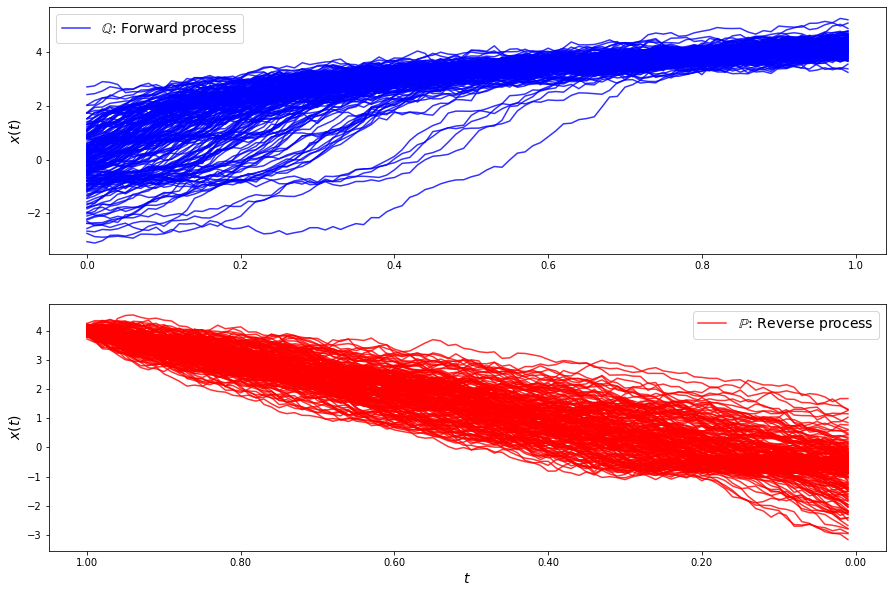

loss b 36.44283714717782
loss b 37.367658855629095
loss b 33.98560805859617
loss b 36.22758300908403
loss b 35.62623176615829
loss b 34.75878898855259
loss b 35.44334221729937
loss b 34.96986627066093
loss b 37.87770834753474
loss b 35.47903139948717
loss b 37.720895247265
loss b 37.06272982975565
loss b 36.45526852119989
loss b 35.23366888822715
loss b 34.86857498150617
loss b 36.54213977996383
loss b 36.07370577342529
loss b 35.64600793428954
loss b 36.95578318286237
loss b 37.04909056867891
loss b 36.39988880513264
loss b 35.77656751552692
loss b 36.32775106153287
loss b 37.74346415453719
loss b 36.57266963250872
loss b 36.27942095969316
loss b 36.283647308347184
loss b 34.8155986675052
loss b 35.615358013421165
loss b 36.357225770276926
loss f 10.638452603762124
loss f 10.901926072591626
loss f 10.759038849579019
loss f 11.00456785546887
loss f 11.100821975094561
loss f 10.767131786201588
loss f 10.399574817202087
loss f 10.463560718217616
loss f 10.433196249625942
loss f 10.160297

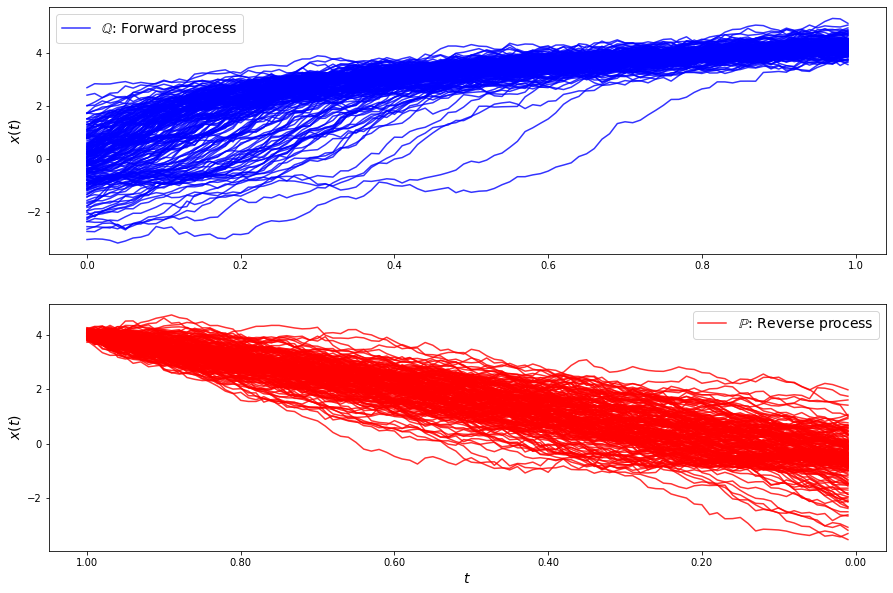

loss b 31.127610083357876
loss b 30.925007283861337
loss b 35.10263296866007
loss b 32.98053986851688
loss b 30.75834824830565
loss b 33.26719711684418
loss b 33.434455895739895
loss b 32.25677391841959
loss b 32.53173564628648
loss b 36.008086560339784
loss b 31.869636600104062
loss b 32.52707395649444
loss b 32.14985450326071
loss b 33.39989869123953
loss b 31.468643614144828
loss b 33.31211864329237
loss b 32.777138540992624
loss b 33.15767016075509
loss b 30.444129637656822
loss b 32.071027016553586
loss b 32.08454609950466
loss b 33.84296571634519
loss b 32.760495269564714
loss b 33.50284694530548
loss b 32.65382017373591
loss b 30.801125320647948
loss b 31.754910242080257
loss b 33.67369345096589
loss b 32.91041224520671
loss b 31.391353004875114
loss f 10.917136374324368
loss f 12.825482574475949
loss f 11.089775832377148
loss f 12.137231347551715
loss f 11.27517295227208
loss f 11.361313700913009
loss f 11.576541465345791
loss f 11.581846285114898
loss f 12.597937568556517
loss

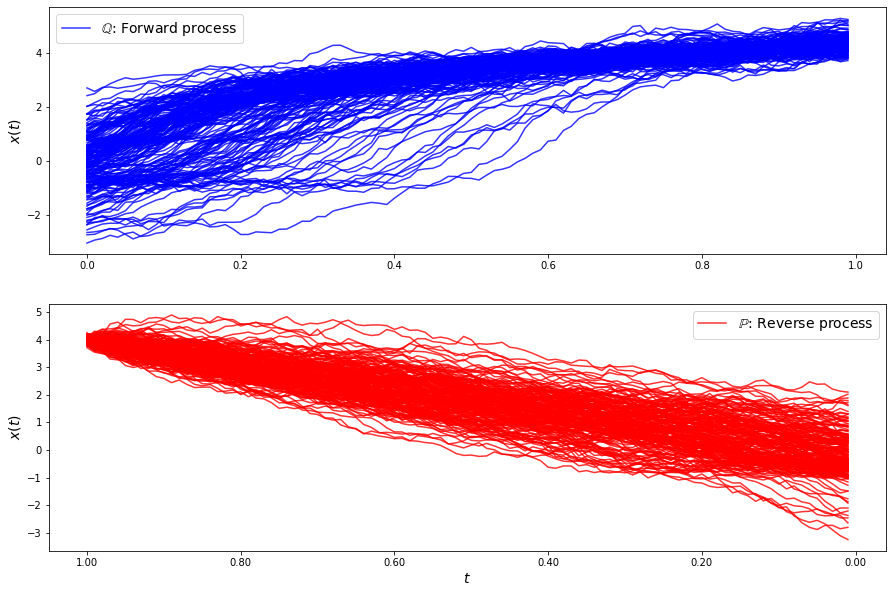

loss b 29.355052790794282
loss b 29.037280615227537
loss b 29.97905330345364
loss b 29.830014905050344
loss b 28.68516562695537
loss b 30.882919609447853
loss b 30.26956728316922
loss b 30.452620927386892
loss b 30.293062737863465
loss b 26.814440662596663
loss b 29.422688367670727
loss b 27.278600873752392
loss b 27.24642216190889
loss b 30.147652975090093
loss b 28.817802190071422
loss b 28.17415463663524
loss b 29.677879108295006
loss b 29.554918124617725
loss b 30.36923857090191
loss b 29.14539747115959
loss b 29.555273010101942
loss b 30.603769726041598
loss b 28.834275984005824
loss b 30.208973485617754
loss b 25.506508811755534
loss b 29.1084762920053
loss b 27.595385681836785
loss b 27.493777225614615
loss b 29.683198825858472
loss b 27.756442525594522
loss f 11.931942745456716
loss f 13.039111276548216
loss f 13.46768355562646
loss f 12.51705973337328
loss f 12.558206027176544
loss f 11.738513359626545
loss f 12.490584187079067
loss f 13.2749850060778
loss f 12.904658378966436

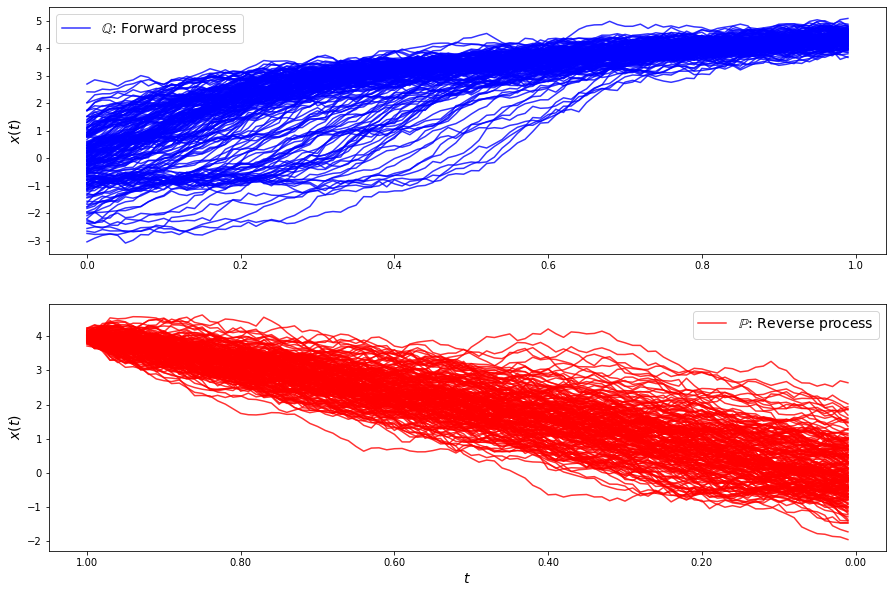

loss b 24.823297700055466
loss b 24.704334790077898
loss b 24.884217569770186
loss b 27.587629075658175
loss b 26.894748524410502
loss b 26.66506569790562
loss b 25.511633811960518
loss b 27.512655200921774
loss b 25.728160447964214
loss b 26.499588389216562
loss b 24.52634802981
loss b 25.96325824156469
loss b 26.074178978253343
loss b 25.522330813721258
loss b 26.06575922149991
loss b 23.904155178172804
loss b 25.71665111924196
loss b 25.14877262899655
loss b 24.97107994095802
loss b 25.69293546305658
loss b 25.75675816243608
loss b 26.31670803895182
loss b 25.973709553410394
loss b 25.027750149206465
loss b 25.04890832493415
loss b 26.6696203826963
loss b 26.509489631885963
loss b 26.063654374787554
loss b 24.848206451725677
loss b 24.443177601091115
loss f 12.782256359530628
loss f 13.254756290504922
loss f 14.251982997975068
loss f 13.372996356710768
loss f 12.449122399518107
loss f 14.16703091381011
loss f 13.801213056956431
loss f 14.394984025189947
loss f 13.51584978014406
loss

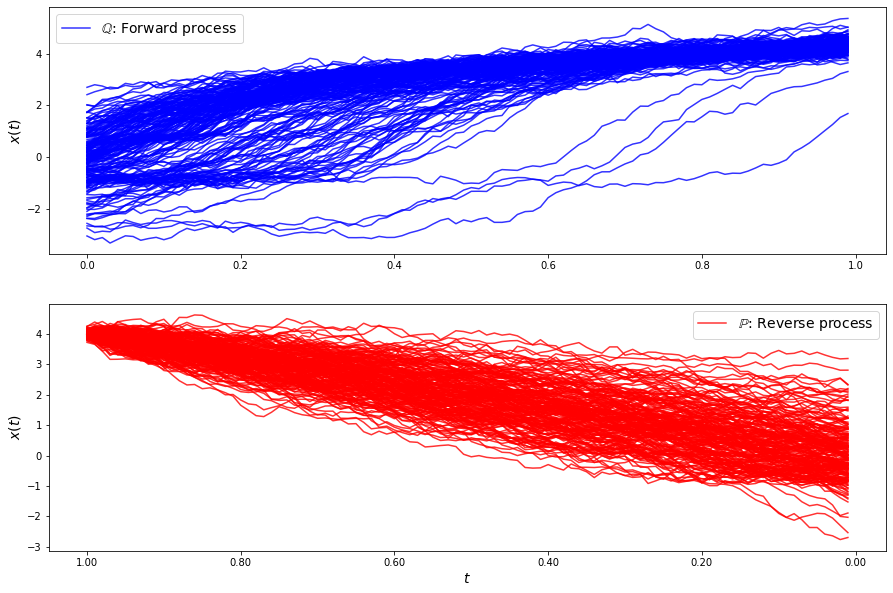

loss b 22.529107467002483
loss b 22.364640797368892
loss b 20.823278801755876
loss b 22.10362789551901
loss b 22.13970573808935
loss b 21.6003385864097
loss b 22.393237244213314
loss b 22.185129898177447
loss b 21.2746074118111
loss b 20.66040672894546
loss b 22.569300647660476
loss b 21.954321700234498
loss b 20.36004194716183
loss b 22.006917244031712
loss b 22.785086314674743
loss b 23.519002203442085
loss b 20.659801243553524
loss b 23.17775052488015
loss b 22.858580138626788
loss b 23.020121949514827
loss b 22.96635701645996
loss b 20.57197428165873
loss b 20.08893348677751
loss b 21.046367982089745
loss b 22.887965327840522
loss b 20.60915862402761
loss b 21.628913862070995
loss b 22.386890418731323
loss b 20.954570857096943
loss b 21.714191432536637
loss f 14.121743325148776
loss f 12.93095947002322
loss f 13.277607905253536
loss f 11.762287215532163
loss f 11.936860719930154
loss f 11.525748843884728
loss f 11.795271572029158
loss f 12.52623395614965
loss f 14.196493080930503
l

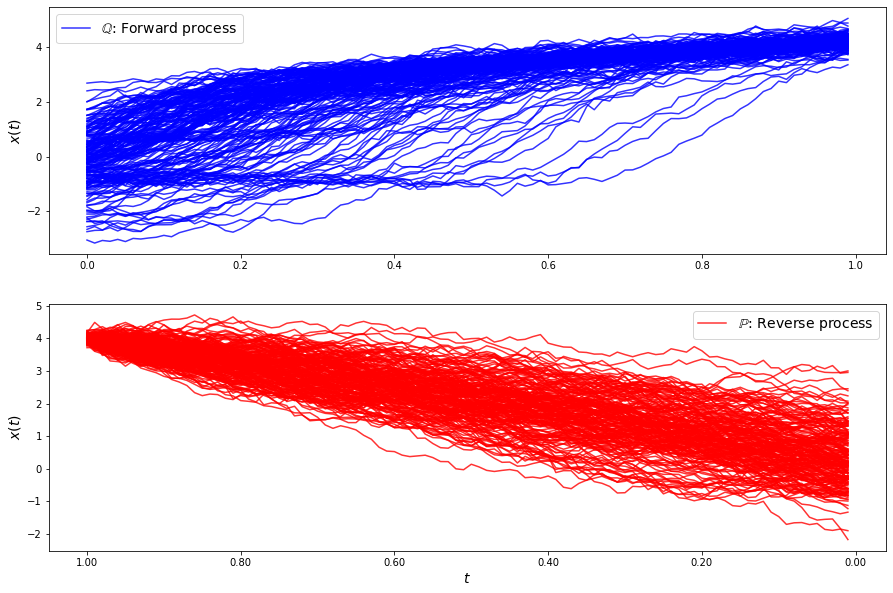

loss b 17.51528960285779
loss b 20.74784721682043
loss b 19.919843659330947
loss b 18.484191719829845
loss b 18.52532466038433
loss b 17.952545456808537
loss b 21.236849484128452
loss b 17.359490918130728
loss b 19.056810792962686
loss b 17.718474738702753
loss b 18.65104083383254
loss b 18.628945412540425
loss b 18.956674232185758
loss b 18.409511623945082
loss b 17.633738512012403
loss b 20.136232758279498
loss b 17.8154957158413
loss b 17.70789082484675
loss b 19.401147797646054
loss b 19.550016736179455
loss b 17.26054072109549
loss b 18.106800919791564
loss b 17.14233692389306
loss b 18.457553864834345
loss b 18.081880580168058
loss b 19.15785175286175
loss b 17.302102779494515
loss b 20.505359746127336
loss b 19.205602738503014
loss b 18.96837279893284
loss f 9.397154680496635
loss f 10.210014243040987
loss f 9.593608894592679
loss f 9.382426850858668
loss f 9.222058536348799
loss f 9.964519824704059
loss f 10.14688965687834
loss f 9.851277013858505
loss f 9.85935789487341
loss f

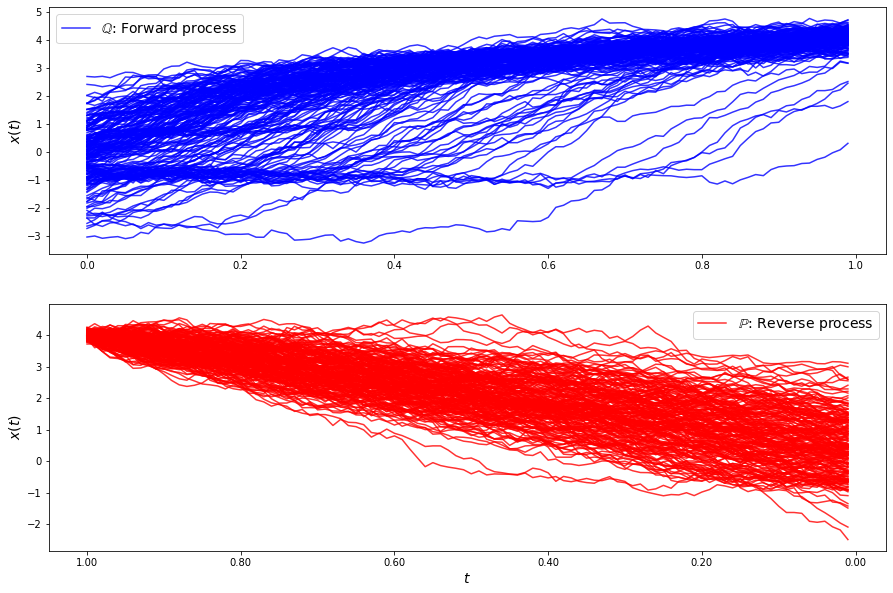

loss b 14.149192811326209
loss b 13.581133585763418
loss b 14.344266458874454
loss b 15.544903024951362
loss b 15.193833989537747
loss b 14.226280792869154
loss b 15.211309485773112
loss b 15.209150206927198
loss b 13.872651874215984
loss b 14.424721507692244
loss b 14.196691045202732
loss b 15.749154809028644
loss b 14.023957944324659
loss b 14.045322889296127
loss b 14.302226571077783
loss b 13.746438883290692
loss b 14.584971775933544
loss b 13.288438630367278
loss b 14.645391356753372
loss b 14.538350063991755
loss b 12.242725057864115
loss b 16.00589506197657
loss b 13.829965021465084
loss b 14.20720211104944
loss b 14.759518768637752
loss b 14.712806252188818
loss b 13.850411572862184
loss b 14.591014692011944
loss b 14.422908755387109
loss b 13.293197250842464
loss f 10.22643113813662
loss f 10.496695541733601
loss f 15.247330031361356
loss f 15.291796389376467
loss f 12.153995984553609
loss f 8.987223860705518
loss f 10.362836195248612
loss f 9.520587344177304
loss f 11.6713680

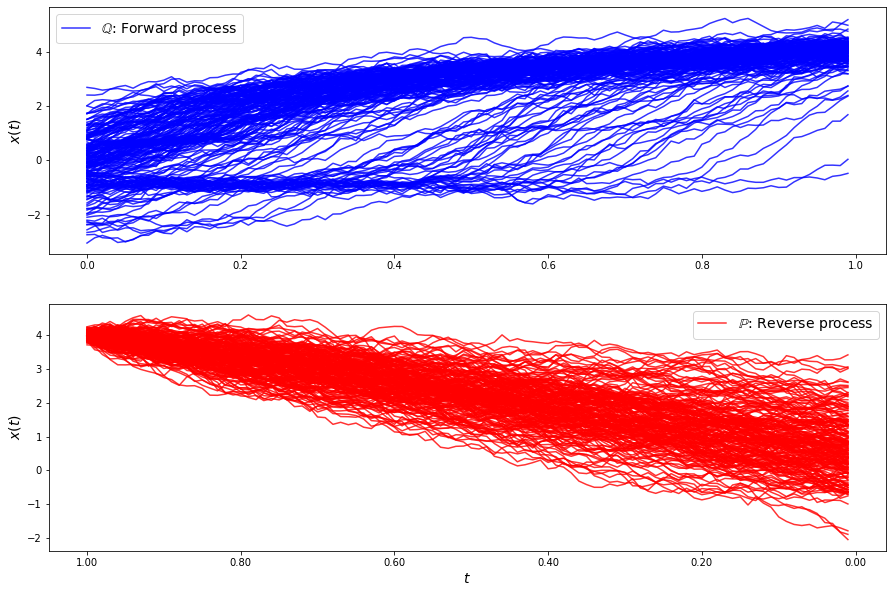

loss b 12.004038115818991
loss b 12.65217842066471
loss b 10.388058791177883
loss b 12.088364500973563
loss b 13.255852012778563
loss b 11.091893834711588
loss b 12.848748759543849
loss b 12.713798898035144
loss b 12.862044689016424
loss b 12.527246419354867
loss b 12.05327221568336
loss b 11.804100457201367
loss b 12.460225257942408
loss b 13.58883345356772
loss b 11.207180853780368
loss b 13.228344040771356
loss b 11.463261902874974
loss b 12.168296150186448
loss b 12.381766011818778
loss b 10.849436906091846
loss b 10.484139988822248
loss b 12.710144261934344
loss b 13.309968014472773
loss b 11.553352402719106
loss b 11.147678504577323
loss b 11.382962409913366
loss b 11.877378681431686
loss b 11.441832111993659
loss b 11.220797566896552
loss b 11.491501914798635
loss f 14.770927121453683
loss f 25.01079274959385
loss f 9.729440611576928
loss f 22.2570016768258
loss f 29.82096188836041
loss f 25.72568309245555
loss f 17.399054534323234
loss f 27.99074487311581
loss f 17.268321909618

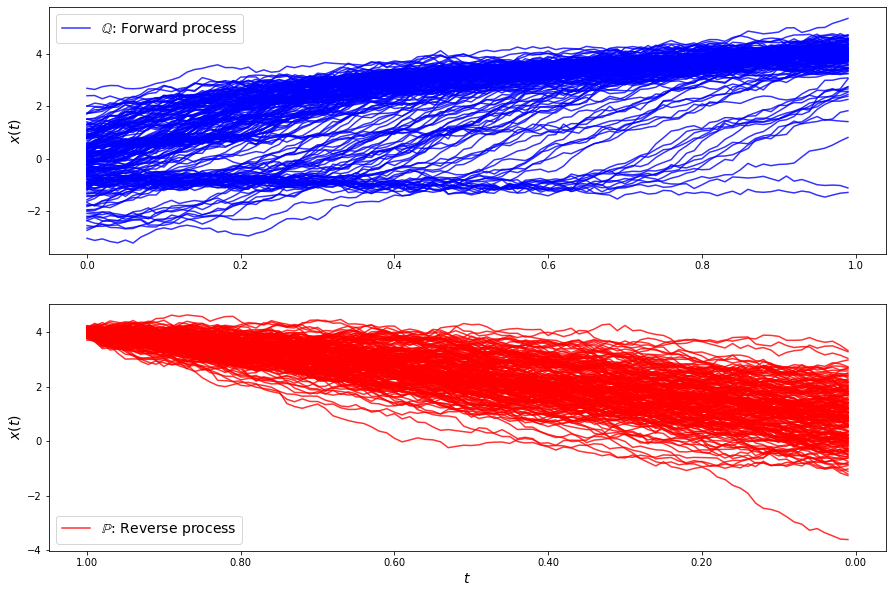

loss b 8.928697834059932
loss b 8.867156999244123
loss b 8.22350845967284
loss b 9.369901634459271
loss b 8.789253570691143
loss b 8.890985665534012
loss b 9.207325960255481
loss b 9.85059829407536
loss b 9.135626670033545
loss b 8.994506623394486
loss b 8.642670143507639
loss b 10.390157447235978
loss b 9.910274766755315
loss b 10.883859271734023
loss b 10.006928426580822
loss b 8.029921180039324
loss b 10.478648511080413
loss b 9.45311945131088
loss b 9.880017588932317
loss b 10.303871395465785
loss b 9.260804510007244
loss b 10.201502644311661
loss b 9.943824351070981
loss b 7.627686667495031
loss b 9.445099625753816
loss b 10.911611518021699
loss b 8.346073718541385
loss b 10.11127409527458
loss b 8.906259141990073
loss b 9.206011409342116
loss f 25.197675517733384
loss f 31.747998615370715
loss f 40.29580886168839
loss f 48.522563252973605
loss f 34.27581511250824
loss f 47.73191501946718
loss f 31.661905198242653
loss f 36.784794137739446
loss f 32.385428970320646
loss f 35.96720

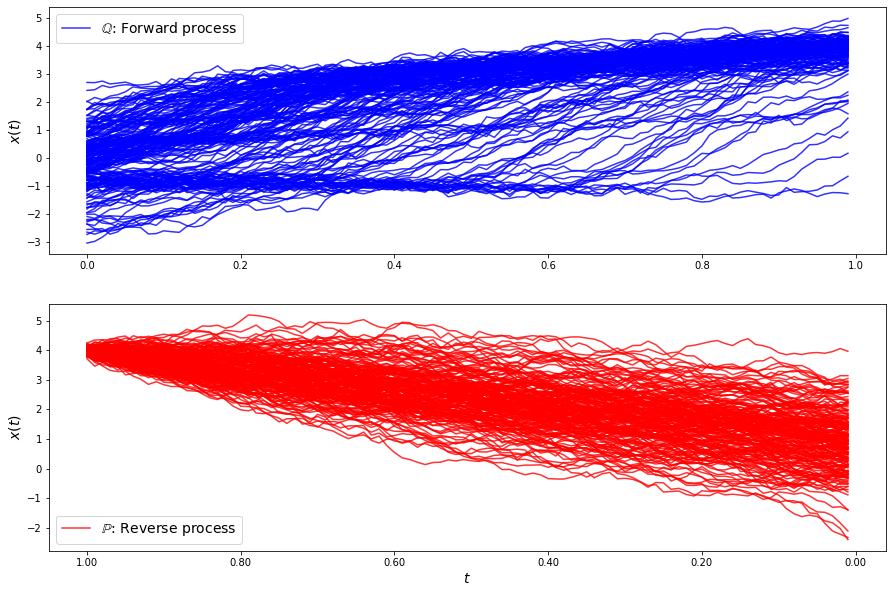

loss b 6.206424782043765
loss b 7.858609103406689
loss b 8.436810236837236
loss b 6.600338368179278
loss b 8.172741285293561
loss b 6.81831986869837
loss b 6.892337296301078
loss b 7.888496089055711
loss b 6.6623226268693
loss b 7.438312274253634
loss b 6.957970554878379
loss b 8.386904296377589
loss b 7.431693898540118
loss b 6.612307250452644
loss b 7.921058434567596
loss b 7.599579091248679
loss b 7.458377879503996
loss b 7.605317703522303
loss b 7.333583097000237
loss b 7.071182866073523
loss b 7.395915295164759
loss b 7.632195896327773
loss b 7.306938825923602
loss b 7.753647348035116
loss b 8.221627441487405
loss b 7.251699155526323
loss b 6.611977367797404
loss b 8.107826479849939
loss b 7.702506642498247
loss b 6.860820301041508
loss f 26.196460551134944
loss f 28.21417824182973
loss f 27.321250136082256
loss f 27.664402250144608
loss f 44.65200457540673
loss f 43.45822556291396
loss f 64.68730560549056
loss f 36.78471910000348
loss f 46.27997260262591
loss f 54.97290828017112


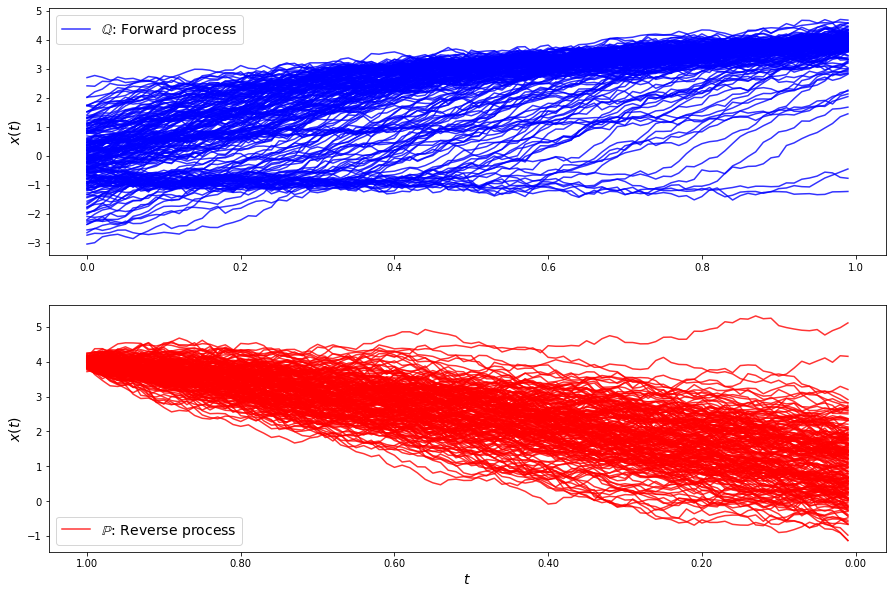

loss b 5.19735745432732
loss b 5.318830594900532
loss b 5.637311696542485
loss b 5.8617571326410935
loss b 4.778433499088776
loss b 5.944534883298771
loss b 5.218635414454166
loss b 6.860957754386869
loss b 5.983594311045286
loss b 5.872689565965617
loss b 5.85027453374003
loss b 5.42877355083765
loss b 5.933945497035566
loss b 5.29507863866967
loss b 5.393180124118241
loss b 5.195349295069099
loss b 5.991327679615783
loss b 5.811726349027683
loss b 5.200331224039203
loss b 5.277416299285541
loss b 5.383446901773129
loss b 6.125628738633056
loss b 5.113089012323877
loss b 5.246150004318023
loss b 5.7512243455642444
loss b 5.918151215087867
loss b 4.642207430569673
loss b 5.442697161711146
loss b 5.438517253504912
loss b 5.794296879717023
loss f 31.07590160541798
loss f 34.156272734633504
loss f 19.198237389878763
loss f 24.845413570776564
loss f 36.355808311047355
loss f 36.885815065520674
loss f 31.13442411966061
loss f 35.36860182952858
loss f 16.609437462896132
loss f 24.75757307030

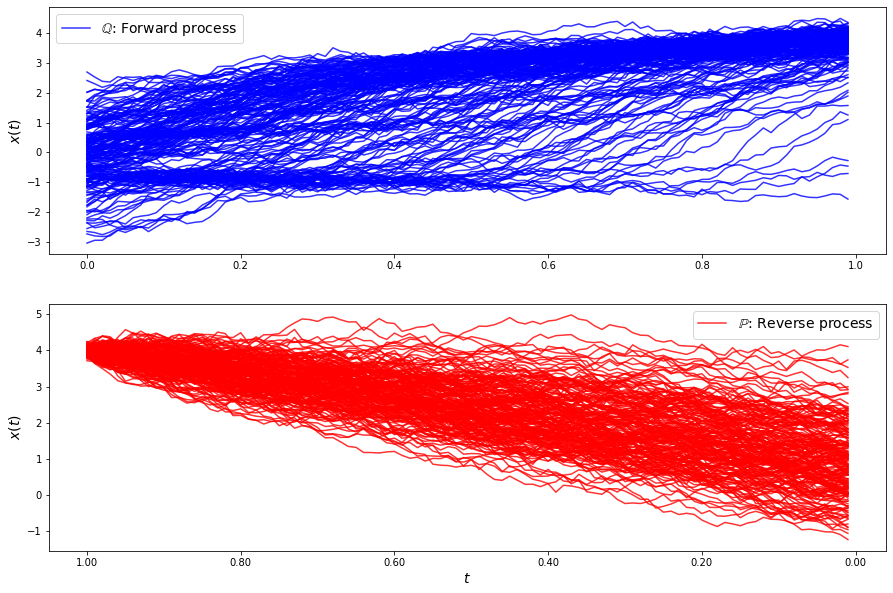

loss b 5.6809484022735655
loss b 4.270687885165586
loss b 5.01107027056606
loss b 4.711408143669616
loss b 4.4071555691261155
loss b 4.973886503197156
loss b 4.29041952785847
loss b 4.3608023252479775
loss b 4.742064267153932
loss b 4.435758604233718
loss b 4.98986706584841
loss b 4.476818360118027
loss b 4.8573711946593905
loss b 4.175832059478463
loss b 3.676977581466492
loss b 5.19918913781511
loss b 4.6745414938005325
loss b 4.767919833585688
loss b 4.89804569965582
loss b 4.895243573682641
loss b 4.294207568155496
loss b 4.667537998715095
loss b 5.188505403072689
loss b 3.719883810415325
loss b 3.605191690535653
loss b 4.591102785637625
loss b 4.095848028372378
loss b 3.5998972337172197
loss b 4.010256215980285
loss b 4.1899140969450785
loss f 23.78459091872867
loss f 45.56433166499538
loss f 55.75749271568612
loss f 63.559880569930485
loss f 36.75226483555553
loss f 60.43569161814462
loss f 62.57598742959255
loss f 75.28332598022537
loss f 113.43786840631977
loss f 110.0129000294

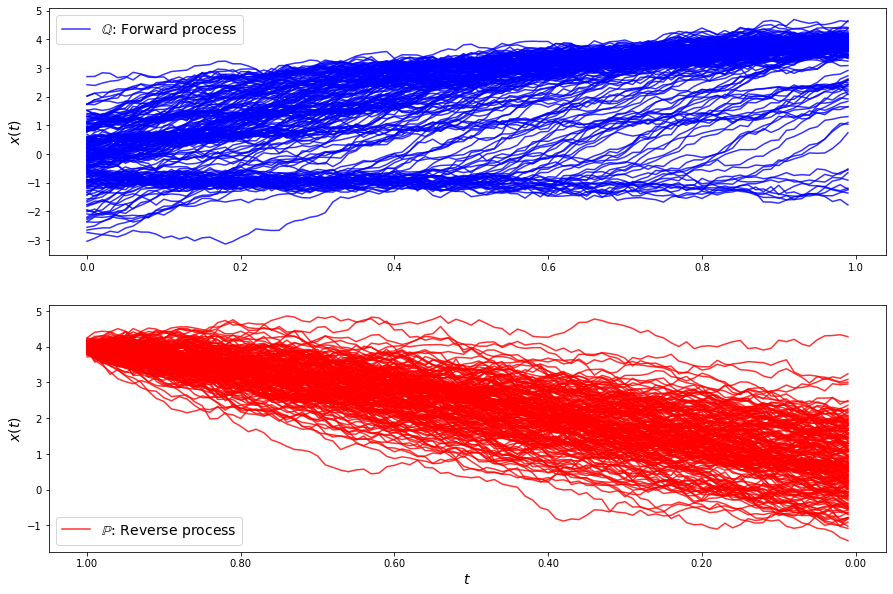

loss b 3.4798990570991792
loss b 4.426261580289105
loss b 3.5889557151290954
loss b 3.949380343562498
loss b 4.011362259689391
loss b 4.205875913005873
loss b 3.9321220839918816
loss b 3.7892259932159877
loss b 3.9639418150280723
loss b 4.358854565599114
loss b 3.6019703113219776
loss b 3.5338098290684146
loss b 4.105135588851305
loss b 4.4602799334662615
loss b 3.3181068205237723
loss b 3.219598833657576
loss b 3.646633612955813
loss b 4.894172092210458
loss b 3.1147729314639117
loss b 2.838771069981445
loss b 3.9005794889150254
loss b 4.4759652451440335
loss b 3.497941469152555
loss b 4.2213508459543565
loss b 3.756532063413493
loss b 3.9187173711998313
loss b 3.8608349432908167
loss b 3.190988889313293
loss b 3.5959272695336115
loss b 3.935691761670757
loss f 100.88582031553103
loss f 82.59407087307612
loss f 85.0701913840346
loss f 102.000790227591
loss f 76.23515441386296
loss f 51.976274035595395
loss f 96.98401795308007
loss f 54.474521644155146
loss f 46.57947182777137
loss f 7

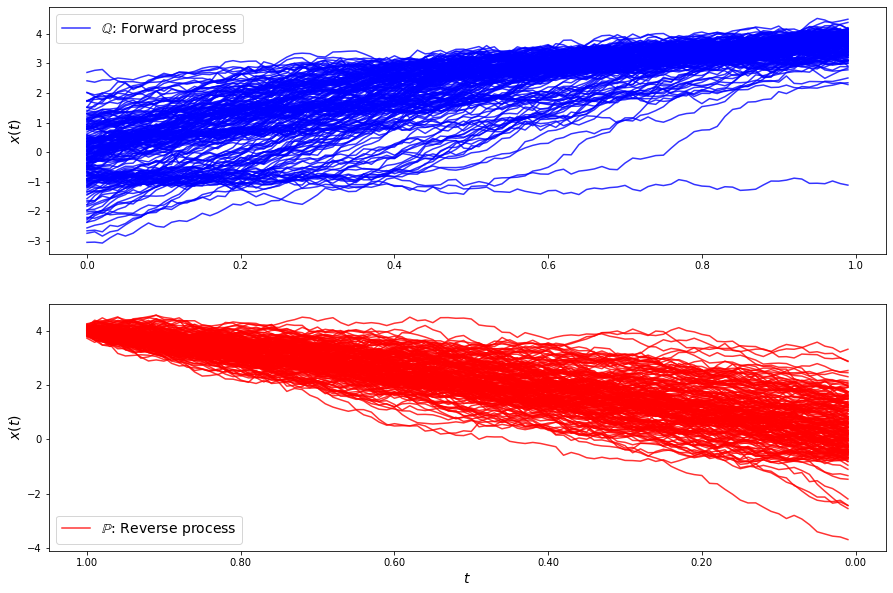

loss b 3.4591138780200406
loss b 4.080970096795283
loss b 3.394500027487482
loss b 3.5739236179605554
loss b 3.521196417945996
loss b 3.6586146285549748
loss b 4.462436894025235
loss b 3.2837837763690874
loss b 3.397842921188524
loss b 3.2415228371805522
loss b 3.1039118122944336
loss b 3.870447830829866
loss b 3.294519242824266
loss b 3.736719543482261
loss b 3.1406462250693146
loss b 2.599852382999642
loss b 3.140002198406896
loss b 3.1867294946847844
loss b 3.415175954107123
loss b 2.8861044052086755
loss b 2.300120020714709
loss b 3.4736990935240555
loss b 3.224761630548727
loss b 3.912042439715715
loss b 3.8628635950002193
loss b 3.548264013767108
loss b 3.407427091450742
loss b 3.646845338969925
loss b 2.8159907987064132
loss b 3.2114320933080993
loss f 20.560222913023207
loss f 20.829151665392875
loss f 21.91309158826455
loss f 17.420464421662828
loss f 16.206522584974604
loss f 12.858938346496851
loss f 29.374302522565777
loss f 17.68747959520643
loss f 12.80629306644202
loss f

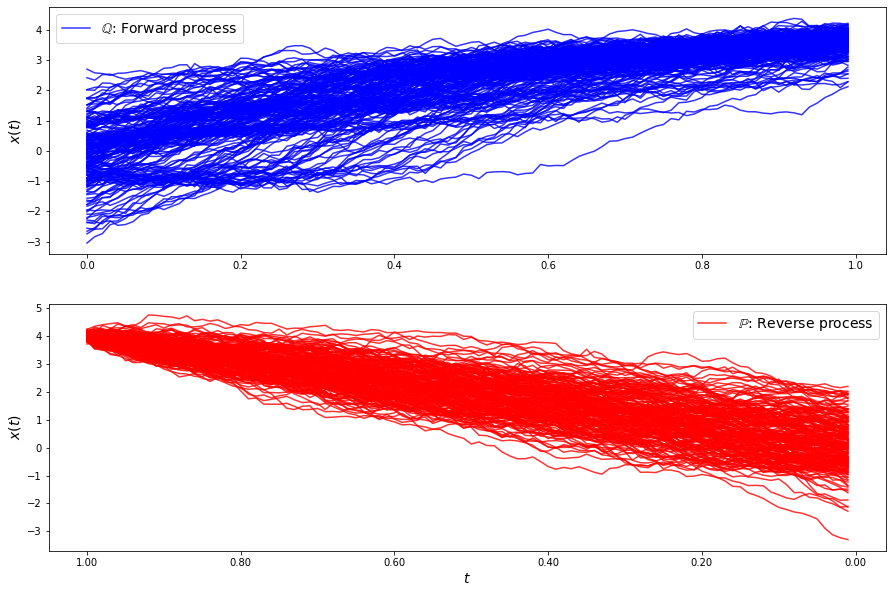

loss b 3.928968195006812
loss b 4.0283158673157935
loss b 4.238628885437857
loss b 2.318502121487456
loss b 4.189350554750632
loss b 3.0971024433284047
loss b 3.777083718605239
loss b 3.929233130856691
loss b 4.018063399010888
loss b 3.6931723233814067
loss b 5.054641220861336
loss b 3.2826504365614877
loss b 3.6658743306707406
loss b 4.633328658180472
loss b 4.773041214889998
loss b 4.3151469865582435
loss b 3.669609814152057
loss b 3.6196615506299343
loss b 3.813282201842257
loss b 4.266771326447827
loss b 4.2458811304143795
loss b 3.4276400427368747
loss b 4.113241832471783
loss b 4.0980966110891455
loss b 4.4571811205203495
loss b 5.301596291643233
loss b 4.36207889567273
loss b 4.73990312031805
loss b 3.7816787506417815
loss b 5.2506838827886035
loss f 15.426606918448753
loss f 12.053804571522537
loss f 13.950548501732339
loss f 14.347998332119612
loss f 12.783741514044035
loss f 15.984403064119213
loss f 12.55528760700877
loss f 28.331861853972303
loss f 12.561989979028453
loss f

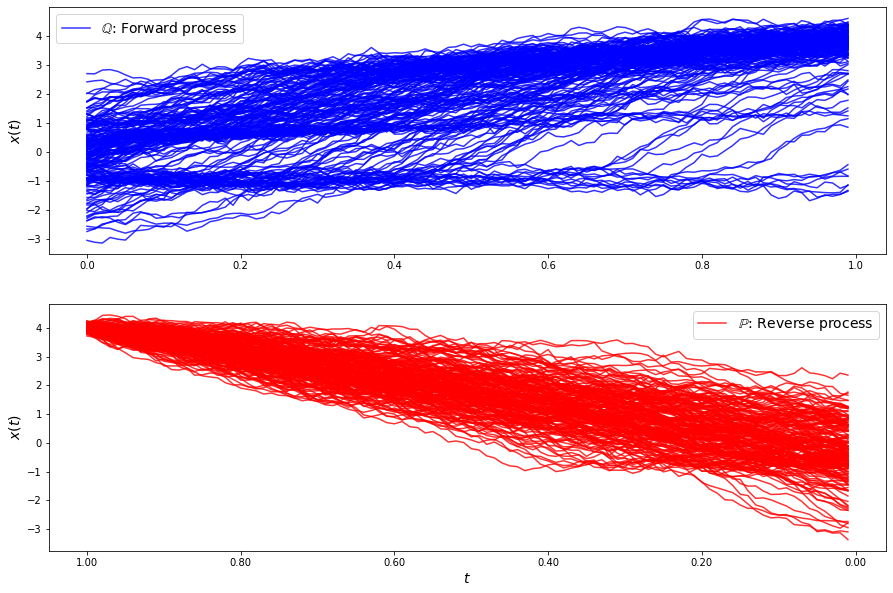

loss b 4.614823193959751
loss b 3.6151381012025885
loss b 4.823039560733024
loss b 4.646612617262418
loss b 3.9860605185110964
loss b 4.137444460267229
loss b 3.3962856977588776
loss b 4.008912951659835
loss b 4.7891503326760665
loss b 4.009413389843078
loss b 3.845258695411201
loss b 3.2967357737944565
loss b 3.8508278322482576
loss b 4.29357101384177
loss b 5.4727362336071055
loss b 3.154555038878642
loss b 4.269957794989617
loss b 3.7653118730964725
loss b 4.7968405818802475
loss b 4.075076029734206
loss b 3.912980601275057
loss b 5.453021959983243
loss b 4.11621000834047
loss b 4.428439834746473
loss b 3.8856727994018216
loss b 3.376118022612534
loss b 4.504861705855137
loss b 4.145090131237988
loss b 3.884987869904917
loss b 4.342310389372646
loss f 91.52897775420072
loss f 109.5643620614671
loss f 79.109983657078
loss f 102.01477703390995
loss f 114.04208328026836
loss f 114.67704510441335
loss f 137.5926879680927
loss f 158.7053014991809
loss f 152.072679964138
loss f 144.523001

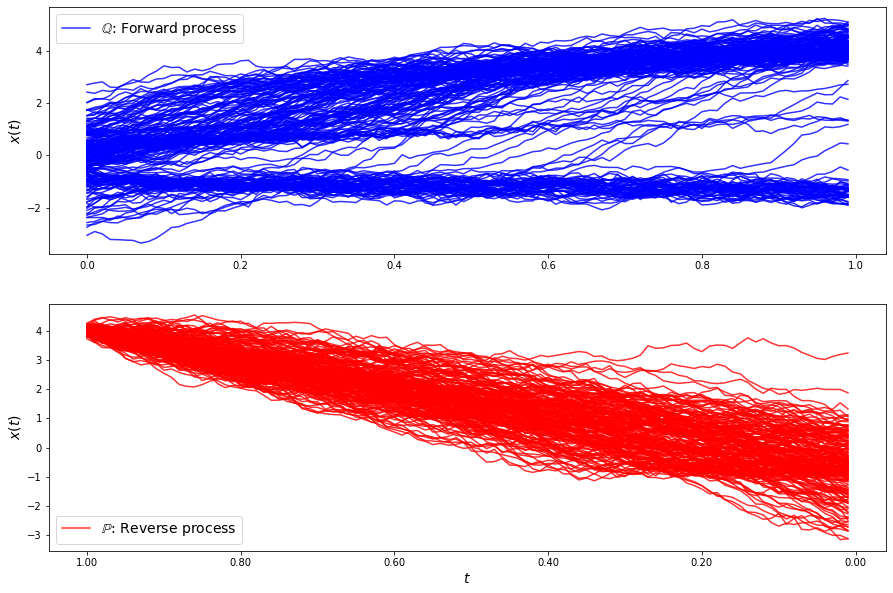

loss b 5.174055152239965
loss b 5.385135723929578
loss b 6.4121914063270316
loss b 6.243473428457836
loss b 4.787605991656806
loss b 6.564227786737603
loss b 5.8708638548007945
loss b 5.762347065639031
loss b 5.55125097156072
loss b 6.0565195589275636
loss b 6.318871899793028
loss b 6.022389575671256
loss b 6.405873973842916
loss b 6.07074024977094
loss b 6.682067729881166
loss b 5.03325671923046
loss b 6.908127643226538
loss b 6.732754066758995
loss b 6.7130314496573265
loss b 5.082850906993218
loss b 6.194499116795364
loss b 7.1188647646525824
loss b 5.7383496922088195
loss b 7.077926482274371
loss b 6.353590020196628
loss b 5.8425080923427375
loss b 6.0524867518112995
loss b 6.520990607637726
loss b 6.641046184840243
loss b 6.589758245921737
loss f 404.59932855844465
loss f 402.82437532526757
loss f 411.1877436902172
loss f 459.7001011679231
loss f 411.6250062119242
loss f 468.7147501800608
loss f 447.01741518246746
loss f 464.7093024245891
loss f 467.5251588999873
loss f 501.557728

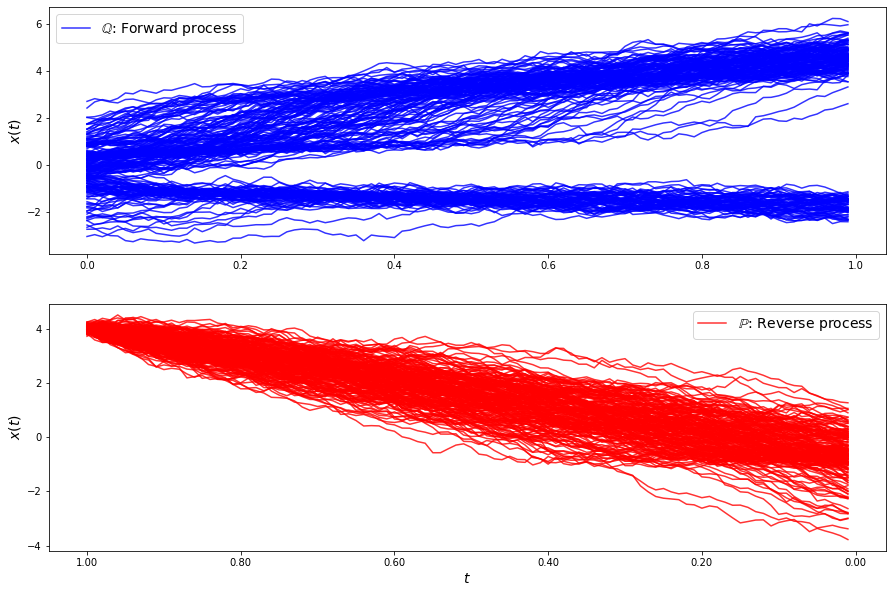

loss b 9.708419410696116
loss b 9.532669595597834
loss b 9.050004898340704
loss b 9.724588195384959
loss b 9.822677038818577
loss b 9.389445970005706
loss b 10.324930480382271
loss b 9.459410546726033
loss b 9.24366141146969
loss b 8.77046856109886
loss b 9.727725406606991
loss b 9.638290025230281
loss b 9.126237626332747
loss b 10.292241727125475
loss b 10.038547595708673
loss b 9.085640052766774
loss b 9.318071664827901
loss b 10.748665886436513
loss b 9.905148453215926
loss b 9.202928342323416
loss b 9.302775585069858
loss b 10.499749781180427
loss b 9.656459364491178
loss b 9.273902230070979
loss b 10.954822374706334
loss b 10.1065578147994
loss b 10.365962510279124
loss b 10.023518918716947
loss b 9.917348007072578
loss b 10.36866041221033
loss f 632.6513522741153
loss f 615.4201950651744
loss f 657.4688369154223
loss f 625.9326687300497
loss f 589.5068399578952
loss f 652.9541377145562
loss f 618.9128951124695
loss f 631.1524023356808
loss f 601.817202298191
loss f 655.4712723323

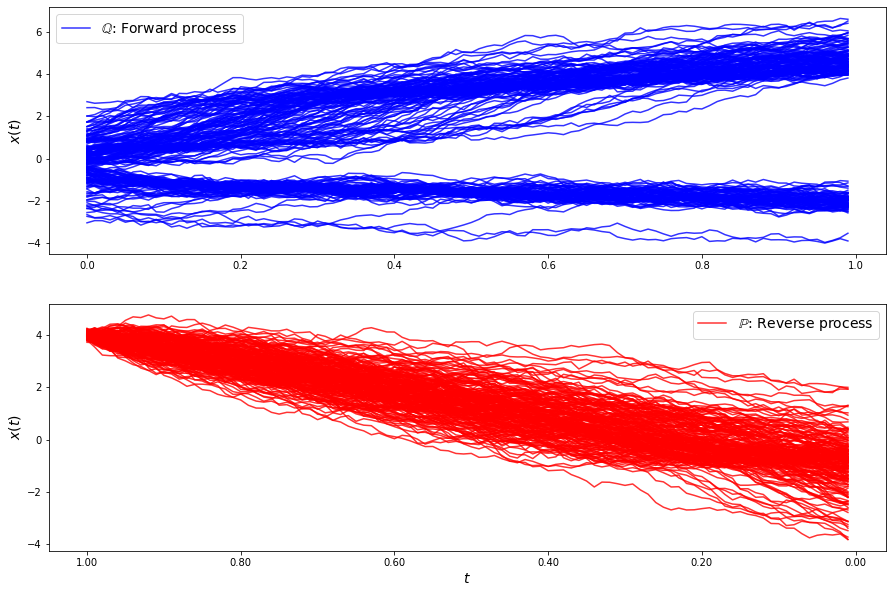

loss b 12.875423167596766
loss b 13.453860700461462
loss b 12.973688097838348
loss b 13.553645789717251
loss b 13.954289052549836
loss b 13.21866876943636
loss b 14.416454257615428
loss b 12.993506417956764
loss b 14.109023357006539
loss b 13.011636070510335
loss b 14.493152421437937
loss b 11.990462790958823
loss b 13.21820301072255
loss b 14.629670689801225
loss b 13.347552082613067
loss b 13.437851240566625
loss b 14.36999123123622
loss b 13.075124755715924
loss b 14.031976286911629
loss b 13.794407888932431
loss b 13.342673566118405
loss b 13.773520962532963
loss b 14.272709947036596
loss b 12.99857139146996
loss b 14.793697735378782
loss b 12.81407751708835
loss b 13.359230466126927
loss b 13.649640409989047
loss b 13.803527929743133
loss b 14.66786554410476
loss f 693.6366030541263
loss f 710.9389581491473
loss f 754.1486982209581
loss f 713.2275855621573
loss f 709.9949559214018
loss f 739.7376420842802
loss f 769.7444845062306
loss f 739.0023746733514
loss f 765.1236453162958
l

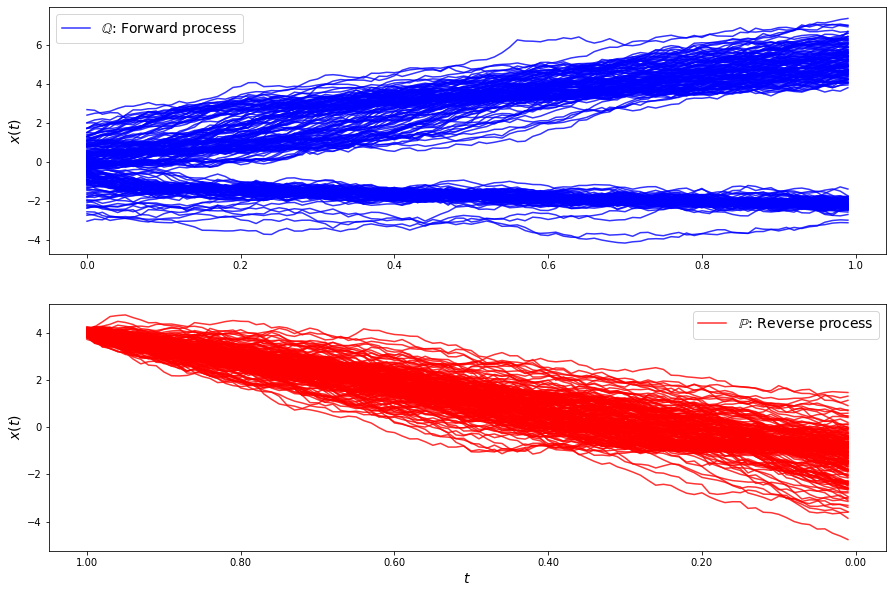

loss b 18.32229664644914
loss b 16.93015180434938
loss b 17.603871474000783
loss b 18.145043232004312
loss b 18.259398197101305
loss b 18.709384733972204
loss b 17.649544691582534
loss b 18.74265220757746
loss b 17.720296766144894
loss b 18.50671652619682
loss b 18.960805214651486
loss b 18.183668986078878
loss b 18.92665793195872
loss b 16.85174655998728
loss b 17.849409493421557
loss b 16.922838947980583
loss b 18.84975007043536
loss b 18.07093584484866
loss b 17.0469007757572
loss b 18.294841352669994
loss b 17.77103259134359
loss b 17.347862583994786
loss b 19.145653834349993
loss b 19.308499916720514
loss b 17.77098912528131
loss b 17.727955800177742
loss b 17.9599768343974
loss b 17.278256755116114
loss b 17.730146446360088
loss b 18.018181090858743
loss f 820.0471575278503
loss f 857.3998829887512
loss f 786.8134673745943
loss f 821.5712962140243
loss f 864.463339548166
loss f 893.276812467053
loss f 850.5915132078954
loss f 863.1699279917843
loss f 906.4573495670843
loss f 846.

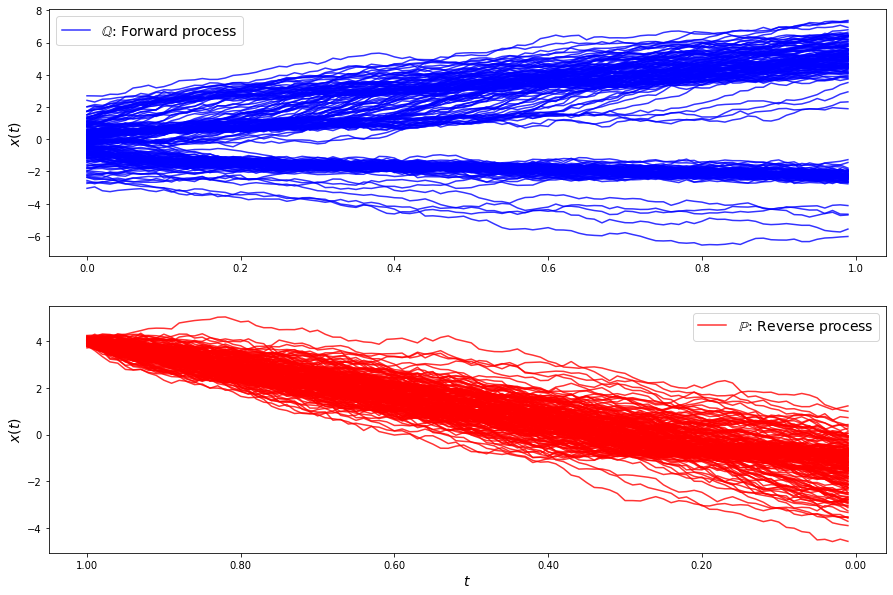

loss b 21.76814525918766
loss b 21.856183993723644
loss b 20.60118726120272
loss b 20.535133221979983
loss b 21.675254206118506
loss b 22.116650571923532
loss b 22.052292089464906
loss b 20.33252899269905
loss b 21.38390285631499
loss b 21.30875130342816
loss b 22.74403828820831
loss b 21.972846337028475
loss b 19.26610616196532
loss b 20.754852570443497
loss b 20.573329473674782
loss b 21.909132548673977
loss b 22.503650167070692
loss b 21.064988016936244
loss b 20.555579021673164
loss b 22.092600060219997
loss b 20.822601759204662
loss b 23.046711238181327
loss b 21.516011240834455
loss b 21.016777587555513
loss b 22.38862392454758
loss b 21.933535098312667
loss b 21.526571309875465
loss b 22.987580460868486
loss b 22.300370090883938
loss b 22.256349222670206
loss f 946.0421886369854
loss f 917.017360614845
loss f 858.6789429171167
loss f 923.0317061494769
loss f 935.8133046925794
loss f 885.2114846240147
loss f 891.3468268028682
loss f 882.3226971360996
loss f 892.8597932522342
loss

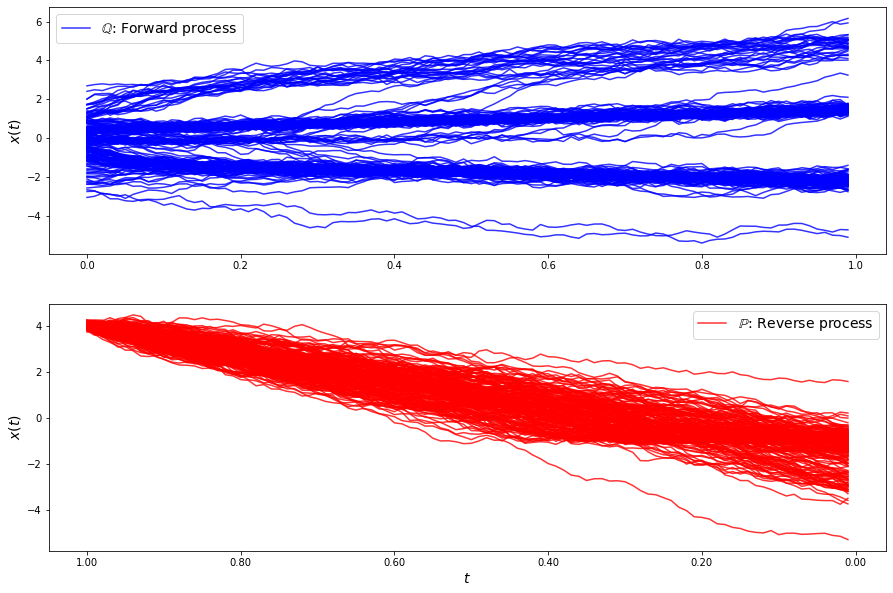

loss b 25.64710572858588
loss b 26.646584661924273
loss b 25.829597357574222
loss b 25.620928394596756
loss b 25.14963996879858
loss b 24.857502655565646
loss b 26.9362000485653
loss b 25.117974953168872
loss b 25.102654665999857
loss b 26.051766556820194
loss b 25.923376893454133
loss b 24.540884568785202
loss b 25.56429319096591
loss b 26.3521819487796
loss b 26.423772795788405
loss b 25.384363233192186
loss b 25.883756631679855
loss b 26.60956596491034
loss b 25.823618135090708
loss b 25.477475957933727
loss b 25.819749445205098
loss b 25.227137806850017
loss b 26.678430804447075
loss b 26.055204242539155
loss b 26.038933531483735
loss b 26.47250451015842
loss b 26.715704088727843
loss b 27.374436356738453
loss b 26.458788020165304
loss b 26.493025804335634
loss f 1077.8280729194396
loss f 1076.4692033377817
loss f 1055.6107471375165
loss f 1077.9359247448347
loss f 1050.3237756256779
loss f 1075.1334094654112
loss f 1123.0060412435773
loss f 1100.5113727672624
loss f 1037.511271533

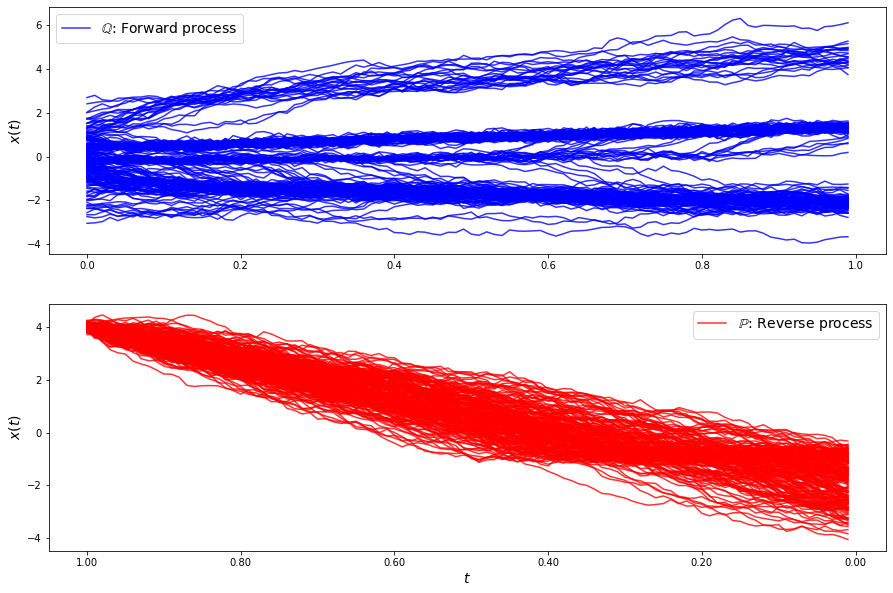

loss b 32.34987916265123
loss b 33.49162728624093
loss b 32.55822127422112
loss b 32.21328977651288
loss b 33.70166749968199
loss b 32.30695174241475
loss b 32.27374061557489
loss b 32.191747595435665
loss b 32.64715803920564
loss b 33.03825228633509
loss b 33.24347430996508
loss b 32.87060419837412
loss b 33.53653649983457
loss b 32.94964247766786
loss b 31.801564118599817
loss b 33.655492617395396
loss b 32.42528959432157
loss b 32.87133013917598
loss b 32.893717594230054
loss b 33.28529852397468
loss b 34.06202437440559
loss b 33.886680142073146
loss b 32.177274032769425
loss b 32.95979268785494
loss b 33.32368316677788
loss b 33.85843077243331
loss b 33.37986001682553
loss b 33.45485394956785
loss b 33.23070347397532
loss b 32.83817601743624
loss f 1169.1279888942943
loss f 1244.255841777133
loss f 1152.860709925136
loss f 1204.2219587865445
loss f 1190.6456926813037
loss f 1201.806589804794
loss f 1215.7819551272821
loss f 1235.5949803870176
loss f 1223.202402034504
loss f 1256.34

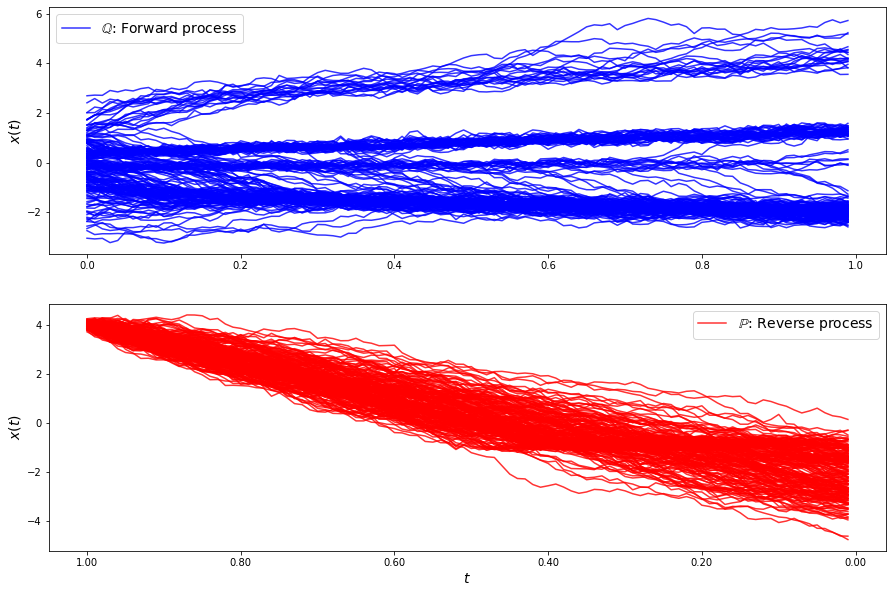

loss b 38.939155983872055
loss b 40.32408959587083
loss b 38.7018703426748
loss b 38.98692314349327
loss b 39.838734472028094
loss b 40.021342557419786
loss b 39.08141479601364
loss b 39.10794618329992
loss b 40.19570508328183
loss b 39.852693982131484
loss b 40.76077890796856
loss b 39.292125677518875
loss b 39.90964209674892
loss b 40.442944257365355
loss b 40.47773134476698
loss b 38.196588821536274
loss b 40.45528044520948
loss b 40.80866450194966
loss b 39.99945535100323
loss b 40.68099542610022
loss b 40.62965405879
loss b 40.294027457245264
loss b 39.88130405814649
loss b 40.263117640032036
loss b 40.59706712489114
loss b 40.03331956427492
loss b 40.415539479862865
loss b 40.02403401325772
loss b 39.79080794566353
loss b 39.118087059400985
loss f 1254.467970125606
loss f 1329.1876533316763
loss f 1348.5579452494399
loss f 1365.5238266966128
loss f 1322.7772998263604
loss f 1300.2674584098042
loss f 1296.6146106167187
loss f 1321.3399801155242
loss f 1338.7057933803953
loss f 134

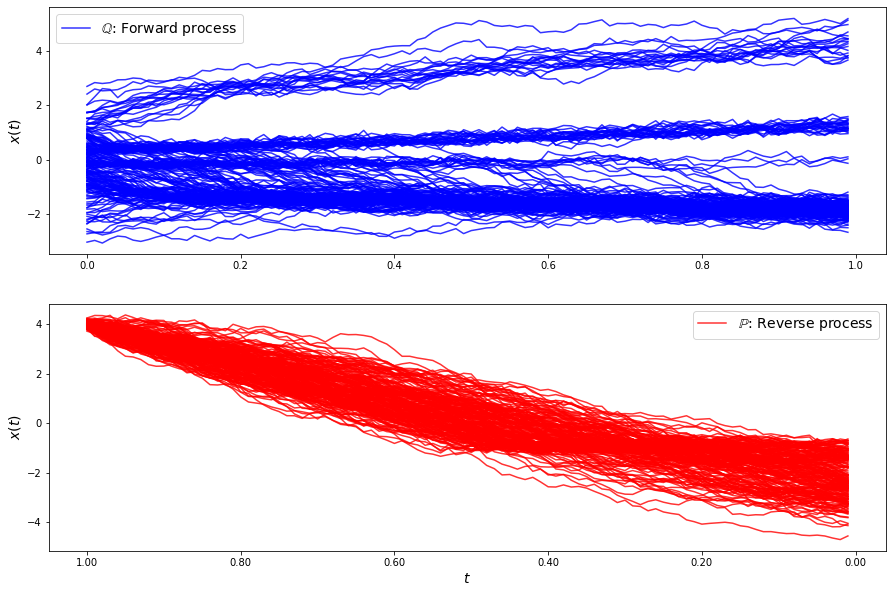

loss b 47.1957365265944
loss b 46.07350643591177
loss b 44.88341807640891
loss b 46.60854797917438
loss b 46.273787865689286
loss b 47.09582253776503
loss b 46.45540412385057
loss b 47.10329936012575
loss b 45.72236788802193
loss b 46.100479664934596
loss b 46.94491180408418
loss b 45.96143594380193
loss b 45.903178032075495
loss b 47.328897388185844
loss b 46.97913815198946
loss b 46.58113955083559
loss b 46.582666990287336
loss b 46.22142358486937
loss b 46.58185431476584
loss b 46.711569981636856
loss b 47.093000733981654
loss b 46.89565482535945
loss b 47.24576641619706
loss b 47.33293986605833
loss b 46.83111246254722
loss b 46.41670198189239
loss b 46.2657654020879
loss b 46.94785784187184
loss b 47.21228321189119
loss b 45.480892745448685
loss f 1477.6874845235502
loss f 1433.1102787865436
loss f 1464.154970144053
loss f 1393.89165340334
loss f 1399.5952338558232
loss f 1525.2493912628538
loss f 1424.8925723478103
loss f 1510.0859054033015
loss f 1474.2851265774434
loss f 1475.1

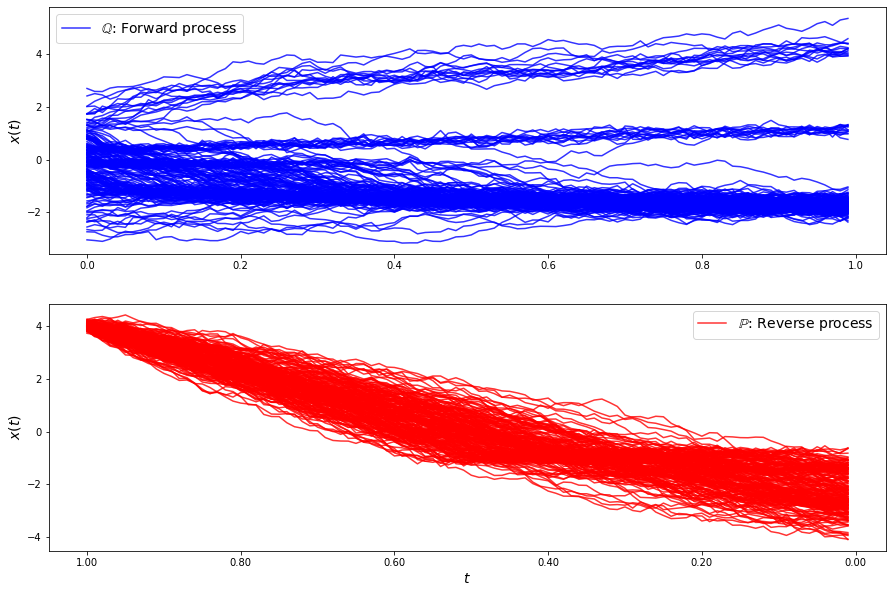

loss b 52.48926602536387
loss b 52.91240870974763
loss b 52.60121805559493
loss b 51.49472900217886
loss b 53.08020904313988
loss b 53.48632017936972
loss b 53.61012678336422
loss b 51.694056993465914
loss b 52.718489691127715
loss b 52.2291054602342
loss b 52.57494175071937
loss b 53.02378609006068
loss b 53.3085097263791
loss b 51.444720900906
loss b 53.090869892667975
loss b 51.52396003592658
loss b 51.63779340405527
loss b 53.82324588851461
loss b 53.376701392658255
loss b 51.54563545457878
loss b 52.880415555844564
loss b 52.07208922809579
loss b 53.314436875479494
loss b 52.916167557980806
loss b 50.10728016382131
loss b 51.83485901354611
loss b 52.63527168053532
loss b 50.83322540905174
loss b 51.96074079410621
loss b 52.17204324625525
loss f 1523.9474143616424
loss f 1503.3920696335445
loss f 1547.169512964985
loss f 1516.1982056373752
loss f 1507.1599096855325
loss f 1567.3014584808202
loss f 1538.4284170999638
loss f 1526.5153607942855
loss f 1539.991642657368
loss f 1525.730

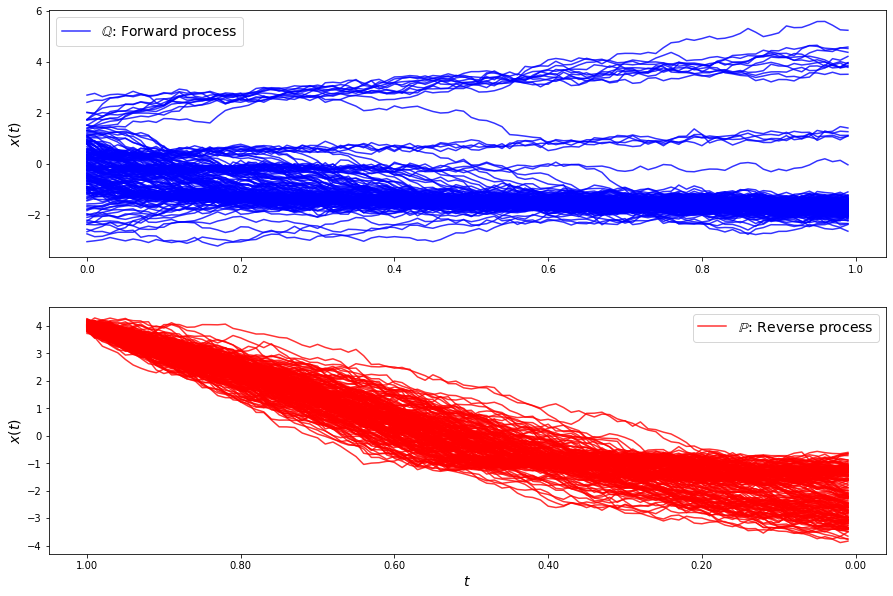

loss b 58.749102899593
loss b 57.72583272499195
loss b 58.878027934691296
loss b 58.327206929062534
loss b 58.137358029663424
loss b 56.09792814719014
loss b 58.4223917235181
loss b 57.69911772208665
loss b 58.03550307318432
loss b 58.541627474215204
loss b 58.71880567383079
loss b 59.80564817362459
loss b 58.415286438531574
loss b 58.11993703096233
loss b 57.46364790868893
loss b 56.79590446539198
loss b 58.04486318091309
loss b 58.41884809949672
loss b 58.72916847074214
loss b 55.64019240991616
loss b 58.258708223492235
loss b 60.73215265975012
loss b 57.062971651370425
loss b 58.972610787965465
loss b 59.929858827916966
loss b 57.55926102696366
loss b 59.00676925157763
loss b 57.65149655962757
loss b 57.281647452200176
loss b 57.269997873996466
loss f 1571.4726567071375
loss f 1571.0941120815617
loss f 1590.0639426408932
loss f 1553.2601244802145
loss f 1571.9420606058732
loss f 1547.104347171359
loss f 1560.612355256512
loss f 1573.9392255885607
loss f 1557.2053135107328
loss f 157

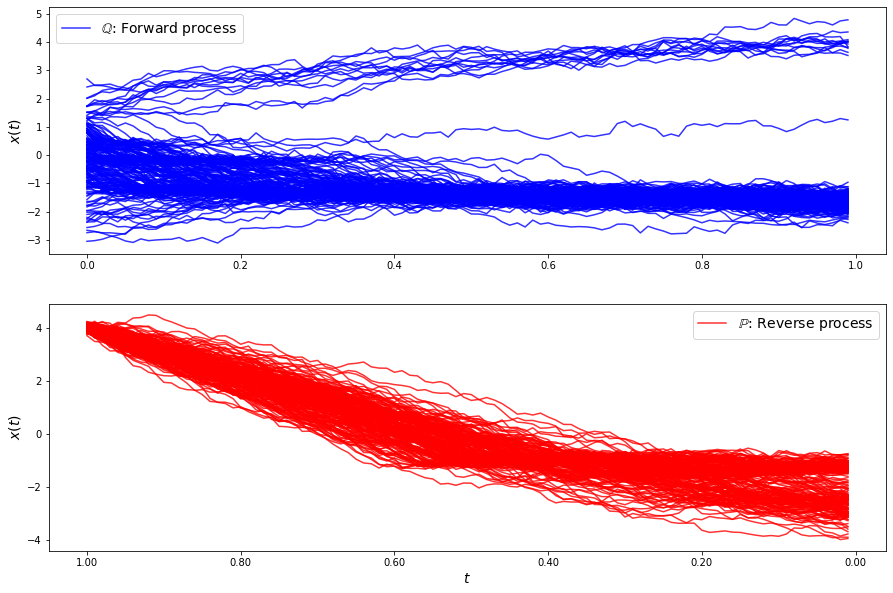

loss b 62.996902683164976
loss b 61.46317955799449
loss b 63.68578346052468
loss b 62.55683944027458
loss b 63.37372042884291
loss b 63.38854642427076
loss b 62.06640141342069
loss b 64.21697479259126
loss b 62.47975574122448
loss b 63.38495440670951
loss b 64.00059069444508
loss b 63.70520879426676
loss b 64.97461857013971
loss b 63.35006593891554
loss b 61.85668268191406
loss b 64.44417369794233
loss b 64.45639025966712
loss b 63.46672037511757
loss b 64.1011018960191
loss b 65.31123165069006
loss b 62.82759176905903
loss b 63.13518495182049
loss b 64.84614093158955
loss b 63.98704281620927
loss b 65.46645718959734
loss b 65.54271527671516
loss b 62.0289276931718
loss b 65.7660811657508
loss b 64.67071182139296
loss b 65.3271229643839
loss f 1556.4809825177824
loss f 1534.0428398156837
loss f 1529.6975472601075
loss f 1548.9333155676384
loss f 1537.0213265851555
loss f 1550.9843384919202
loss f 1537.942973713417
loss f 1535.752830390069
loss f 1506.1354616222086
loss f 1545.589648003

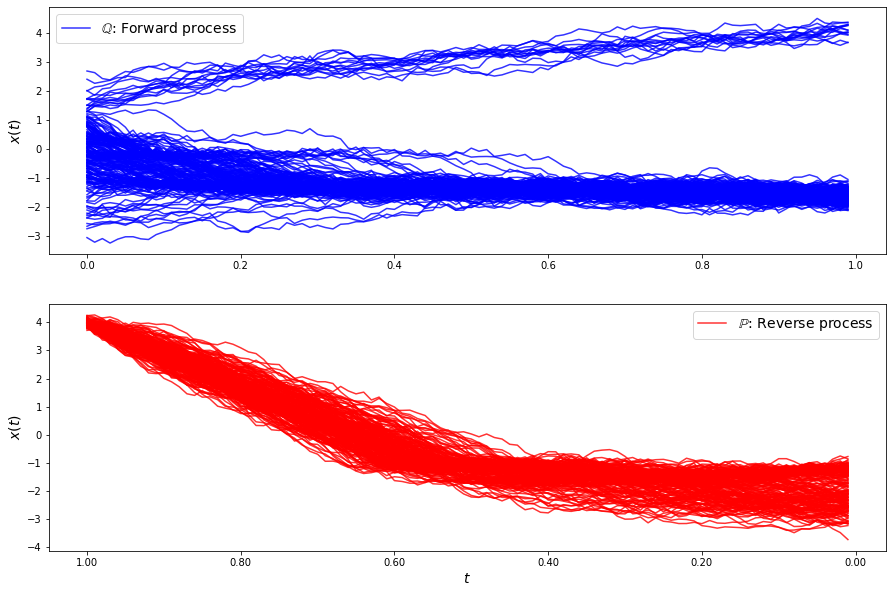

loss b 70.83566955981522
loss b 70.11506749796165
loss b 70.65965261257244
loss b 70.51094836530802
loss b 69.70735651012279
loss b 69.8232379976978
loss b 72.00544843726394
loss b 72.00334192030509
loss b 69.29392848609315
loss b 71.1331598891123
loss b 70.15496858431237
loss b 72.48422843282671
loss b 73.43247358079756
loss b 71.98252647318427
loss b 71.45217607393599
loss b 73.94406558666019
loss b 73.98483787111314
loss b 73.98607214828621
loss b 74.05746065110462
loss b 72.98622885369052
loss b 74.3587234263091
loss b 76.33563711424554
loss b 74.42589151850291
loss b 77.8851115409452
loss b 74.01146465529801
loss b 77.71877232179268
loss b 75.68458016627326
loss b 75.76952141380195
loss b 75.93095919252708
loss b 76.9318754176538
loss f 1551.9615026980234
loss f 1519.0825197126665
loss f 1521.5394839363623
loss f 1533.496920955454
loss f 1519.8307815883988
loss f 1528.6064832660065
loss f 1507.4388696618807
loss f 1498.1106462767139
loss f 1536.8108069984664
loss f 1527.2007907519

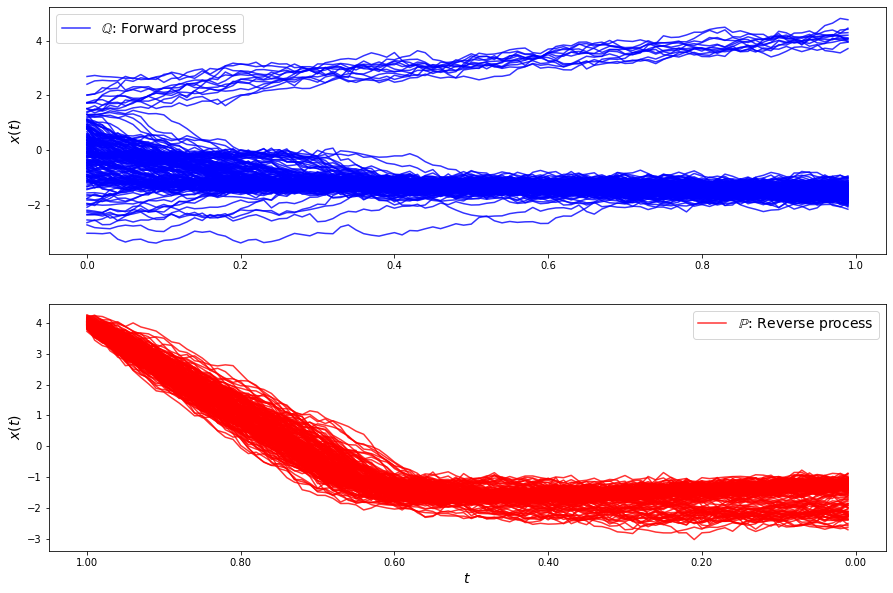

loss b 81.50047529522142
loss b 83.99942563901341
loss b 82.57786831824089
loss b 84.73362024695966
loss b 83.36159115511371
loss b 83.12052838969497
loss b 85.49989075993747
loss b 86.19064451232875
loss b 84.32474744868794
loss b 83.75421569816612
loss b 86.04712117391989
loss b 84.04383409463135
loss b 85.00791182594779
loss b 85.66791078729219
loss b 85.05641425877212
loss b 85.00275927511606
loss b 87.12286356561285
loss b 87.38806740975288
loss b 87.29726531346019
loss b 87.60264801862802
loss b 88.00876619295377
loss b 87.60668685367887
loss b 87.80278313661653
loss b 87.94548913662963
loss b 89.80416370530993
loss b 88.15092308703876
loss b 88.04644668685452
loss b 88.08524804197505
loss b 90.37990885411257
loss b 91.05962034542058
loss f 1532.7128896266872
loss f 1508.518823026286
loss f 1505.0119581395068
loss f 1517.7721921863777
loss f 1525.48593297587
loss f 1529.035344327221
loss f 1514.2925588449923
loss f 1511.600004916896
loss f 1500.9346233684782
loss f 1494.011973278

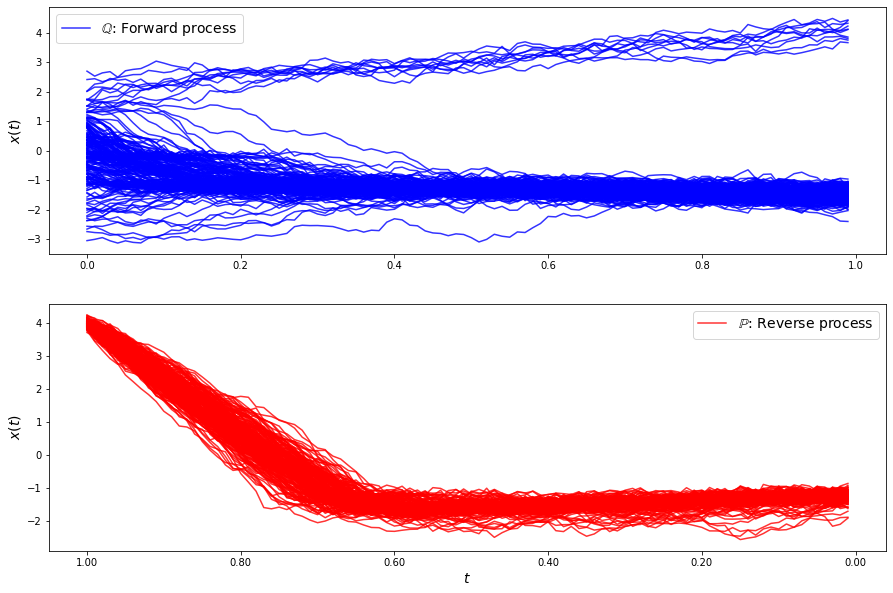

loss b 97.14525206109442
loss b 94.84081854454357
loss b 96.35873309252675
loss b 97.76648784468821
loss b 96.73481518808016
loss b 96.07484898422199
loss b 96.22281305289816
loss b 97.22857916244544
loss b 96.69155311484667
loss b 97.4888594603909
loss b 97.2079620460613
loss b 96.91634595231156
loss b 99.41890902878855
loss b 97.81870434978448
loss b 98.90480882950592
loss b 98.91987873167506
loss b 97.88933958823573
loss b 99.24215784355664
loss b 99.31114031110103
loss b 99.77840137913284
loss b 99.02956195134264
loss b 101.66986810175408
loss b 101.54248777189383
loss b 99.51669903527711
loss b 100.03737678664301
loss b 100.08377661625681
loss b 102.6702437352322
loss b 100.66418629084762
loss b 101.39519961445193
loss b 101.91648424704752
loss f 1510.8265365115444
loss f 1509.1839592230972
loss f 1517.734416457759
loss f 1503.8647701690818
loss f 1507.6000137300912
loss f 1508.0066359579882
loss f 1487.7455173665785
loss f 1477.3844223420685
loss f 1487.8399387516547
loss f 1513.

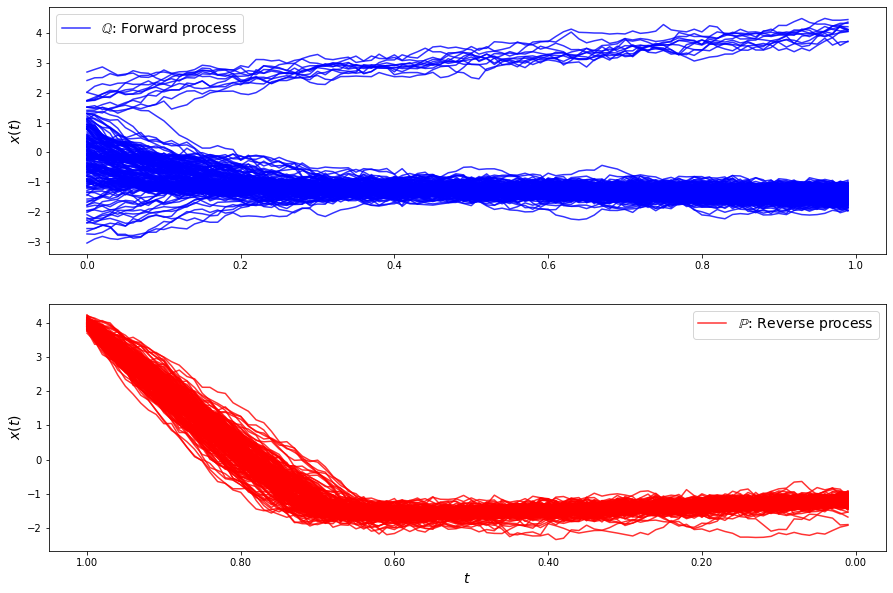

loss b 108.16315802262025
loss b 108.41363893751996
loss b 108.8210563028578
loss b 108.43021507969397
loss b 109.10416570739885
loss b 108.58276940648895
loss b 108.25137158765621
loss b 109.55480443410599
loss b 109.94642179851562
loss b 109.0339552687443
loss b 110.28181781135265
loss b 111.4773585725518
loss b 109.89085322964665
loss b 110.88253065020201
loss b 111.5252391783652
loss b 110.62516555631267
loss b 111.31766372334863
loss b 110.95849814727809
loss b 112.28347335664039
loss b 112.86388876038394
loss b 112.90014191935074
loss b 110.25568778464496
loss b 113.90694868512678
loss b 112.2017228014965
loss b 114.37939974635022
loss b 113.90898469928455
loss b 113.98241924880132
loss b 114.43549080309637
loss b 115.47401781386856
loss b 115.34371954716327
loss f 1488.889927985183
loss f 1501.761127503546
loss f 1502.8259057035382
loss f 1490.100669686249
loss f 1482.915992344484
loss f 1487.5445466136753
loss f 1507.8049950060993
loss f 1498.8511862464234
loss f 1488.769269973

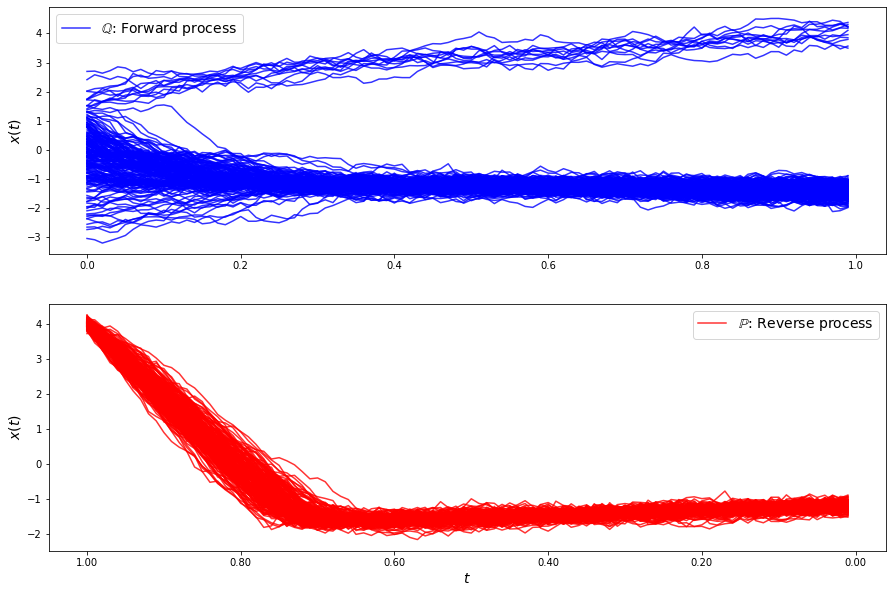

loss b 119.85944687647527
loss b 121.92530222594188
loss b 120.64855035032092
loss b 122.03934725753967
loss b 119.62596582780805
loss b 121.08943642113964
loss b 121.78596310474217
loss b 122.56040714654212
loss b 121.95403587302064
loss b 122.71864912578613
loss b 124.01966005787753
loss b 122.6837060274144
loss b 121.89542792104986
loss b 123.30638338018687
loss b 122.73255844207449
loss b 122.73622307823209
loss b 123.18250141237544
loss b 123.67212483837737
loss b 122.79589142442512
loss b 124.89439133680077
loss b 124.22059262085646
loss b 124.645930165831
loss b 124.21029996375098
loss b 124.90472912806976
loss b 126.89582953705516
loss b 126.44155916186956
loss b 124.56730065894571
loss b 124.2678144754883
loss b 125.79745363861441
loss b 125.08073268242559
loss f 1481.0699693971644
loss f 1503.1728009886947
loss f 1495.8101726144098
loss f 1504.2916529279244
loss f 1468.248542491296
loss f 1490.8526988173312
loss f 1478.85878785475
loss f 1501.957702178141
loss f 1497.40389552

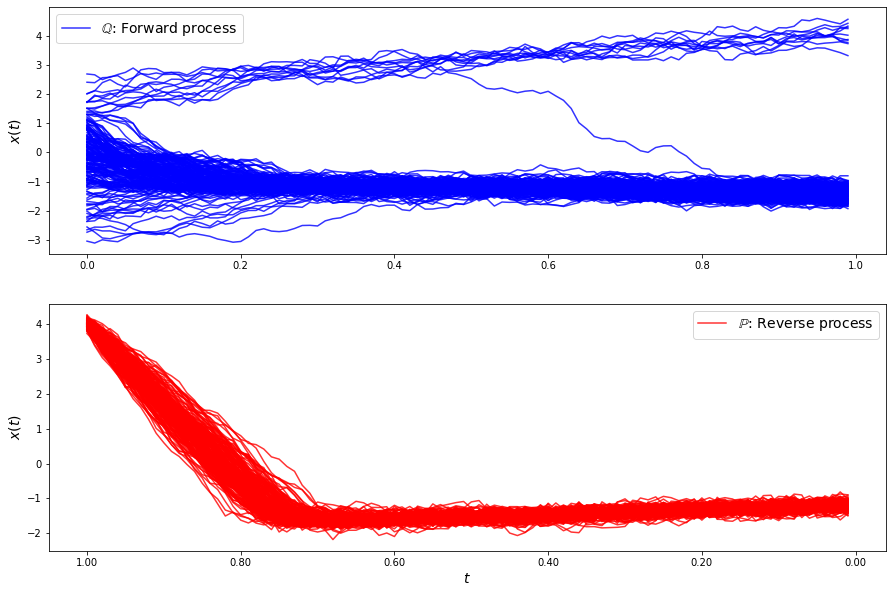

loss b 131.91820503721817
loss b 132.15926159370557
loss b 132.48166608635862
loss b 131.85716142029946
loss b 131.80550275311003
loss b 132.7616123332935
loss b 133.3708611460821
loss b 134.028579855149
loss b 134.73357157872059
loss b 134.7757220069129
loss b 134.69190911920683
loss b 133.8778301153381
loss b 131.8423281396373
loss b 134.59180138291876
loss b 134.30356465147256
loss b 135.49957472434352
loss b 136.08007150649806
loss b 133.25175230463626
loss b 134.36121169098573
loss b 135.59084115005743
loss b 136.04987547474303
loss b 133.92595030743936
loss b 135.73679200487013
loss b 135.09695610163732
loss b 136.65830247895303
loss b 138.58206488597855
loss b 137.22363922305468
loss b 136.56820971503532
loss b 136.93751984233296
loss b 137.45370177210646
loss f 1482.0658642599328
loss f 1498.0227777898347
loss f 1495.889467309101
loss f 1501.6328105342516
loss f 1514.9276958525738
loss f 1499.0229000722697
loss f 1514.861012965486
loss f 1486.7079009540212
loss f 1490.777895452

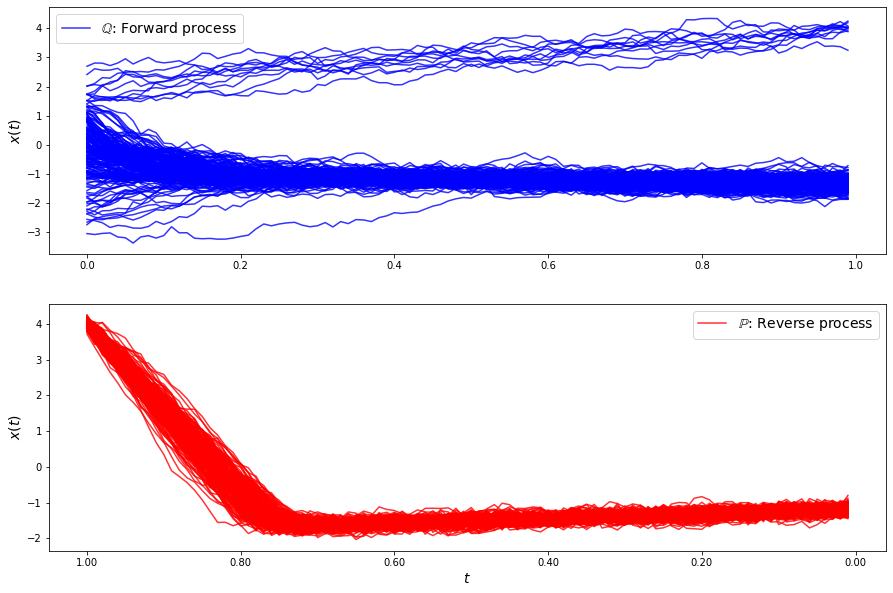

loss b 143.4705359753044
loss b 142.6969151538208
loss b 142.3109233319922
loss b 143.43091941592778
loss b 143.4900820157018
loss b 143.59229428515988
loss b 142.43687809165135
loss b 142.37943339705387
loss b 143.81050419935752
loss b 144.77265384374815
loss b 145.0162523862742
loss b 144.11595607419358
loss b 146.25204666078236
loss b 143.43300042317202
loss b 146.19101712136907
loss b 143.74780506980917
loss b 147.15211399418553
loss b 145.4461924678653
loss b 145.91338017051663
loss b 146.4487954264843
loss b 145.52200450578056
loss b 147.51529275353974
loss b 145.129712401656
loss b 145.20556502711216
loss b 147.09116124493318
loss b 145.23311014177455
loss b 147.5538391024803
loss b 145.47303348474412
loss b 146.66907255162891
loss b 146.60294884034587
loss f 1491.8686786416945
loss f 1494.756073292862
loss f 1472.4889715802126
loss f 1484.5668289577131
loss f 1500.5256596266474
loss f 1493.187767845556
loss f 1514.2524485728864
loss f 1500.7284892006307
loss f 1502.923696382298

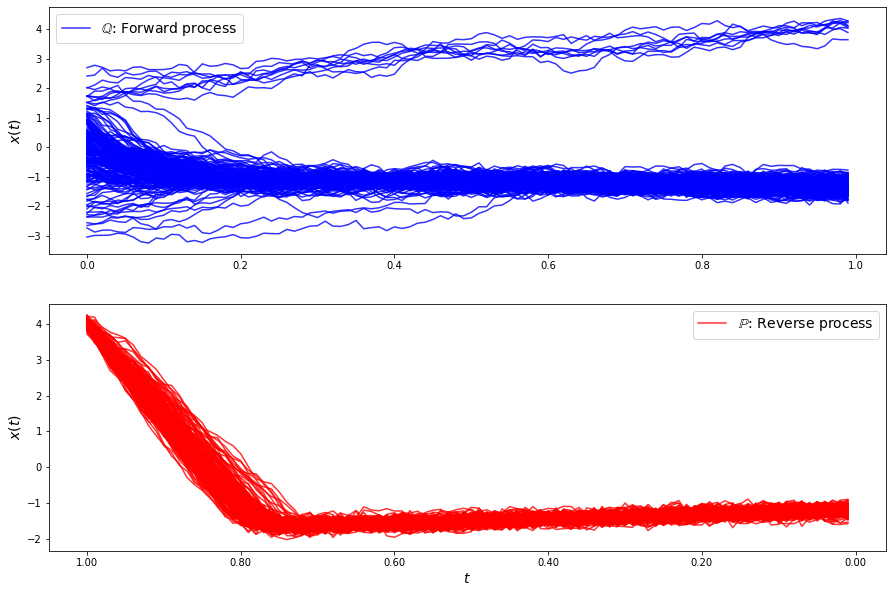

loss b 153.6845477913293
loss b 152.26942388234775
loss b 154.63577583213043
loss b 152.62721725655962
loss b 152.96680411177095
loss b 152.70196868740211
loss b 153.31652754789707
loss b 154.17457819270666
loss b 153.13593206529148
loss b 153.53793882181103
loss b 155.27042228267723
loss b 153.6309149710532
loss b 153.48982164314268
loss b 153.466497694403
loss b 155.66753491051793
loss b 155.139797450522
loss b 156.04258408250413
loss b 155.2150805253786
loss b 156.01604321756886
loss b 156.29107799395248
loss b 155.2603763878103
loss b 155.02731645051628
loss b 155.10958283788335
loss b 154.20048249577036
loss b 154.64928387259388
loss b 154.55932449445666
loss b 156.0021122211666
loss b 156.5534097377717
loss b 157.22894360420526
loss b 156.47370318490593
loss f 1512.420451596755
loss f 1513.5625804437968
loss f 1506.9375651013759
loss f 1494.2585847484413
loss f 1510.765586857754
loss f 1499.3817530092886
loss f 1507.5647114696992
loss f 1516.5353117705447
loss f 1497.297293601645

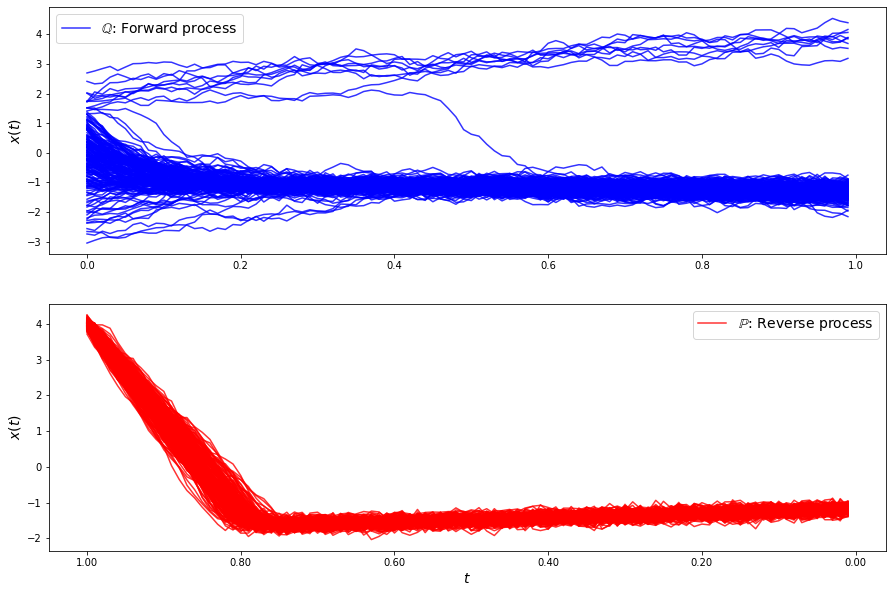

loss b 160.9149230152612
loss b 161.7493719310989
loss b 160.5242761606278
loss b 162.0017999066653
loss b 162.04007668624627
loss b 161.34619613934524
loss b 160.8971729399575
loss b 162.2061651348379
loss b 162.26489333707178
loss b 164.4018121160515
loss b 162.6669218068586
loss b 161.25805337665219
loss b 163.61151044821483
loss b 162.1498682183248
loss b 164.81827067503863
loss b 162.89555346877341
loss b 162.48618566266254
loss b 163.09092201218496
loss b 163.90817884935032
loss b 165.04001925367774
loss b 162.35034082828884
loss b 164.01428064186686
loss b 164.85484114141516
loss b 161.35028029500532
loss b 163.22482009711123
loss b 164.5184019129333
loss b 162.06818972070909
loss b 163.4164877874184
loss b 165.8304194582505
loss b 163.07285599606502
loss f 1502.1991124698134
loss f 1523.099009693535
loss f 1494.435245612244
loss f 1524.2677140956969
loss f 1512.2980650630345
loss f 1504.3987238356717
loss f 1503.2848990263674
loss f 1527.6554595437349
loss f 1515.9457681685149


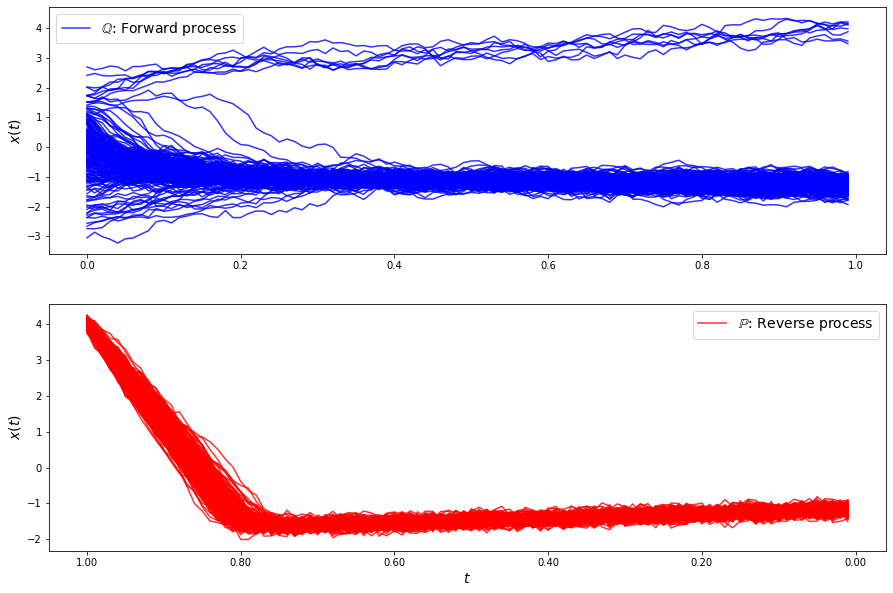

loss b 168.73126211338337
loss b 168.00830721887593
loss b 170.64646662759236
loss b 170.5936670017939
loss b 169.7658130441505
loss b 167.63995159359558
loss b 169.89865003175976
loss b 170.05884716956643
loss b 167.52002468246698
loss b 169.42926464892253
loss b 170.34360230403516
loss b 170.57601933946998
loss b 170.1244387740833
loss b 169.8461456157753
loss b 173.62793502174645
loss b 167.8518973034121
loss b 170.15848155342516
loss b 169.40995446483828
loss b 170.18834397822607
loss b 172.97195913924116
loss b 169.91204691997325
loss b 169.1310791735239
loss b 169.89376248306348
loss b 170.26314206109302
loss b 171.48349574317996
loss b 171.1338427824923
loss b 171.0483059988027
loss b 170.11932236760927
loss b 170.76248645621084
loss b 170.52199147191502
loss f 1509.9797190485288
loss f 1512.3010547232589
loss f 1499.302921350204
loss f 1507.0628534028656
loss f 1515.5037555246274
loss f 1505.4943862472403
loss f 1532.1847843551673
loss f 1525.6400689409377
loss f 1513.216276503

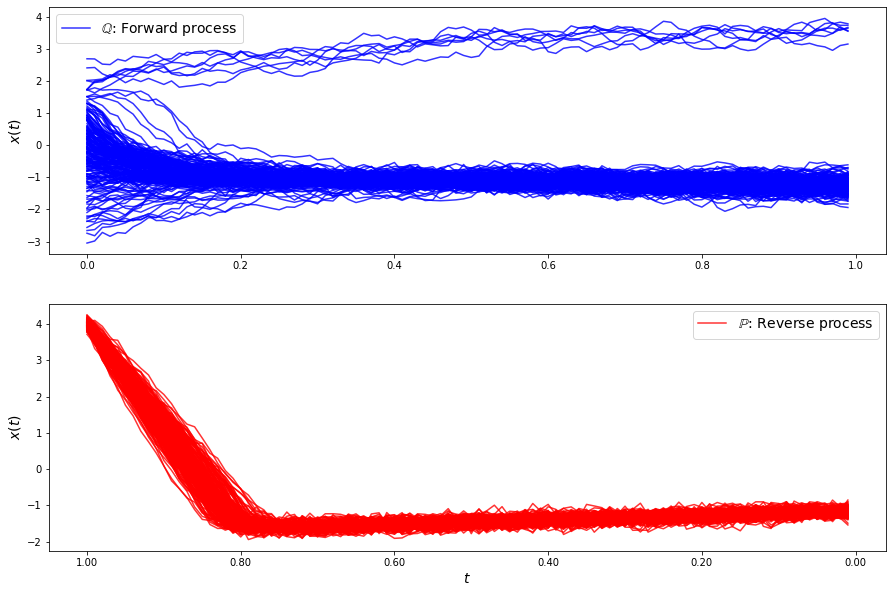

loss b 176.49503149956627
loss b 175.65659549610513
loss b 177.7563798843616
loss b 175.1585396432838
loss b 179.4484039441317
loss b 176.51796311315306
loss b 176.08625740361302
loss b 174.58570486408755
loss b 178.8305663857833
loss b 176.53719182289336
loss b 177.15883999683967
loss b 173.83234907897295
loss b 175.78251903243523
loss b 176.8563826782144
loss b 176.2055044020659
loss b 175.1225878086357
loss b 177.3142227223577
loss b 176.0485458748788
loss b 177.65381365268996
loss b 178.9466074480969
loss b 177.3257215810777
loss b 175.29523552271337
loss b 176.69915110375808
loss b 177.69926582743332
loss b 175.82798976212396
loss b 176.31742372441784
loss b 178.7984943011655
loss b 175.99036850798254
loss b 177.92410814861844
loss b 179.3883023037031
loss f 1503.1888282374455
loss f 1512.1100070857167
loss f 1547.0338692559874
loss f 1494.2938663077828
loss f 1530.3082744261067
loss f 1521.9023201478876
loss f 1514.4120202373872
loss f 1526.1421953035854
loss f 1528.493567340435


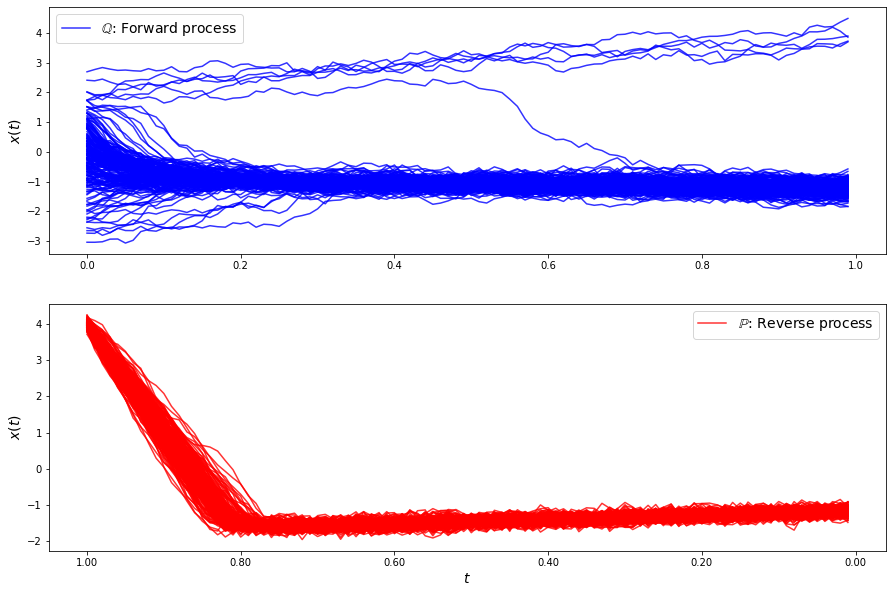

loss b 181.3462205557621
loss b 182.265893385084
loss b 183.30602546542315
loss b 182.35911766383725
loss b 181.94538108072172
loss b 183.6885527777235
loss b 181.3360713139448
loss b 181.05220025643501
loss b 182.41098806959462
loss b 182.70281997406724
loss b 182.15163190884724
loss b 183.2659313391107
loss b 181.78654059593583
loss b 183.5014757660682
loss b 182.9863937043343
loss b 181.01445153642317
loss b 182.84313139153485
loss b 181.81913939919937
loss b 181.08028133538008
loss b 182.91155069544482
loss b 182.2059617179492
loss b 182.5468791465813
loss b 182.19873978459793
loss b 181.39883550278435
loss b 180.46627899946677
loss b 182.70600950158055
loss b 183.2588193244383
loss b 182.1559528097434
loss b 180.8175810029196
loss b 183.19382153263422
loss f 1510.7989206643074
loss f 1531.6497822211875
loss f 1534.0809856452752
loss f 1516.7753310758228
loss f 1504.1875052537123
loss f 1525.4416850182938
loss f 1506.0785789326435
loss f 1538.6491215264605
loss f 1526.1884536246735

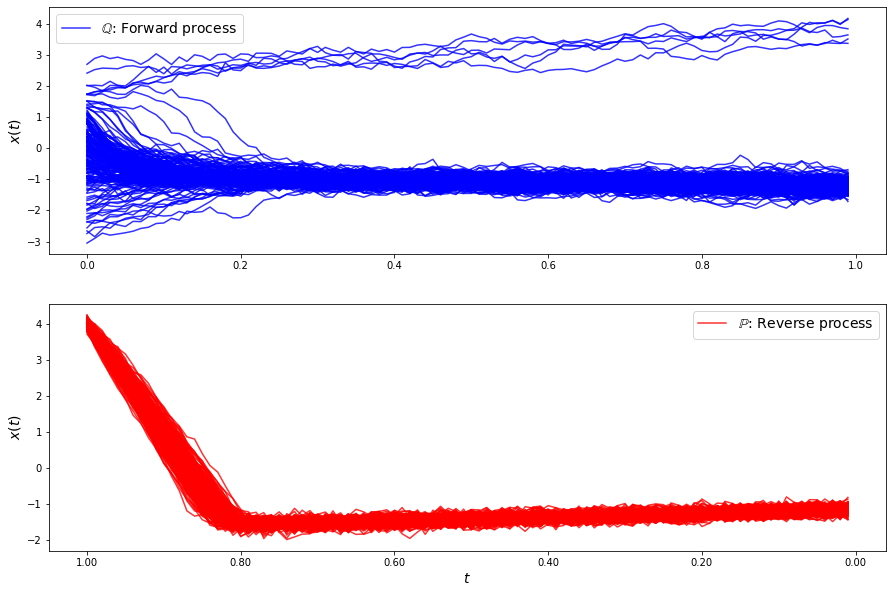

loss b 187.191673575199
loss b 187.86090142821624
loss b 188.6285296481102
loss b 187.43953289863447
loss b 188.77367222142337
loss b 190.28085754052822
loss b 187.02237074643742
loss b 186.46773086605694
loss b 186.59559709122428
loss b 188.87668329552605
loss b 187.69250015228766
loss b 188.20006919217425
loss b 188.21550319748098
loss b 187.71432030096898
loss b 189.29559717916382
loss b 186.39456988510176
loss b 189.9949550040869
loss b 189.36665965840365
loss b 185.46245053625898
loss b 189.00175147256843
loss b 186.9829753688375
loss b 188.2003861769861
loss b 187.77715716947282
loss b 188.511604644288
loss b 186.79698453842096
loss b 187.5388150461681
loss b 190.11334600362525
loss b 186.83857860593812
loss b 188.11386469688742
loss b 189.81898949774188
loss f 1531.9502207620521
loss f 1497.1142538296506
loss f 1533.177145754951
loss f 1508.466970873134
loss f 1505.1825792120878
loss f 1515.0687442856636
loss f 1512.8445269472809
loss f 1536.0213336995614
loss f 1545.43487451854

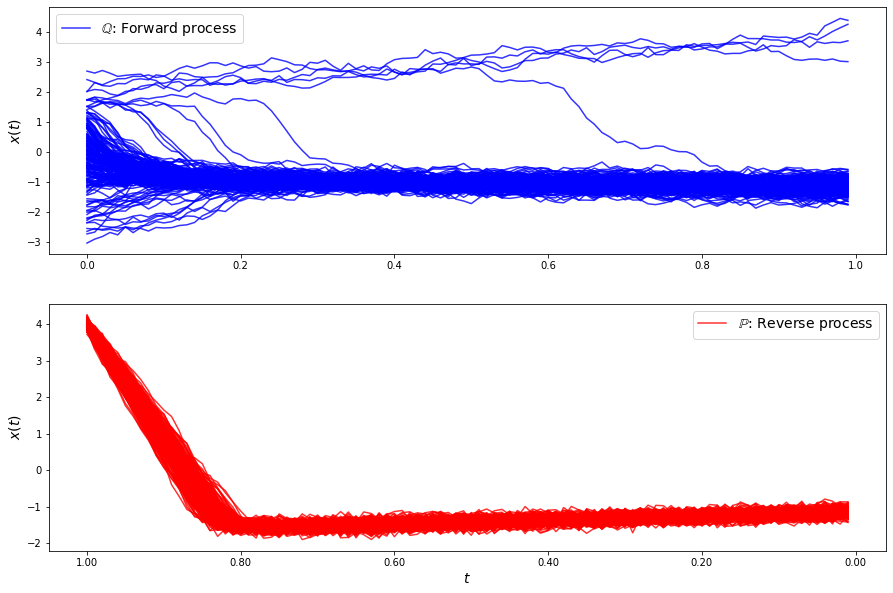

loss b 192.48361681188416
loss b 192.64983578771012
loss b 191.816333498483
loss b 194.90438617976304
loss b 194.863035460072
loss b 193.07694576164766
loss b 192.71149143589372
loss b 191.04715792514236
loss b 191.59679014452547
loss b 192.10558609619858
loss b 192.5688615175719
loss b 191.81199485035475
loss b 191.1208468014585
loss b 191.99710749847216
loss b 192.40034505760374
loss b 193.3190385350299
loss b 192.62886416530773
loss b 192.61479800500763
loss b 193.29762339003318
loss b 193.0073748819314
loss b 194.15231296287706
loss b 193.18809749646027
loss b 191.7975666251031
loss b 192.7845144844656
loss b 193.32476750367613
loss b 193.05979142577095
loss b 192.76416116343836
loss b 193.63504412760577
loss b 192.80538462838533
loss b 193.16579437300433
loss f 1519.0133779614575
loss f 1544.3672743220723
loss f 1536.4032061669227
loss f 1507.653345789216
loss f 1538.0869266932502
loss f 1523.8385402381746
loss f 1526.4288395713154
loss f 1534.2433268435725
loss f 1524.57624823427

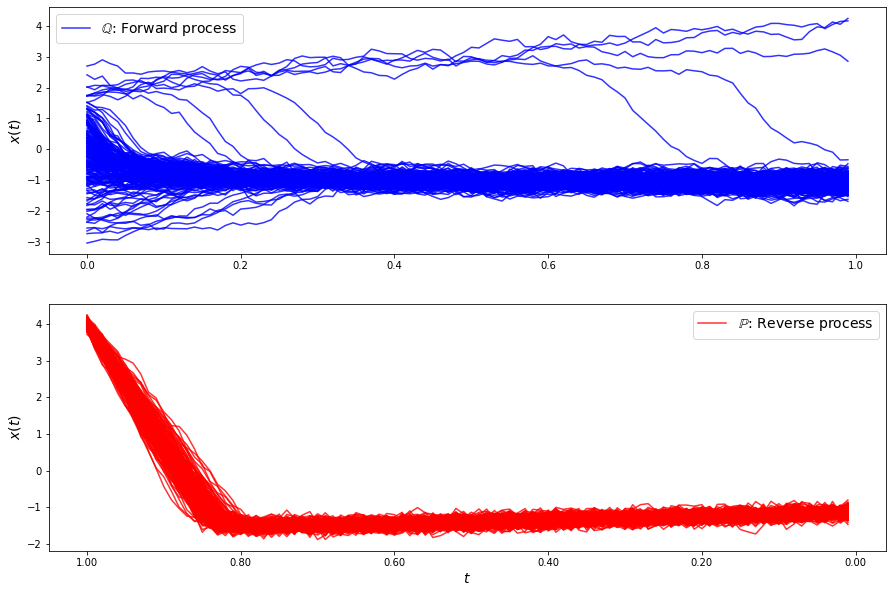

loss b 196.1886742712063
loss b 197.27430023761224
loss b 196.2822766392066
loss b 198.11962633019974
loss b 197.00178951402137
loss b 196.12648617618078
loss b 196.94779067186437
loss b 196.76448920447353
loss b 195.75897484806123
loss b 197.6534211154764
loss b 195.36222969669097
loss b 196.73646837357762
loss b 197.00941658536942
loss b 197.14806728093333
loss b 196.33078964179313
loss b 195.64106783757143
loss b 196.57143325862245
loss b 199.1216165859127
loss b 196.72294012431234
loss b 196.42860107327635
loss b 195.86492472267767
loss b 196.8479408960665
loss b 195.99383730371167
loss b 195.6413035007544
loss b 196.07219343909563
loss b 195.9114508287361
loss b 196.0379849330522
loss b 196.3483507094454
loss b 194.96189968898204
loss b 196.43483914334305
loss f 1513.032058076607
loss f 1516.020522305958
loss f 1538.7505957612523
loss f 1525.2504158965758
loss f 1522.5942743817848
loss f 1504.13954304819
loss f 1495.0331845740834
loss f 1521.6522548698688
loss f 1513.7365052101682

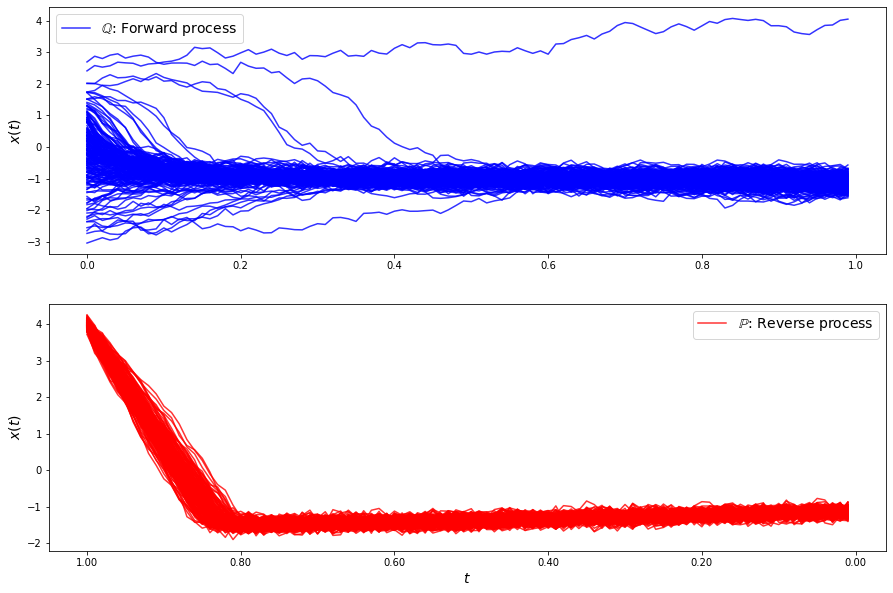

loss b 200.53303771142095
loss b 199.0505575359429
loss b 201.80902991720563
loss b 202.0343373221374
loss b 201.423304974146
loss b 200.30348899894304
loss b 202.04244567337506
loss b 202.00242626028455
loss b 200.2686756207396
loss b 200.89828854771187
loss b 201.6211564663574
loss b 199.0948826125942
loss b 200.51818953799804
loss b 200.35958015417242
loss b 202.20691737383484
loss b 199.6543860449156
loss b 199.5430230222336
loss b 201.86034204578388
loss b 200.52959433372772
loss b 202.27813048074648
loss b 201.96539481136747
loss b 198.337333883496
loss b 199.76705436762572
loss b 198.77781420464765
loss b 200.0486601958656
loss b 201.37788676260783
loss b 201.42899457929943
loss b 197.08174028182847
loss b 199.3423315304979
loss b 199.0128422317658
loss f 1513.7616425818155
loss f 1501.2776826810748
loss f 1505.0638214654728
loss f 1510.7132419660304
loss f 1518.6436518412645
loss f 1526.0601890210723
loss f 1523.771550700621
loss f 1524.1960700649502
loss f 1491.7511971293006
l

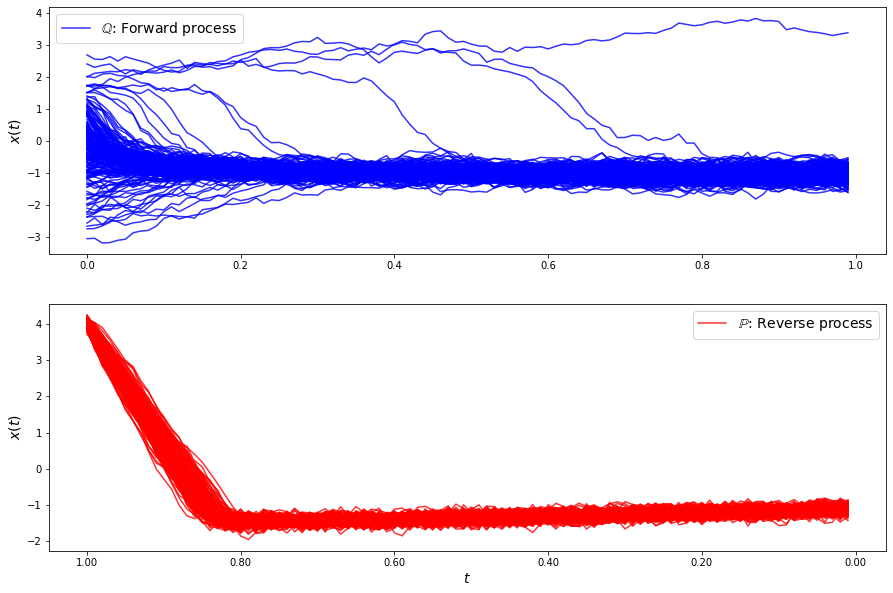

loss b 205.6117253216203
loss b 205.23183986053402
loss b 205.75548490874533
loss b 206.0070501805777
loss b 206.85523451095088
loss b 203.05786490976985
loss b 202.57382527386966
loss b 204.06857618890518
loss b 202.90527294573093
loss b 206.36979691696106
loss b 205.9073837241538
loss b 205.44419962425604
loss b 205.76585757167314
loss b 202.40398418307927
loss b 204.40079978670553
loss b 204.68333924581984
loss b 203.22888959639565
loss b 205.82331011268477
loss b 202.90412214629515
loss b 206.6161788991478
loss b 206.78556257977155
loss b 204.00285146054114
loss b 205.26868959705143
loss b 203.5058880053616
loss b 205.66136663755543
loss b 203.59783080520484
loss b 204.80929159204956
loss b 205.29648718362546
loss b 205.27233178352944
loss b 205.29929020248954
loss f 1508.4164190587546
loss f 1505.00427490831
loss f 1511.6997894692215
loss f 1507.9822168909398
loss f 1491.9358878780306
loss f 1522.0058412238404
loss f 1498.8661672395385
loss f 1490.9057546182062
loss f 1505.8646373

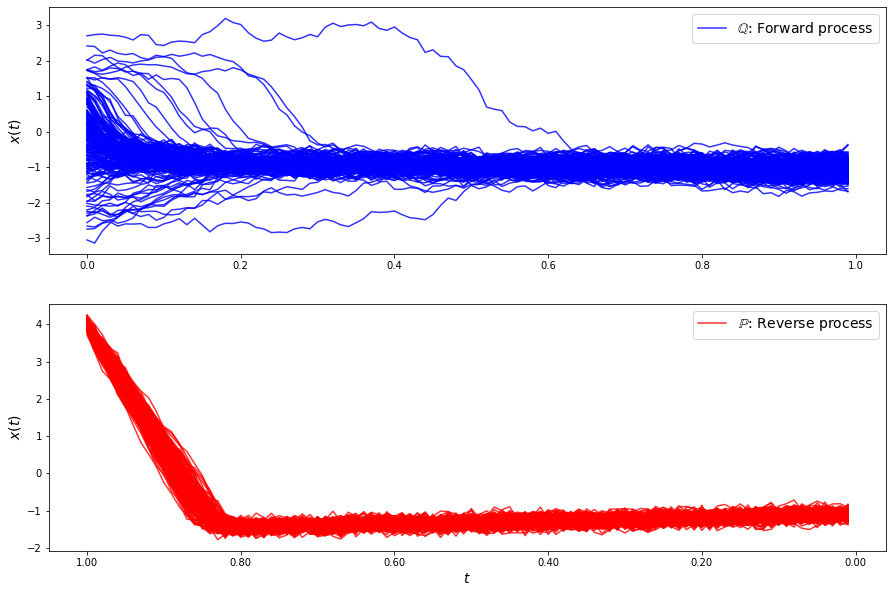

loss b 210.05275583719546
loss b 209.45468630271796
loss b 207.03857127406823
loss b 211.19668192122532
loss b 209.02973741518744
loss b 210.63094433645054
loss b 210.25474422071937
loss b 209.20807388282026
loss b 209.63944502067767
loss b 208.3485300570466
loss b 210.24277747113965
loss b 208.64250623505015
loss b 207.93713818810963
loss b 207.66794774539255
loss b 208.11953425858064
loss b 208.35971818212002
loss b 208.13497801236244
loss b 208.46630019061516
loss b 208.54539216394573
loss b 208.18060963255917
loss b 209.21645994657396
loss b 210.36886740551785
loss b 210.08620851691833
loss b 207.48963247173117
loss b 208.9579546634542
loss b 207.56050718077515
loss b 208.0889942465617
loss b 208.07285683010565
loss b 207.84069175198312
loss b 211.6746058712464
loss f 1481.3809846203974
loss f 1493.3164322450418
loss f 1492.4220827110466
loss f 1509.1991495898292
loss f 1479.1879667490962
loss f 1489.9037078043518
loss f 1500.0963958437392
loss f 1489.0999457420548
loss f 1489.2255

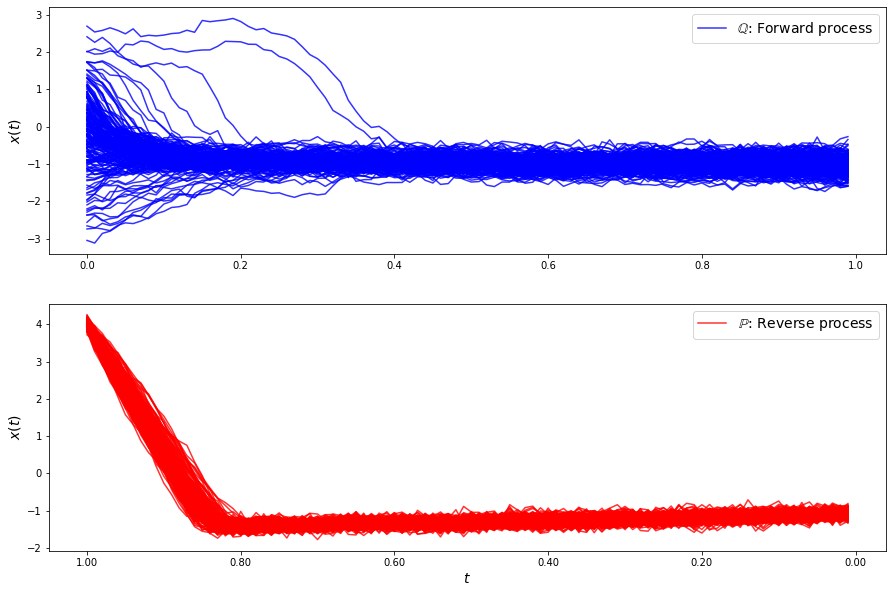

loss b 212.63218380500481
loss b 212.80848576489427
loss b 214.9190941803609
loss b 214.5246485820253
loss b 213.15547495358877
loss b 212.3646464967623
loss b 213.93058964151336
loss b 213.47498688248302
loss b 212.87637127960173
loss b 212.5678726117729
loss b 213.57564288370142
loss b 211.56907636340367
loss b 212.05460683780626
loss b 211.87548525285663
loss b 213.80738501488165
loss b 211.78556256251176
loss b 210.67355142085322
loss b 212.70248606947365
loss b 212.54826917025866
loss b 212.38579459570286
loss b 210.82877808067707
loss b 215.33866445572042
loss b 212.75600835418024
loss b 211.84105284291903
loss b 212.43642739494996
loss b 210.4787551830112
loss b 213.21005992745597
loss b 211.4971629092141
loss b 214.4013740128139
loss b 213.9979173461709
loss f 1469.6753355132025
loss f 1461.7496532787366
loss f 1473.6283793090854
loss f 1471.3206488374185
loss f 1480.3826661631779
loss f 1456.3366554570132
loss f 1472.4338568504386
loss f 1481.4777038613065
loss f 1481.71502666

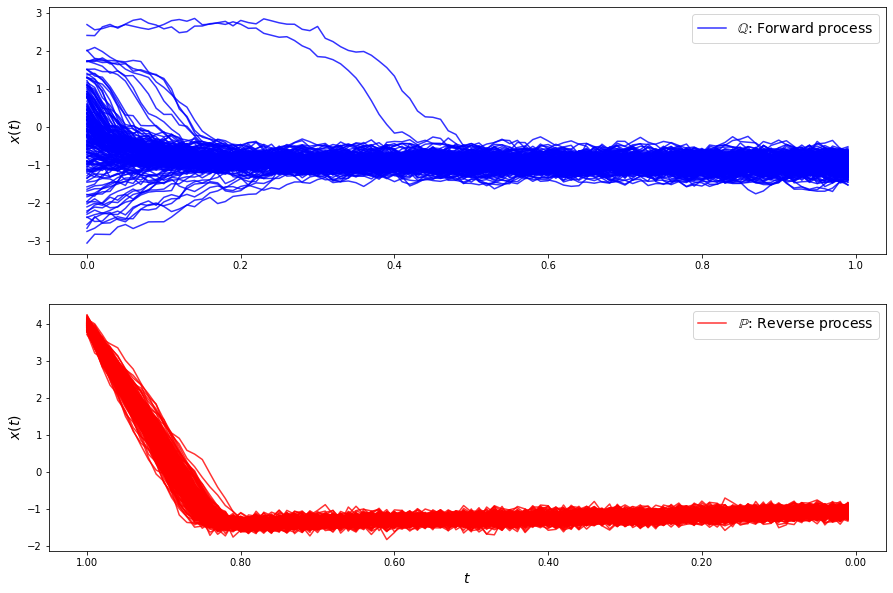

loss b 215.47130293834155
loss b 217.66732652157253
loss b 215.50780930371693
loss b 216.81070120287268
loss b 217.4146430376947
loss b 214.64678805552603
loss b 216.76053614606352
loss b 215.5812851309735
loss b 217.988286144911
loss b 215.755100973864
loss b 218.80910459175877
loss b 215.65250850602038
loss b 217.07031533614054
loss b 215.79765212402924
loss b 218.32631267724665
loss b 215.7378649103573
loss b 216.25301496294412
loss b 217.36394388532185
loss b 216.2129307777565
loss b 215.34370280006985
loss b 214.73689152204494
loss b 215.2568724168118
loss b 214.65906125479495
loss b 213.67457714237764
loss b 216.69667140676296
loss b 214.71663935412906
loss b 216.39813897553537
loss b 215.09804335646058
loss b 216.18129094649527
loss b 216.8478717799811
loss f 1452.6473360804434
loss f 1460.4186180306551
loss f 1448.2223434625894
loss f 1475.640824319066
loss f 1461.0879787020099
loss f 1466.8321983475596
loss f 1468.785761102482
loss f 1467.6574486268357
loss f 1468.768508831570

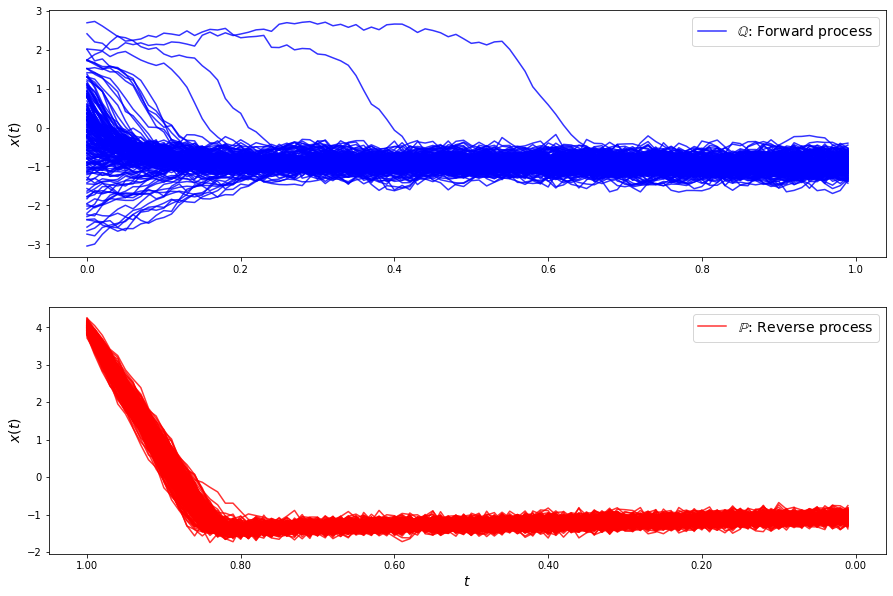

loss b 219.4342756685029
loss b 218.8988460176131
loss b 220.18070842861414
loss b 222.52324163977977
loss b 218.00578779736693
loss b 221.7355183654434
loss b 221.53077554928134
loss b 219.13769907334972
loss b 218.9016950886449
loss b 223.1851276332339
loss b 221.61266162566977
loss b 223.20139215642294
loss b 223.25295606723847
loss b 214.96300247517462
loss b 224.54962202084153
loss b 222.0377508330069
loss b 221.1206890528827
loss b 221.63653341701493
loss b 221.85357309566703
loss b 219.13213191015913
loss b 219.5319202430046
loss b 222.1877324401422
loss b 220.9839750886243
loss b 218.25442148230496
loss b 220.9755469840906
loss b 217.01726642501382
loss b 222.244253056069
loss b 219.51276840393498
loss b 219.66597839818516
loss b 220.60288915188553
loss f 1451.8272762465833
loss f 1464.0179324713204
loss f 1472.495358333421
loss f 1457.324429542174
loss f 1453.408705133452
loss f 1450.8460150468081
loss f 1464.5694082184327
loss f 1446.8321522113445
loss f 1465.8763048739777
lo

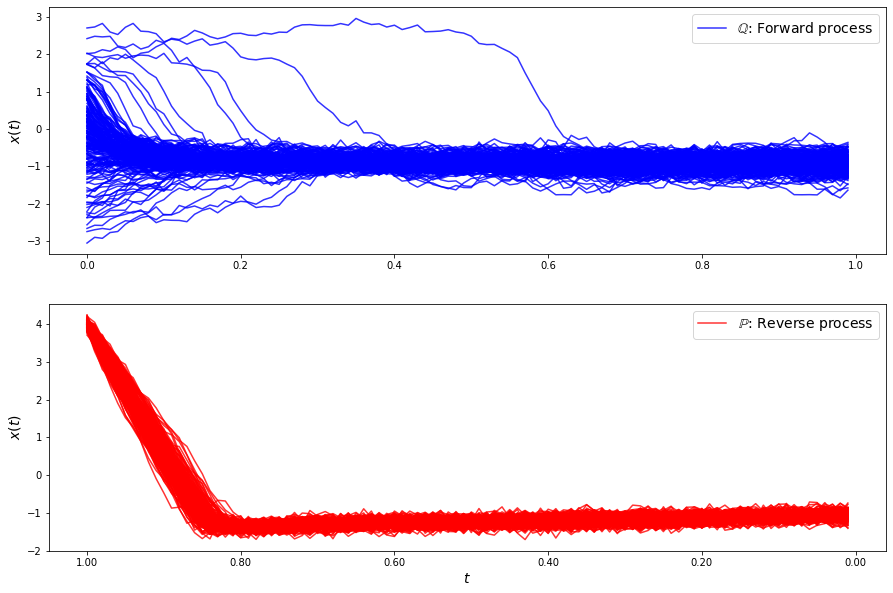

loss b 225.93902090414176
loss b 223.96057831325152
loss b 226.37046457894513
loss b 224.32487287213516
loss b 224.748119674802
loss b 225.3951121763083
loss b 224.2429783330394
loss b 224.96494282778337
loss b 224.87696916941906
loss b 221.60362003477323
loss b 225.0865979775891
loss b 225.01466481467276
loss b 223.6023008986724
loss b 223.40664103863136
loss b 222.7851873594935
loss b 226.7360625165712
loss b 225.0431249776897
loss b 224.14356091735883
loss b 223.47778098518947
loss b 221.91339615497566
loss b 224.84828601804125
loss b 221.71851707145296
loss b 225.0325554517634
loss b 223.7572010648066
loss b 226.2557721458065
loss b 225.12323766849627
loss b 223.99600802296342
loss b 223.48338511390676
loss b 224.6647431894766
loss b 223.83283409154959
loss f 1435.4861327214005
loss f 1448.2188454034883
loss f 1428.2724582410722
loss f 1453.826438356029
loss f 1441.9228046970895
loss f 1446.663003650989
loss f 1440.7966034209487
loss f 1458.9047071118493
loss f 1437.6376348463496
l

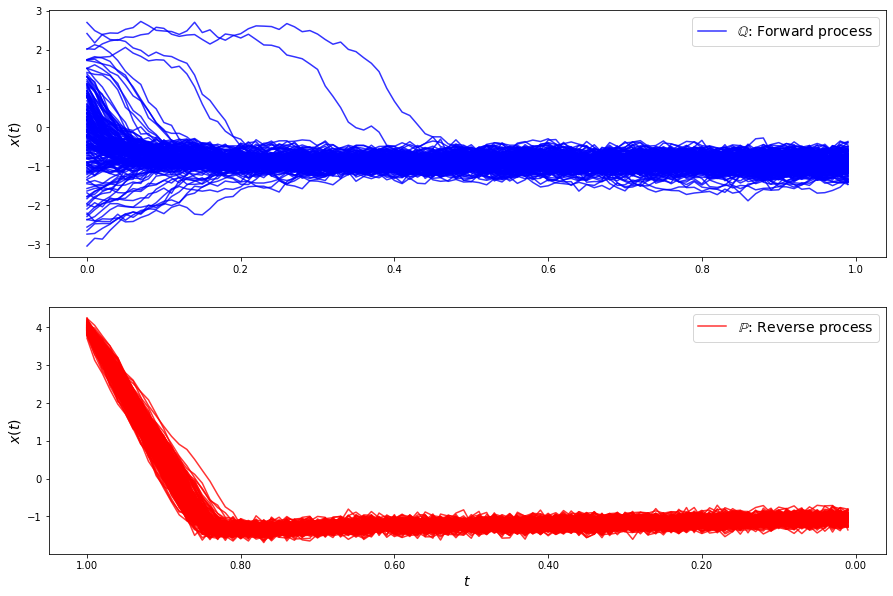

loss b 229.07987568833013
loss b 231.53637002399864
loss b 226.9981556218445
loss b 229.77677501848012
loss b 229.04442771721713
loss b 228.57776240405283
loss b 227.53762321635378
loss b 231.0384331536904
loss b 228.91221217326373
loss b 228.07367303798594
loss b 226.94716455105285
loss b 226.1143778517257
loss b 227.42712820119917
loss b 229.04510062168774
loss b 227.10945631193118
loss b 228.94011104830085
loss b 227.11959288246118
loss b 231.6013749059818
loss b 229.4632808007045
loss b 226.8186820509676
loss b 228.7763304471331
loss b 228.77945016512703
loss b 228.4182653667326
loss b 229.98859513272518
loss b 229.53943320473863
loss b 229.3008133746257
loss b 229.95651494277635
loss b 228.0740532592279
loss b 231.0336143725468
loss b 229.15553547016043
loss f 1436.6940332642407
loss f 1441.278904263416
loss f 1424.894221090121
loss f 1440.8463994785584
loss f 1442.5573908488668
loss f 1417.7078586803232
loss f 1433.044890833377
loss f 1430.699094254379
loss f 1444.7101467463233
l

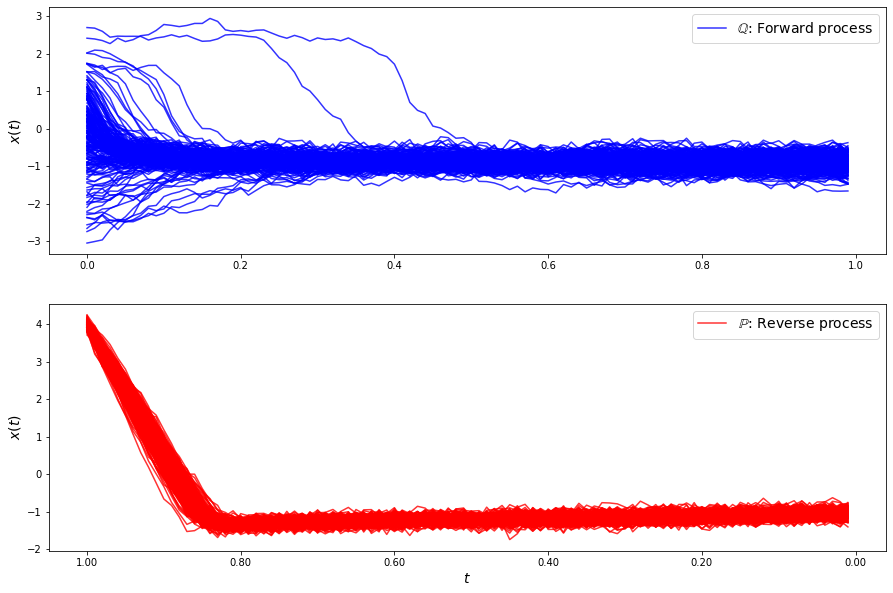

loss b 234.66504957982877
loss b 233.076017166639
loss b 232.6148980786499
loss b 231.4513989146039
loss b 233.4383910344353
loss b 237.20406086597015
loss b 232.9277647873346
loss b 233.37360485595934
loss b 234.30774761257032
loss b 233.02451485230148
loss b 233.79975583698828
loss b 234.6267913735225
loss b 232.939174281069
loss b 231.89558000727087
loss b 232.581185848816
loss b 233.95771030076205
loss b 234.17224334461542
loss b 232.87353672184844
loss b 232.02653148244605
loss b 233.4170614562587
loss b 231.61335806714501
loss b 235.42127302647566
loss b 231.13880675911395
loss b 230.769374306564
loss b 232.64991372178136
loss b 232.3620456266863
loss b 232.82404333176774
loss b 233.37481419431566
loss b 232.3930496333722
loss b 232.24241268631064
loss f 1398.7093322842986
loss f 1426.8138533310103
loss f 1409.6837966471749
loss f 1432.906126546247
loss f 1404.2149313938583
loss f 1416.7392998856924
loss f 1420.1095361077435
loss f 1410.6647158148176
loss f 1413.7474312350785
los

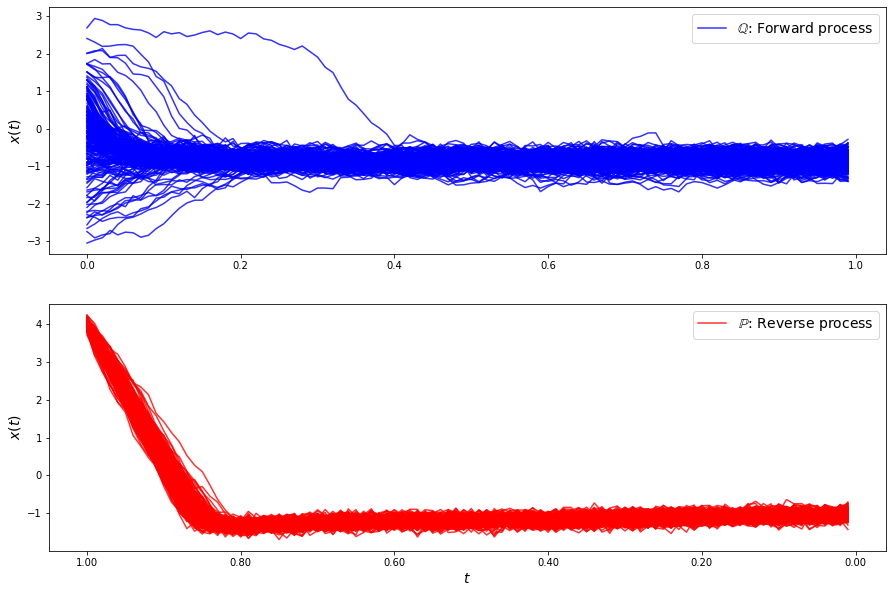

loss b 237.13590725776243
loss b 237.81123423124527
loss b 236.6768881819863
loss b 238.72357309906633
loss b 236.35714019754857
loss b 238.23585157600775
loss b 236.60652678394663
loss b 235.4827801141459
loss b 237.80720101647765
loss b 237.47739083865213
loss b 236.77609052998838
loss b 239.06052043472522
loss b 235.47225596129303
loss b 239.10935482948923
loss b 236.99054932104588
loss b 236.51842246709484
loss b 237.21638250653723
loss b 237.47104430269837
loss b 235.11214777909032
loss b 235.65327864342387
loss b 236.44423212875157
loss b 236.0783297389214
loss b 237.6858544846248
loss b 237.87049436498057
loss b 236.3096863870518
loss b 237.54997475580757
loss b 237.4001236803934
loss b 237.12029238492298
loss b 234.66428614186924
loss b 236.9460032557117
loss f 1410.8444245822539
loss f 1425.3645965758026
loss f 1425.6528906380493
loss f 1391.8287724932632
loss f 1408.9613047984164
loss f 1390.0513332399305
loss f 1420.0013072372894
loss f 1411.324323206254
loss f 1413.61624107

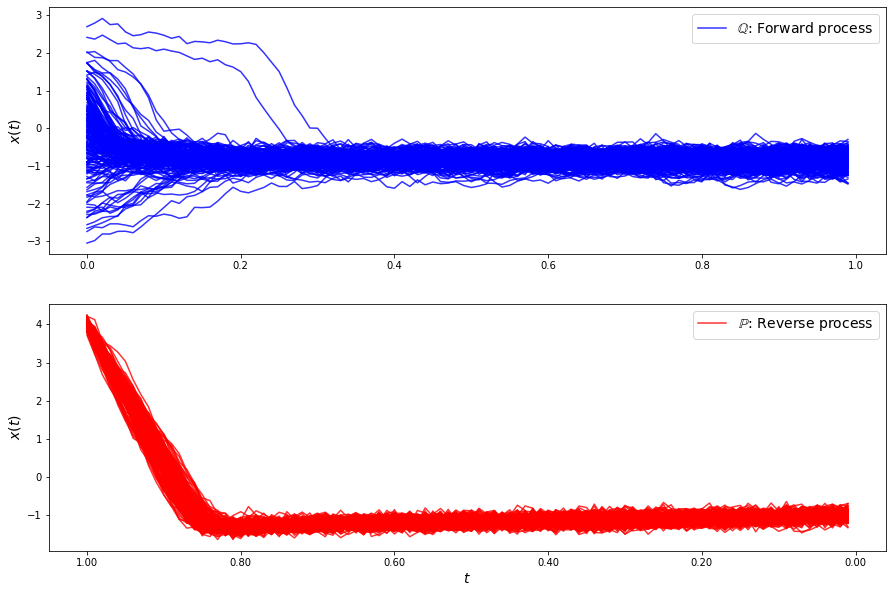

loss b 240.05267278416545
loss b 241.3692576140146
loss b 240.0018765400139
loss b 241.1996716930707
loss b 240.44734293477612
loss b 242.07064135170629
loss b 241.8751552150883
loss b 240.33388671900468
loss b 241.62874321379874
loss b 240.16159055602992
loss b 238.58034427931798
loss b 241.27594545932865
loss b 237.43332868759583
loss b 240.34500622174374
loss b 241.42198054196098
loss b 241.69926369791702
loss b 241.98852845793866
loss b 238.19291991050352
loss b 239.67485337152843
loss b 236.86634167565143
loss b 236.5702413178539
loss b 239.5888329472367
loss b 239.49897648870115
loss b 241.20946475855018
loss b 240.23572787272872
loss b 240.3285287854185
loss b 242.0201505492319
loss b 240.4284809121978
loss b 241.05212157074274
loss b 243.49121153999346
loss f 1391.543356905699
loss f 1407.8514284216092
loss f 1397.7849795490295
loss f 1387.5525219208014
loss f 1411.7006554845916
loss f 1385.3606150949088
loss f 1404.7396800672782
loss f 1382.2710215557615
loss f 1388.8064142020

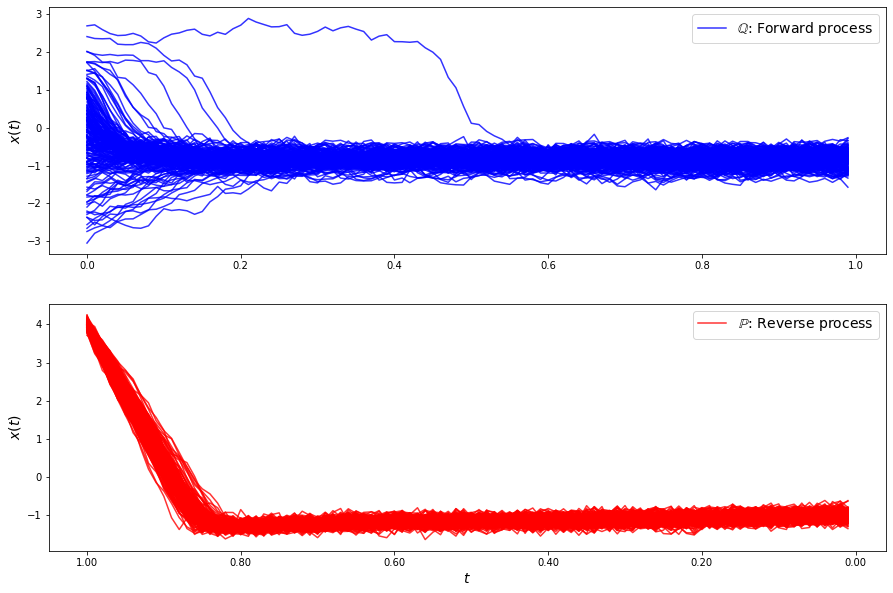

loss b 246.97880797058377
loss b 243.98859853422007
loss b 242.77349952570808
loss b 244.04774245979587
loss b 245.96091749527247
loss b 244.08408346451193
loss b 243.84292155741778
loss b 244.0320528316662
loss b 244.38439756868087
loss b 244.6835015957698
loss b 245.145154973359
loss b 243.56983102189503
loss b 242.46648810646846
loss b 243.52684170002152
loss b 239.81675544949925
loss b 243.35199994401893
loss b 242.67773987851882
loss b 244.59051455337257
loss b 239.99075978542538
loss b 245.36991996228986
loss b 244.1898332884227
loss b 242.62683817652766
loss b 242.05019099375443
loss b 240.94939704956855
loss b 242.35558836282274
loss b 243.69726143304402
loss b 242.14217124614413
loss b 242.78757670373108
loss b 243.02756662334352
loss b 243.0677612322381
loss f 1362.2568146218202
loss f 1379.1964367593655
loss f 1380.7430936883654
loss f 1372.4689422701904
loss f 1395.8418814674565
loss f 1395.6772726745487
loss f 1384.8735539186641
loss f 1378.9087327426098
loss f 1380.648494

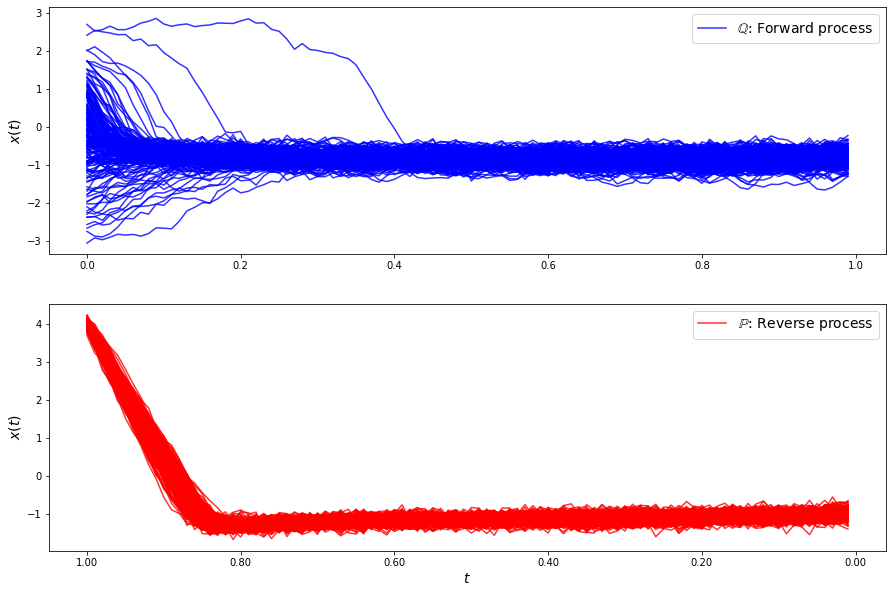

loss b 246.40201654075545
loss b 246.29593614748953
loss b 245.87986386349792
loss b 246.2490952224703
loss b 247.0327846168009
loss b 249.35157038056104
loss b 248.07364540808882
loss b 246.87590973398014
loss b 246.68888654263162
loss b 244.1892685659065
loss b 247.24101185804332
loss b 246.84158134772105
loss b 248.83571232754701
loss b 246.2849919670792
loss b 245.23599962064895
loss b 248.0324114360432
loss b 248.46797449855723
loss b 245.88853093924945
loss b 246.6637727747201
loss b 247.205879501862
loss b 245.24005712615696
loss b 246.48092860125595
loss b 244.67989568419588
loss b 243.57388329646008
loss b 246.4436303285604
loss b 243.3987093504059
loss b 246.31361491734634
loss b 243.77349278655097
loss b 244.38658702281492
loss b 246.5199089614377
loss f 1366.4793608888956
loss f 1360.9030705034668
loss f 1358.9210355559455
loss f 1368.4817828388377
loss f 1347.8296209141797
loss f 1361.0874090156924
loss f 1368.9222356238558
loss f 1360.773149726286
loss f 1373.857154228254

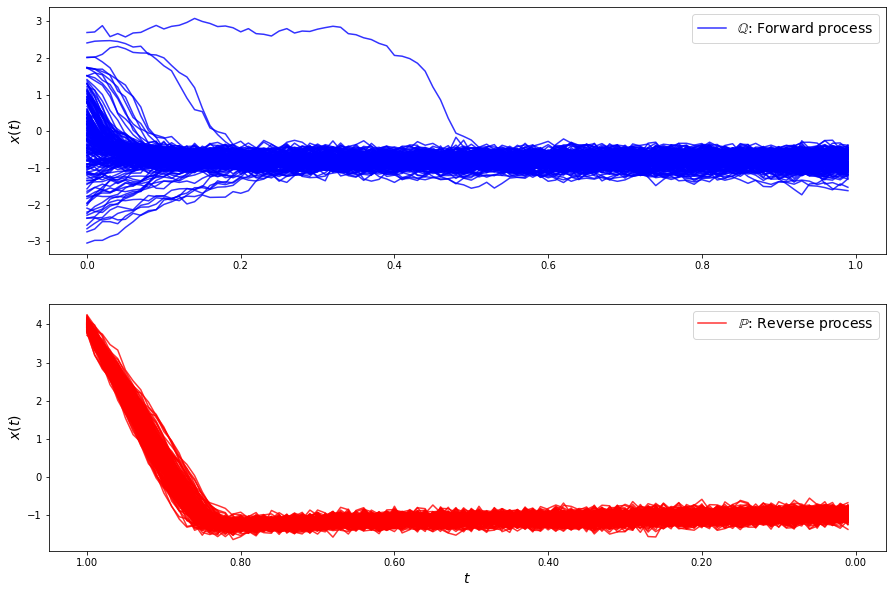

loss b 248.6539896898119
loss b 249.3943059485225
loss b 249.2941069149067
loss b 251.90732961121032
loss b 250.0012343807989
loss b 248.28507376600407
loss b 249.56396704193128
loss b 248.06638703917338
loss b 249.51249946509512
loss b 249.10958591046762
loss b 252.3181470575459
loss b 249.49198457611126
loss b 250.16517947531727
loss b 249.9592718283598
loss b 248.17198622946643
loss b 248.1550326068984
loss b 248.93231806823948
loss b 248.42935608067006
loss b 250.58671237725562
loss b 247.59480775631098
loss b 247.67708156020518
loss b 244.7383664137886
loss b 249.98836899030573
loss b 248.02296817405013
loss b 250.4417108030524
loss b 248.6048285374326
loss b 248.92124431825818
loss b 249.67998418868996
loss b 249.29571861135125
loss b 248.37400457627538
loss f 1350.1474236451077
loss f 1355.9042927845585
loss f 1347.4981962556599
loss f 1351.1566871982288
loss f 1350.6586866499415
loss f 1341.347774152932
loss f 1347.977166128305
loss f 1362.566397181728
loss f 1350.831765500946


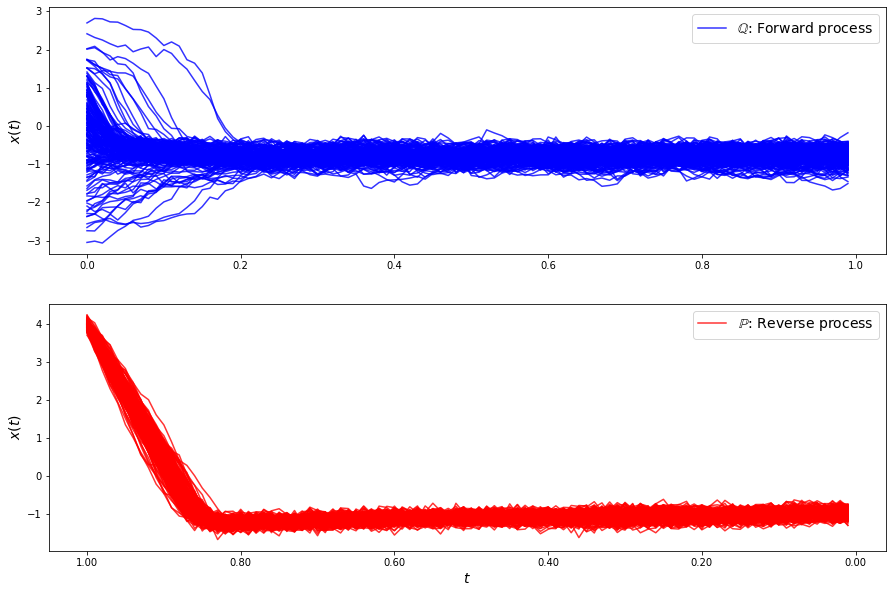

loss b 254.85928581541089
loss b 252.86437932432264
loss b 250.9830695335664
loss b 254.15310861680018
loss b 252.96063174246405
loss b 250.1434095168334
loss b 251.81292093076874
loss b 251.1268424858736
loss b 252.83424874567046
loss b 251.69350071070312
loss b 251.19671068486932
loss b 251.91413900453833
loss b 251.33006038403215
loss b 249.94432065408807
loss b 251.16741114424747
loss b 253.35240992852886
loss b 251.11826812805046
loss b 251.2886324660405
loss b 254.80640932874633
loss b 250.25429213454856
loss b 252.11052636687472
loss b 250.8150937478268
loss b 251.24949656082526
loss b 252.13277279398457
loss b 250.82099726155326
loss b 251.2505503896587
loss b 252.25754517897835
loss b 253.72793710036436
loss b 251.07380473191716
loss b 251.54803617635332
loss f 1345.3777089389107
loss f 1338.8359296888434
loss f 1346.133872975227
loss f 1342.3410385757463
loss f 1339.564812930326
loss f 1333.5553753155452
loss f 1341.8304407500218
loss f 1342.6262227069888
loss f 1332.77254543

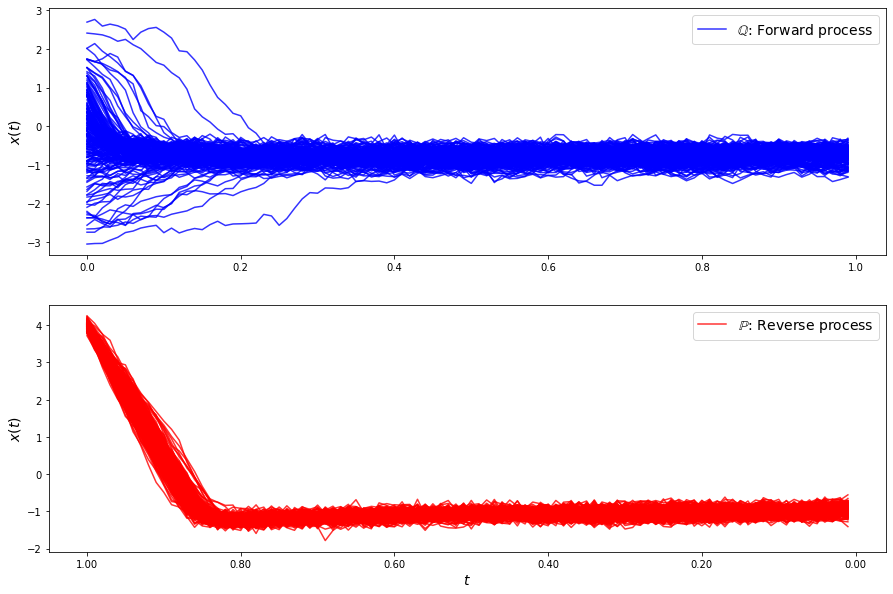

loss b 254.22975073422856
loss b 258.5482406520236
loss b 257.3389297714112
loss b 255.6961332454331
loss b 252.62154345387532
loss b 254.74687489508213
loss b 254.5969429366492
loss b 253.88596166412876
loss b 256.3906170898623
loss b 256.634992742307
loss b 259.0373788214228
loss b 256.0895761419145
loss b 255.8457647750562
loss b 254.40056371583674
loss b 255.2257007297647
loss b 254.32507552999078
loss b 253.1489146743976
loss b 252.4416134293925
loss b 253.22329750901324
loss b 255.50524946875024
loss b 254.6452029385593
loss b 255.11855698500705
loss b 253.55938645065666
loss b 254.80786885163943
loss b 255.0358580618737
loss b 255.32601295568398
loss b 253.85688202913892
loss b 252.26402942019934
loss b 254.06856231412502
loss b 254.19249536008928
loss f 1317.8210501903186
loss f 1330.4854670631053
loss f 1317.1668974958106
loss f 1308.8835923679706
loss f 1319.1260932297866
loss f 1320.853058949357
loss f 1312.9490906635635
loss f 1312.602917926244
loss f 1315.4587131097956
los

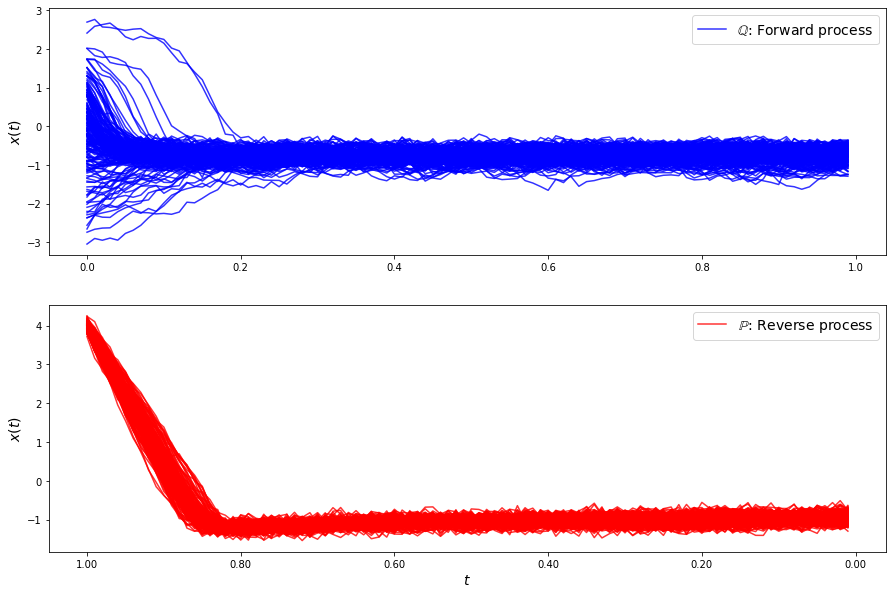

loss b 261.2103060876212
loss b 261.5607255946067
loss b 258.87524042672635
loss b 257.48209870446686
loss b 256.77689628657225
loss b 258.83996419616767
loss b 258.22472606364096
loss b 258.27552595078436
loss b 257.6331537398169
loss b 258.2860675016745
loss b 260.04795290290025
loss b 258.99392347342445
loss b 257.05000195987964
loss b 255.5705513919289
loss b 255.86928653711496
loss b 256.52355947105883
loss b 256.241772887151
loss b 256.52314561351164
loss b 256.1165836838389
loss b 257.78910164492686
loss b 255.19281589428758
loss b 257.18334835028077
loss b 257.0857236859526
loss b 256.77974771114896
loss b 257.01960483282073
loss b 252.55385051732978
loss b 255.7966769100844
loss b 255.84323595701983
loss b 256.9396060412803
loss b 256.20975229368736
loss f 1303.2988329260752
loss f 1302.9470703374238
loss f 1300.5282801230612
loss f 1299.0653664945194
loss f 1306.341025448732
loss f 1297.11952599802
loss f 1302.3713356225808
loss f 1289.6735454116968
loss f 1306.0760775295926


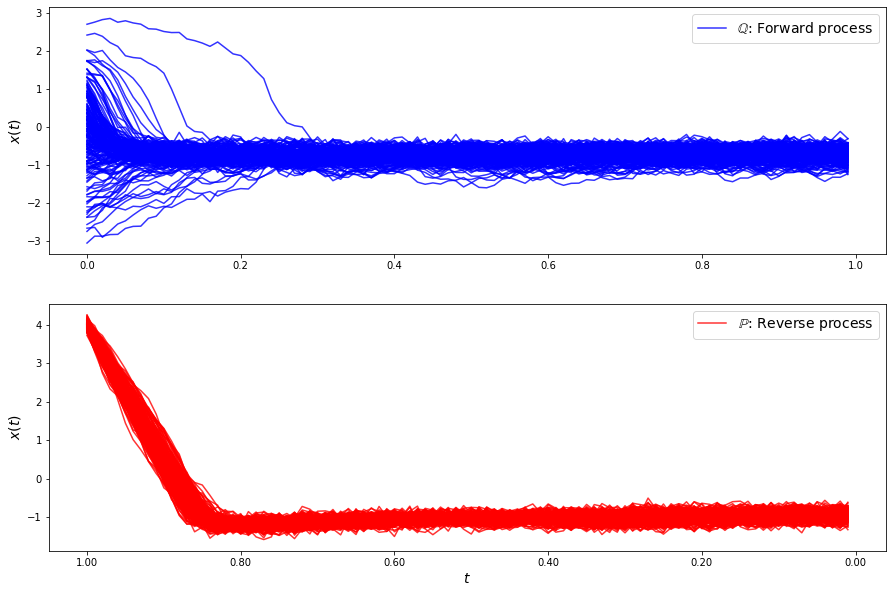

loss b 262.8327455845109
loss b 260.1080892000791
loss b 260.18442028866536
loss b 259.1569016372763
loss b 261.16307649619296
loss b 261.9485203123342
loss b 258.529982986811
loss b 262.3124306438366
loss b 259.97683060965795
loss b 259.6941650785483
loss b 259.93505184600684
loss b 261.234205453864
loss b 260.8801323527973
loss b 259.95616755562776
loss b 259.06060577540626
loss b 260.1084090792441
loss b 260.6267335147275
loss b 260.03210362934686
loss b 258.6713183634832
loss b 261.37210727865585
loss b 259.68347615769017
loss b 257.84725965310327
loss b 262.59211937901114
loss b 259.8139873614343
loss b 258.22601380037287
loss b 259.28328692988515
loss b 259.019361013079
loss b 257.7303913484177
loss b 258.2766641412358
loss b 260.3700995711457
loss f 1276.3955973305547
loss f 1285.1543890274781
loss f 1284.6576028003035
loss f 1291.1266153135327
loss f 1298.400187956414
loss f 1278.336958812952
loss f 1284.0714686694957
loss f 1288.4020656842545
loss f 1286.1341114346899
loss f 1

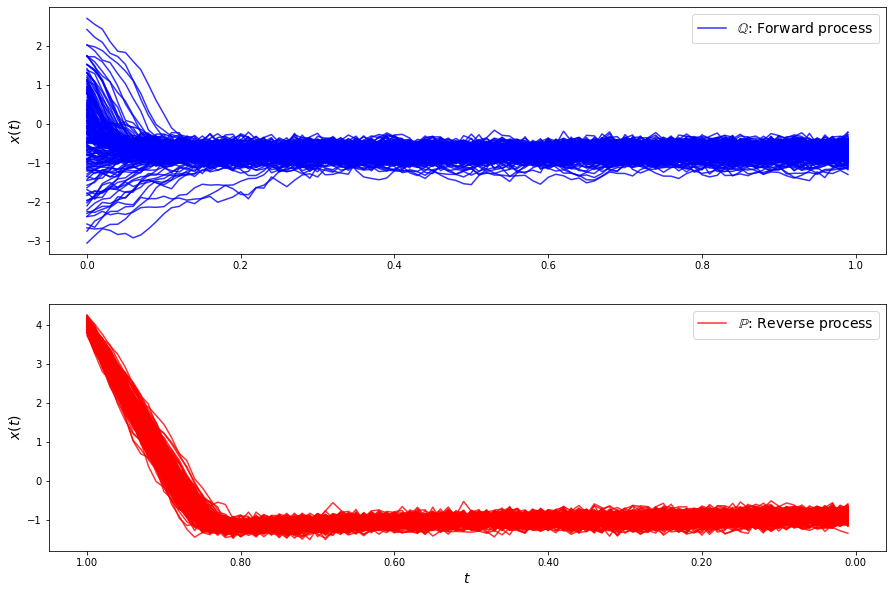

loss b 260.04604046416847
loss b 264.5801028561177
loss b 263.83586080518023
loss b 263.5589269187903
loss b 263.1446052786507
loss b 264.2146113762156
loss b 263.5931506174772
loss b 260.4628361622361
loss b 260.3784472081128
loss b 263.0761090511049
loss b 264.75171185693665
loss b 266.38581815163127
loss b 264.2291233364298
loss b 264.8616084594013
loss b 265.1691081521834
loss b 266.80451077058194
loss b 267.23204116937796
loss b 260.9827463239024
loss b 261.73432159225564
loss b 262.01743124804455
loss b 261.03545238564465
loss b 265.3542148454678
loss b 263.46972987286483
loss b 260.4510755029723
loss b 259.1389956872698
loss b 265.07951221575576
loss b 261.66967019966654
loss b 263.66310856657793
loss b 264.22417469349875
loss b 263.23114935335735
loss f 1279.7853641221213
loss f 1281.3440283636564
loss f 1279.6825440959958
loss f 1276.3386517418335
loss f 1281.3056239472262
loss f 1263.748309390123
loss f 1270.654786598153
loss f 1267.8502467238725
loss f 1274.3943094530616
los

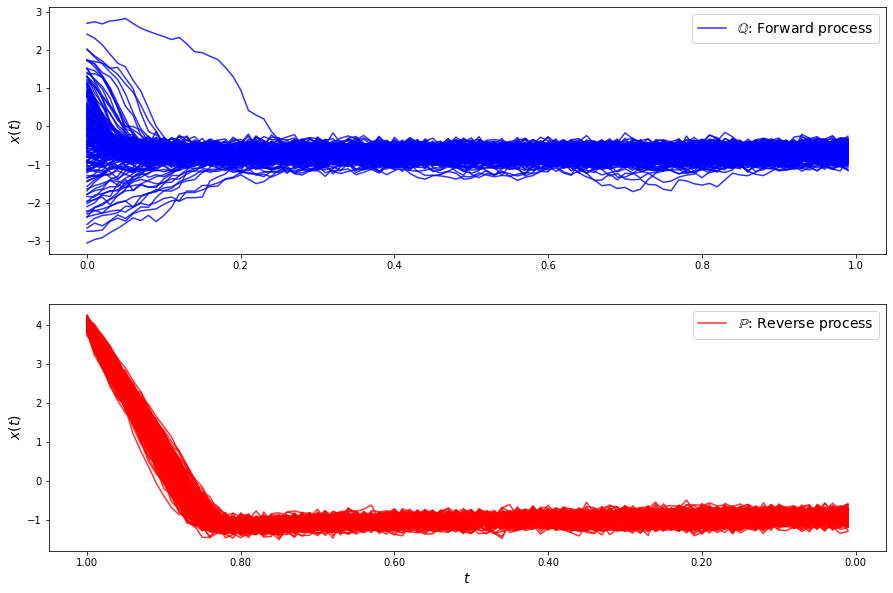

loss b 265.61783156574023
loss b 268.68103412462636
loss b 268.0621484716329
loss b 266.14092287316237
loss b 267.8038511769815
loss b 270.24411847385693
loss b 266.36221513177594
loss b 267.40424453175706
loss b 265.46910376249366
loss b 267.00302418782076
loss b 267.81629149251035
loss b 267.13469848721337
loss b 266.0621576529249
loss b 264.50407461687337
loss b 265.5618947556364
loss b 264.2030291928381
loss b 268.7857865282024
loss b 265.9088563242109
loss b 267.9342669367179
loss b 268.0452119278575
loss b 268.7267851209274
loss b 267.18382105458244
loss b 267.6803960405878
loss b 265.71464395559536
loss b 266.540334801254
loss b 265.3677173873506
loss b 266.59453747939614
loss b 267.56866400436417
loss b 265.4366115152449
loss b 268.2521605432837
loss f 1259.7203986220761
loss f 1258.7900099440656
loss f 1247.6292230558277
loss f 1259.7082048781153
loss f 1259.3897037667086
loss f 1259.9649195093648
loss f 1249.809888749282
loss f 1249.3845252136198
loss f 1259.6514169896184
los

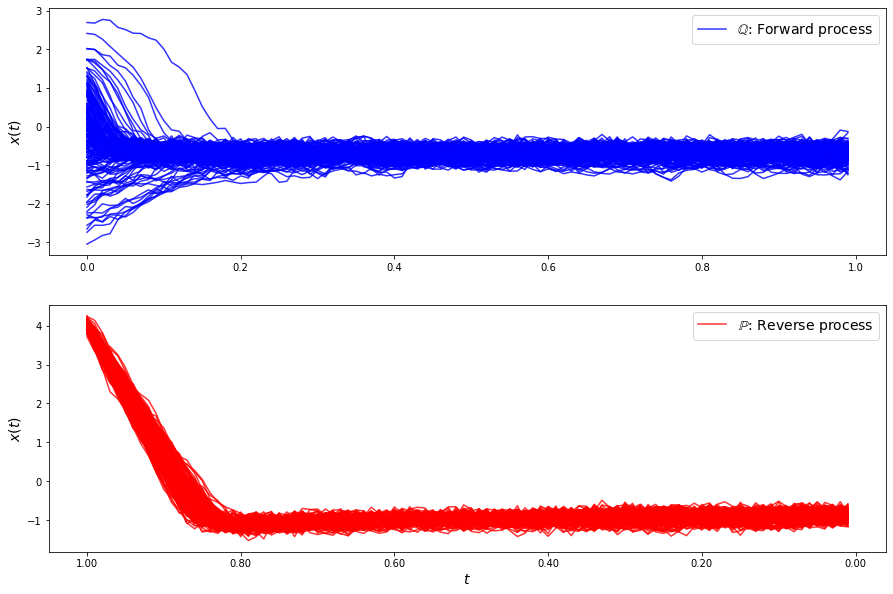

loss b 269.1242389301752
loss b 271.76352635936126
loss b 269.03193487737076
loss b 268.00393861599673
loss b 267.7835834280952
loss b 269.9789775298567
loss b 272.36277740096386
loss b 270.09717345719275
loss b 268.5139643549581
loss b 271.1260527511363
loss b 269.9699161188672
loss b 272.6486390393021
loss b 270.7060473665538
loss b 265.21584787067127
loss b 268.38389991514447
loss b 268.8989165248233
loss b 271.5494672083961
loss b 268.1145424930194
loss b 268.1966735591475
loss b 269.3295416074262
loss b 269.6171556564087
loss b 269.66268917350106
loss b 269.88903776632503
loss b 268.4669057345602
loss b 269.8830546043724
loss b 267.5573125144377
loss b 267.92568892680896
loss b 265.5895594027884
loss b 266.96956071926706
loss b 269.7925497483554
loss f 1240.0841357313943
loss f 1240.7323820711856
loss f 1244.7000434932095
loss f 1243.8275967451145
loss f 1242.493206591621
loss f 1244.2352338507753
loss f 1235.9885956789296
loss f 1243.4511839494292
loss f 1246.4963227141172
loss f

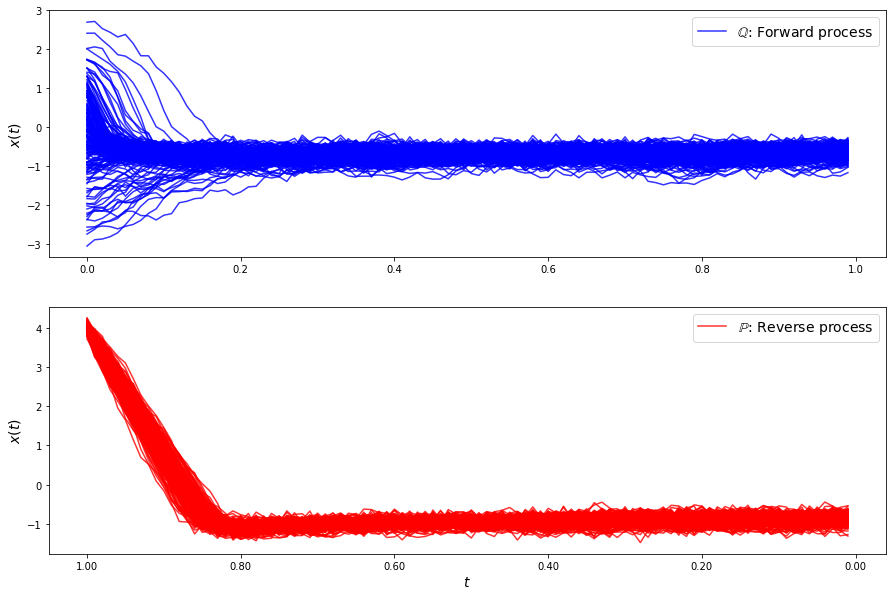

loss b 270.6055080579135
loss b 272.004450026046
loss b 275.83906132321357
loss b 273.8942090317075
loss b 270.3004504461193
loss b 271.95171680822546
loss b 272.9282917318322
loss b 271.6787520892391
loss b 273.64603070372465
loss b 272.2947974760969
loss b 274.2543655295845
loss b 273.3972992806124
loss b 271.23793951571656
loss b 272.4233061379321
loss b 274.25187660130007
loss b 272.9399599702066
loss b 275.50789004015326
loss b 273.9155477321406
loss b 271.830521312505
loss b 270.8734034641274
loss b 273.60554485832483
loss b 273.56063509436785
loss b 274.50220813023066
loss b 274.6418351583193
loss b 270.3667150657466
loss b 271.59226217609125
loss b 273.92336888329646
loss b 274.8002990571615
loss b 271.70604621532505
loss b 271.4273815415238
loss f 1223.7938008535054
loss f 1221.0560456750547
loss f 1223.4121695037065
loss f 1216.4754718907911
loss f 1216.4639811174331
loss f 1225.7138617505984
loss f 1214.1809971843022
loss f 1223.9670024495047
loss f 1229.099737266509
loss f 

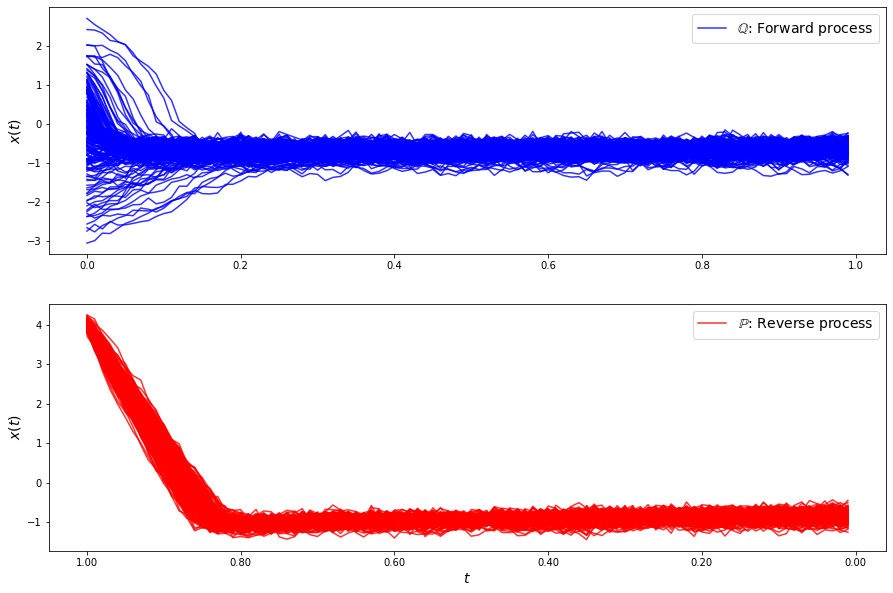

loss b 275.51213633255884
loss b 279.32927514209956
loss b 273.7342616606061
loss b 279.49250083406343
loss b 275.1993457284778
loss b 275.7911443627731
loss b 274.07595337175644
loss b 275.8547717030898
loss b 277.7846436039279
loss b 275.9845140769852
loss b 277.6974380068111
loss b 277.6315092920053
loss b 277.03655308429535
loss b 276.1261419591448
loss b 275.2390943577587
loss b 278.6761744304836
loss b 277.62917588668483
loss b 277.5266444372343
loss b 273.7391879673502
loss b 276.4410430888708
loss b 274.43212861743814
loss b 275.1238559870535
loss b 275.10925043317405
loss b 276.37136871400037
loss b 273.81719392484274
loss b 273.4345331295738
loss b 277.84587057204845
loss b 276.6940967682479
loss b 277.33142639551386
loss b 273.76537751082225
loss f 1223.9976025713665
loss f 1198.3288779765437
loss f 1198.1034282390376
loss f 1204.622382302585
loss f 1204.0256761680614
loss f 1203.9504803543907
loss f 1199.8154060751392
loss f 1202.592625489194
loss f 1210.1391393388596
loss 

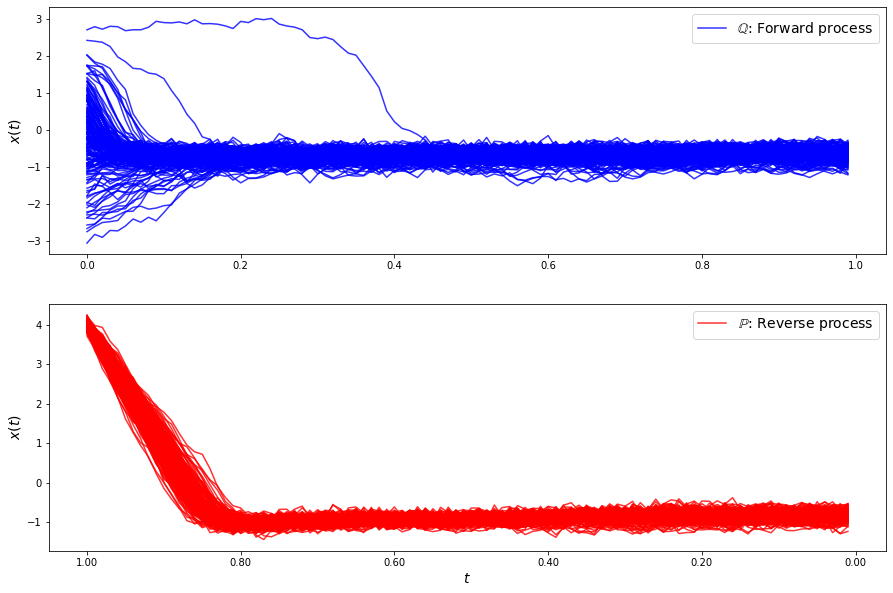

loss b 281.00642132385747
loss b 280.46997796145484
loss b 282.2365085883267
loss b 279.78538450018
torch.Size([200, 2]) 0 torch.Size([200, 2])
> <ipython-input-2-61526609ad5d>(35)forward()
-> raise
(Pdb) q



BdbQuit: 

In [29]:
torch.autograd.set_detect_anomaly(True)
c.fit(300, 30, burn_iterations=2, plot=True)
# 12,11976 , 6.9

In [37]:
torch.where(torch.tensor(c.loss_f) == 12.119769340303739)

(tensor([61]),)

In [70]:
for param_cur, param_best in zip(c.b_forward.parameters(),  c.f_thetas[61]):
    param_cur.data = param_best.data

In [71]:
for param_cur, param_best in zip(c.b_backward.parameters(),  c.b_thetas[61]):
    param_cur.data = param_best.data

In [72]:
# forward_dict= [key: c.f_thetas[61][i] for k, i in enumerate(c.b_forward.state_dict())]

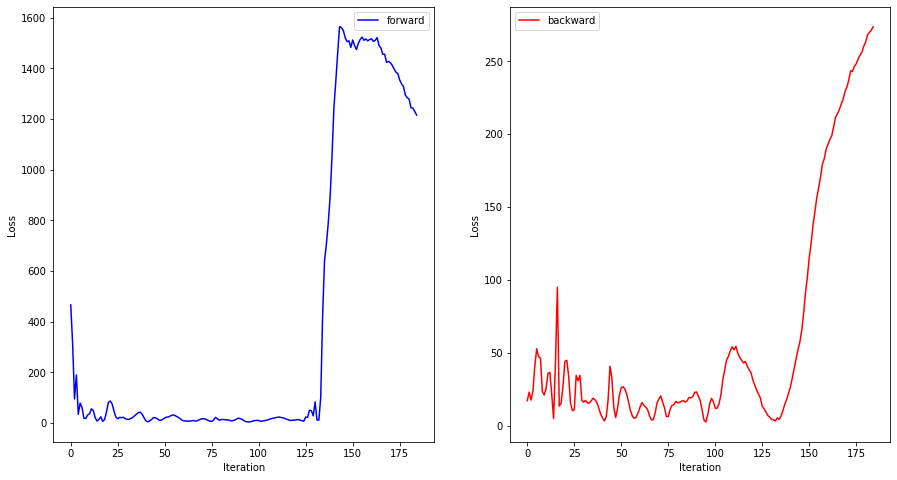

In [81]:
fig, axs = plt.subplots(1,2, sharey=False, figsize=(15, 8))
axs[0].plot(c.loss_f[2:], color="blue", label="forward")
axs[0].set_xlabel("Iteration")
axs[0].set_ylabel("Loss")
axs[0].legend()
axs[1].plot(c.loss_b[2:], color="red", label="backward")
axs[1].set_xlabel("Iteration")
axs[1].set_ylabel("Loss")
axs[1].legend()
plt.savefig("bigvarfinal_epochs.png")


In [74]:
bb = lambda X: -c.b_backward(X)

t, Xts = c.sde_solver(
    c.b_forward.forward, c.sigma,
    c.X_0, c.dt,  c.number_time_steps, 0.0,
    c.theta_f, False, True
)
t_, Xts_ = c.sde_solver(
    bb, c.sigma, 
    c.X_1, c.dt, c.number_time_steps, 0.0, 
    c.theta_b, False, False
)

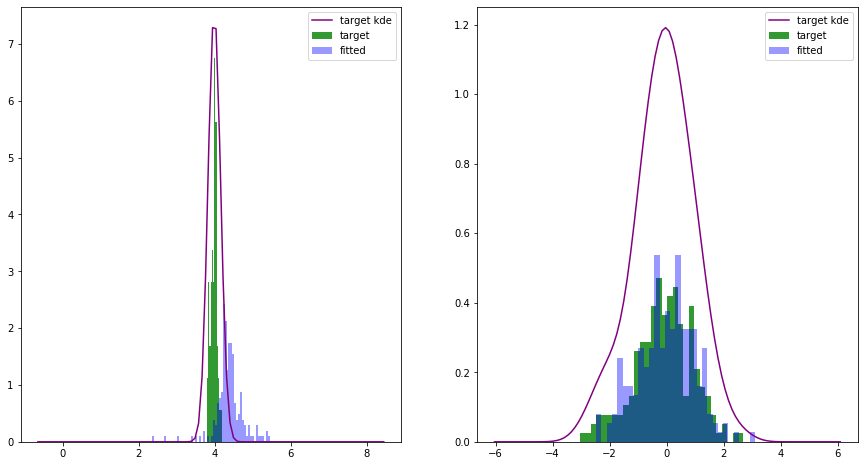

In [82]:
fig, axs = plt.subplots(1,2, figsize=(15, 8))
batch_terminal_empirical_f = next(c.data_stream(forward=True))



bins = 30
axs[1].hist(( X1.detach().cpu().numpy().flatten()), alpha=0.8, bins=bins, label="target", density=True, color="green");
axs[1].hist(( Xts_[:,-1,:-1].flatten().detach().cpu().numpy()), alpha=0.4, bins=bins, label="fitted", density=True, color="blue");



xx = torch.linspace(float(min(X1.min().detach().cpu().numpy(), Xts_[:,-1,:-1].min().detach().cpu().numpy() )) -3 ,
                    float(max(X1.max().detach().cpu().numpy(), Xts_[:,-1,:-1].max().detach().cpu().numpy() ))+3).reshape(-1,1).cuda().double()

H = silvermans_rule(batch_terminal_empirical_f)
kd  = np.exp(log_kde_pdf_per_point(xx, batch_terminal_empirical_f, H).detach().cpu().numpy())
axs[1].plot(xx.detach().cpu().numpy(), kd, label="target kde", color="purple")
axs[1].legend()

batch_terminal_empirical_b = next(c.data_stream(forward=False))
# xx = torch.linspace(-10, 10).reshape(-1,1).cuda().double()
xx = torch.linspace(float(min(X2.min().detach().cpu().numpy(), Xts[:,-1,:-1].min().detach().cpu().numpy() )) -3 ,
                    float(max(X2.max().detach().cpu().numpy(), Xts[:,-1,:-1].max().detach().cpu().numpy() ))+3).reshape(-1,1).cuda().double()

Hb = silvermans_rule(batch_terminal_empirical_b)
kd  = np.exp(log_kde_pdf_per_point(xx, batch_terminal_empirical_b, Hb).detach().cpu().numpy())
axs[0].plot(xx.detach().cpu().numpy(), kd, label="target kde", color="purple")


bins = 60
axs[0].hist(( X2.detach().cpu().numpy().flatten()), alpha=0.8, bins=bins, label="target", density=True, color="green");
axs[0].hist(( Xts[:,-1,:-1].flatten().detach().cpu().numpy()), alpha=0.4, bins=bins, label="fitted", density=True, color="blue");
axs[0].legend()
plt.savefig("bigvarfinal_boundaires.png")

In [76]:
def plot_trajectories(self, name):
        bb = lambda X: -self.b_backward(X)

        t, Xts = self.sde_solver(
            self.b_forward.forward, self.sigma,
            self.X_0, self.dt,  self.number_time_steps, 0.0,
            self.theta_f, False, True
        )
        t_, Xts_ = self.sde_solver(
            bb, self.sigma, 
            self.X_1, self.dt, self.number_time_steps, 0.0, 
            self.theta_b, False, False
        )
#         t = t / t.max()
#         t_ = t_ / t_.max()
        fn = 14
        fig, axs = plt.subplots(2,1,  sharey=False, figsize=(15,10))
        axs[1].set_xlabel("$t$", fontsize=fn)
        axs[1].set_ylabel("$x(t)$", fontsize=fn)
        axs[0].set_ylabel("$x(t)$", fontsize=fn)

       

        for i in range(n):
            label = "$\mathbb{Q}$: Forward process" if i == 0 else None
            axs[0].plot(t.cpu().flatten(), Xts[i,:,:-1].detach().cpu().numpy().flatten(), 'b', alpha=0.3,  label=label)


        for i in range(n):
            label = "$\mathbb{P}$: Reverse process" if i == 0 else None
            axs[1].plot(t_.cpu().flatten(), Xts_[i,:, :-1].detach().cpu().numpy().flatten(), 'r', alpha=0.3, label=label)

        axs[1].legend(fontsize=fn)
        axs[0].legend(fontsize=fn)
        
        tt = list(range(0, int(np.ceil(t_.max().item()))))
        print(t_)
        print(tt)
        axs[1].set_xticks(tt )
        axs[1].set_xticklabels(list(map (lambda x: '{0:.2f}'.format((x)), tt))[::-1])
        plt.savefig(name)
        plt.show()    

tensor([0.0000, 0.0100, 0.0200, 0.0300, 0.0400, 0.0500, 0.0600, 0.0700, 0.0800,
        0.0900, 0.1000, 0.1100, 0.1200, 0.1300, 0.1400, 0.1500, 0.1600, 0.1700,
        0.1800, 0.1900, 0.2000, 0.2100, 0.2200, 0.2300, 0.2400, 0.2500, 0.2600,
        0.2700, 0.2800, 0.2900, 0.3000, 0.3100, 0.3200, 0.3300, 0.3400, 0.3500,
        0.3600, 0.3700, 0.3800, 0.3900, 0.4000, 0.4100, 0.4200, 0.4300, 0.4400,
        0.4500, 0.4600, 0.4700, 0.4800, 0.4900, 0.5000, 0.5100, 0.5200, 0.5300,
        0.5400, 0.5500, 0.5600, 0.5700, 0.5800, 0.5900, 0.6000, 0.6100, 0.6200,
        0.6300, 0.6400, 0.6500, 0.6600, 0.6700, 0.6800, 0.6900, 0.7000, 0.7100,
        0.7200, 0.7300, 0.7400, 0.7500, 0.7600, 0.7700, 0.7800, 0.7900, 0.8000,
        0.8100, 0.8200, 0.8300, 0.8400, 0.8500, 0.8600, 0.8700, 0.8800, 0.8900,
        0.9000, 0.9100, 0.9200, 0.9300, 0.9400, 0.9500, 0.9600, 0.9700, 0.9800,
        0.9900], device='cuda:0', dtype=torch.float64)
[0]


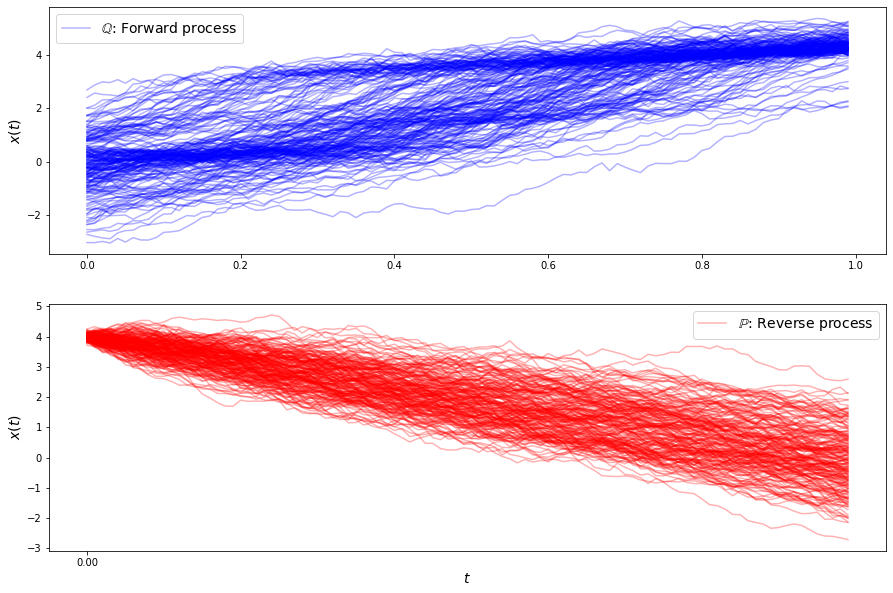

In [80]:
plot_trajectories(c, "bigvarfinal_trajectories.png")

In [78]:
import scipy.stats as st

print(st.ks_2samp(Xts[:,-1,:-1].flatten().detach().cpu().numpy(), X2.flatten().detach().cpu().numpy()))
print(st.ks_2samp(Xts_[:,-1,:-1].flatten().detach().cpu().numpy(), X1.flatten().detach().cpu().numpy()))

Ks_2sampResult(statistic=0.805, pvalue=4.241177905654546e-65)
Ks_2sampResult(statistic=0.07, pvalue=0.7125821300149116)
